In [1]:
import os
import inspect
import seaborn
import matplotlib
import matplotlib.pyplot as plt
import torch
import scanpy as sc
import tqdm
import sys
import pickle
import PyComplexHeatmap as pch
import scvi
import IPython
import pandas as pd
import h5py
import xarray as xr

sc.settings.figdir=os.path.expanduser('~/WbFigures/RegionalClocks')
sc._settings.settings._vector_friendly = True
plt.rcParams.update({
    'figure.dpi': 100,
    'savefig.dpi': 300,
    'font.family': 'DejaVu Sans',
    'font.sans-serif': 'DejaVuSansMono',
    'pdf.fonttype': 42
})


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if torch.cuda.is_available():
    print("GPU is available")
    print("Number of GPUs:", torch.cuda.device_count())
    print("GPU Name:", torch.cuda.get_device_name(0))
else:
    print("GPU is not available")

import antipode
from antipode.antipode_model import *
import antipode.model_functions
from antipode.model_functions import *
import antipode.model_distributions
from antipode.model_distributions import *
import antipode.model_modules
from antipode.model_modules import *
import antipode.train_utils
from antipode.train_utils import *
import antipode.plotting
from antipode.plotting import *

plt.rc("axes.spines", top=False, right=False)


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


GPU is not available


In [2]:
batch_key='batch_name'
discov_key='species'
layer_key='spliced'
leaf_key='level_2'
MDE_KEY = "X_antipode_UMAP"
anndata.settings.allow_write_nullable_strings = True

model_tag   = '1.9.1.8.5_Dev_final_600clusters'
model_path='/home/matthew.schmitz/Matthew/models/'+model_tag
adata = sc.read_h5ad(os.path.join(model_path,'analysis_inprogress.h5ad'))
antipode_model=antipode.antipode_model.ANTIPODE.load(model_path,adata=adata,prefix='p3_',device=device)
antipode_model.save_params_to_uns()
adata=antipode_model.adata_manager.adata
pstore = adata.uns['param_store']

INFO     Generating sequential column names                                                                        


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/pyro/params/param_store.py:334: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s

In [3]:
# with h5py.File(os.path.join(model_path,'analysis_inprogress.h5ad')) as f:
#     adata.obs['batch_name'] = anndata.experimental.read_elem(f['obs'])['batch_name']

In [4]:
pstore = adata.uns['param_store']
discov_cluster_params,cluster_params, cluster_labels,var_labels, zero_mask,(prop_taxon, prop_locs,prop_discov_di,prop_discov_dm)=antipode_model.calculate_cluster_params(flavor='numpy')
cluster_index = np.array([int(x) for x in cluster_labels])
zero_mask = np.nan_to_num(zero_mask,posinf=np.nan)
discov_cluster_params = discov_cluster_params[:,cluster_index,:] * zero_mask
prop_locs = prop_locs[cluster_index,:]
prop_discov_di = prop_discov_di[:,cluster_index,:] * zero_mask
prop_discov_dm = prop_discov_dm[:,cluster_index,:] * zero_mask
discov_labels=adata.obs[antipode_model.discov_key].cat.categories
latent_labels=[str(x) for x in range(pstore['discov_dc'].shape[1])]
n_clusters=antipode_model.level_sizes[-1]

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/antipode_mixins.py:450: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  zero_mask = (adata.obs.groupby(self.discov_key)[leaf_level].value_counts().unstack().loc[:,cluster_labels]>=cluster_count_threshold).to_numpy()
/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/antipode_mixins.py:451: RuntimeWarning: divide by zero encountered in divide
  return discov_cluster_params,cluster_params, cluster_labels,var_labels, 1/zero_mask[...,np.newaxis],(prop_taxon, prop_locs,prop_discov_di,prop_discov_dm)


In [5]:
discov_cluster_params_da = xr.DataArray(discov_cluster_params,coords={'species':discov_labels,'level_2':cluster_labels,'var':var_labels})

In [6]:
set(adata.obs['region'].cat.categories) - set([ 'Ctx-PFC','Ctx-MOp',   
        'Ctx-Somato','Ctx-Ins','Ctx-Par','Ctx-Occ','Ctx-Temp', 'Ctx-Clau','Ctx','LGE','MGE','CGE','GE','Str','POA','Sept','FB', 'Thal','Hypo', 'DE', 
         'MB',  'Cb','Pons','HB','Medulla'])

{'Amy', 'Choroid', 'Ctx-Hip', 'Head'}

In [7]:
adata.obs['region'] = adata.obs['region'].cat.reorder_categories([ 'Ctx-PFC','Ctx-MOp',   
        'Ctx-Somato','Ctx-Ins','Ctx-Par','Ctx-Occ','Ctx-Temp', 'Ctx-Clau','Ctx','Ctx-Hip','LGE','MGE','CGE','GE','Str','Sept','Amy','POA','FB', 'Thal','Hypo', 'DE', 
         'MB',  'Cb','Pons','HB','Medulla','Head','Choroid'])
adata.uns['region_colors'] = [adata.uns['region_colors_dict'][x] for x in adata.obs['region'].cat.categories]

In [8]:
# sc.pl.embedding(
#     adata,
#     basis=MDE_KEY,
#     color=['region']
# )

In [9]:
adata.obs['simplified_region'] = adata.obs['region'].astype(str)
adata.obs['simplified_region'] = adata.obs['simplified_region'].str.replace('Amy','Hip')
adata.obs['simplified_region'] = adata.obs['simplified_region'].str.replace('Ctx-Hip','Hip')
adata.obs['simplified_region'] = adata.obs['simplified_region'].str.replace('-[A-Za-z]+','',regex=True)
adata.obs['simplified_region'] = adata.obs['simplified_region'].replace({'Hypo':'DE','Thal':'DE','POA':'VMT','Sept':'VMT','Str':'LGE'})
adata.obs['simplified_region'] = adata.obs['simplified_region'].replace({'LGE':'GE','MGE':'GE','CGE':'GE'})
adata.obs['simplified_region'] = adata.obs['simplified_region'].replace({'Choroid':'Head'})
adata.obs['simplified_region'] = adata.obs['simplified_region'].replace({'DRG':'HB','Medulla':'HB'})
adata.obs['simplified_region'] = adata.obs['simplified_region'].replace({'Cb':'HB','Pons':'HB'})
adata.obs['simplified_region'] = adata.obs['simplified_region'].replace({'VMT':'FB'})
adata.obs['simplified_region'] = adata.obs['simplified_region'].replace({'GE':'FB'})
adata.obs.loc[adata.obs['batch_name'].str.contains('Thalamic'),'simplified_region'] = 'DE'

In [10]:
npc_mat = adata.obs.loc[adata.obs['Initial_Class'].str.contains('NPC'),:].groupby('level_2',observed=True)['simplified_region'].value_counts().unstack().fillna(0)
npc_mat = npc_mat.drop(['Hip','Head','FB'],axis=1)
npc_mat = npc_mat/npc_mat.sum(0)
npc_mat = (npc_mat.T/npc_mat.sum(1)).T
npc_mat = npc_mat.fillna(0)
npc_mat = npc_mat.loc[npc_mat.max(1)>0.8,:]
region_replace_dict = npc_mat.idxmax(1).to_dict()


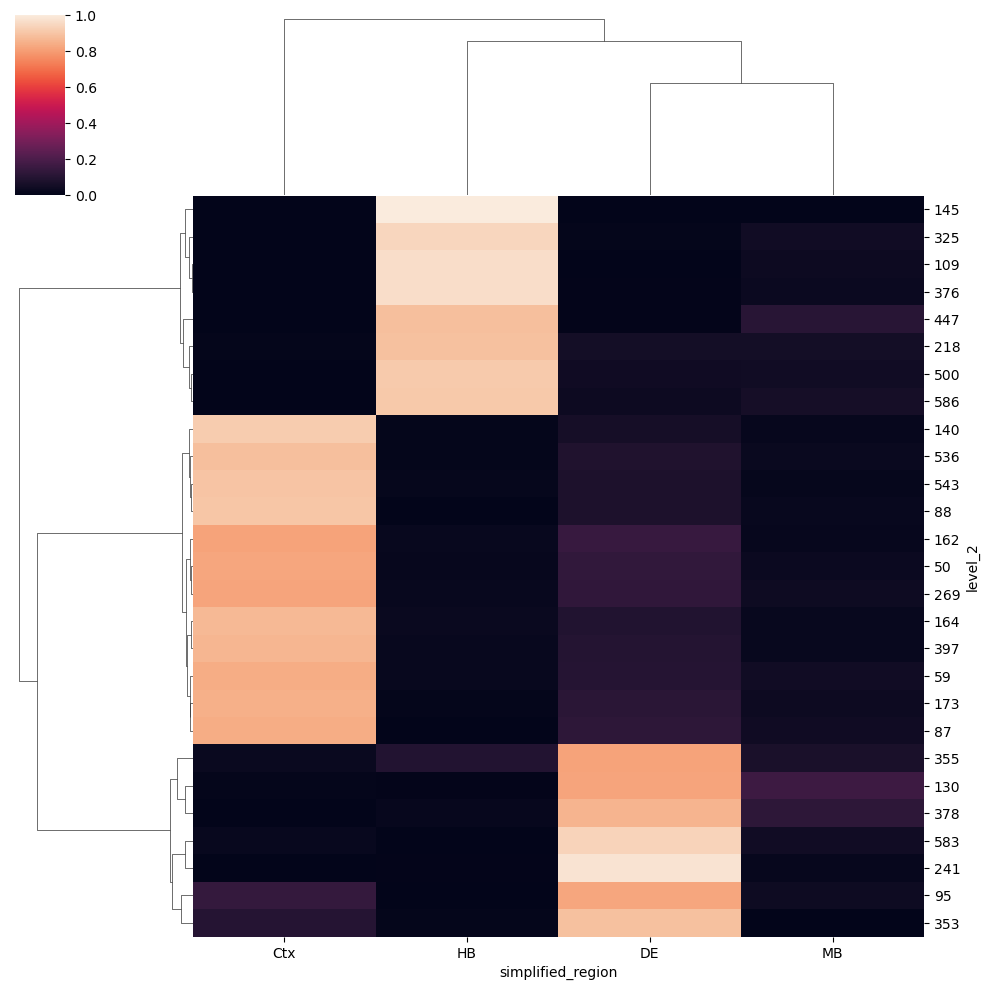

In [11]:
seaborn.clustermap(npc_mat)

In [12]:
# adata.obs['npc_separated_region'] = adata.obs['simplified_region'].astype(str)
# adata.obs.loc[adata.obs['level_2'].isin(region_replace_dict.keys()),'npc_separated_region'] = adata.obs.loc[adata.obs['level_2'].isin(region_replace_dict.keys()),'level_2'].replace(region_replace_dict)
# sc.pl.embedding(
#     adata,
#     basis=MDE_KEY,
#     color=['npc_separated_region']
# )

In [13]:
adata.obs['Initial_Class_level_2'] = adata.obs['Initial_Class'].astype(str) + '_' + adata.obs['level_2'].astype(str)
adata.obs['Initial_Class_level_2'] = adata.obs['Initial_Class_level_2'].astype('category')
adata.uns['sl2_l2_dict'] = dict(zip(adata.obs['Initial_Class_level_2'].cat.categories, [re.search('_[0-9]+$',x).group(0).replace('_','') for x in adata.obs['Initial_Class_level_2'].cat.categories]))
adata.uns['Initial_Class_level_2_colors_dict'] = {x:adata.uns['level_2_colors_dict'][adata.uns['sl2_l2_dict'][x]] for x in adata.obs['Initial_Class_level_2'].cat.categories}
adata.uns['Initial_Class_level_2_colors'] = [adata.uns['Initial_Class_level_2_colors_dict'][x] for x in  adata.obs['Initial_Class_level_2'].cat.categories]
adata.uns['level_2_colors'] = [adata.uns['level_2_colors_dict'][str(x)] for x in  adata.obs['level_2'].cat.categories]

In [14]:
# sc.pl.embedding(
#     adata,
#     basis=MDE_KEY,
#     color=['level_2'],legend_loc='on data'
# )

In [15]:
# sc.pl.embedding(
#     adata,
#     basis=MDE_KEY,
#     color=['Division']
# )

In [16]:
# sc.pl.embedding(
#     adata,
#     basis=MDE_KEY,
#     color=['Initial_Class']
# )

In [17]:
# # adata.uns['Initial_Class_level_2_colors'] = adata.uns['level_2_colors']
# sc.pl.embedding(
#     adata,
#     basis=MDE_KEY,
#     color=['Initial_Class_level_2']
# )

In [18]:
# adata.obs['simplified_region'].cat.categories

In [19]:
adata.obs['simplified_region'] = adata.obs['simplified_region'].astype('category')
adata.uns['general_region_colors_dict'] = adata.uns['general_region_color_dict']
adata.uns['simplified_region_colors'] = [adata.uns['general_region_colors_dict'].get(str.lower(x),'#b51318') for x in adata.obs['simplified_region'].cat.categories]

In [20]:
# sc.pl.embedding(
#     adata,
#     basis=MDE_KEY,
#     color=['simplified_region']
# )

In [21]:
adata[adata.obs['species']=='macaque',:].obs['region'].value_counts()

region
Ctx-MOp       79706
Ctx-Occ       54817
CGE           40766
Ctx-PFC       38059
Ctx-Somato    37131
Ctx-Hip       35829
MGE           35759
Cb            35116
MB            31651
Ctx-Par       27102
Choroid       25577
Ctx-Ins       23918
Ctx-Temp      23320
Head          22916
Hypo          21615
Thal          21032
HB            17209
DE            13328
Str           13260
Sept          12834
Medulla       12588
Pons          10339
Amy            8476
LGE            6249
Ctx-Clau       4962
POA            1078
Name: count, dtype: int64

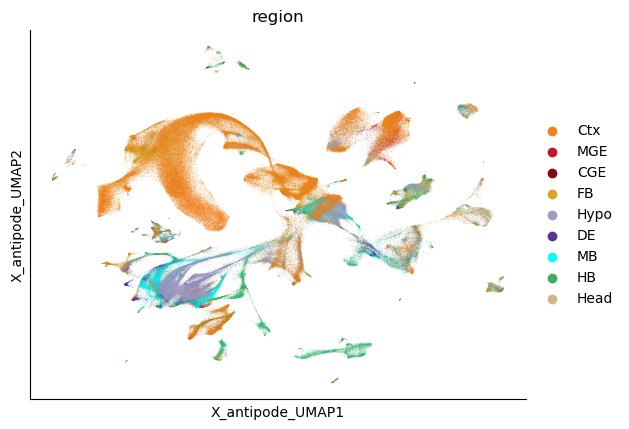

In [22]:
sc.pl.embedding(
    adata[adata.obs['species']=='mouse',:],
    basis=MDE_KEY,
    color=['region']
)

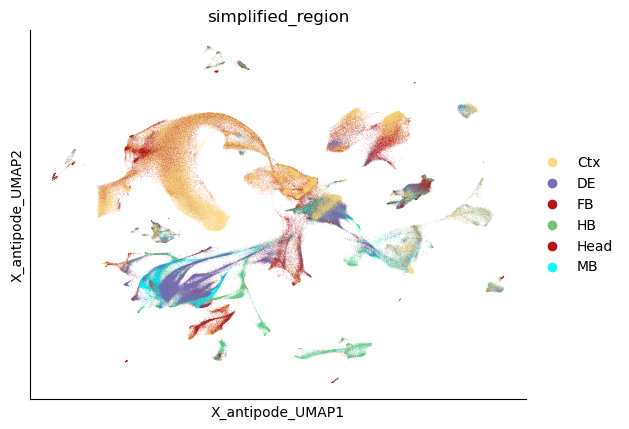

In [23]:
sc.pl.embedding(
    adata[adata.obs['species']=='mouse',:],
    basis=MDE_KEY,
    color=['simplified_region']
)

In [24]:
#didn't actually need this code so far but will keep in case
import xarray as xr
import sparse

species_arrays = {}
cols = ['simplified_region','batch_name','timepoint', 'Initial_Class']
unique_species = adata.obs['species'].unique()
for sp in unique_species:
    # Subset observations for the current species.
    df_sp = adata.obs.loc[adata.obs['species'] == sp,cols]

    for c in df_sp.columns:
        df_sp[c] = df_sp[c].astype('category')
        df_sp[c] = df_sp[c].cat.remove_unused_categories()
    # Group by the other axes and count cells.
    counts_sp = df_sp.groupby(cols).size()
    # Remove unused levels from the MultiIndex (useful if any of these columns are categorical)
    
    counts_sp.name = 'cell_count'
    
    # Convert the series to an xarray object.
    da_sp = counts_sp.to_xarray()
    if isinstance(da_sp, xr.Dataset):
        da_sp = da_sp[list(da_sp.data_vars.keys())[0]]
    
    # Fill missing values with 0.
    da_sp = da_sp.fillna(0)
    
    # Convert the dense data to a sparse array.
    sparse_data = da_sp.values#sparse.COO(da_sp.values)
    
    # Create a new DataArray with the sparse data.
    da_sp_sparse = xr.DataArray(sparse_data, coords=da_sp.coords, dims=da_sp.dims, name='cell_count')
    
    # Store the DataArray in the dictionary.
    species_arrays[sp] = da_sp_sparse

    # Normalize the 
    batch_sum = species_arrays[sp].sum(dim=[dim for dim in species_arrays[sp].dims if dim != 'batch_name']) 
    species_arrays[sp] = species_arrays[sp].isel({'batch_name':batch_sum.data>1000})
    species_arrays[sp] = species_arrays[sp] / batch_sum
print(species_arrays)


/scratch/fast/3608344/ipykernel_2533973/3193474034.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts_sp = df_sp.groupby(cols).size()
/scratch/fast/3608344/ipykernel_2533973/3193474034.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts_sp = df_sp.groupby(cols).size()
/scratch/fast/3608344/ipykernel_2533973/3193474034.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts_sp = df_sp.groupby(cols).si

{'mouse': <xarray.DataArray 'cell_count' (simplified_region: 6, batch_name: 140,
                                timepoint: 17, Initial_Class: 76)> Size: 9MB
array([[[[0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ]],

        [[0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.      

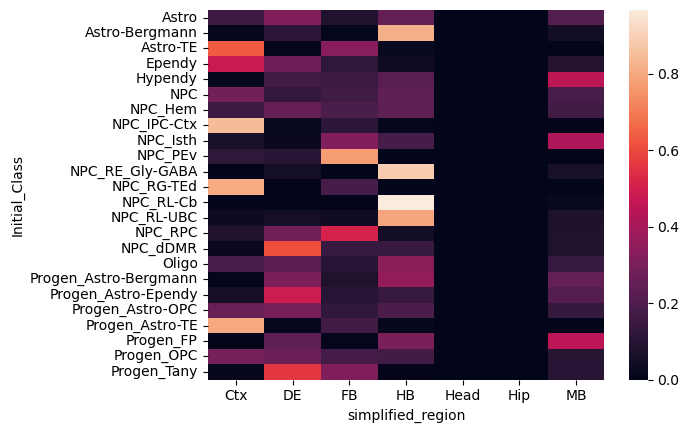

/scratch/fast/3608344/ipykernel_2533973/3797205892.py:61: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts_clusters = df.groupby(['batch_name', 'timepoint', 'species', region_col, cluster_col]).size().reset_index(name='count')
/scratch/fast/3608344/ipykernel_2533973/3797205892.py:63: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  counts_pivot = counts_clusters.pivot_table(index=['batch_name', 'timepoint', 'species', region_col],
/scratch/fast/3608344/ipykernel_2533973/3797205892.py:80: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Con

Species: human, Region: Ctx, Cluster: Astro-TE_148__Ctx, COM: 145.25
Species: human, Region: Ctx, Cluster: Astro-TE_216__Ctx, COM: 134.00
Species: human, Region: Ctx, Cluster: Astro-TE_32__Ctx, COM: 115.31
Species: human, Region: Ctx, Cluster: Astro-TE_76__Ctx, COM: 114.52
Species: human, Region: Ctx, Cluster: Astro_259__Ctx, COM: 145.27
Species: human, Region: Ctx, Cluster: NPC_119__Ctx, COM: 47.95
Species: human, Region: Ctx, Cluster: NPC_256__Ctx, COM: 42.74
Species: human, Region: Ctx, Cluster: NPC_368__Ctx, COM: 48.53
Species: human, Region: Ctx, Cluster: NPC_401__Ctx, COM: 40.94
Species: human, Region: Ctx, Cluster: NPC_453__Ctx, COM: 42.10
Species: human, Region: Ctx, Cluster: NPC_538__Ctx, COM: 46.65
Species: human, Region: Ctx, Cluster: NPC_IPC-Ctx_124__Ctx, COM: 115.96
Species: human, Region: Ctx, Cluster: NPC_IPC-Ctx_140__Ctx, COM: 117.53
Species: human, Region: Ctx, Cluster: NPC_IPC-Ctx_173__Ctx, COM: 93.43
Species: human, Region: Ctx, Cluster: NPC_IPC-Ctx_253__Ctx, COM: 11

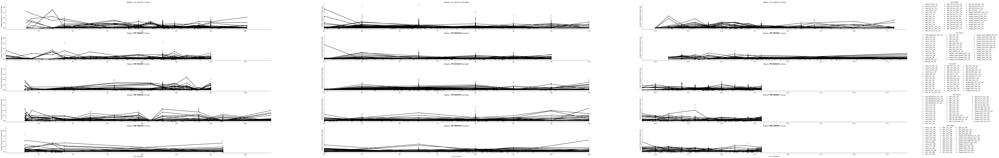

In [25]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Set column names.
region_col = 'simplified_region'
cluster_col = 'Initial_Class_level_2'  # clusters with labels like '3 NPC', '7 Astro', etc.
class_col = 'Division'
drop = ['Hip', 'Head']
n_clusters = 40 # max number of clusters to look at per regions
min_count_per_cluster = 500
xr_glia = ['Progen_OPC','Astro-TE','Astro','Oligo','Ependy']
r_glia = ['Hypendy','Astro-Bergmann']
glia = xr_glia + r_glia

# Assume that adata is your AnnData object and its .obs is a DataFrame.
df = adata.obs.copy()

df = df.loc[~adata.obs['batch_name'].str.contains('CS20_'), :]  # remove mislabelled batch
df = df.loc[~df[region_col].isin(drop), :]

# Convert timepoint to numeric.
df['timepoint'] = pd.to_numeric(df['timepoint'], errors='coerce')

# Exclude neurons, and things not in neurectoderm lineage
df = df[~df['Neighborhood'].isin(['T','DMR','ExoNN','Neighbor'])]
df = df[~df[cluster_col].str.contains('L-Q_')]
df[cluster_col] = df[cluster_col].str.replace('Astro-Rx','Astro') #no reason to separate reactive astrocyte state
df['Initial_Class'] = df['Initial_Class'].str.replace('Astro-Rx','Astro')

# Keep only clusters that contain "NPC" OR cells where Division=='Glia'
df = df[df[class_col].str.contains("NPC|GPC", case=False, na=False) | (df['Initial_Class'].isin(glia))]

# Filter out batches with less than 200 cells.
batch_counts = df['batch_name'].value_counts()
batches_to_keep = batch_counts[batch_counts >= 200].index
df = df[df['batch_name'].isin(batches_to_keep)]

# For pooled data: combine batch and region.
df['region_batch_name'] = df['batch_name'].astype(str) + '_' + df[region_col].astype(str)
batch_counts = df['region_batch_name'].value_counts()
batches_to_keep = batch_counts[batch_counts >= 200].index
df = df[df['region_batch_name'].isin(batches_to_keep)]

df['batch_name'] = df['batch_name'].astype(str).astype('category')
df['batch_name'].value_counts()

seaborn.heatmap(df.groupby('Initial_Class')['simplified_region'].value_counts(normalize=True).unstack())
plt.show()
multi_region = df['Initial_Class'].isin(['NPC','Progen_Astro-Ependy','Progen_Astro-OPC','NPC-Hem'] + xr_glia)#,'NPC_PEv','Progen_Choroid'
df['Initial_Class_level_2'] = df['Initial_Class_level_2'].astype(str)
df['Initial_Class'] = df['Initial_Class'].astype(str)
df.loc[multi_region,'Initial_Class_level_2'] = df.loc[multi_region,'Initial_Class_level_2'].astype(str)+'__'+df.loc[multi_region,'simplified_region'].astype(str)

sr_counts = df.loc[~multi_region,:].groupby('Initial_Class')['simplified_region'].value_counts().unstack()#
sr_counts = sr_counts.loc[sr_counts.sum(1)>0,:]
sr_dict = sr_counts.idxmax(1).to_dict()
df.loc[~multi_region,'Initial_Class_level_2'] = df.loc[~multi_region,'Initial_Class_level_2'].astype(str)+'__'+df.loc[~multi_region,'Initial_Class'].replace(sr_dict).astype(str)


counts_clusters = df.groupby(['batch_name', 'timepoint', 'species', region_col, cluster_col]).size().reset_index(name='count')

counts_pivot = counts_clusters.pivot_table(index=['batch_name', 'timepoint', 'species', region_col],
                                             columns=cluster_col, values='count', fill_value=0).reset_index()

meta_cols = ['batch_name', 'timepoint', 'species', region_col,'total_count']
cluster_columns = [col for col in counts_pivot.columns if col not in meta_cols]
counts_pivot['total_count'] = counts_pivot[cluster_columns].sum(axis=1)
counts_pivot = counts_pivot.loc[counts_pivot['total_count']>0,:]
counts_pivot_meta = counts_pivot[meta_cols]
# counts_pivot = counts_pivot[cluster_columns]
counts_pivot_meta.index = list(counts_pivot_meta['batch_name'].astype(str))
counts_pivot.index = list(counts_pivot_meta['batch_name'].astype(str))

counts_pivot[cluster_columns].to_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/progenitor_timepoint_counts.tsv',sep='\t')
counts_pivot_meta.to_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/progenitor_timepoint_counts_meta.tsv',sep='\t')

# Compute the ratio (proportion) for each cluster.
for col in cluster_columns:
    counts_pivot['ratio_' + col] = counts_pivot[col] / counts_pivot['total_count'].replace(0, np.nan)

# --- Determine Top Clusters per Region ---
abundance = counts_clusters.groupby([region_col, cluster_col])['count'].sum().reset_index()
# abundance = abundance[abundance[cluster_col].str.startswith("NPC") | abundance[cluster_col].str.contains('Progen_Astro-Ependy|Progen_Astro-OPC')]
top_clusters = abundance.groupby(region_col).apply(lambda x: x.nlargest(n_clusters, 'count')).reset_index(drop=True)
top_clusters = top_clusters.loc[top_clusters['count']>min_count_per_cluster,:]
top_clusters_dict = top_clusters.groupby(region_col)[cluster_col].apply(list).to_dict()

# --- Reshape Data for Plotting ---
ratio_cols = [col for col in counts_pivot.columns if col.startswith('ratio_')]
plot_df = counts_pivot.melt(id_vars=['batch_name', 'timepoint', 'species', region_col],
                             value_vars=ratio_cols,
                             var_name='ratio_type', value_name='ratio')
plot_df['cluster'] = plot_df['ratio_type'].str.replace('ratio_', '', regex=False)
plot_df = plot_df.dropna(subset=['ratio'])



def keep_top(row):
    reg = row[region_col]
    clust = row['cluster']
    return reg in top_clusters_dict and clust in top_clusters_dict[reg]

plot_df = plot_df[plot_df.apply(keep_top, axis=1)]

# --- Plotting Setup ---
regions_list = sorted(plot_df[region_col].dropna().unique())
species_list = sorted(plot_df['species'].dropna().unique())

fig, axes = plt.subplots(nrows=len(regions_list), ncols=len(species_list),
                         figsize=(n_clusters * len(species_list), 4 * len(regions_list)),
                         sharey=True)

# Ensure axes is 2D.
if len(regions_list) == 1 and len(species_list) == 1:
    axes = np.array([[axes]])
elif len(regions_list) == 1:
    axes = np.array([axes])
elif len(species_list) == 1:
    axes = np.array([[ax] for ax in axes])

# Create a list to store COM results.
com_results = []

# For each region and species, plot the means and compute COM per cluster.
for i, reg in enumerate(regions_list):
    for j, sp in enumerate(species_list):
        ax = axes[i, j]
        sub = plot_df[(plot_df[region_col] == reg) & (plot_df['species'] == sp)]
        if sub.empty:
            ax.set_visible(False)
            continue
        
        for clust, sub_df in sub.groupby('cluster'):
            # Plot individual sample points.
            ax.scatter(sub_df['timepoint'], sub_df['ratio'], alpha=0.5, s=20,
                       label=f"{clust}",
                       color=adata.uns['Initial_Class_level_2_colors_dict'].get(clust, 'k'))
            # Compute the mean ratio per timepoint.
            sub_agg = sub_df.groupby('timepoint', as_index=False)['ratio'].mean().sort_values('timepoint')
            x_vals = sub_agg['timepoint'].values
            y_vals = sub_agg['ratio'].values
            if len(y_vals) < 2:
                continue  # Not enough points to compute a curve.
            
            # Plot the curve connecting the means.
            ax.plot(x_vals, y_vals, linestyle='-', lw=2,
                    color=adata.uns['Initial_Class_level_2_colors_dict'].get(clust, 'k'))
            
            # Compute the area under the curve and the center of mass (COM).
            area = np.trapezoid(y_vals, x_vals)
            if area <= 0:
                continue
            com = np.trapezoid(x_vals * y_vals, x_vals) / area
            print(f"Species: {sp}, Region: {reg}, Cluster: {clust}, COM: {com:.2f}")
            
            # Save COM result.
            com_results.append({"species": sp, "region": reg, "cluster": clust, "AUC":area/y_vals.max() , "COM": com})
            
            # Plot an 'x' at (COM, 0) with the color corresponding to the cluster.
            ax.scatter(com, 0, marker='x', s=100,
                       color=adata.uns['Initial_Class_level_2_colors_dict'].get(clust, 'k'))
            
        ax.set_title(f"Region: {reg}, Species: {sp}")
        ax.set_xlabel("PCD Timepoint")
        ax.set_ylabel("Cluster Proportion of Total Cells")

# Adjust x-axis limits per species.
for j, sp in enumerate(species_list):
    sp_timepoints = pd.to_numeric(plot_df.loc[plot_df['species'] == sp, 'timepoint'], errors='coerce')
    if sp_timepoints.empty:
        continue
    sp_min, sp_max = sp_timepoints.min(), sp_timepoints.max()
    for i in range(len(regions_list)):
        ax = axes[i, j]
        if ax.get_visible():
            ax.set_xlim(sp_min, sp_max)

# Add legends per region row.
for i, reg in enumerate(regions_list):
    ax = axes[i, -1]
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles, labels, loc='center left', bbox_to_anchor=(1.05, 0.5),
              title=f"{reg} clusters", frameon=False,ncols=3)

# plt.tight_layout(rect=[0, 0, 0.9, 1])
# plt.savefig(os.path.join(sc.settings.figdir, 'progen_nn_ratio_per_species.svg'))
# plt.show()

# Convert COM results to a dataframe for later analysis.
analysis_df = pd.DataFrame(com_results)
print("COM table (full sample):")
print(analysis_df.head())



In [26]:
#############################################
# --- Create table suitable for jackknife ---
#############################################

# Aggregate the mean ratio per timepoint for each species, region, and cluster.
jackknife_table = plot_df.groupby(['species', region_col, 'cluster', 'timepoint'], as_index=False)['ratio'].mean()
jackknife_table = jackknife_table.sort_values(['species', region_col, 'cluster', 'timepoint'])
jackknife_table = jackknife_table.loc[~jackknife_table['ratio'].isna(), :]
print("\nJackknife input table:")
print(jackknife_table.head())

#############################################
# --- Jackknife Leave-One-Out Resampling ---
#############################################

# Define a helper function to compute both COM and normalized AUC.
def compute_com_auc(x_vals, y_vals):
    # Compute the area under the curve using the trapezoidal rule.
    area = np.trapezoid(y_vals, x_vals)
    # If the area is non-positive, we return NaNs.
    if area <= 0:
         return np.nan, np.nan
    # Calculate the center of mass.
    com = np.trapezoid(x_vals * y_vals, x_vals) / area
    # Compute the normalized AUC (here using y_vals.max() as the normalization factor).
    norm_auc = area / y_vals.max()
    return com, norm_auc

jackknife_results = []

# Group by species, region, and cluster.
for (species, region, cluster), group in jackknife_table.groupby(['species', region_col, 'cluster']):
    group = group.sort_values('timepoint')
    x_vals = group['timepoint'].values
    y_vals = group['ratio'].values
    if len(x_vals) < 2:
        continue  # Not enough points for jackknife resampling.
    
    # Compute COM and AUC for the full dataset.
    full_com, full_auc = compute_com_auc(x_vals, y_vals)
    
    # Initialize lists to store the leave-one-out jackknife estimates.
    jk_coms = []
    jk_aucs = []
    
    # Leave-one-out jackknife resampling.
    for i in range(len(x_vals)):
        x_jk = np.delete(x_vals, i)
        y_jk = np.delete(y_vals, i)
        if len(x_jk) < 2:
            continue
        jk_com, jk_auc = compute_com_auc(x_jk, y_jk)
        jk_coms.append(jk_com)
        jk_aucs.append(jk_auc)
    
    jk_coms = np.array(jk_coms)
    jk_aucs = np.array(jk_aucs)
    if len(jk_coms) == 0 or len(jk_aucs) == 0:
        continue
    
    # Compute the 95% nonparametric confidence intervals for both COM and AUC.
    ci_com_lower = np.percentile(jk_coms, 2.5)
    ci_com_upper = np.percentile(jk_coms, 97.5)
    ci_auc_lower = np.percentile(jk_aucs, 2.5)
    ci_auc_upper = np.percentile(jk_aucs, 97.5)
    
    jackknife_results.append({
         'species': species,
         'region': region,
         'cluster': cluster,
         'full_COM': full_com,
         'full_AUC': full_auc,
         'ci_COM_lower': ci_com_lower,
         'ci_COM_upper': ci_com_upper,
         'ci_AUC_lower': ci_auc_lower,
         'ci_AUC_upper': ci_auc_upper,
         'n_timepoints': len(x_vals)
    })

jackknife_df = pd.DataFrame(jackknife_results)
print("Jackknife Nonparametric Confidence Intervals:")
print(jackknife_df)


/scratch/fast/3608344/ipykernel_2533973/2151087594.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  jackknife_table = plot_df.groupby(['species', region_col, 'cluster', 'timepoint'], as_index=False)['ratio'].mean()
/scratch/fast/3608344/ipykernel_2533973/2151087594.py:32: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for (species, region, cluster), group in jackknife_table.groupby(['species', region_col, 'cluster']):



Jackknife input table:
    species simplified_region            cluster  timepoint  ratio
211   human               Ctx  Astro-TE_148__Ctx         33    0.0
212   human               Ctx  Astro-TE_148__Ctx         36    0.0
214   human               Ctx  Astro-TE_148__Ctx         48    0.0
216   human               Ctx  Astro-TE_148__Ctx         55    0.0
220   human               Ctx  Astro-TE_148__Ctx         84    0.0
Jackknife Nonparametric Confidence Intervals:
    species region              cluster    full_COM   full_AUC  ci_COM_lower  \
0     human    Ctx    Astro-TE_148__Ctx  145.246694  26.578261    135.262971   
1     human    Ctx    Astro-TE_216__Ctx  134.003273  29.264325    124.840966   
2     human    Ctx     Astro-TE_32__Ctx  115.308766  19.656119    110.577992   
3     human    Ctx     Astro-TE_76__Ctx  114.519613  27.906267    108.885945   
4     human    Ctx       Astro_259__Ctx  145.270135  24.874083    130.626022   
..      ...    ...                  ...         

/scratch/fast/3608344/ipykernel_2533973/1728006762.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  level2_group = df.groupby(['species', 'simplified_region', 'timepoint', 'Initial_Class']).size().reset_index(name='count')
/scratch/fast/3608344/ipykernel_2533973/1728006762.py:15: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  level2_pivot = level2_group.pivot_table(index=['species', 'simplified_region', 'timepoint'],


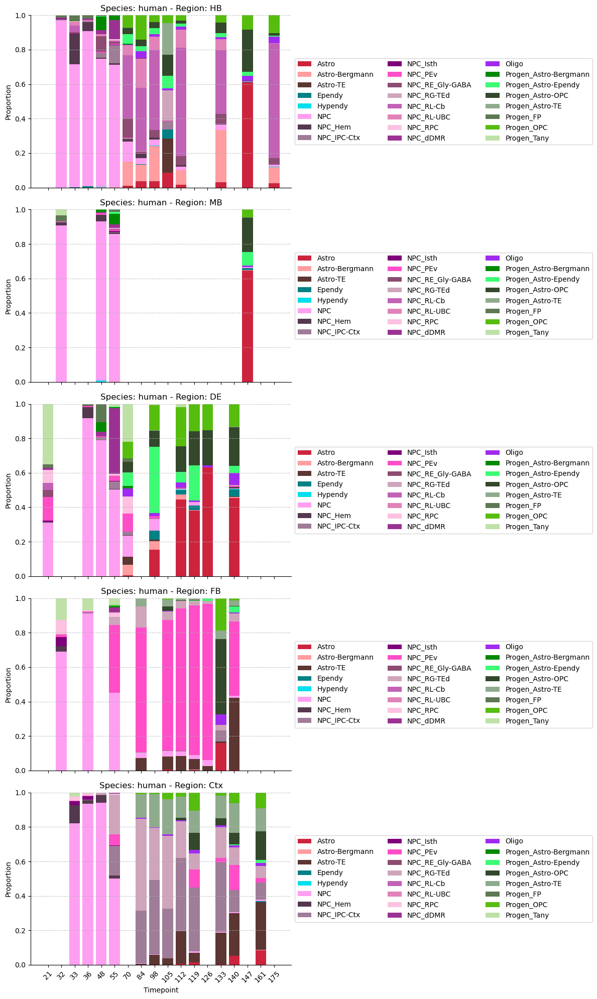

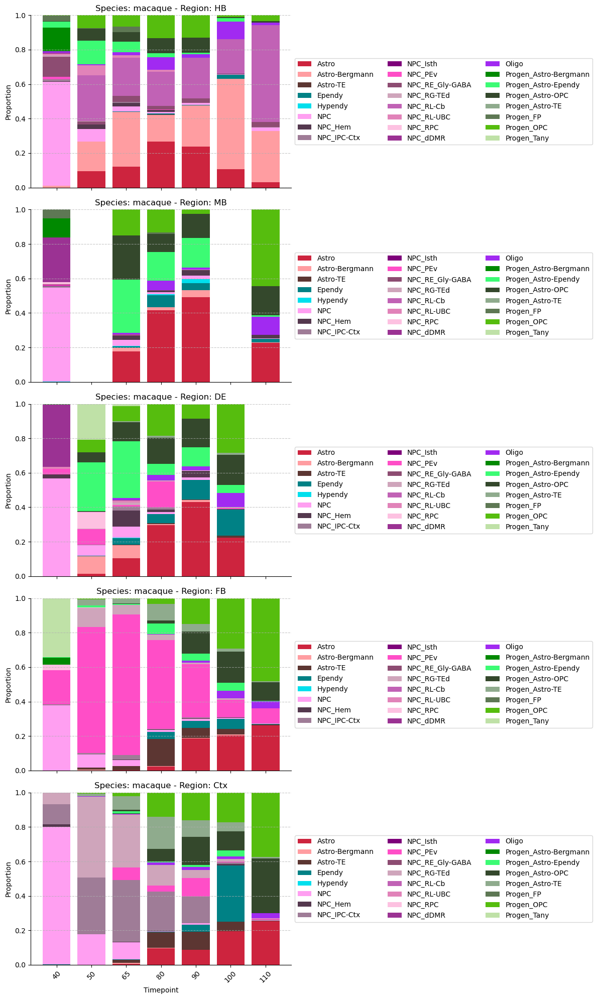

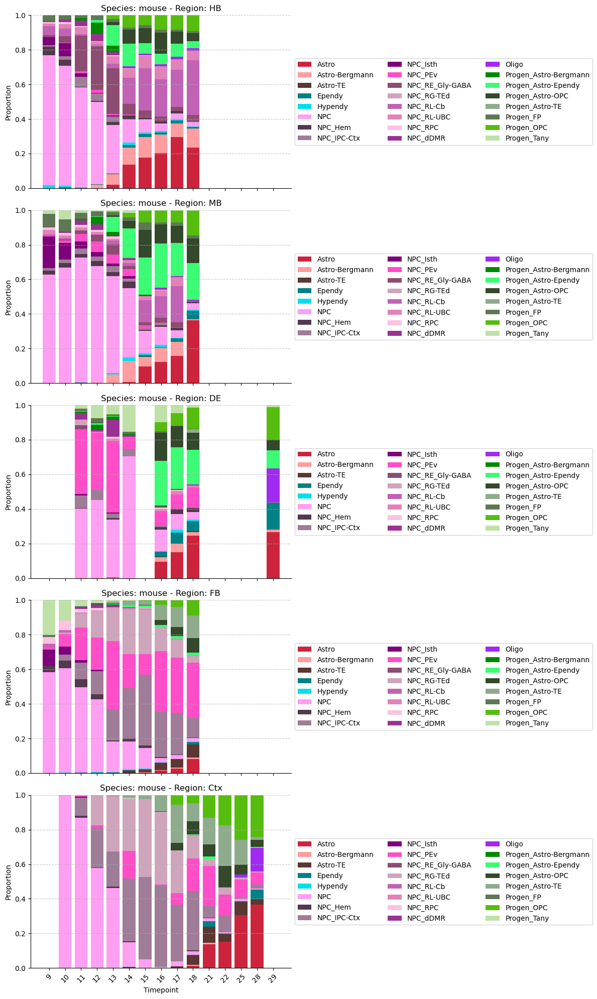

In [27]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Use adata.obs as the source dataframe.
# df = adata.obs.copy()
# df = df[~df.simplified_region.isin(drop)]

# df['Initial_Class'] = df['Initial_Class'].cat.remove_unused_categories()
# --- Data Preparation for Initial_Class Stacked Barplots by Region ---
# Group cells by species, simplified_region, timepoint, and Initial_Class.
level2_group = df.groupby(['species', 'simplified_region', 'timepoint', 'Initial_Class']).size().reset_index(name='count')

# Pivot so that rows are (species, simplified_region, timepoint) and columns are Initial_Class clusters.
level2_pivot = level2_group.pivot_table(index=['species', 'simplified_region', 'timepoint'],
                                         columns='Initial_Class',
                                         values='count',
                                         fill_value=0)
# Drop any rows that are completely empty.
level2_pivot = level2_pivot[level2_pivot.sum(axis=1) > 0]

# Normalize each row so that each bar (timepoint) sums to 1.
level2_norm = level2_pivot.div(level2_pivot.sum(axis=1), axis=0).reset_index()

# Convert timepoint to string to force a categorical x-axis.
level2_norm['timepoint_cat'] = level2_norm['timepoint'].astype(str)

# Retrieve the Initial_Class color dictionary.
level2_colors = adata.uns['Initial_Class_colors_dict']
level2_norm['simplified_region'] = level2_norm['simplified_region'].astype(str).astype('category')
level2_norm['simplified_region'] = level2_norm['simplified_region'].cat.reorder_categories(['HB','MB','DE','FB','Ctx'])

# --- Plotting ---
# For each species, create one subplot per simplified_region.
species_list = sorted(level2_norm['species'].unique())
for sp in species_list:
    sub_species = level2_norm[level2_norm['species'] == sp].sort_values('timepoint')
    # Determine the full union of timepoints (as strings) for this species.
    species_timepoints = sorted(sub_species['timepoint'].unique())
    species_timepoints_str = [str(tp) for tp in species_timepoints]
    
    regions = sub_species['simplified_region'].cat.categories
    
    fig, axes = plt.subplots(nrows=len(regions), ncols=1,
                             figsize=(12, 4 * len(regions)),
                             sharex=True)
    if len(regions) == 1:
        axes = [axes]
    
    for ax, reg in zip(axes, regions):
        sub_region = sub_species[sub_species['simplified_region'] == reg].sort_values('timepoint')
        # Identify the Initial_Class columns (numeric columns).
        plot_cols = [col for col in sub_region.columns 
                     if col not in ['species', 'simplified_region', 'timepoint', 'timepoint_cat']]
        # Reindex only the numeric data so that all timepoints are present,
        # filling missing values with 0.
        numeric_df = sub_region.set_index('timepoint_cat')[plot_cols] \
                                .reindex(species_timepoints_str, fill_value=0).reset_index()
        x_categories = numeric_df['timepoint_cat'].tolist()
        x = np.arange(len(x_categories))
        
        bottom = np.zeros(len(numeric_df))
        for clust in plot_cols:
            y = numeric_df[clust].values
            ax.bar(x, y, bottom=bottom,
                   color=level2_colors.get(str(clust), 'gray'),
                   width=0.8, label=clust)
            bottom += y
        
        ax.set_xticks(x)
        ax.set_xticklabels(x_categories, rotation=45)
        ax.set_ylim(0, 1)
        ax.set_title(f"Species: {sp} - Region: {reg}")
        ax.set_ylabel("Proportion")
        ax.grid(axis='y', linestyle='--', alpha=0.7)
        ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=3)
    plt.xlabel("Timepoint")
    plt.tight_layout()
    plt.savefig(os.path.join(sc.settings.figdir,f'{sp}_Initial_Class_simplifiedregion_proportions.svg'))
    plt.show()


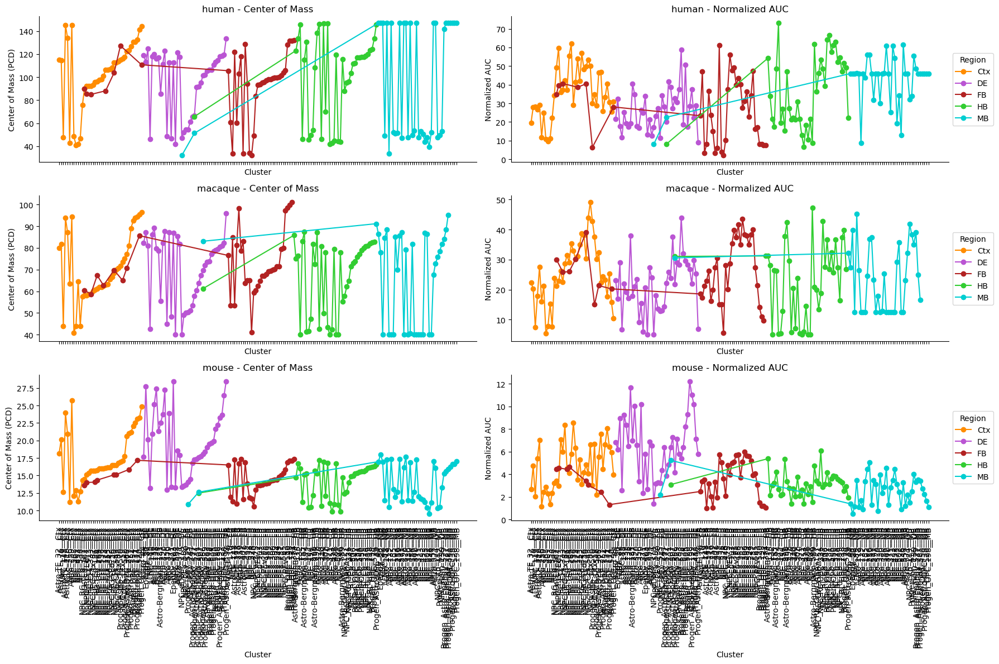

In [28]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os

# Example analysis_df from your previous analysis.
# analysis_df columns: 'species', 'region', 'cluster', 'COM', 'AUC'

# Define the category palette.
category_palette = {'Ctx': 'darkorange', 'FB': 'firebrick', 'MB': 'darkturquoise', 
                    'HB': 'limegreen', 'DE':'mediumorchid'}

# Create a sorting key by extracting the numeric portion from cluster names.
def cluster_sort_key(x):
    try:
        # Assumes cluster names like "NPC_157", "NPC_166", etc.
        return int(x.split('_')[1])
    except Exception:
        return np.nan

# Create a column for sorting clusters and then sort the dataframe.
analysis_df['cluster_sort'] = analysis_df['cluster'].apply(cluster_sort_key)
analysis_df = analysis_df.sort_values(by=['species', 'region', 'cluster_sort', 'COM'])

# Determine the unique species.
species_list = analysis_df['species'].unique()
n_species = len(species_list)

# Create subplots: 2 columns (COM and AUC) with one row per species.
fig, axes = plt.subplots(n_species, 2, figsize=(18, 4 * n_species), sharex=True)

# Handle the case with only one species.
if n_species == 1:
    axes = [axes]  # Convert to a list so that axes[0][0] and axes[0][1] can be used

# For each species, plot COM and AUC timelines per cluster, with separate lines for each region.
for i, sp in enumerate(species_list):
    sub = analysis_df[analysis_df['species'] == sp]
    # Determine the cluster order based on the numeric part.
    clusters_ordered = sorted(sub['cluster'].unique(), key=cluster_sort_key)
    
    # Get the two axes for this species: one for COM and one for AUC.
    ax_com = axes[i][0]
    ax_auc = axes[i][1]
    
    for region in sub['region'].unique():
        sub_region = sub[sub['region'] == region].copy()
        # Map each cluster to its position in the ordered list.
        sub_region['cluster_pos'] = sub_region['cluster'].apply(lambda x: clusters_ordered.index(x))
        sub_region = sub_region.sort_values('cluster_pos')
        
        # Plot COM.
        ax_com.plot(sub_region['cluster_pos'], sub_region['COM'], marker='o', linestyle='-',
                    label=region, color=category_palette.get(region, 'gray'))
        # Plot AUC.
        ax_auc.plot(sub_region['cluster_pos'], sub_region['AUC'], marker='o', linestyle='-',
                    label=region, color=category_palette.get(region, 'gray'))
    
    # Format COM subplot.
    ax_com.set_title(f"{sp} - Center of Mass")
    ax_com.set_xlabel("Cluster")
    ax_com.set_ylabel("Center of Mass (PCD)")
    ax_auc.legend(title="Region",loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
    ax_com.set_xticks(range(len(clusters_ordered)))
    ax_com.set_xticklabels(clusters_ordered, rotation=90)
    
    # Format AUC subplot.
    ax_auc.set_title(f"{sp} - Normalized AUC")
    ax_auc.set_xlabel("Cluster")
    ax_auc.set_ylabel("Normalized AUC")
    ax_auc.legend(title="Region",loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
    ax_auc.set_xticks(range(len(clusters_ordered)))
    ax_auc.set_xticklabels(clusters_ordered, rotation=90)

plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'COM_AUC_per_species.svg'))
plt.show()


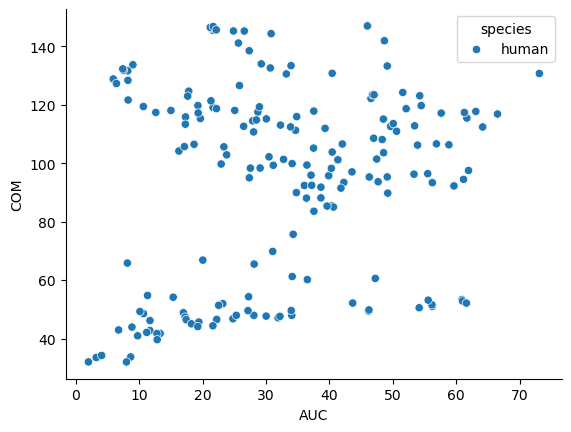

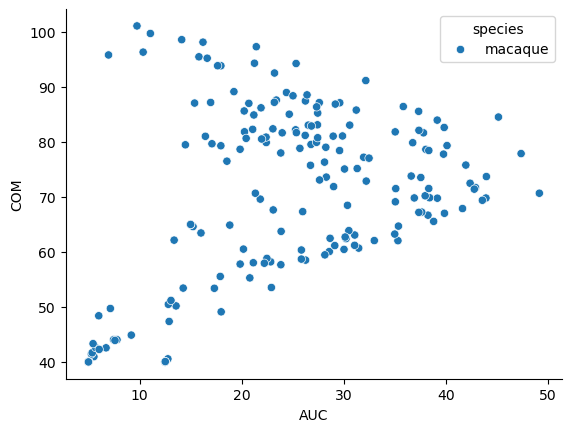

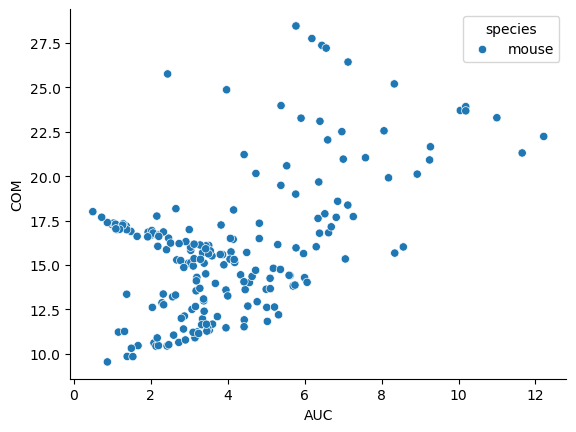

In [29]:
for s in species_list:
    seaborn.scatterplot(data=analysis_df.loc[analysis_df['species']==s,:],x='AUC',y='COM',hue='species')
    plt.show()

In [30]:
jackknife_df

,species,region,cluster,full_COM,full_AUC,ci_COM_lower,ci_COM_upper,ci_AUC_lower,ci_AUC_upper,n_timepoints
0,human,Ctx,Astro-TE_148__Ctx,145.246694,26.578261,135.262971,146.853178,18.773335,28.331432,12
1,human,Ctx,Astro-TE_216__Ctx,134.003273,29.264325,124.840966,135.605310,18.271592,47.519590,12
2,human,Ctx,Astro-TE_32__Ctx,115.308766,19.656119,110.577992,120.294058,15.170806,26.765634,12
3,human,Ctx,Astro-TE_76__Ctx,114.519613,27.906267,108.885945,115.719538,24.680639,34.443814,12
4,human,Ctx,Astro_259__Ctx,145.270135,24.874083,130.626022,150.659260,10.644799,29.428546,12
...,...,...,...,...,...,...,...,...,...,...
595,mouse,MB,Progen_FP_412__MB,10.501279,2.472589,10.406484,11.033626,1.708844,2.638259,10
596,mouse,MB,Progen_OPC_198__MB,17.031759,1.099307,16.214815,17.266216,1.078217,1.727457,10
597,mouse,MB,Progen_OPC_450__MB,16.202022,2.742368,15.649667,16.510931,2.226306,3.110639,10
598,mouse,MB,Progen_OPC_520__MB,16.608357,1.651006,15.962996,16.876886,1.528943,2.163411,10


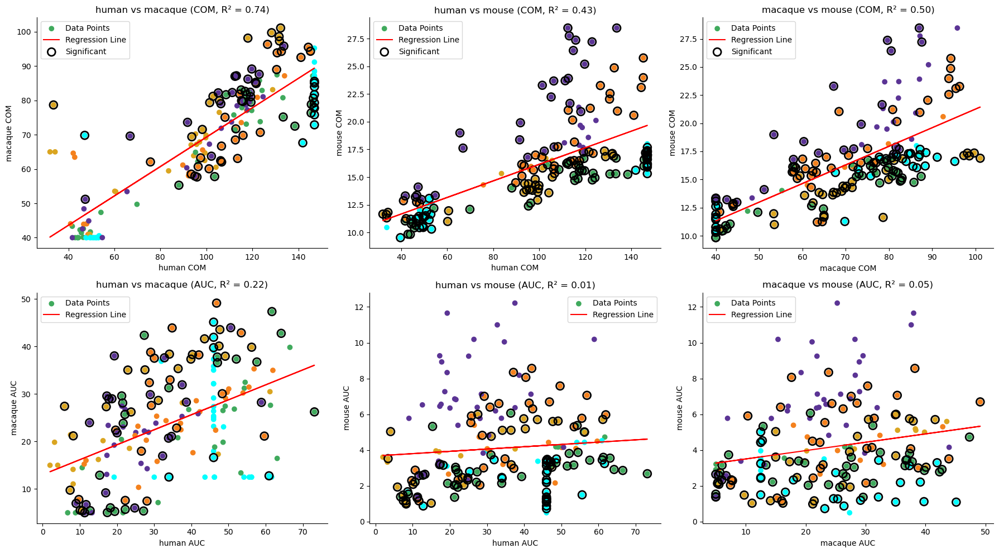

Significant displacement results:
    metric          cluster_region species_x species_y     x_value  \
0      COM  Astro-Bergmann_167__HB     human   macaque  115.118280   
1      COM  Astro-Bergmann_290__HB     human   macaque  108.562452   
2      COM        Astro-TE_148__FB     human   macaque  121.653059   
3      COM        Astro-TE_216__FB     human   macaque  102.881339   
4      COM        Astro-TE_32__Ctx     human   macaque  115.308766   
..     ...                     ...       ...       ...         ...   
709    AUC      Progen_OPC_450__MB   macaque     mouse   25.019385   
710    AUC     Progen_OPC_520__Ctx   macaque     mouse   10.352388   
711    AUC      Progen_OPC_520__FB   macaque     mouse    9.749537   
712    AUC      Progen_OPC_520__HB   macaque     mouse   42.764504   
713    AUC      Progen_OPC_520__MB   macaque     mouse   16.621648   

     observed_y  predicted_y   ci_lower   ci_upper  displacement        r2  
0     83.053206    75.751688  76.490877  88.0692

In [31]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from mpl_toolkits.mplot3d import Axes3D
import seaborn
import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Create combined identifiers.
# analysis_df['cluster_region'] = analysis_df['cluster'] + '__' + analysis_df['region']
# jackknife_df['cluster_region'] = jackknife_df['cluster'] + '__' + jackknife_df['region']
analysis_df['cluster_region'] = analysis_df['cluster']
jackknife_df['cluster_region'] = jackknife_df['cluster'] 

analysis_df = analysis_df.loc[analysis_df['region'] == analysis_df['cluster_region'].str.split('__').str[1],:]
jackknife_df = jackknife_df.loc[jackknife_df['region'] == jackknife_df['cluster_region'].str.split('__').str[1],:]


# Pivot jackknife CI data separately for COM and AUC.
jackknife_com_pivot = jackknife_df.pivot(index='cluster_region', columns='species', values=['ci_COM_lower', 'ci_COM_upper'])
jackknife_auc_pivot = jackknife_df.pivot(index='cluster_region', columns='species', values=['ci_AUC_lower', 'ci_AUC_upper'])

# Pivot analysis data for COM and AUC.
pivot_com_df = analysis_df.pivot(index='cluster_region', columns='species', values='COM')
pivot_auc_df = analysis_df.pivot(index='cluster_region', columns='species', values='AUC')

# Data colors based on the region portion of the cluster_region.
# (Here we assume adata.uns['region_colors_dict'] holds a mapping for region names.)
# We'll extract the region from each cluster_region label.
data_colors = np.array([adata.uns['region_colors_dict'][cr.split('__')[1]] for cr in pivot_com_df.index.to_series()])

# Define species pairs for pairwise regression.
species_pairs = [('human', 'macaque'), ('human', 'mouse'), ('macaque', 'mouse')]
significant_results = []  # To store details of significant displacements.

# Create subplots: 2 rows (one for COM, one for AUC) and 3 columns (one per species pair).
fig, axes = plt.subplots(2, 3, figsize=(18, 10))  # axes shape (2, 3)

# Loop over metrics: row 0 will be for COM and row 1 for AUC.
for row_idx, metric in enumerate(["COM", "AUC"]):
    # Select the appropriate pivot and jackknife pivot data.
    if metric == "COM":
        pivot_df = pivot_com_df
        jk_pivot = jackknife_com_pivot
    else:
        pivot_df = pivot_auc_df
        jk_pivot = jackknife_auc_pivot

    # For each species pair, perform the regression analysis.
    for col_idx, (sp_x, sp_y) in enumerate(species_pairs):
        ax = axes[row_idx, col_idx]

        # Only select rows with non-missing values for both species.
        mask = pivot_df[sp_x].notna() & pivot_df[sp_y].notna()
        x_vals = pivot_df.loc[mask, sp_x].values.reshape(-1, 1)
        y_vals = pivot_df.loc[mask, sp_y].values
        cluster_regions = pivot_df.loc[mask].index

        # Determine colors based on the region part of the cluster_region label.
        cur_colors = np.array([adata.uns['region_colors_dict'][cr.split('__')[1]] for cr in cluster_regions])

        # Fit a linear regression model.
        model = LinearRegression().fit(x_vals, y_vals)
        y_pred = model.predict(x_vals)
        r2 = r2_score(y_vals, y_pred)

        # Plot the data points and regression line.
        ax.scatter(x_vals, y_vals, c=cur_colors, label='Data Points')
        ax.plot(x_vals, y_pred, color='red', label='Regression Line')

        # Check each point: flag as significant if the predicted value falls outside its jackknife CI.
        for idx, cluster_region in enumerate(cluster_regions):
            if metric == "COM":
                ci_lower = jk_pivot.loc[cluster_region, ('ci_COM_lower', sp_y)]
                ci_upper = jk_pivot.loc[cluster_region, ('ci_COM_upper', sp_y)]
            else:  # AUC
                ci_lower = jk_pivot.loc[cluster_region, ('ci_AUC_lower', sp_y)]
                ci_upper = jk_pivot.loc[cluster_region, ('ci_AUC_upper', sp_y)]
            pred_val = y_pred[idx]
            if (pred_val < ci_lower) or (pred_val > ci_upper):
                ax.scatter(x_vals[idx], y_vals[idx],
                           facecolors='none', edgecolors='black', s=100, linewidths=2,
                           label='Significant' if idx == 0 else "")
                # Calculate the displacement.
                displacement = (ci_lower - pred_val) if pred_val < ci_lower else (pred_val - ci_upper)
                significant_results.append({
                    'metric': metric,
                    'cluster_region': cluster_region,
                    'species_x': sp_x,
                    'species_y': sp_y,
                    'x_value': x_vals[idx][0],
                    'observed_y': y_vals[idx],
                    'predicted_y': pred_val,
                    'ci_lower': ci_lower,
                    'ci_upper': ci_upper,
                    'displacement': displacement,
                    'r2': r2
                })

        ax.set_xlabel(f'{sp_x} {metric}')
        ax.set_ylabel(f'{sp_y} {metric}')
        ax.set_title(f'{sp_x} vs {sp_y} ({metric}, R² = {r2:.2f})')
        ax.legend()

plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'COM_AUC_regression_species_pairs_highlight.svg'))
plt.show()

# Collate the significant displacement results into a DataFrame.
significant_df = pd.DataFrame(significant_results)
print("Significant displacement results:")
print(significant_df)


In [32]:
jackknife_com_pivot

ci_COM_lower                       ci_COM_upper  \
species                       human    macaque      mouse        human   
cluster_region                                                           
Astro-Bergmann_167__HB   105.812582  76.490877  14.841196   124.896462   
Astro-Bergmann_290__HB    98.331832  75.861705  15.221377   114.726329   
Astro-Bergmann_589__HB   102.179408  72.486409  14.327977   122.620606   
Astro-Bergmann_72__HB    111.246646  79.006448  14.407683   128.503938   
Astro-TE_148__Ctx        135.262971  87.820086  23.046719   146.853178   
...                             ...        ...        ...          ...   
Progen_OPC_520__HB       100.612479  68.991614  15.823298   119.137558   
Progen_OPC_520__MB              NaN  74.987973  15.962996          NaN   
Progen_OPC_542__HB       115.017774  77.008319  14.913842   137.147341   
Progen_Tany_293__DE       54.756852  51.576243  16.052020    71.621848   
Progen_Tany_515__DE       35.691917  50.378843  13.847557    63.722074   

                                              
species                   macaque      mouse  
cluster_region                                
Astro-Bergmann_167__HB  88.069288  15.309835  
Astro-Bergmann_290__HB  85.143746  15.836620  
Astro-Bergmann_589__HB  80.774448  14.846067  
Astro-Bergmann_72__HB   89.727690  14.883698  
Astro-TE_148__Ctx       95.617110  24.274139  
...                           ...        ...  
Progen_OPC_520__HB      75.431281  16.606470  
Progen_OPC_520__MB      99.326307  16.876886  
Progen_OPC_542__HB      84.249796  15.513605  
Progen_Tany_293__DE     73.335515  19.439506  
Progen_Tany_515__DE     72.169109  14.460585  

[184 rows x 6 columns]

Displacement vectors (each row corresponds to a cluster_region):
species                 disp_human  disp_macaque  disp_mouse
cluster_region                                              
Astro-Bergmann_167__HB   -2.452836      5.831822   -2.400452
Astro-Bergmann_290__HB   -3.108424      7.107103   -1.395008
Astro-Bergmann_589__HB   -0.430411      1.417550   -2.711986
Astro-Bergmann_72__HB    -2.061635      5.137096   -3.385437
Astro-TE_148__Ctx        -1.808133      3.281741    4.141684
...                            ...           ...         ...
Progen_OPC_520__HB        1.350632     -2.859885   -0.719935
Progen_OPC_520__MB       -1.542683      3.983311   -3.342829
Progen_OPC_542__HB        1.556725     -2.864473   -3.338980
Progen_Tany_293__DE      -0.272116     -0.342940    5.486090
Progen_Tany_515__DE      -2.281218      4.720082    1.856715

[180 rows x 3 columns]


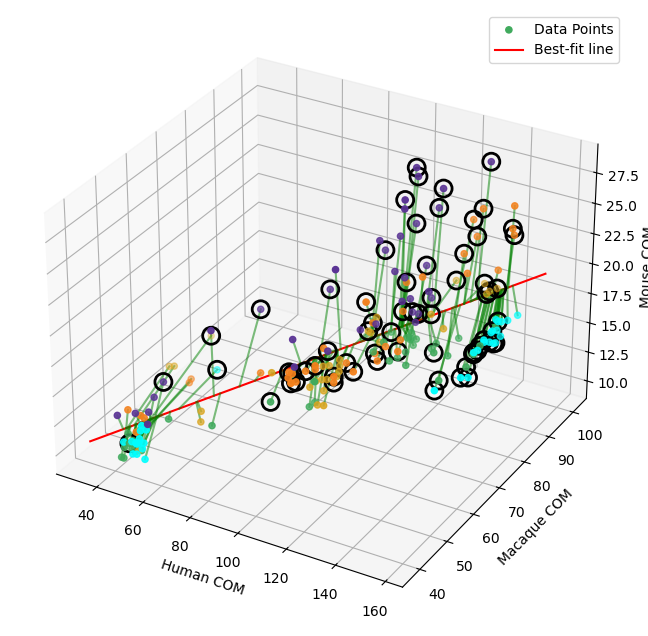

In [33]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn
import os

# --- Assume pivot_df is already created with columns 'human', 'macaque', 'mouse'
#     and index as cluster_region ---
species = ['human', 'macaque', 'mouse']
com_pivot = pivot_com_df[species].dropna()

# Get colors based on region (assumes cluster_region is formatted as "cluster__region")
data_colors = [adata.uns['region_colors_dict'][x] for x in com_pivot.index.to_series().str.split('__').str[1]]

# Convert COM data to a numpy array (each row: [human, macaque, mouse])
com_points = com_pivot.values

# --- Compute the universal best-fit line via SVD ---
centroid = com_points.mean(axis=0)
# Subtract centroid and perform SVD; first row of Vt gives the unit direction vector.
U, S, Vt = np.linalg.svd(com_points - centroid)
direction = Vt[0]

# For each point, compute its orthogonal projection onto the best-fit line.
t_vals = np.dot(com_points - centroid, direction)  # scalar projection for each point
projections = centroid + np.outer(t_vals, direction)
# Displacement vectors (observed - projection)
displacements = com_points - projections

# Optionally, add the displacement components back to com_pivot.
com_pivot = com_pivot.copy()
for i, sp in enumerate(species):
    com_pivot[f'disp_{sp}'] = displacements[:, i]
print("Displacement vectors (each row corresponds to a cluster_region):")
print(com_pivot[[f'disp_{sp}' for sp in species]])

# --- Compare SVD predictions with jackknife CIs ---
# jackknife_com_pivot is assumed to have MultiIndex columns:
# level 0: 'ci_lower' and 'ci_upper'; level 1: species.
# Its index is cluster_region.

all_results = []
for idx, cluster_region in enumerate(com_pivot.index):
    # Observed COM (from the original pivot)
    obs = com_pivot.loc[cluster_region, species]
    # Predicted COM from the SVD best-fit line (projection)
    proj = pd.Series(projections[idx], index=species)
    
    species_info = {}
    all_sig = True  # Assume significance for all species until proven otherwise.
    for sp in species:
        ci_lower = jackknife_com_pivot.loc[cluster_region, ('ci_COM_lower', sp)]
        ci_upper = jackknife_com_pivot.loc[cluster_region, ('ci_COM_upper', sp)]
        pred_val = proj[sp]
        observed_val = obs[sp]
        disp = pred_val - observed_val
        # Flag as significant if predicted is outside its CI.
        sig = (pred_val < ci_lower) or (pred_val > ci_upper)
        species_info[sp] = {
            'observed': observed_val,
            'predicted': pred_val,
            'ci_lower': ci_lower,
            'ci_upper': ci_upper,
            'displacement': disp,
            'significant': sig
        }
        if not sig:
            all_sig = False
    # Build a flat dictionary for this cluster_region.
    result = {'cluster_region': cluster_region, 'all_significant': all_sig}
    for sp in species:
        result[f'{sp}_observed'] = species_info[sp]['observed']
        result[f'{sp}_predicted'] = species_info[sp]['predicted']
        result[f'{sp}_ci_lower'] = species_info[sp]['ci_lower']
        result[f'{sp}_ci_upper'] = species_info[sp]['ci_upper']
        result[f'{sp}_disp'] = species_info[sp]['displacement']
        result[f'{sp}_significant'] = species_info[sp]['significant']
    all_results.append(result)

# Create a DataFrame with the results for all datapoints.
results_df = pd.DataFrame(all_results)
# print("Results for all cluster_regions:")
# print(results_df)

# --- Plotting the 3D best-fit line and highlighting points where all species are significant ---
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Scatter all the COM points.
ax.scatter(com_points[:, 0], com_points[:, 1], com_points[:, 2], color=data_colors, label='Data Points')

# Plot the universal best-fit line. Choose two t-values spanning the data.
t_range = np.linspace(t_vals.min()-10, t_vals.max()+10, 2)
line_points = centroid + np.outer(t_range, direction)
ax.plot(line_points[:, 0], line_points[:, 1], line_points[:, 2],
        color='red', label='Best-fit line')
results_df['num_significant'] =results_df['human_significant'].astype(int) + results_df['macaque_significant'].astype(int) + results_df['mouse_significant'].astype(int)

# Highlight cluster_regions that are significant in all species.
sig_cluster_regions = results_df[results_df['num_significant']>1]['cluster_region'].values
for i, cluster_region in enumerate(com_pivot.index):
    if cluster_region in sig_cluster_regions:
        ax.scatter(com_points[i, 0], com_points[i, 1], com_points[i, 2],
                   s=150, facecolors='none', edgecolors='black', linewidths=2,
                   label='All species significant' if i == 0 else "")
        
# Optionally, draw lines from each point's projection to the actual point.
for p, proj in zip(com_points, projections):
    ax.plot([proj[0], p[0]], [proj[1], p[1]], [proj[2], p[2]],
            color='green', alpha=0.5)

ax.set_xlabel('Human COM')
ax.set_ylabel('Macaque COM')
ax.set_zlabel('Mouse COM')
ax.legend()
plt.savefig(os.path.join(sc.settings.figdir, '3D_com_bestfit_SVD_significant_all.svg'))
plt.show()

# Save the results DataFrame for later use.
results_df.to_csv(os.path.join(sc.settings.figdir, 'COM_significance_by_species.csv'), index=False)


In [34]:
results_df.loc[results_df['num_significant']>=2,:]

,cluster_region,all_significant,human_observed,human_predicted,human_ci_lower,human_ci_upper,human_disp,human_significant,macaque_observed,macaque_predicted,...,macaque_ci_upper,macaque_disp,macaque_significant,mouse_observed,mouse_predicted,mouse_ci_lower,mouse_ci_upper,mouse_disp,mouse_significant,num_significant
1,Astro-Bergmann_290__HB,False,108.562452,111.670876,98.331832,114.726329,3.108424,False,81.657693,74.550590,...,85.143746,-7.107103,True,15.683972,17.078981,15.221377,15.836620,1.395008,True,2
4,Astro-TE_148__Ctx,False,145.246694,147.054828,135.262971,146.853178,1.808133,True,93.849179,90.567438,...,95.617110,-3.281741,False,23.976970,19.835286,23.046719,24.274139,-4.141684,True,2
5,Astro-TE_148__FB,False,121.653059,123.797493,110.319547,125.934137,2.144434,False,84.903904,80.039807,...,90.170362,-4.864097,True,17.287491,18.023608,16.560528,17.526529,0.736117,True,2
8,Astro-TE_32__Ctx,False,115.308766,116.741858,110.577992,120.294058,1.433091,False,79.892473,76.846013,...,82.252923,-3.046460,True,18.168307,17.473995,17.912115,18.389988,-0.694312,True,2
10,Astro-TE_76__Ctx,True,114.519613,116.948356,108.885945,115.719538,2.428743,True,81.846945,76.939486,...,84.861228,-4.907459,True,20.151797,17.490081,19.440117,21.188770,-2.661716,True,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,Progen_OPC_354__Ctx,False,130.564934,132.987824,115.541573,135.210992,2.422890,False,88.983806,84.199888,...,96.347195,-4.783918,True,22.043976,18.739508,21.272543,22.365375,-3.304468,True,2
168,Progen_OPC_354__FB,True,128.377848,134.893667,112.818262,130.866713,6.515819,True,99.721262,85.062585,...,100.666433,-14.658677,True,17.353169,18.887967,16.750330,17.617282,1.534798,True,3
172,Progen_OPC_520__Ctx,False,126.595337,132.534914,117.925908,128.752954,5.939577,True,96.331033,83.994875,...,100.209140,-12.336158,False,23.268063,18.704228,22.029715,23.655757,-4.563835,True,2
174,Progen_OPC_520__FB,True,132.293473,138.610709,125.192150,132.504819,6.317236,True,101.094646,86.745135,...,103.815937,-14.349510,True,16.889970,19.177514,16.316084,17.392995,2.287544,True,3


In [35]:
t_vals = np.dot(com_points - centroid, direction)

# Normalize t_vals to the [0, 1] range.
t_min = t_vals.min()
t_max = t_vals.max()
t_norm = (t_vals - t_min) / (t_max - t_min)
t_norm = pd.DataFrame({'t_norm':t_norm},index=com_pivot.index)
# t_norm now holds a value between 0 and 1 for each cluster/region.

t_norm['region'] = t_norm.index.str.split('__').str[1]
t_norm['Initial_Class'] = t_norm.index.str.split('_[0-9]+__').str[0]

print("Normalized 0-1 values for each cluster/region:")
print(t_norm)
t_norm['region'] = t_norm['region'].astype('category')
# t_norm['region'] = t_norm['region'].cat.reorder_categories(['HB','MB','DE','FB','Ctx'])
t_norm['region_Initial_Class'] = t_norm['region'].astype(str)+' '+t_norm['Initial_Class'].astype(str)

Normalized 0-1 values for each cluster/region:
                          t_norm region   Initial_Class
cluster_region                                         
Astro-Bergmann_167__HB  0.287362     HB  Astro-Bergmann
Astro-Bergmann_290__HB  0.342106     HB  Astro-Bergmann
Astro-Bergmann_589__HB  0.302864     HB  Astro-Bergmann
Astro-Bergmann_72__HB   0.216959     HB  Astro-Bergmann
Astro-TE_148__Ctx       0.013805    Ctx        Astro-TE
...                          ...    ...             ...
Progen_OPC_520__HB      0.347720     HB      Progen_OPC
Progen_OPC_520__MB      0.000000     MB      Progen_OPC
Progen_OPC_542__HB      0.155950     HB      Progen_OPC
Progen_Tany_293__DE     0.768073     DE     Progen_Tany
Progen_Tany_515__DE     0.917816     DE     Progen_Tany

[180 rows x 3 columns]


In [36]:
# Compute the overall range of t (from the original projections)
t_min = t_vals.min()
t_max = t_vals.max()
t_range = t_max - t_min
gestation_lengths = np.array([280,166,21])

# For each species, calculate the difference in t (delta_t) and then normalize it.
for sp, i in zip(species, range(len(species))):
    # Calculate the change in t for species sp:
    # dt = (observed - predicted) / direction_component.
    results_df[f'{sp}_dt'] = (results_df[f'{sp}_observed'] - results_df[f'{sp}_predicted'])/ np.abs(direction[i]) #Direction should always be positive not arbitrary / gestation_lengths[i] #

# Show the normalized t differences
print(results_df[[f'{sp}_dt' for sp in species]])


     human_dt  macaque_dt   mouse_dt
0   -2.699198   14.177506 -33.910827
1   -3.420633   17.277789 -19.707073
2   -0.473641    3.446149 -38.311816
3   -2.268705   12.488586 -47.825563
4   -1.989742    7.978108  58.508950
..        ...         ...        ...
175  1.486289   -6.952550 -10.170419
176 -1.697630    9.683665 -47.223633
177  1.713082   -6.963704 -47.169268
178 -0.299447   -0.833707  77.501161
179 -2.510343   11.474799  26.229534

[180 rows x 3 columns]


In [37]:
print('scaled overall developmental rate',direction/direction.max())
print('scaled overall gestation lengths',gestation_lengths/gestation_lengths.max())

scaled overall developmental rate [12.83745734  5.81098486  1.        ]
scaled overall gestation lengths [1.         0.59285714 0.075     ]


<Axes: xlabel='macaque_predicted', ylabel='macaque_observed'>

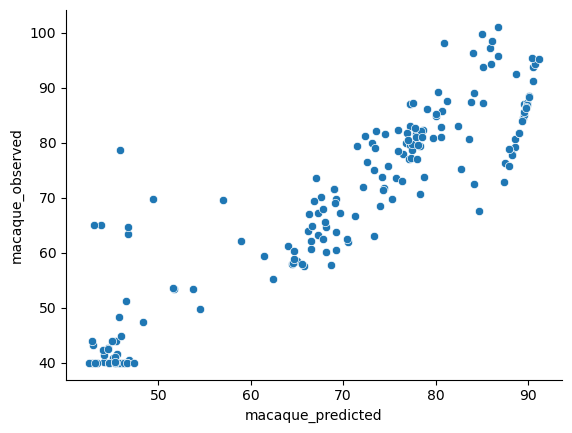

In [38]:
seaborn.scatterplot(x='macaque_predicted',y='macaque_observed',data=results_df)

In [39]:
results_df.index = list(results_df['cluster_region'])
scaled_displacements = results_df.loc[:,results_df.columns.str.contains('_dt')]
scaled_displacements.columns = scaled_displacements.columns.str.replace('_dt','')
# scaled_displacements = results_df.loc[:,results_df.columns.str.contains('_disp')]
# scaled_displacements.columns = scaled_displacements.columns.str.replace('_disp','')
melted_scaled_displacements = scaled_displacements.melt(ignore_index=False)
melted_scaled_displacements['region'] = melted_scaled_displacements.index.str.split('__').str[1]
melted_scaled_displacements['Initial_Class'] = melted_scaled_displacements.index.str.split('_[0-9]+__',regex=True).str[0]
melted_scaled_displacements['region_Initial_Class'] = melted_scaled_displacements['region'] +' '+ melted_scaled_displacements['Initial_Class']
melted_scaled_displacements['region'] = melted_scaled_displacements['region'].astype('category')
# melted_scaled_displacements['region'] = melted_scaled_displacements['region'].cat.reorder_categories(['HB','MB','DE','FB','Ctx'])
melted_scaled_displacements = melted_scaled_displacements.rename({'variable':'species','value':'dt_norm'},axis=1)
melted_scaled_displacements['region_Initial_Class'] = melted_scaled_displacements['region_Initial_Class'].astype('category')
melted_scaled_displacements['region_Initial_Class'] = melted_scaled_displacements['region_Initial_Class'].cat.reorder_categories(t_norm.groupby('region_Initial_Class')['t_norm'].mean().sort_values().index)

In [40]:
melted_scaled_displacements['dt_norm_scaled'] = melted_scaled_displacements.groupby('species')['dt_norm']                 \
                        .transform(lambda x: x / x.abs().mean())


In [41]:
cats = melted_scaled_displacements['region_Initial_Class'].cat.categories

# 1) define region priority
region_order = {'Ctx': 0, 'FB': 1, 'DE': 2, 'MB': 3, 'HB': 4}

def sort_key(cat):
    # split off region vs Initial_Class
    region, Initial_Class = cat.split(' ', 1)
    
    # 2) define Initial_Class grouping
    #   NPC only  → 0
    #   IPC       → 1
    #   Ependy    → 2
    #   OPC       → 3
    #   everything else → 4
    if 'NPC' in Initial_Class and 'IPC' not in Initial_Class:
        grp = 0
    elif 'IPC' in Initial_Class:
        grp = 1
    elif 'Ependy' in Initial_Class:
        grp = 2
    elif 'OPC' in Initial_Class:
        grp = 3
    else:
        grp = 4

    # return a tuple: (region_rank, Initial_Class_group, then Initial_Class name for tiebreaker)
    return (region_order.get(region, 5), grp, Initial_Class)

# sort all categories by our key
new_order = sorted(cats, key=sort_key)

# apply the new ordering
melted_scaled_displacements['region_Initial_Class'] = (
    melted_scaled_displacements['region_Initial_Class']
      .cat.reorder_categories(new_order, ordered=True)
)

melted_scaled_displacements['region'] = melted_scaled_displacements['region'].cat.reorder_categories(['Ctx', 'FB', 'DE', 'MB', 'HB'])


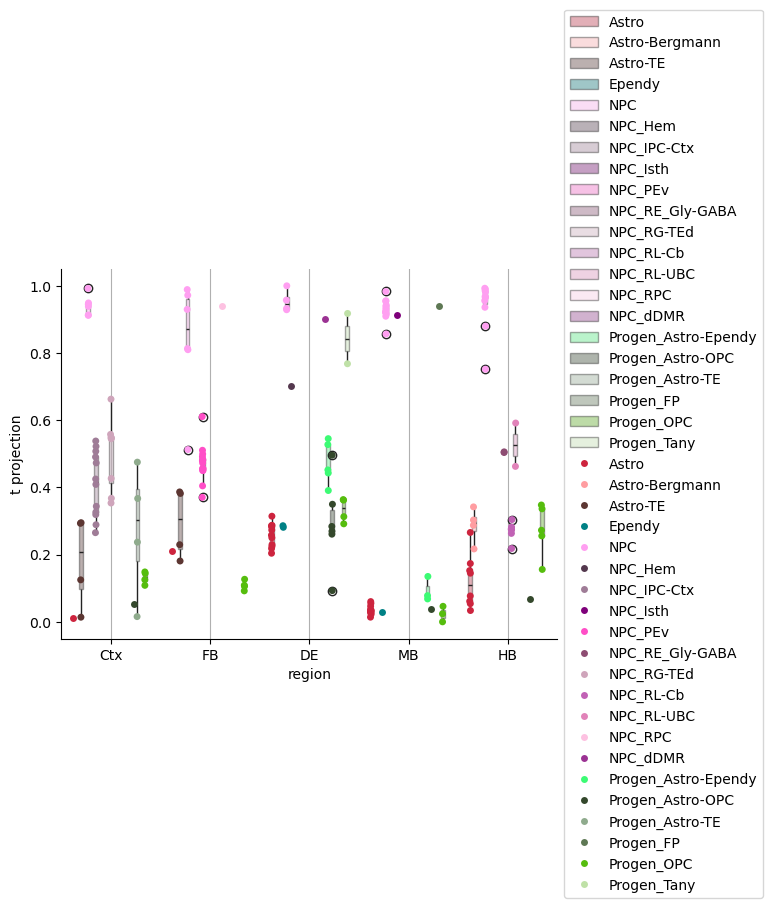

In [42]:
t_norm['Initial_Class'] = t_norm['Initial_Class'].astype('category')
data_colors = [adata.uns['Initial_Class_colors_dict'][x] for x in t_norm['Initial_Class'].cat.categories]
t_norm['region'] = t_norm['region'].cat.reorder_categories(sorted(t_norm['region'].cat.categories,key=region_order.get))

ax = seaborn.boxplot(data=t_norm,y='t_norm',x='region',hue='Initial_Class',palette=data_colors,boxprops={'alpha': 0.4})
ax = seaborn.stripplot(data=t_norm,y='t_norm',x='region',hue='Initial_Class',palette=data_colors,dodge=True)
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
plt.ylabel('t projection')
plt.xlabel('region')
ax.grid(axis='x')
plt.show()

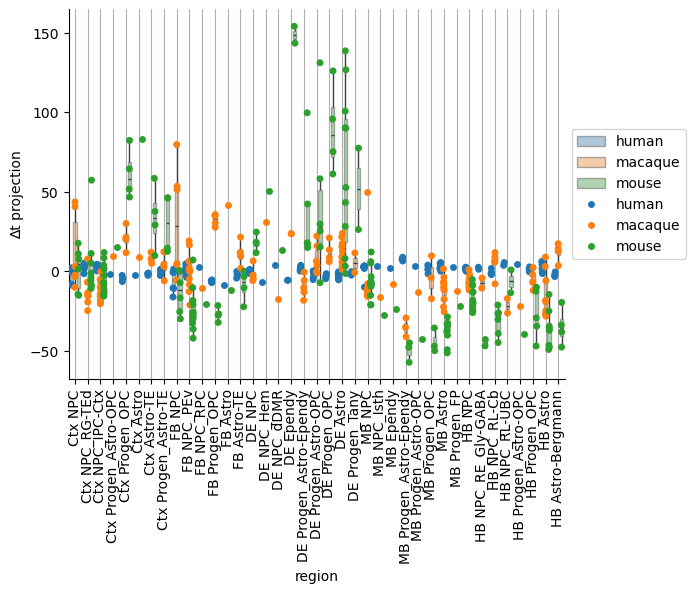

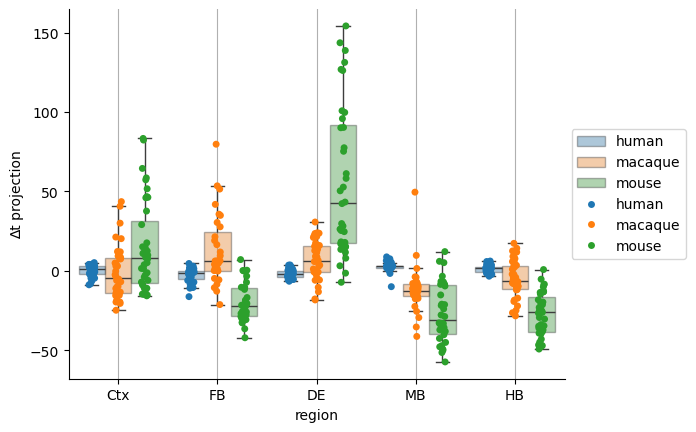

In [43]:
# #Not sure what this means, most displaced regions suggests 
# ax = seaborn.boxplot(data=melted_scaled_displacements,y='dt_norm',x='species',hue='region_Initial_Class')
# ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
# plt.ylabel('∆t projection')
# plt.xlabel('region')
# plt.show()


ax = seaborn.boxplot(data=melted_scaled_displacements,y='dt_norm',x='region_Initial_Class',hue='species',showfliers=False,boxprops={'alpha': 0.4})
# ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
# plt.xticks(rotation=90)
# plt.ylabel('∆t projection')
# plt.xlabel('region')
# ax.grid(axis='x')
# plt.show()

ax = seaborn.stripplot(data=melted_scaled_displacements,y='dt_norm',x='region_Initial_Class',hue='species',dodge=True)
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
plt.xticks(rotation=90)
plt.ylabel('∆t projection')
plt.xlabel('region')
ax.grid(axis='x')
plt.show()


ax = seaborn.boxplot(data=melted_scaled_displacements,y='dt_norm',x='region',hue='species',showfliers=False,boxprops={'alpha': 0.4})
# ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
# plt.ylabel('∆t projection')
# plt.xlabel('region')
# plt.show()

ax = seaborn.stripplot(data=melted_scaled_displacements,y='dt_norm',x='region',hue='species',dodge=True)
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
# plt.xticks(rotation=90)
plt.ylabel('∆t projection')
plt.xlabel('region')
ax.grid(axis='x')
plt.show()


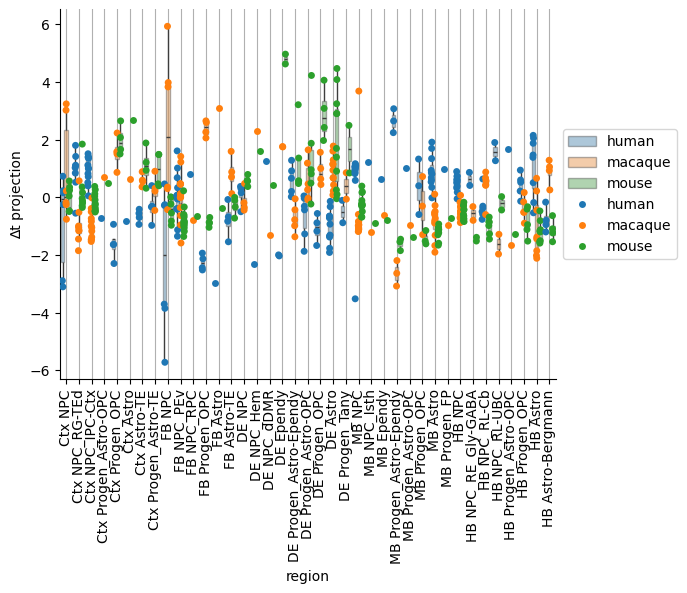

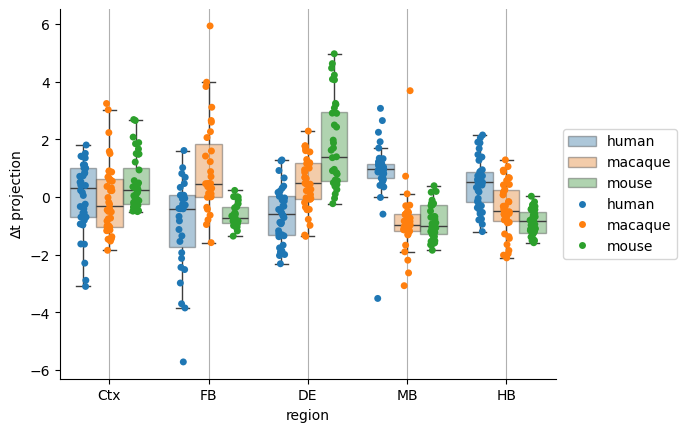

In [44]:
ax = seaborn.boxplot(data=melted_scaled_displacements,y='dt_norm_scaled',x='region_Initial_Class',hue='species',showfliers=False,boxprops={'alpha': 0.4})
# ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
# plt.xticks(rotation=90)
# plt.ylabel('∆t projection')
# plt.xlabel('region')
# ax.grid(axis='x')
# plt.show()

ax = seaborn.stripplot(data=melted_scaled_displacements,y='dt_norm_scaled',x='region_Initial_Class',hue='species',dodge=True)
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
plt.xticks(rotation=90)
plt.ylabel('∆t projection')
plt.xlabel('region')
ax.grid(axis='x')
plt.show()


ax = seaborn.boxplot(data=melted_scaled_displacements,y='dt_norm_scaled',x='region',hue='species',showfliers=False,boxprops={'alpha': 0.4})
# ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
# plt.ylabel('∆t projection')
# plt.xlabel('region')
# plt.show()

ax = seaborn.stripplot(data=melted_scaled_displacements,y='dt_norm_scaled',x='region',hue='species',dodge=True)
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
# plt.xticks(rotation=90)
plt.ylabel('∆t projection')
plt.xlabel('region')
ax.grid(axis='x')
plt.show()


In [45]:
adata.obs['cluster_region'] = adata.obs['Initial_Class_level_2'].astype(str) + '__' + adata.obs['simplified_region'].astype(str)


In [46]:
adata.obs['cluster_region']

TAGTATGTAATA_e14-WT8                                                                           NPC_PEv_2__Ctx
TTCGCATAGGTT_e14-WT8                                                                        Ctx_Allo_422__Ctx
CCTCCAATTGGC_e14-WT8                                                                        Ctx_Allo_161__Ctx
CACGATATCCAT_e14-WT8                                                                            VLMC_211__Ctx
CAGCCGCGCCCT_e14-WT8                                                                         Ctx_Allo_61__Ctx
                                                                                               ...           
SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_musculus_RNA-Seq_kOut_GTTTCTATCAGTTAGC             Ctx_IT_418__Ctx
SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_musculus_RNA-Seq_kOut_TGTGTTTGTAGCGTAG           Ctx_L5ET_576__Ctx
SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_musculus_RNA-Seq_kOut_TACTCATCACCAGATT              Ctx_IT_89__Ctx
SRR1208276

# Run 5-2

...

# Bring in 5-2

In [47]:
# adata = sc.read_h5ad(os.path.join(model_path,'analysis_inprogress.h5ad'),backed='r')

In [48]:
counts_pivot = pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/progenitor_timepoint_counts.tsv',sep='\t',index_col=0)
counts_pivot_meta = pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/progenitor_timepoint_counts_meta.tsv',sep='\t',index_col=0)

samples = counts_pivot.index.intersection(counts_pivot_meta.index)
counts_df = counts_pivot.loc[samples]
meta_df = counts_pivot_meta.loc[samples]

states  = counts_df.columns.tolist()
species = meta_df["species"].astype("category").cat.categories.tolist()

counts = torch.tensor(counts_df.values, dtype=torch.float)

## Load saved params
out_path = '/home/matthew.schmitz/Matthew/data/taxtest/annotations/composition_model/'
pyro.get_param_store().load(os.path.join(out_path,'composition_model_param_store.pstore'),map_location=torch.device('cpu'))

param_arrays = {}
arrays = [
    'mu_post',
    'sigma_rise_post',
    'sigma_fall_post',
    'A_post',
    'a_post',
    'b_post',
    'delta_t_post',
    'delta_h_post',
    'rho_post',
    'region_probs'
]

for name in arrays:
    param_arrays[name] = np.load(os.path.join(out_path,f'{name}.npy'))

mu_post,sigma_rise_post,sigma_fall_post,A_post,a_post,b_post,delta_t_post,delta_h_post,rho_post,region_probs = param_arrays.values()
region_probs_df = pd.DataFrame(region_probs, index=counts_df.index)

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/pyro/params/param_store.py:334: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s

/scratch/fast/3608344/ipykernel_2533973/1286795400.py:28: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  com_grid = np.trapz(tau_grid[:,None] * pi_grid, x=tau_grid, axis=0) \
/scratch/fast/3608344/ipykernel_2533973/1286795400.py:29: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  / np.trapz(pi_grid, x=tau_grid, axis=0)
/scratch/fast/3608344/ipykernel_2533973/1286795400.py:35: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  auc_grid = np.trapz(pi_grid, x=tau_grid, axis=0)
/scratch/fast/3608344/ipykernel_2533973/1286795400.py:28: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  com_grid = np.trapz(tau_grid[:,None] * pi_grid, x=tau_gri

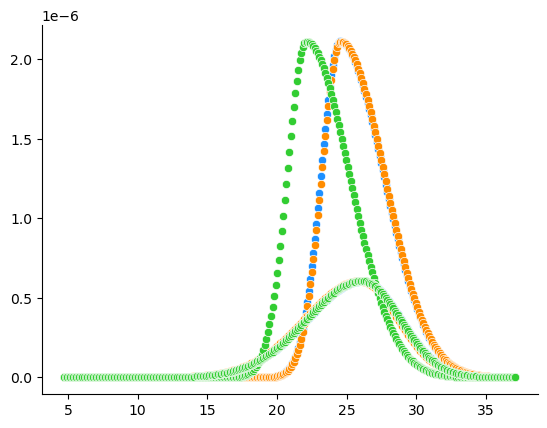

In [49]:
results = []
regions = meta_df["simplified_region"].unique()
N_arr   = meta_df["total_count"].values
t_raw   = meta_df["timepoint"].values  # raw time
meta_df['species'] = meta_df['species'].astype('category')

t_recons = (a_post * t_raw[:,None] + b_post)[list(range(len(meta_df['species'].cat.codes))),meta_df['species'].cat.codes]
t_min = t_recons.min()  # over all species
t_max = t_recons.max()
tau_grid = np.linspace(t_min, t_max, 300)   # common grid for every state

for j, sp in enumerate(species):
    # 1) compute pi_pred on the fixed tau_grid
    #    shape [G, S] where G = len(tau_grid)
    τg = tau_grid[:, None]                   # [G,1]
    mu_js  = mu_post[None, :] + delta_t_post[j][None, :]
    z2     = (τg - mu_js)**2
    sigma  = np.where(τg < mu_js,
                     sigma_rise_post[None, :],
                     sigma_fall_post[None, :])  # [G, S]
    log_time = A_post[None, :] - z2/(2*sigma**2)
    logits   = np.log(region_probs_df.values @ rho_post + 1e-12).mean(0)[None,:] + log_time
    # pi_grid  = scipy.special.softmax(logits, axis=1)  # [G, S]
    pi_grid  = np.exp(logits)  # [G, S]

    # 2) COM on the uniform grid
    #    ∫ τ π(τ) dτ   /  ∫ π(τ) dτ
    com_grid = np.trapz(tau_grid[:,None] * pi_grid, x=tau_grid, axis=0) \
               / np.trapz(pi_grid, x=tau_grid, axis=0)

    seaborn.scatterplot(x=tau_grid,y=pi_grid[:,120],color=adata.uns['species_colors'][j])
    seaborn.scatterplot(x=tau_grid,y=pi_grid[:,110],color=adata.uns['species_colors'][j])
    
    # 3) AUC on the same grid
    auc_grid = np.trapz(pi_grid, x=tau_grid, axis=0)

    for s_idx, st in enumerate(states):
        results.append({
            "species":  sp,
            "state":    st,
            "com_grid": com_grid[s_idx],
            "com_grid_realized": (com_grid[s_idx]-b_post[j])/a_post[j] ,
            "auc_grid": auc_grid[s_idx],
            # keep your old sample‐based COM too, if desired:
            # "com_sample": com_s[s_idx]
        })

com_df_grid = pd.DataFrame(results)
com_df_grid['dt'] = delta_t_post.flatten()

<Axes: xlabel='species', ylabel='com_grid'>

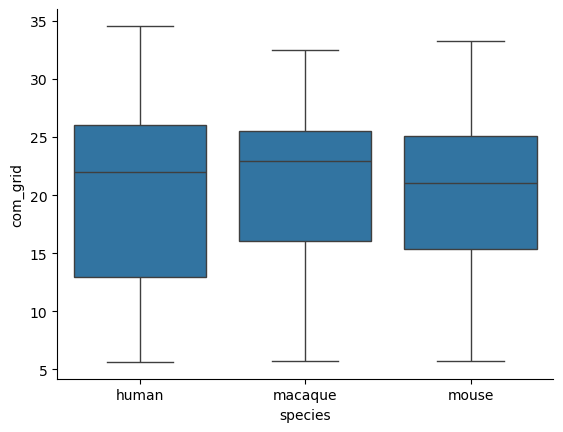

In [50]:
seaborn.boxplot(x='species',y='com_grid',data=com_df_grid)

<Axes: xlabel='species', ylabel='com_grid_realized'>

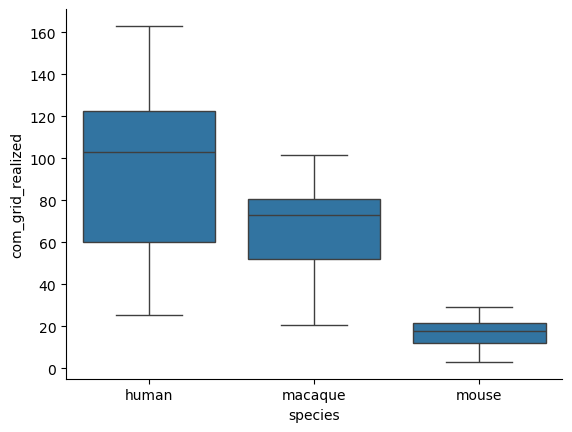

In [51]:
seaborn.boxplot(x='species',y='com_grid_realized',data=com_df_grid)

In [52]:
## Load saved params
out_path = '/home/matthew.schmitz/Matthew/data/taxtest/annotations/composition_model/'
pyro.get_param_store().load(os.path.join(out_path,'composition_model_param_store.pstore'),map_location=torch.device('cpu'))

param_arrays = {}
arrays = [
    'mu_post',
    'sigma_rise_post',
    'sigma_fall_post',
    'A_post',
    'a_post',
    'b_post',
    'delta_t_post',
    'delta_h_post',
    'rho_post',
    'region_probs'
]

for name in arrays:
    param_arrays[name] = np.load(os.path.join(out_path,f'{name}.npy'))

mu_post,sigma_rise_post,sigma_fall_post,A_post,a_post,b_post,delta_t_post,delta_h_post,rho_post,region_probs = param_arrays.values()
com_df = pd.read_csv(os.path.join(out_path,'model_fit_com_df.tsv'),sep='\t',index_col=0)
print(com_df)
com_df['com_grid'] = com_df_grid['com_grid']
com_df['com_grid_realized'] = com_df_grid['com_grid_realized']
cpic = counts_pivot.columns.str.replace('_[0-9]+__.+','',regex=True)
progen_inds = ~cpic.isin(glia)&~cpic.str.contains('Isth|_FP|_RPC|_Tany|_Hem|Progen_Astro-Bergmann')
mu_post,sigma_rise_post,sigma_fall_post,A_post,delta_t_post,delta_h_post,rho_post = mu_post[progen_inds],sigma_rise_post[progen_inds],sigma_fall_post[progen_inds],A_post[progen_inds],delta_t_post[:,progen_inds],delta_h_post[:,progen_inds],rho_post[:,progen_inds]

com_progen_inds = ~com_df['Initial_Class'].isin(glia)&~com_df['state'].str.contains('Isth|_FP|_RPC|_Tany|_Hem|Progen_Astro-Bergmann')
com_df = com_df.loc[com_progen_inds,:]
print(com_df)
states  = list(com_df['state'].unique())


     species                   state         mu   com_time       auc  \
0      human  Astro-Bergmann_167__HB  15.003866  23.675381  0.188478   
1      human  Astro-Bergmann_181__HB  21.887260  21.026757  0.074204   
2      human  Astro-Bergmann_290__HB  14.757807  22.801212  0.404213   
3      human  Astro-Bergmann_589__HB  13.825977  21.450915  0.079843   
4      human   Astro-Bergmann_72__HB  14.513431  22.618371  0.217742   
...      ...                     ...        ...        ...       ...   
1633   mouse      Progen_OPC_542__HB  18.985638  19.562848  0.013284   
1634   mouse      Progen_OPC_542__MB  17.416370  31.459337  0.007966   
1635   mouse     Progen_Tany_203__DE   8.956114  14.342978  0.056751   
1636   mouse     Progen_Tany_293__DE  17.059692  16.465101  0.087108   
1637   mouse     Progen_Tany_515__DE   6.349956  14.657049  0.187590   

            dt        dh  com_realized  mu_realized   Initial_Class region  
0     2.362095  6.823068      5.296176     3.474014  Astro

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/pyro/params/param_store.py:334: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s

In [53]:
plot_groups = [re.sub('__[A-Za-z]+','',x) for x in states]

In [54]:
plot_Initial_Class_groups = list(set([re.sub('_[0-9]+','',x) for x in plot_groups]))

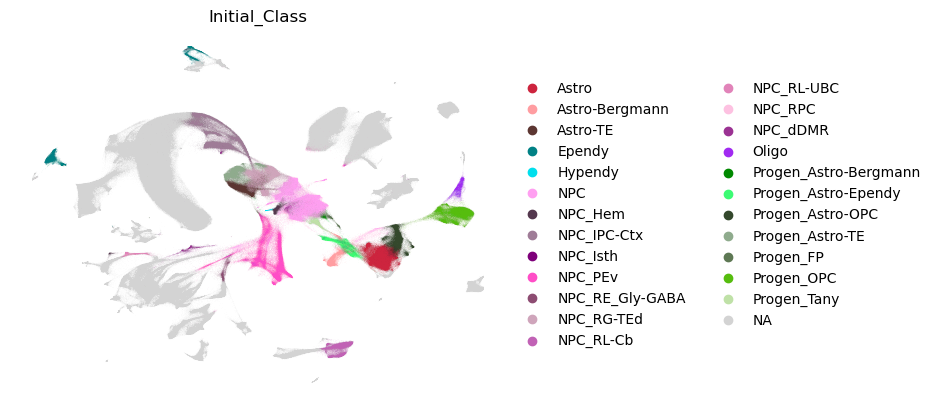

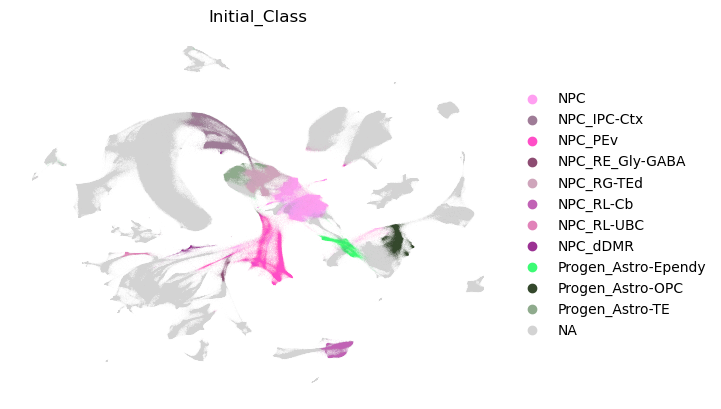

In [55]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['Initial_Class'],groups=list(set(cpic)),frameon=False,save='_progenitor_glia_Initial_Class.pdf'
)

sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['Initial_Class'],groups=plot_Initial_Class_groups,frameon=False,save='_progenitor_Initial_Class.pdf'
)

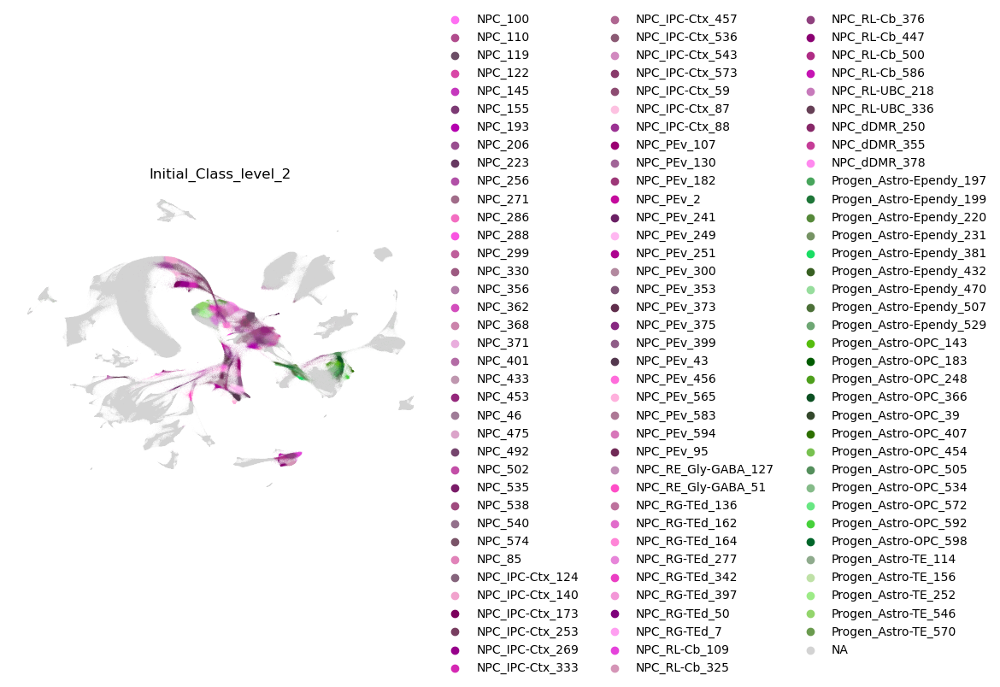

In [56]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['Initial_Class_level_2'],groups=plot_groups,frameon=False,save='_progenitor_Initial_Class_level_2.pdf'
)

In [57]:
results_df.index = list(results_df['cluster_region'])
real_com_df = results_df.loc[:,results_df.columns.str.contains('_observed')]
real_com_df.columns = real_com_df.columns.str.replace('_observed','')
real_com_df = real_com_df.melt(ignore_index=False)
real_com_df['region'] = real_com_df.index.str.split('__').str[1]
real_com_df['Initial_Class'] = real_com_df.index.str.split('_[0-9]+__',regex=True).str[0]
real_com_df['region_Initial_Class'] = real_com_df['region'] +' '+ real_com_df['Initial_Class']
real_com_df['region_Initial_Class'] = real_com_df['region_Initial_Class'].astype('category')
# melted_scaled_displacements['region'] = melted_scaled_displacements['region'].cat.reorder_categories(['HB','MB','DE','FB','Ctx'])
real_com_df = real_com_df.rename({'variable':'species','value':'com_time'},axis=1)
real_com_df['region_Initial_Class'] = real_com_df['region_Initial_Class'].cat.reorder_categories(t_norm.groupby('region_Initial_Class')['t_norm'].mean().sort_values().index)
real_com_df['state'] = list(real_com_df.index)
real_com_df.index = real_com_df['state'] + real_com_df['species']
com_df['species_state'] = com_df['state'] + com_df['species']
com_df.index = list(com_df['species_state'])


In [58]:
shared_specstate = list(set(com_df.index) & set(real_com_df.index))

In [59]:
merged_coms = pd.merge(com_df,real_com_df,left_index=True, right_index=True,suffixes = ('', '_real'))

In [60]:
merged_coms

,species,state,mu,com_time,auc,dt,dh,com_realized,mu_realized,Initial_Class,region,com_grid,com_grid_realized,species_state,species_real,com_time_real,region_real,Initial_Class_real,region_Initial_Class,state_real
NPC_110__FBhuman,human,NPC_110__FB,19.918163,14.962182,0.016879,0.756042,4.139668,3.465255,4.506665,NPC,FB,19.169664,89.698107,NPC_110__FBhuman,human,60.591173,FB,NPC,FB NPC,NPC_110__FB
NPC_119__Ctxhuman,human,NPC_119__Ctx,11.603688,10.721572,0.235516,0.048359,2.152013,2.574167,2.759528,NPC,Ctx,11.540164,53.389978,NPC_119__Ctxhuman,human,47.949449,Ctx,NPC,Ctx NPC,NPC_119__Ctx
NPC_155__HBhuman,human,NPC_155__HB,9.871317,8.031376,0.022067,0.004983,8.666053,2.008871,2.395501,NPC,HB,9.964453,45.891303,NPC_155__HBhuman,human,46.445359,HB,NPC,HB NPC,NPC_155__HB
NPC_155__MBhuman,human,NPC_155__MB,9.711940,7.395248,0.060999,-2.188177,7.608759,1.875200,2.362011,NPC,MB,8.960245,41.112364,NPC_155__MBhuman,human,52.152179,MB,NPC,MB NPC,NPC_155__MB
NPC_193__FBhuman,human,NPC_193__FB,21.780935,11.814941,0.013887,7.870209,2.599664,2.803919,4.898093,NPC,FB,19.600412,91.748000,NPC_193__FBhuman,human,60.167200,FB,NPC,FB NPC,NPC_193__FB
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Progen_Astro-OPC_598__DEmouse,mouse,Progen_Astro-OPC_598__DE,24.853100,20.759127,0.018570,-1.332300,0.036612,24.519644,28.851559,Progen_Astro-OPC,DE,24.288890,20.541048,Progen_Astro-OPC_598__DEmouse,mouse,19.481388,DE,Progen_Astro-OPC,DE Progen_Astro-OPC,Progen_Astro-OPC_598__DE
Progen_Astro-TE_114__Ctxmouse,mouse,Progen_Astro-TE_114__Ctx,24.493828,25.185590,0.772146,-0.838946,5.269964,29.203372,28.471405,Progen_Astro-TE,Ctx,24.951354,21.167124,Progen_Astro-TE_114__Ctxmouse,mouse,23.094783,Ctx,Progen_Astro-TE,Ctx Progen_Astro-TE,Progen_Astro-TE_114__Ctx
Progen_Astro-TE_252__Ctxmouse,mouse,Progen_Astro-TE_252__Ctx,22.089397,22.921645,0.388521,1.748006,2.461358,26.807847,25.927230,Progen_Astro-TE,Ctx,23.195394,19.507615,Progen_Astro-TE_252__Ctxmouse,mouse,21.215629,Ctx,Progen_Astro-TE,Ctx Progen_Astro-TE,Progen_Astro-TE_252__Ctx
Progen_Astro-TE_546__Ctxmouse,mouse,Progen_Astro-TE_546__Ctx,16.802685,20.505699,0.055727,-1.448567,3.199518,24.251487,20.333256,Progen_Astro-TE,Ctx,19.212829,15.743801,Progen_Astro-TE_546__Ctxmouse,mouse,17.750186,Ctx,Progen_Astro-TE,Ctx Progen_Astro-TE,Progen_Astro-TE_546__Ctx


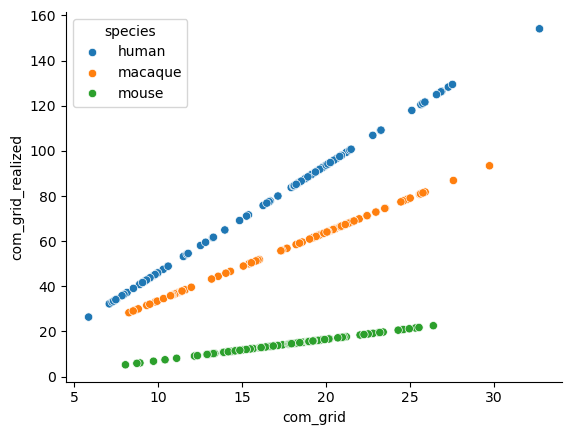

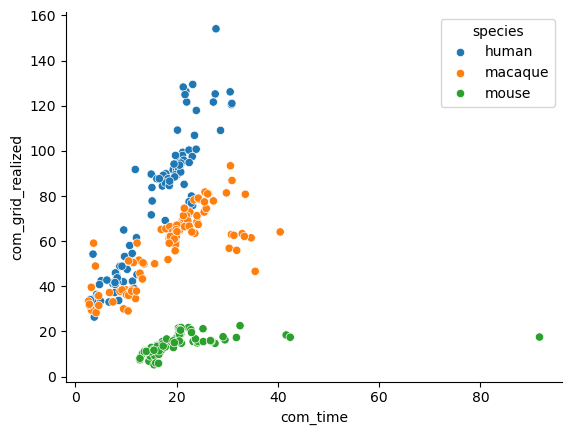

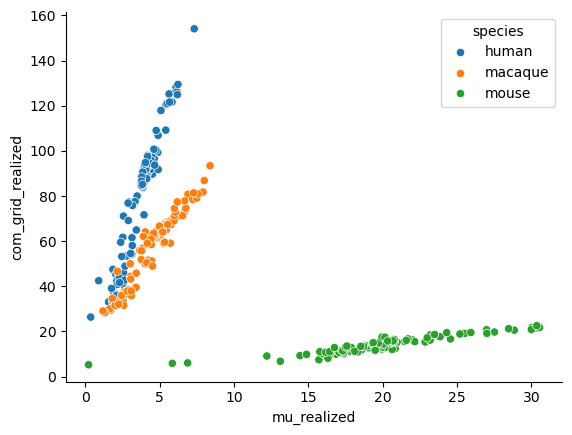

In [61]:
seaborn.scatterplot(x='com_grid',y='com_grid_realized',hue='species',data = merged_coms)
plt.show()
seaborn.scatterplot(x='com_time',y='com_grid_realized',hue='species',data = merged_coms)
plt.savefig(os.path.join(sc.settings.figdir, 'realcom_vs_com.svg'))
plt.show()

seaborn.scatterplot(x='mu_realized',y='com_grid_realized',hue='species',data = merged_coms)
plt.savefig(os.path.join(sc.settings.figdir, 'realcom_vs_mu.svg'))
plt.show()

In [62]:
results_df.index = list(results_df['cluster_region'])
real_com_df = results_df.loc[:,results_df.columns.str.contains('dt')]
real_com_df.columns = real_com_df.columns.str.replace('_dt','')
real_com_df = real_com_df.melt(ignore_index=False)
real_com_df['region'] = real_com_df.index.str.split('__').str[1]
real_com_df['Initial_Class'] = real_com_df.index.str.split('_[0-9]+__',regex=True).str[0]
real_com_df['region_Initial_Class'] = real_com_df['region'] +' '+ real_com_df['Initial_Class']
real_com_df['region_Initial_Class'] = real_com_df['region_Initial_Class'].astype('category')
# melted_scaled_displacements['region'] = melted_scaled_displacements['region'].cat.reorder_categories(['HB','MB','DE','FB','Ctx'])
real_com_df = real_com_df.rename({'variable':'species','value':'dt'},axis=1)
real_com_df['region_Initial_Class'] = real_com_df['region_Initial_Class'].cat.reorder_categories(t_norm.groupby('region_Initial_Class')['t_norm'].mean().sort_values().index)
real_com_df['state'] = list(real_com_df.index)
real_com_df.index = real_com_df['state'] + real_com_df['species']

<Axes: xlabel='com_time', ylabel='dt'>

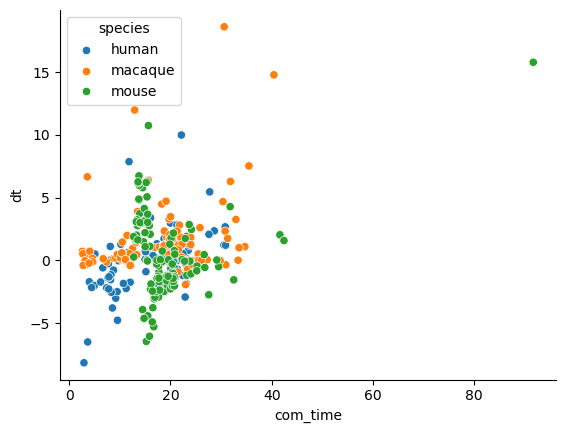

In [63]:
merged_coms = pd.merge(com_df,real_com_df,left_index=True, right_index=True,suffixes = ('', '_real'))
seaborn.scatterplot(x='com_time',y='dt',hue='species',data = merged_coms)

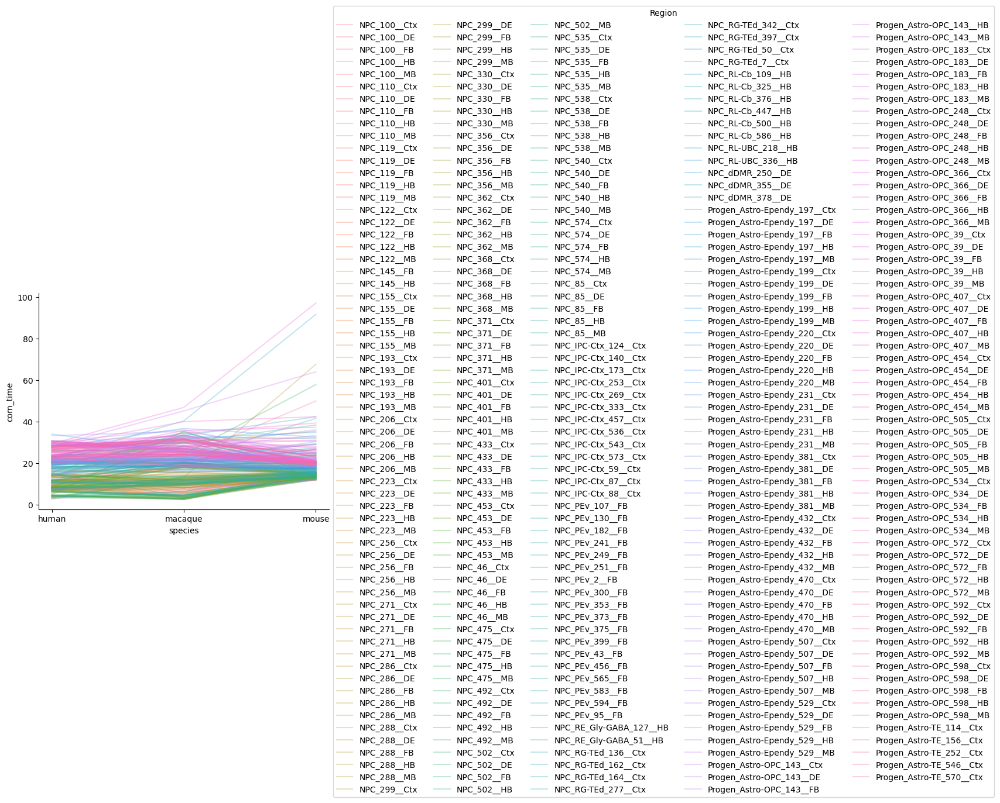

In [64]:
seaborn.lineplot(data=com_df,x='species',y='com_time',hue='state',alpha=0.3)
plt.legend(title="Region",loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=5)

In [65]:
adata = adata[adata.obs['cluster_region'].isin(states),:]
adata.obs['simplified_region'] = adata.obs['simplified_region'].cat.reorder_categories(['HB','MB','DE','FB','Ctx'])

special_cortex = adata.obs['region'].isin(['Ctx-PFC','Ctx-MOp','Ctx-Somato','Ctx-Par','Ctx-Occ'])
ctxdata = adata[special_cortex,:]
ctxdata.obs.loc[:,'cluster_region'] = ctxdata.obs.loc[:,'cluster_region'].astype(str) + '--' +ctxdata.obs.loc[:,'region'].astype(str)

latent_aggr_means = antipode.model_functions.group_aggr_anndata(adata,['species','cluster_region'],layer='X_antipode',obsm=True,normalize=False)
latent_means = xr.DataArray(latent_aggr_means[0],dims=['species','cluster_region','var'],coords={'species':latent_aggr_means[1]['species'],'cluster_region':latent_aggr_means[1]['cluster_region'],'var':list(range(latent_aggr_means[0].shape[-1]))})

latent_aggr_means = antipode.model_functions.group_aggr_anndata(adata,['species','cluster_region'],layer='spliced',normalize=True)
gene_means = xr.DataArray(latent_aggr_means[0],dims=['species','cluster_region','var'],coords={'species':latent_aggr_means[1]['species'],'cluster_region':latent_aggr_means[1]['cluster_region'],'var':ctxdata.var.index})



/scratch/fast/3608344/ipykernel_2533973/2820517193.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['simplified_region'] = adata.obs['simplified_region'].cat.reorder_categories(['HB','MB','DE','FB','Ctx'])
/scratch/fast/3608344/ipykernel_2533973/2820517193.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['Progen_Astro-TE_252__Ctx--Ctx-MOp' 'Progen_Astro-TE_546__Ctx--Ctx-MOp'
 'Progen_Astro-TE_114__Ctx--Ctx-MOp' ... 'NPC_RG-TEd_162__Ctx--Ctx-Occ'
 'Progen_Astro-TE_546__Ctx--Ctx-Occ' 'NPC_RG-TEd_136__Ctx--Ctx-Occ']' has dtype incompatible with category, please explicitly cast to a compatible dtype first.
  ctxdata.obs.loc[:,'cluster_region'] = ctxdata.obs.loc[:,'cluster_region'].astype(str) + '--' +ctxdata.obs.loc[:,'region'].astype(str)
100%|██████████| 942/942 [01:09<00:00, 13.49it/s]


In [66]:
shared_states = list(set(com_df['state']) & set(latent_means.coords['cluster_region'].values))
latent_means = latent_means.sel(cluster_region=shared_states)
gene_means = gene_means.sel(cluster_region=shared_states)


In [67]:
sort_dict = dict(zip(latent_means.coords['cluster_region'].values,list(range(len(latent_means.coords['cluster_region'].values)))))

In [68]:
arr = []
for s in species:
    arr.append(com_df.sort_values('state').loc[com_df['species']==s,'com_grid'])
fit_com_array = xr.DataArray(np.stack(arr,axis=0),coords={'species':species,'cluster_region':com_df['state'].sort_values().unique()}).sel(cluster_region=shared_states)

arr = []
for s in species:
    arr.append(com_df.sort_values('state').loc[com_df['species']==s,'com_grid_realized'])
fit_realized_com_array = xr.DataArray(np.stack(arr,axis=0),coords={'species':species,'cluster_region':com_df['state'].sort_values().unique()}).sel(cluster_region=shared_states)


arr = []
for s in species:
    arr.append(com_df.sort_values('state').loc[com_df['species']==s,'mu'])
fit_mu_array = xr.DataArray(np.stack(arr,axis=0),coords={'species':species,'cluster_region':com_df['state'].sort_values().unique()}).sel(cluster_region=shared_states)

arr = []
for s in species:
    arr.append(com_df.sort_values('state').loc[com_df['species']==s,'mu_realized'])
fit_realized_mu_array = xr.DataArray(np.stack(arr,axis=0),coords={'species':species,'cluster_region':com_df['state'].sort_values().unique()}).sel(cluster_region=shared_states)


arr = []
for s in species:
    arr.append(com_df.sort_values('state').loc[com_df['species']==s,'auc'])
fit_auc_array = xr.DataArray(np.stack(arr,axis=0),coords={'species':species,'cluster_region':com_df['state'].sort_values().unique()}).sel(cluster_region=shared_states)


fit_dt_array = xr.DataArray(delta_t_post,coords={'species':species,'cluster_region':states}).sel(cluster_region=shared_states)
fit_dh_array = xr.DataArray(delta_h_post,coords={'species':species,'cluster_region':states}).sel(cluster_region=shared_states)

In [69]:
latent_aggr_means = antipode.model_functions.group_aggr_anndata(ctxdata,['species','Initial_Class_level_2','region'],layer='X_antipode',obsm=True,normalize=False)
ctx_latent_means = xr.DataArray(latent_aggr_means[0],dims=['species','Initial_Class_level_2','region','var'],coords={'species':latent_aggr_means[1]['species'],'Initial_Class_level_2':latent_aggr_means[1]['Initial_Class_level_2'],'region':latent_aggr_means[1]['region'],'var':list(range(latent_aggr_means[0].shape[-1]))})

latent_aggr_means = antipode.model_functions.group_aggr_anndata(ctxdata,['species','Initial_Class_level_2','region'],layer='spliced',normalize=True)
ctx_gene_means = xr.DataArray(latent_aggr_means[0],dims=['species','Initial_Class_level_2','region','var'],coords={'species':latent_aggr_means[1]['species'],'Initial_Class_level_2':latent_aggr_means[1]['Initial_Class_level_2'],'region':latent_aggr_means[1]['region'],'var':ctxdata.var.index})


100%|██████████| 770/770 [00:22<00:00, 33.91it/s] 


In [70]:
# corrs = np.empty([ctx_gene_means.shape[0],ctx_gene_means.shape[1],ctx_gene_means.shape[3]])
# corrs[:] = np.nan
# order = np.array(list(range(ctx_gene_means.shape[2])))
# for i in range(ctx_gene_means.shape[0]):
#     for j in tqdm.tqdm(range(ctx_gene_means.shape[1])):
#         for k in range(ctx_gene_means.shape[3]):
#             corrs[i,j,k] = scipy.stats.spearmanr(ctx_gene_means[i,j,:,k],order).statistic

# ctx_scores = np.nanmean(np.nanmean(corrs,0),0)
# ctx_scores = pd.Series(ctx_scores,index=ctxdata.var.index)

# seaborn.histplot(ctx_scores)
# plt.show()
# print(ctx_scores.fillna(0.).sort_values())

In [71]:
import numpy as np

# assume ctx_gene_means is an xarray DataArray with dims (i,j,gene,k)
arr = ctx_gene_means.values
n0,n1,n2,n3 = arr.shape

# 1) reshape to 2D: (i,j,k) flattened × gene
flat = arr.transpose(0,1,3,2).reshape(-1, n2)

# 2) precompute order statistics
order = np.array([0,1,1,2,3])#np.arange(n2)
order_cent = order - order.mean()
order_norm = np.sqrt((order_cent**2).sum())

# 3) compute zero‐based ranks along axis=1
tmp = np.argsort(flat, axis=1)
ranks = np.argsort(tmp, axis=1)

# 4) center ranks
ranks_cent = ranks - ranks.mean(axis=1, keepdims=True)

# 5) numerator = 〈ranks_cent, order_cent〉
num = ranks_cent.dot(order_cent)

# 6) denominator = ||ranks_cent|| × ||order_cent||
den = np.sqrt((ranks_cent**2).sum(axis=1)) * order_norm

# 7) spearman‐ρ for each flattened (i,j,k)
rho_flat = num / den

# 8) reshape back to (i,j,k)
corrs = rho_flat.reshape(n0, n1, n3)


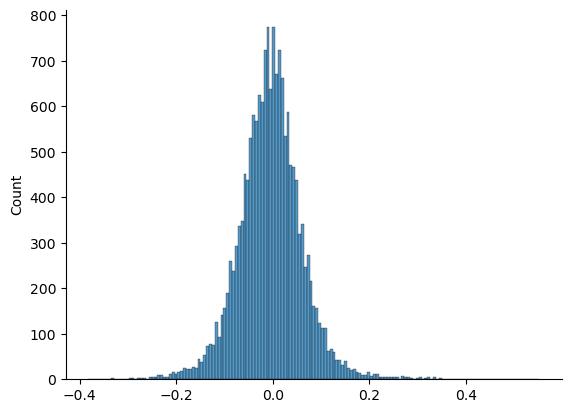

EFNA5     -0.381807
FZD3      -0.353892
DCT       -0.337683
PPP2R2B   -0.333180
ZIC3      -0.332280
             ...   
RPS21      0.349389
RPS28      0.372802
RPL35A     0.420528
FGFR3      0.482661
NR2F1      0.551999
Length: 16738, dtype: float64


In [72]:
order = xr.DataArray(
    np.array([0,1,1,2,3]),#np.arange(ctx_gene_means.sizes['region']),
    dims=['region']
)

# 2) rank along “region” (average method, ties→mean rank)
ranks = (ctx_gene_means+np.random.randn(*ctx_gene_means.shape)*1e-9).rank(dim='region')

# 3) compute Pearson correlation of those ranks vs. order
corrs = xr.corr(ranks, order, dim='region')
ctx_scores = np.nanmean(np.nanmean(corrs,0),0)
ctx_scores = pd.Series(ctx_scores,index=ctxdata.var.index)
seaborn.histplot(ctx_scores)
plt.show()
print(ctx_scores.fillna(0.).sort_values())

In [73]:
# dt_array = xr.DataArray(np.stack([results_df[f'{sp}_dt'] for sp in species],axis=0),coords={'species':latent_means.coords['cluster_region'].values,'cluster_region':latent_means.coords['cluster_region'].values})
actual_shared = list(set(scaled_displacements.index) & set(latent_means.coords['cluster_region'].values))
dt_array = xr.DataArray(scaled_displacements.to_numpy().T,coords={'species':latent_means.coords['species'].values,'cluster_region':scaled_displacements.index})
observed_array = xr.DataArray(np.stack([results_df[f'{sp}_observed'] for sp in species],axis=0),coords={'species':latent_means.coords['species'].values,'cluster_region':results_df['cluster_region']})


In [74]:
npc_names = observed_array.coords['cluster_region'].data[~pd.Series(observed_array.coords['cluster_region']).str.contains('Progen')]


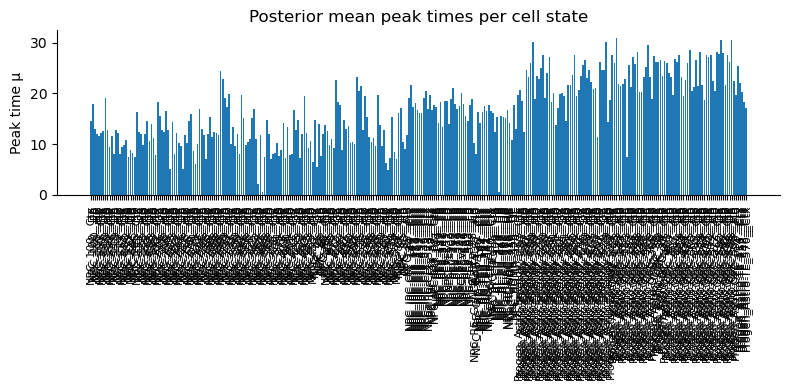

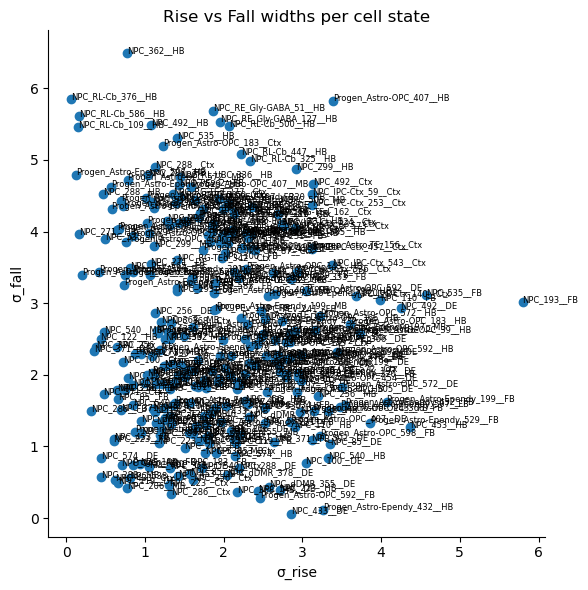

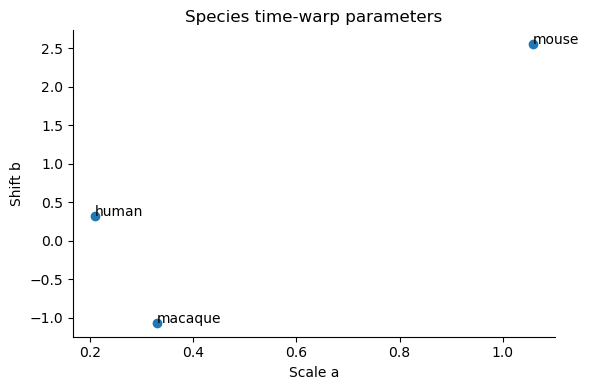

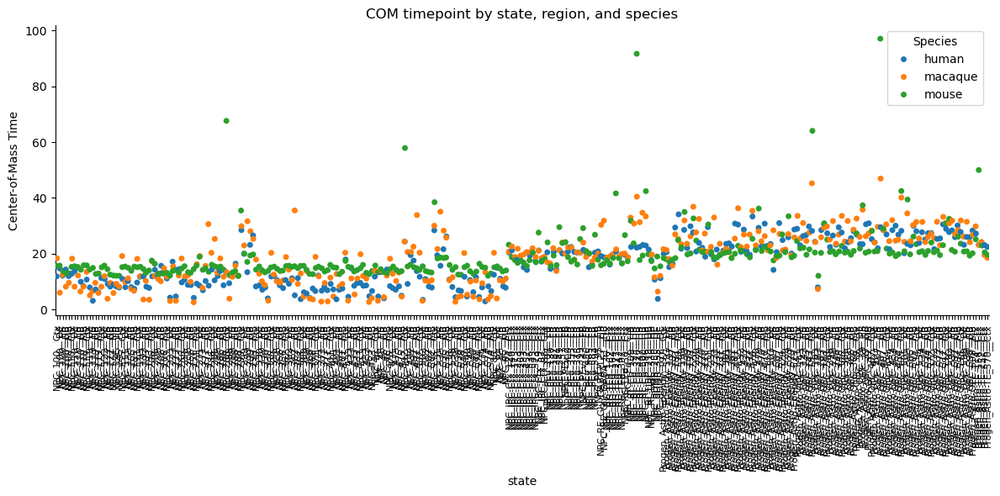

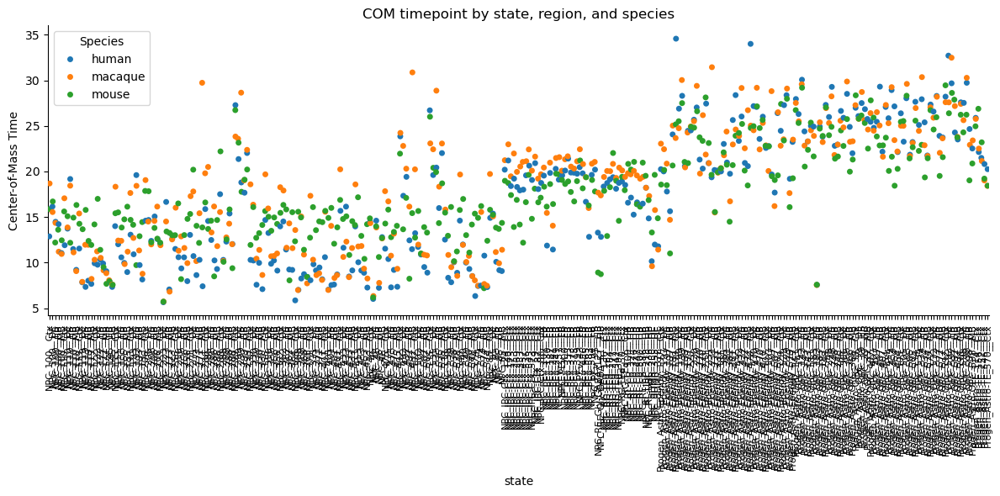

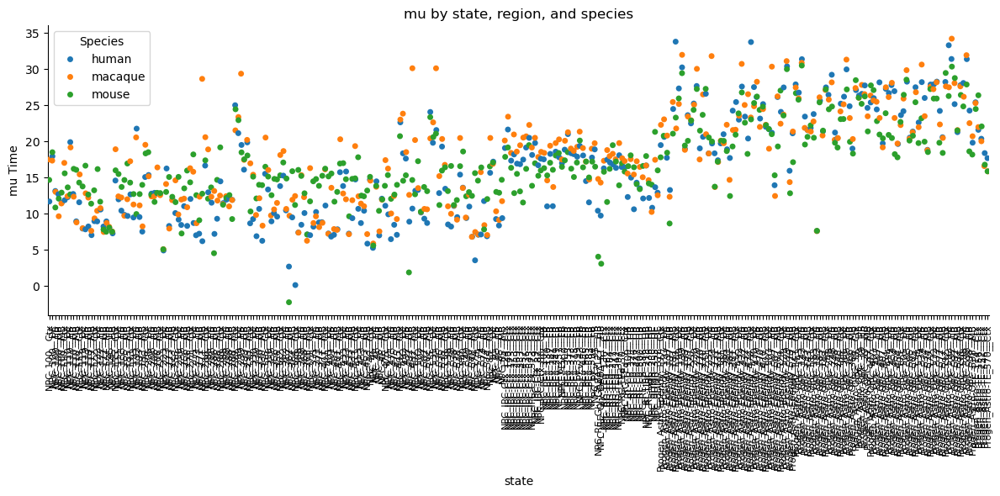

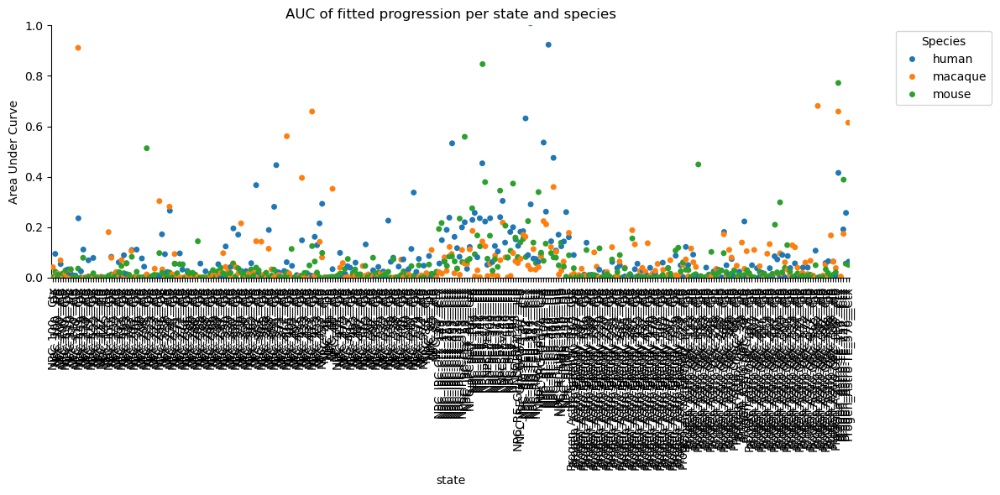

In [75]:
# Per-sample region mixture (from pyro.param)
region_probs = torch.softmax(pyro.param("region_logits"), dim=-1).detach().cpu().numpy()
region_probs_df = pd.DataFrame(region_probs, index=counts_df.index)  # [N, R]

# 2. Plot fitted peak times (mu) for each state
plt.figure(figsize=(8, 4))
plt.bar(states, mu_post)
plt.xticks(rotation=90, fontsize=8)
plt.ylabel("Peak time μ")
plt.title("Posterior mean peak times per cell state")
plt.tight_layout()
plt.show()

# 3. Plot rise vs. fall widths
plt.figure(figsize=(6, 6))
plt.scatter(sigma_rise_post, sigma_fall_post)
for i, st in enumerate(states):
    plt.text(sigma_rise_post[i], sigma_fall_post[i], st, fontsize=6)
plt.xlabel("σ_rise")
plt.ylabel("σ_fall")
plt.title("Rise vs Fall widths per cell state")
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir,'rise_fall_scatter.svg'))
plt.show()

# 4. Plot species time-warp parameters
plt.figure(figsize=(6, 4))
plt.scatter(a_post, b_post)
for j, sp in enumerate(species):
    plt.text(a_post[j], b_post[j], sp)
plt.xlabel("Scale a")
plt.ylabel("Shift b")
plt.title("Species time-warp parameters")
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir,'species_warp.svg'))
plt.show()



plt.figure(figsize=(12, 6))
seaborn.stripplot(data=com_df, x="state", y="com_time", hue="species")
plt.xticks(rotation=90, fontsize=8)
plt.ylabel("Center-of-Mass Time")
plt.title("COM timepoint by state, region, and species")
plt.legend(title="Species")
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir,'model_fit_com.svg'))
plt.show()


plt.figure(figsize=(12, 6))
seaborn.stripplot(data=com_df, x="state", y="com_grid", hue="species")
plt.xticks(rotation=90, fontsize=8)
plt.ylabel("Center-of-Mass Time")
plt.title("COM timepoint by state, region, and species")
plt.legend(title="Species")
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir,'model_fit_com_grid.svg'))
plt.show()


plt.figure(figsize=(12, 6))
seaborn.stripplot(data=com_df, x="state", y="mu", hue="species")
plt.xticks(rotation=90, fontsize=8)
plt.ylabel("mu Time")
plt.title("mu by state, region, and species")
plt.legend(title="Species")
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir,'model_fit_mu.svg'))
plt.show()


plt.figure(figsize=(12,6))
seaborn.stripplot(data=com_df, x="state", y="auc", hue="species")
plt.xticks(rotation=90)
plt.ylabel("Area Under Curve")
plt.title("AUC of fitted progression per state and species")
plt.legend(title="Species", bbox_to_anchor=(1.05,1), loc="upper left")
plt.ylim((0,1))
plt.tight_layout()
plt.show()

com_df['Initial_Class'] = com_df['state'].str.split('_[0-9]+__',regex=True).str[0]
com_df['region'] = com_df['state'].str.split('_[0-9]+__',regex=True).str[1]

In [76]:
com_df['Initial_Class'] = com_df['state'].str.split('_[0-9]+__',regex=True).str[0]
com_df['region'] = com_df['state'].str.split('_[0-9]+__',regex=True).str[1]

In [77]:
com_df['Initial_Class_region'] = com_df['state'].str.replace('_[0-9]+__','_',regex=True)
sorted_Initial_Class = com_df.groupby('Initial_Class')['com_grid'].median().sort_values()
com_df['Initial_Class'] = com_df['Initial_Class'].astype('category')
com_df['Initial_Class'] = com_df['Initial_Class'].cat.reorder_categories(list(sorted_Initial_Class.index))

sorted_Initial_Class_region = com_df.groupby('Initial_Class_region')['com_grid'].median().sort_values()
com_df['Initial_Class_region'] = com_df['Initial_Class_region'].astype('category')
com_df['Initial_Class_region'] = com_df['Initial_Class_region'].cat.reorder_categories(list(sorted_Initial_Class_region.index))

In [78]:
# com_df.to_csv(os.path.join(out_path,'model_fit_com_df.tsv'),sep='\t')

In [79]:
batch_region = adata.obs.groupby('batch_name')['region'].value_counts().unstack().idxmax(1).to_dict()
counts_pivot_meta['region'] = counts_pivot_meta['batch_name'].replace(batch_region)
counts_pivot_meta['region'] = counts_pivot_meta['region'].str.split('-').str[0]
counts_pivot_meta['region'] = counts_pivot_meta['region'].str.replace('[A-Z]{0,1}GE','GE',regex=True)

/scratch/fast/3608344/ipykernel_2533973/4174764335.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  batch_region = adata.obs.groupby('batch_name')['region'].value_counts().unstack().idxmax(1).to_dict()


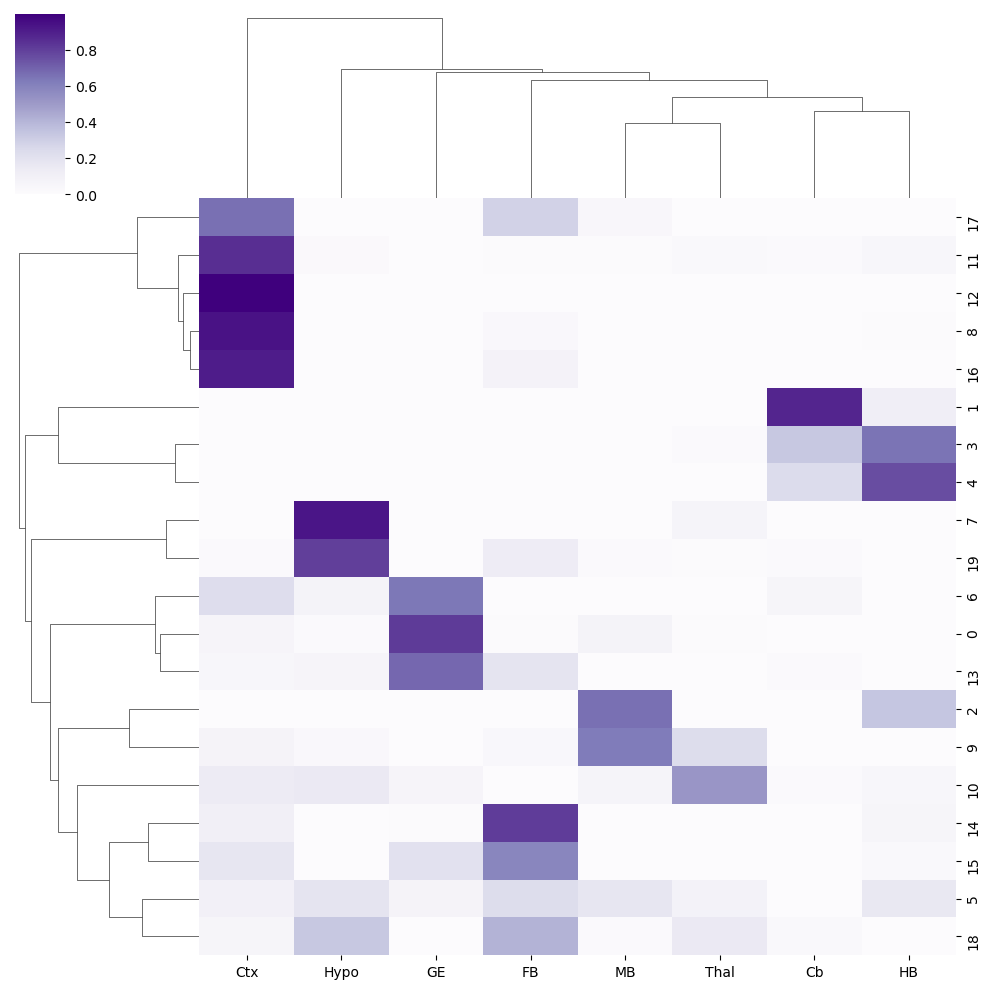

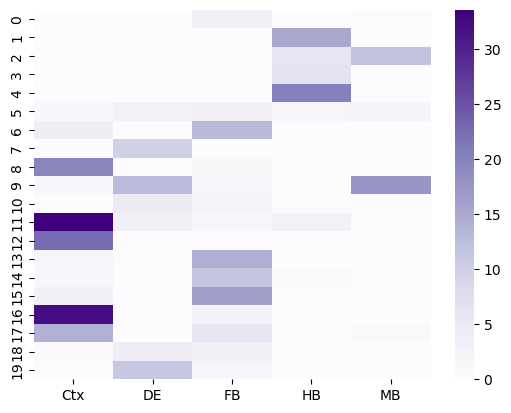

In [80]:
counts_pivot_meta['region'] = counts_pivot_meta['region'].astype('category')
real_region_oh = antipode.model_functions.numpy_onehot( counts_pivot_meta['region'].cat.codes)
region_fit_mat = pd.DataFrame(region_probs_df.T.to_numpy() @ real_region_oh,columns=counts_pivot_meta['region'].cat.categories)
region_fit_mat = region_fit_mat.drop(['DE','Medulla','Pons','Str','Sept','POA'],axis=1) #not enough samples attributed to these regions so don't choose them (doesn't anyway)
region_fit_mat = (region_fit_mat.T/region_fit_mat.sum(1)).T#region_fit_mat/region_fit_mat.sum(0)
# region_fit_mat = region_fit_mat/region_fit_mat.sum(0)
seaborn.clustermap(region_fit_mat,cmap='Purples')
plt.savefig(os.path.join(sc.settings.figdir,f'fit_region_clustermap.svg'))
plt.show()

counts_pivot_meta['simplified_region'] = counts_pivot_meta['simplified_region'].astype('category')
real_region_oh = antipode.model_functions.numpy_onehot( counts_pivot_meta['simplified_region'].cat.codes)
seaborn.heatmap(pd.DataFrame(region_probs_df.T.to_numpy() @ real_region_oh,columns=counts_pivot_meta['simplified_region'].cat.categories),cmap='Purples')
plt.savefig(os.path.join(sc.settings.figdir,f'fit_region_simplified_region_clustermap.svg'))
plt.show()

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/seaborn/matrix.py:1113: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  self._figure.tight_layout(**tight_params)


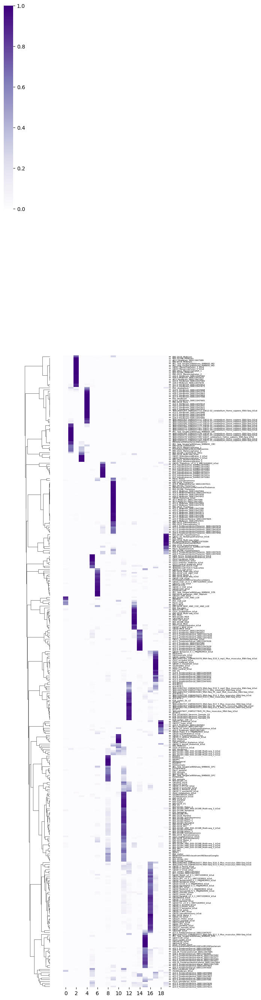

In [81]:
g = seaborn.clustermap(region_probs_df,yticklabels=True,figsize=(5,30),cmap='Purples',col_cluster=False)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 4)
plt.savefig(os.path.join(sc.settings.figdir,f'fit_region_batch_clustermap.svg'))


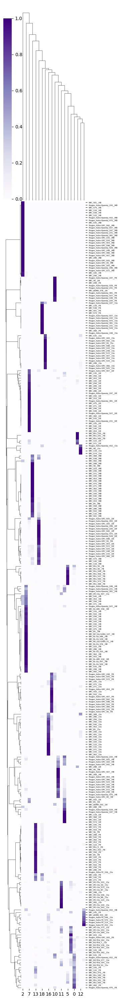

In [82]:
rho_df = pd.DataFrame(rho_post,columns=states)
rho_df = rho_df/rho_df.sum(0)
g = seaborn.clustermap(rho_df.T,cmap='Purples',yticklabels=True,figsize=(5,30))
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 4)
plt.savefig(os.path.join(sc.settings.figdir,f'fit_region_cluster-Initial_Class_clustermap.svg'))



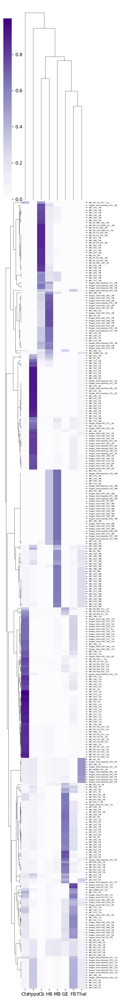

In [83]:
ic_region_probs = rho_df.T @ region_fit_mat
g = seaborn.clustermap(ic_region_probs,cmap='Purples',yticklabels=True,figsize=(5,30))
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 4)
plt.savefig(os.path.join(sc.settings.figdir,f'Initial_Class-Predicted_regionH_clustermap.svg'))


In [84]:
com_df['predicted_region'] = com_df['state'].replace(rho_df.idxmax(0).to_dict()).replace(region_fit_mat.idxmax(1).to_dict())

/scratch/fast/3608344/ipykernel_2533973/2368681892.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  com_df['predicted_region'] = com_df['state'].replace(rho_df.idxmax(0).to_dict()).replace(region_fit_mat.idxmax(1).to_dict())


<Axes: xlabel='species', ylabel='com_grid_realized'>

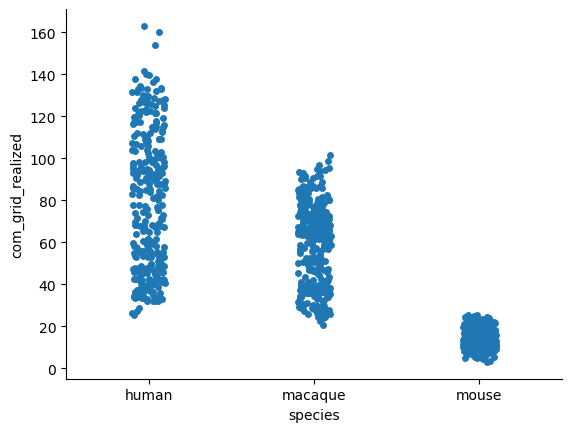

In [85]:
seaborn.stripplot(data=com_df,x='species',y='com_grid_realized')

In [86]:
com_df

,species,state,mu,com_time,auc,dt,dh,com_realized,mu_realized,Initial_Class,region,com_grid,com_grid_realized,species_state,Initial_Class_region,predicted_region
NPC_100__Ctxhuman,human,NPC_100__Ctx,11.709505,11.895051,0.000244,-2.857341,-0.265639,2.820752,2.781763,NPC,Ctx,12.876019,59.747195,NPC_100__Ctxhuman,NPC_Ctx,Ctx
NPC_100__DEhuman,human,NPC_100__DE,17.963749,14.704786,0.094421,-0.029321,12.309863,3.411167,4.095980,NPC,DE,16.147912,75.317850,NPC_100__DEhuman,NPC_DE,Hypo
NPC_100__FBhuman,human,NPC_100__FB,13.161860,12.129474,0.003606,0.167101,0.244313,2.870012,3.086949,NPC,FB,14.476170,67.362175,NPC_100__FBhuman,NPC_FB,GE
NPC_100__HBhuman,human,NPC_100__HB,12.714374,14.340560,0.053979,0.759199,5.293460,3.334632,2.992918,NPC,HB,14.215917,66.123651,NPC_100__HBhuman,NPC_HB,MB
NPC_100__MBhuman,human,NPC_100__MB,11.540411,11.972239,0.015316,-0.134112,5.757442,2.836972,2.746231,NPC,MB,11.046977,51.042941,NPC_100__MBhuman,NPC_MB,Hypo
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Progen_Astro-TE_114__Ctxmouse,mouse,Progen_Astro-TE_114__Ctx,24.493828,25.185590,0.772146,-0.838946,5.269964,29.203372,28.471405,Progen_Astro-TE,Ctx,24.951354,21.167124,Progen_Astro-TE_114__Ctxmouse,Progen_Astro-TE_Ctx,FB
Progen_Astro-TE_156__Ctxmouse,mouse,Progen_Astro-TE_156__Ctx,26.390585,49.987428,5.091425,4.402906,8.295348,55.446684,30.478401,Progen_Astro-TE,Ctx,26.874763,22.984885,Progen_Astro-TE_156__Ctxmouse,Progen_Astro-TE_Ctx,GE
Progen_Astro-TE_252__Ctxmouse,mouse,Progen_Astro-TE_252__Ctx,22.089397,22.921645,0.388521,1.748006,2.461358,26.807847,25.927230,Progen_Astro-TE,Ctx,23.195394,19.507615,Progen_Astro-TE_252__Ctxmouse,Progen_Astro-TE_Ctx,FB
Progen_Astro-TE_546__Ctxmouse,mouse,Progen_Astro-TE_546__Ctx,16.802685,20.505699,0.055727,-1.448567,3.199518,24.251487,20.333256,Progen_Astro-TE,Ctx,19.212829,15.743801,Progen_Astro-TE_546__Ctxmouse,Progen_Astro-TE_Ctx,FB


/scratch/fast/3608344/ipykernel_2533973/501812573.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()


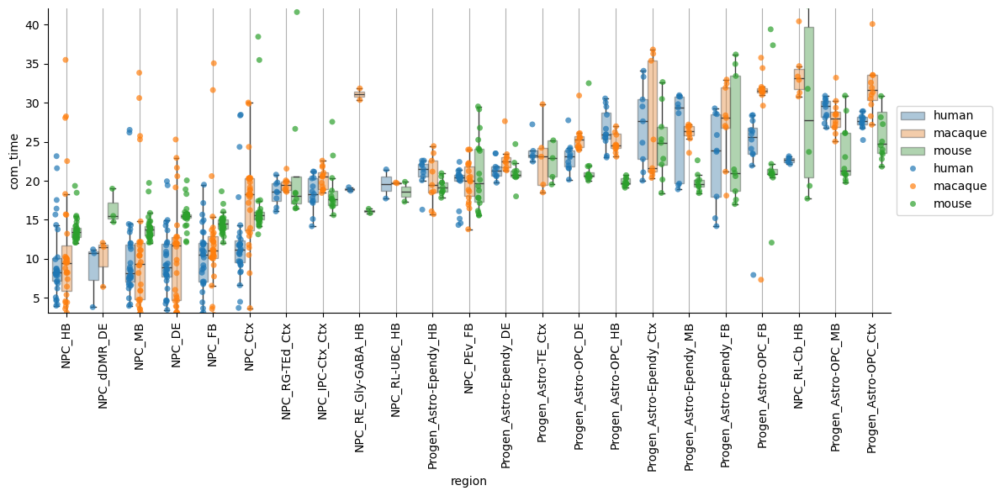

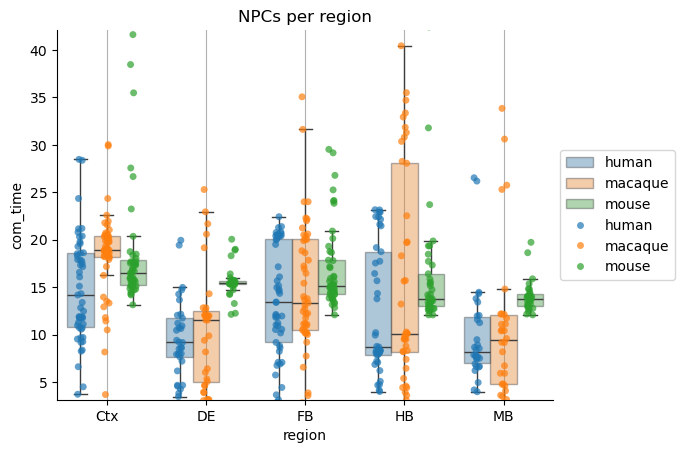

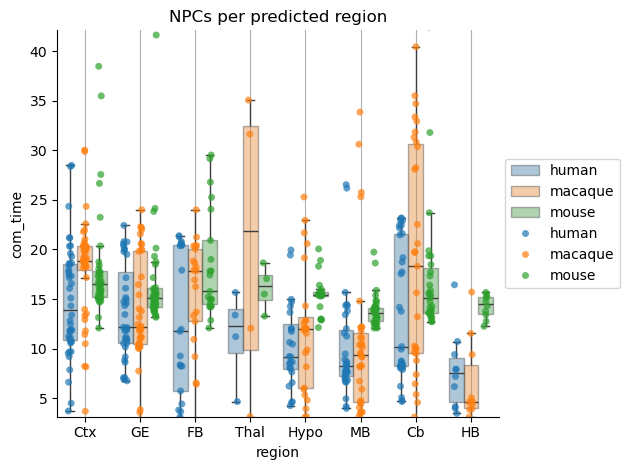

/scratch/fast/3608344/ipykernel_2533973/501812573.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:58: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

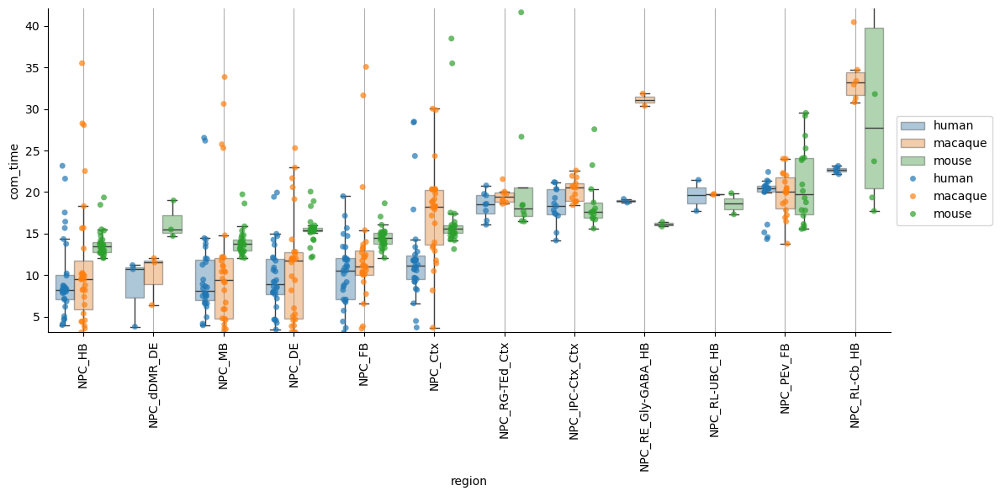

/scratch/fast/3608344/ipykernel_2533973/501812573.py:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:79: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

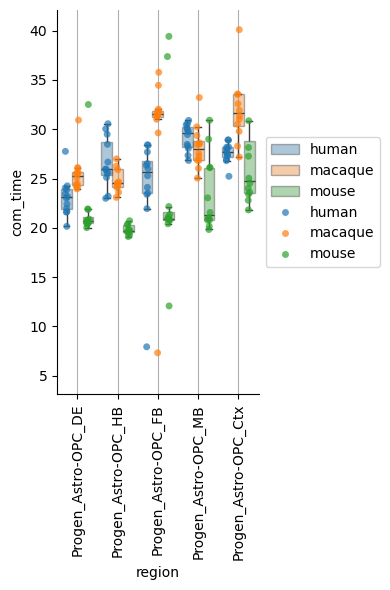

/scratch/fast/3608344/ipykernel_2533973/501812573.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()


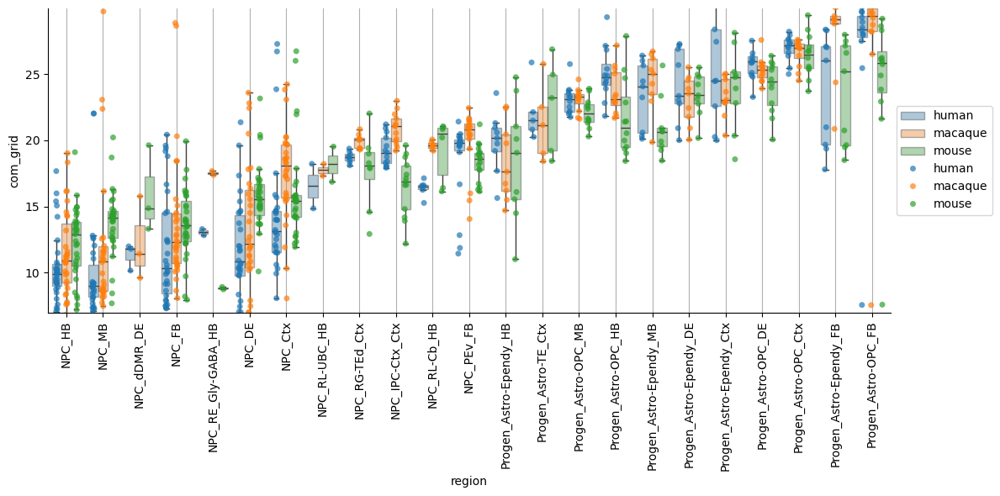

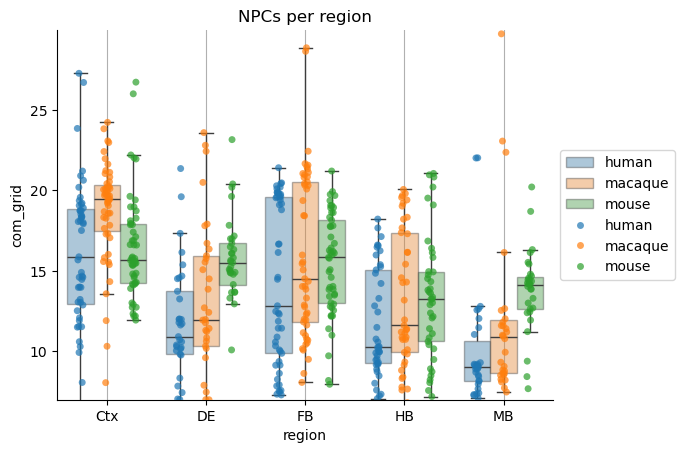

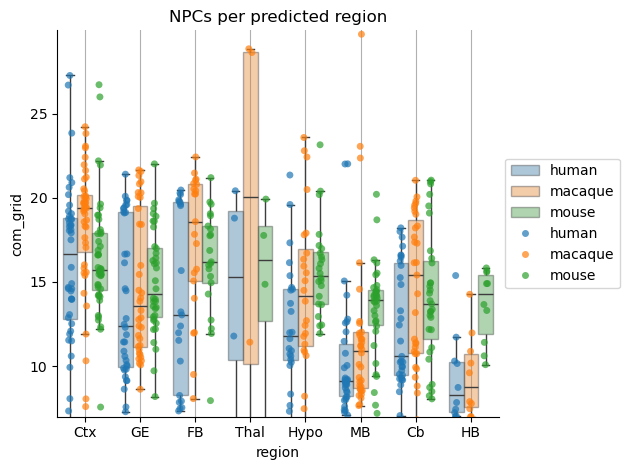

/scratch/fast/3608344/ipykernel_2533973/501812573.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:58: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

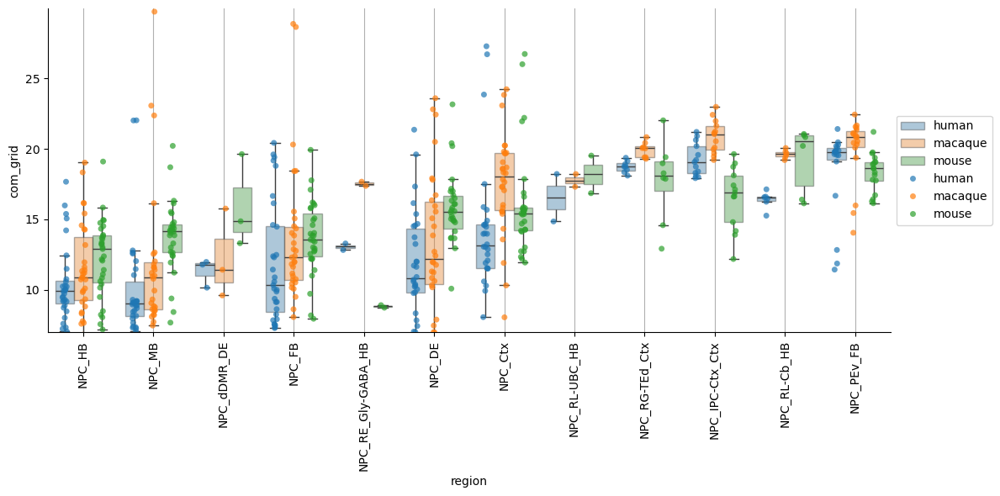

/scratch/fast/3608344/ipykernel_2533973/501812573.py:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:79: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

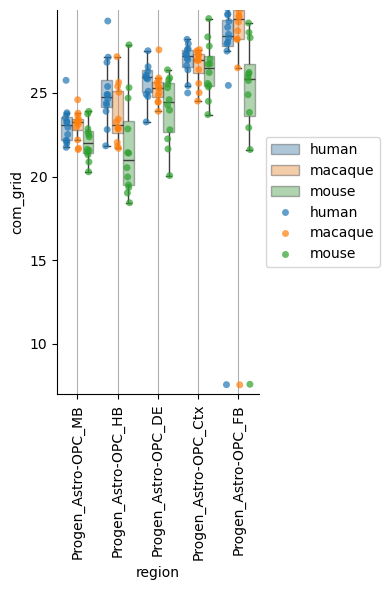

/scratch/fast/3608344/ipykernel_2533973/501812573.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()


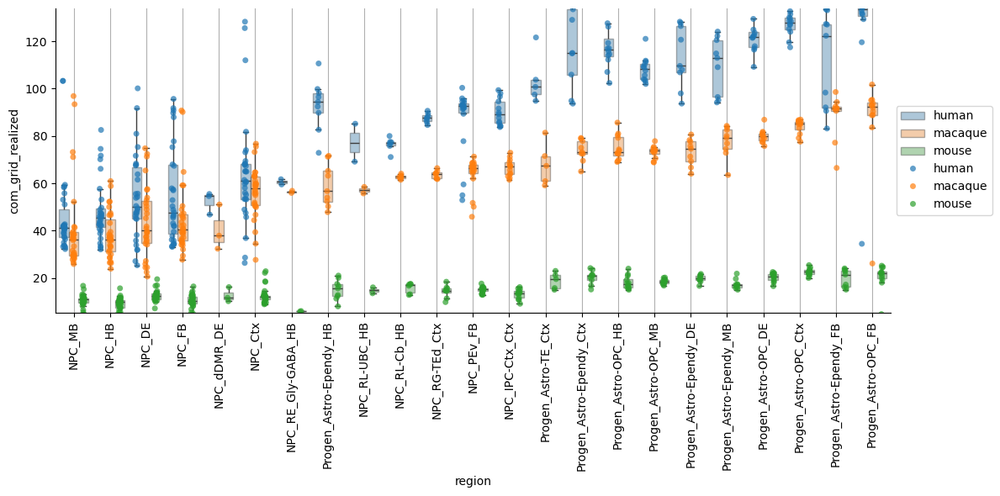

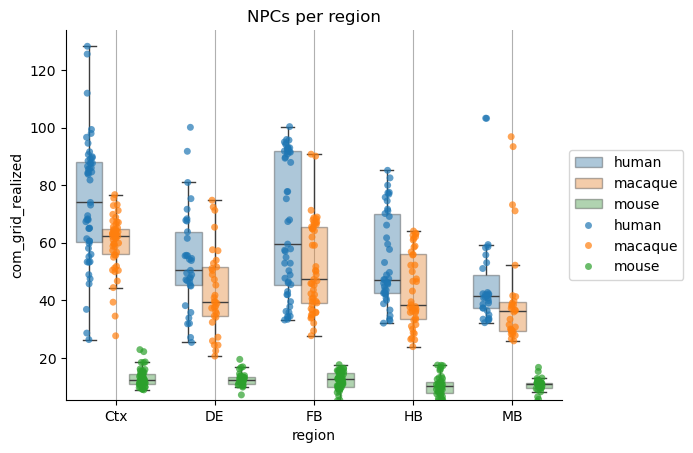

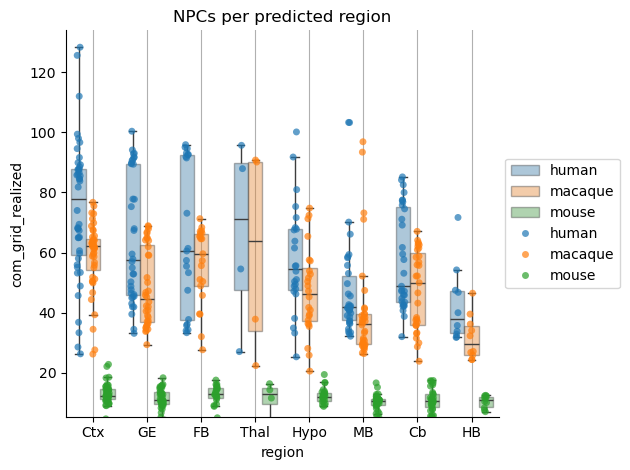

/scratch/fast/3608344/ipykernel_2533973/501812573.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:58: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

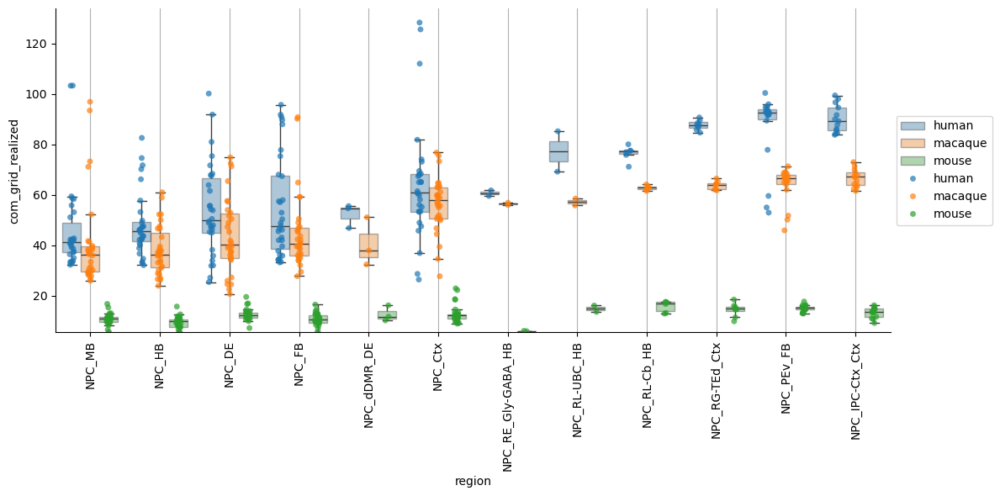

/scratch/fast/3608344/ipykernel_2533973/501812573.py:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:79: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

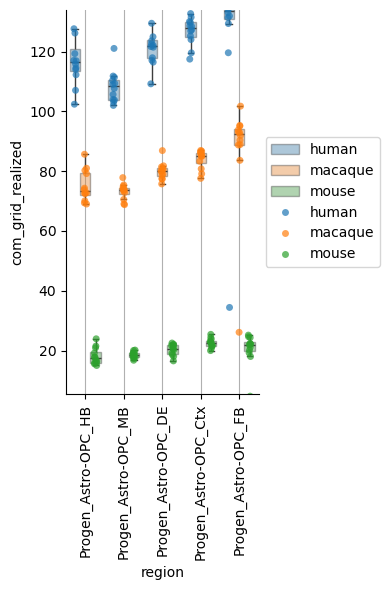

/scratch/fast/3608344/ipykernel_2533973/501812573.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()


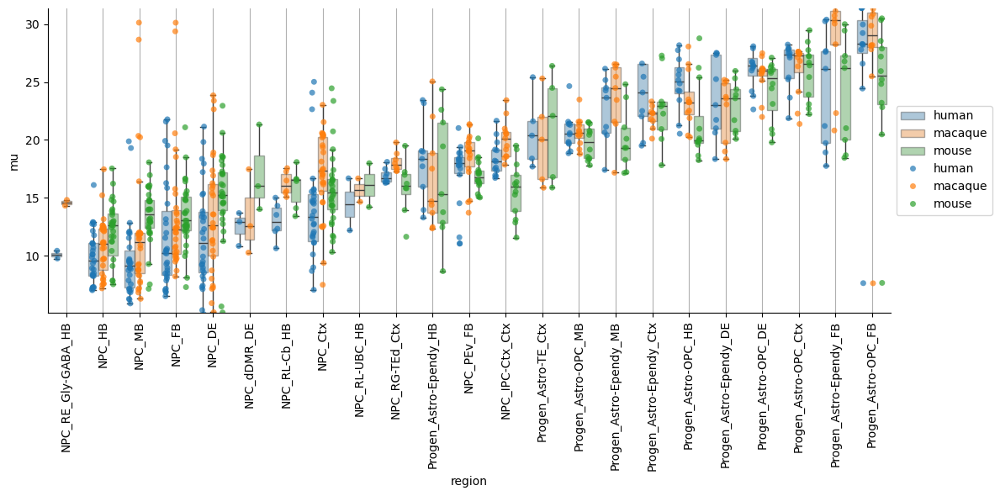

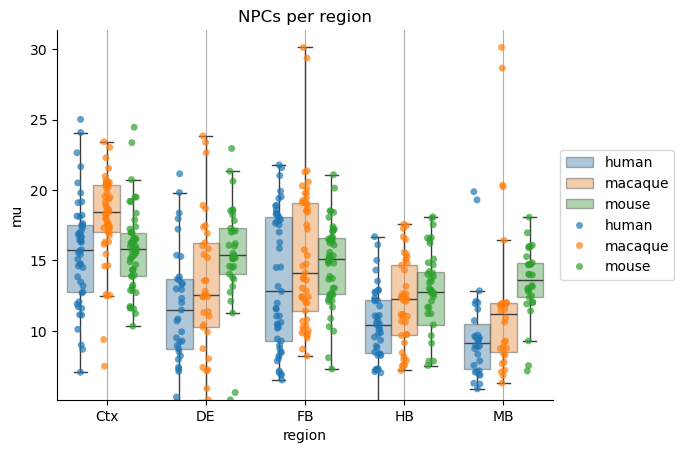

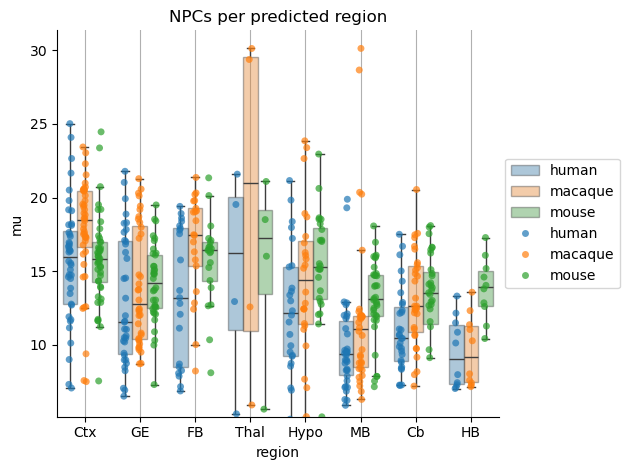

/scratch/fast/3608344/ipykernel_2533973/501812573.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:58: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

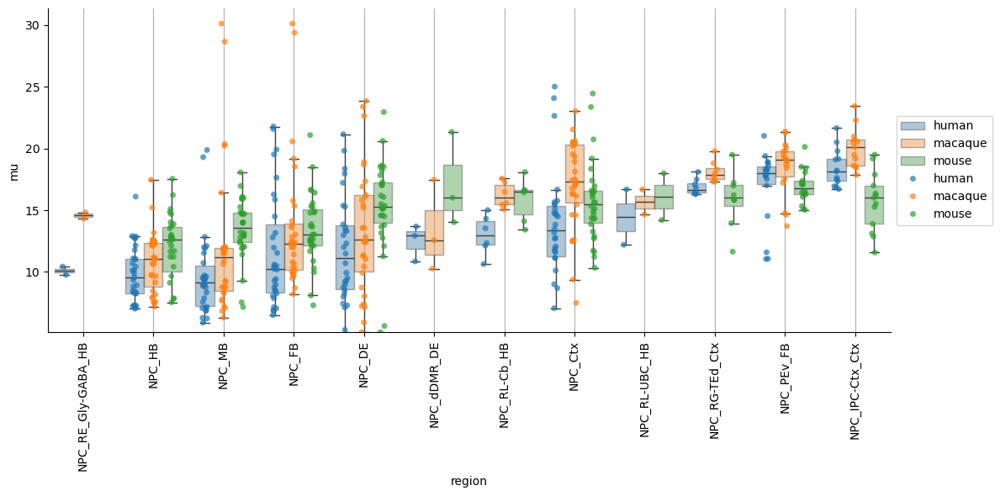

/scratch/fast/3608344/ipykernel_2533973/501812573.py:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:79: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

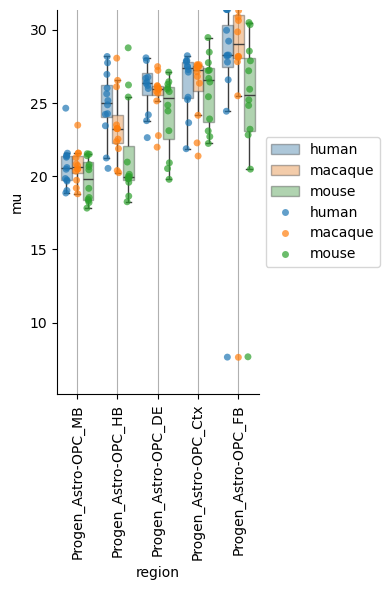

/scratch/fast/3608344/ipykernel_2533973/501812573.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()


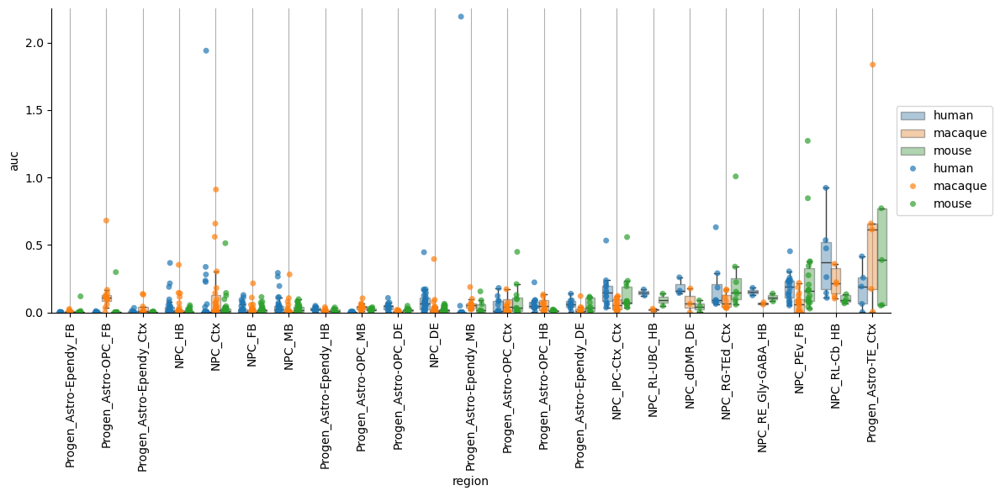

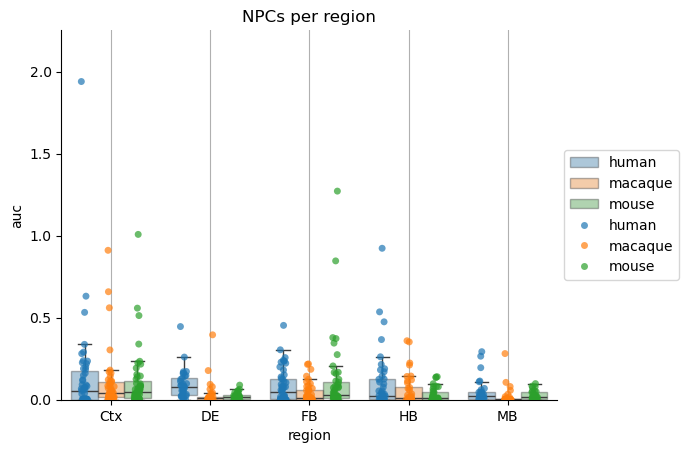

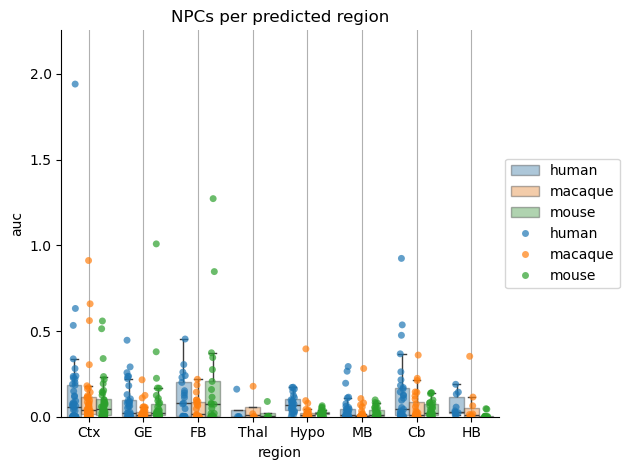

/scratch/fast/3608344/ipykernel_2533973/501812573.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:58: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

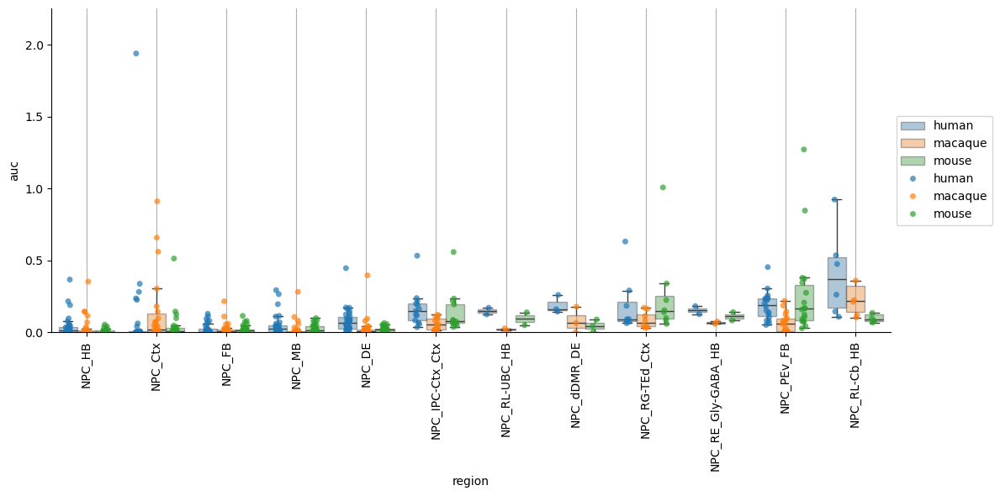

/scratch/fast/3608344/ipykernel_2533973/501812573.py:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:79: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

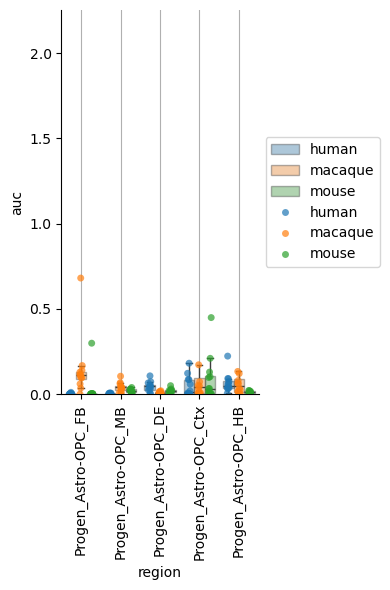

/scratch/fast/3608344/ipykernel_2533973/501812573.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()


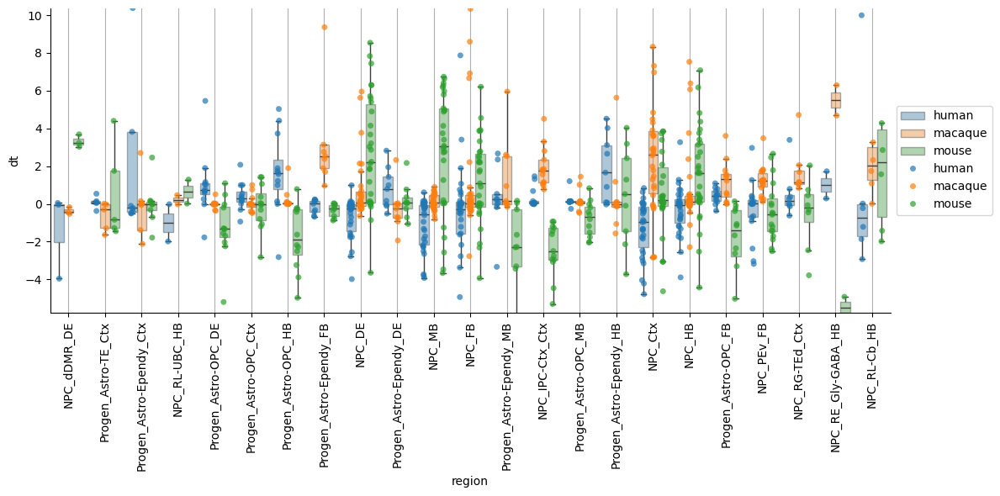

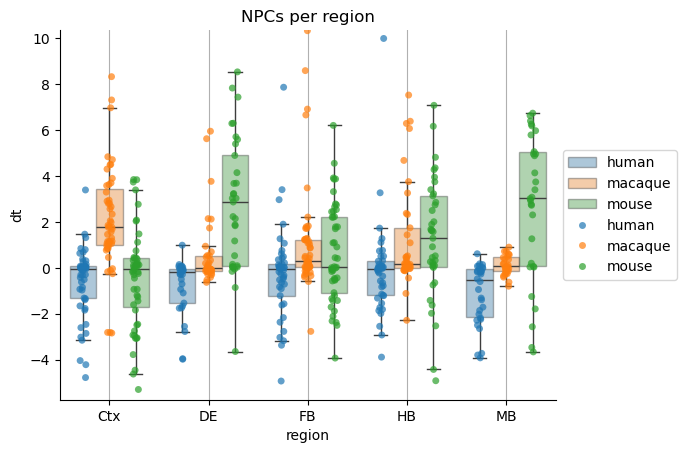

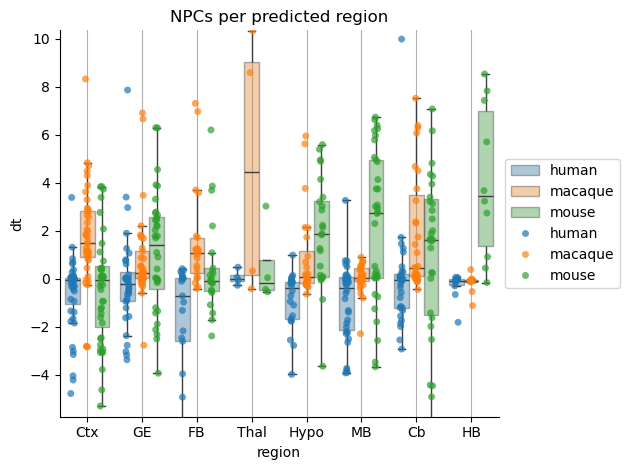

/scratch/fast/3608344/ipykernel_2533973/501812573.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:58: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

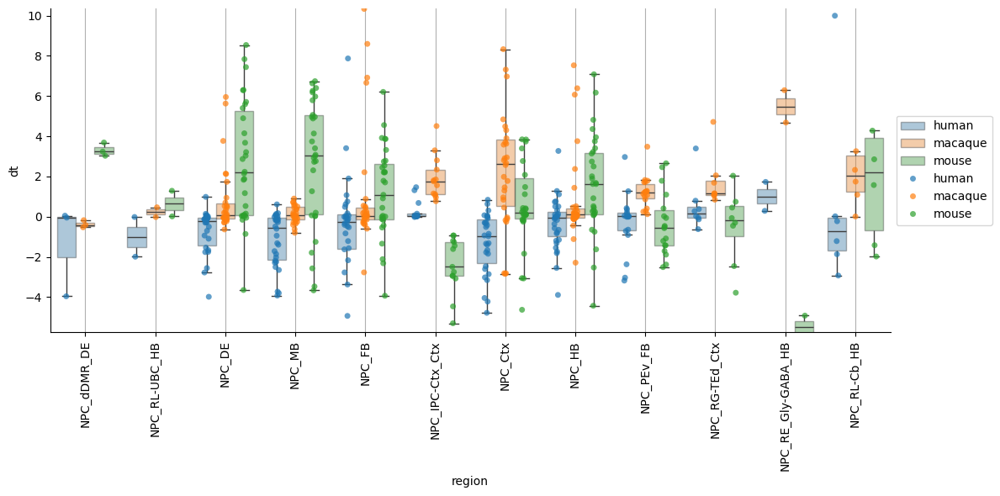

/scratch/fast/3608344/ipykernel_2533973/501812573.py:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:79: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

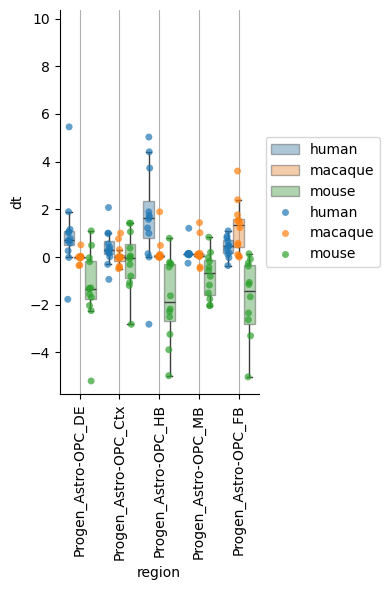

/scratch/fast/3608344/ipykernel_2533973/501812573.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()


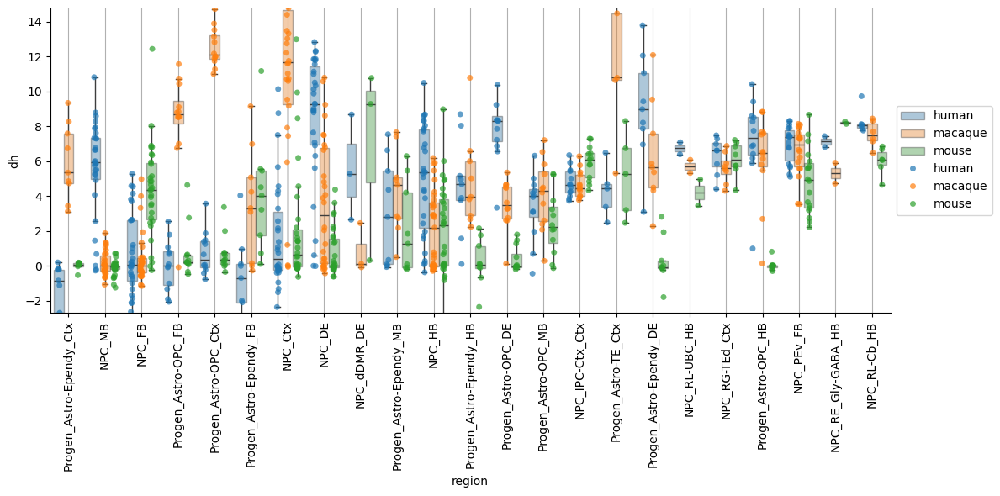

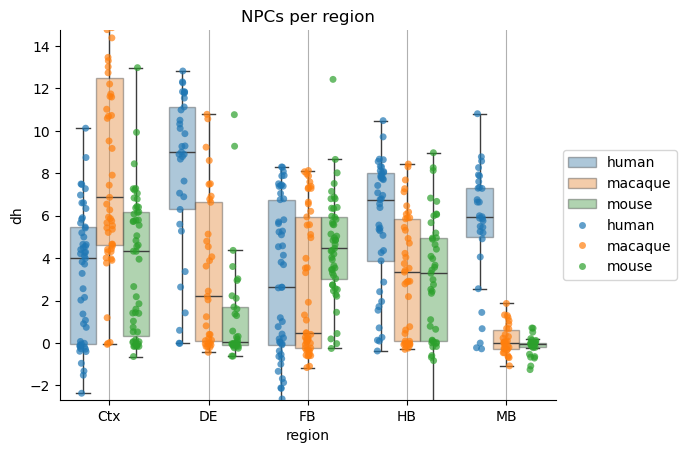

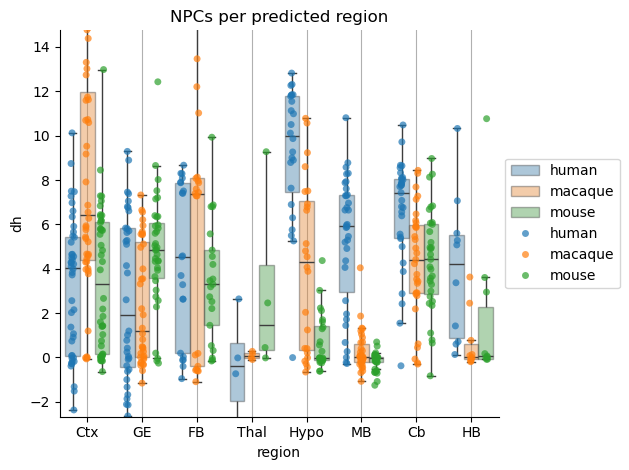

/scratch/fast/3608344/ipykernel_2533973/501812573.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:58: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

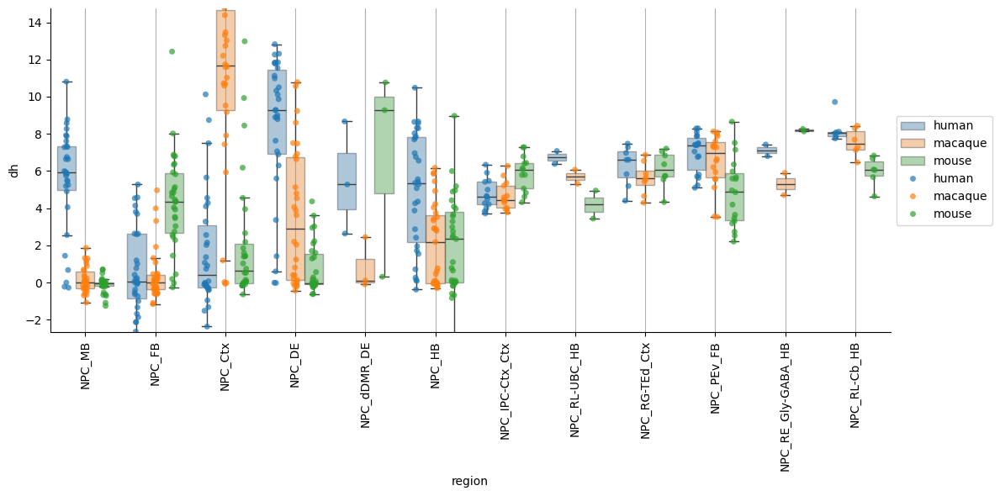

/scratch/fast/3608344/ipykernel_2533973/501812573.py:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:79: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
/scratch/fast/3608344/ipykernel_2533973/501812573.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

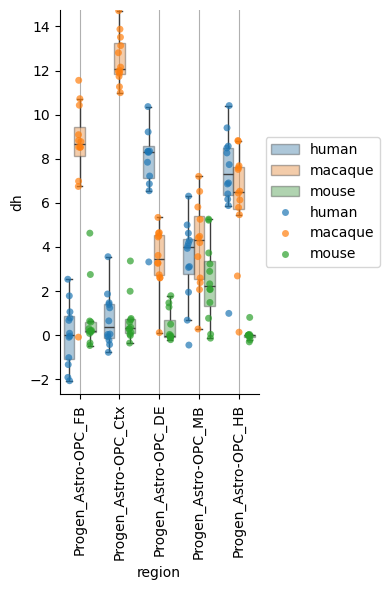

In [87]:
com_df['predicted_region'] = com_df['predicted_region'].astype('category')
ordered_regions = ['Ctx', 'GE', 'FB','Thal', 'Hypo', 'MB', 'Cb', 'HB']
ordered_regions = [x for x in ordered_regions if x in com_df['predicted_region'].cat.categories]
com_df['predicted_region'] = com_df['predicted_region'].cat.reorder_categories(ordered_regions)
ic_palette = dict(zip(com_df['Initial_Class_region'].cat.categories,[adata.uns['Initial_Class_colors_dict'][x] for x in  com_df['Initial_Class_region'].cat.categories.str.replace('_Ctx|_FB|_DE|_MB|_HB','',regex=True)]))

for stat in ['com_time','com_grid','com_grid_realized','mu','auc','dt','dh']: #com_time is the unmodeled version and is extra subject to sample bias
    # if stat != 'mu':
        # plot_range = (com_df[stat]>np.quantile(com_df[stat],.05))&(com_df[stat]<np.quantile(com_df[stat],.95))
        # plot_com_df = com_df.loc[plot_range,:]
    plot_com_df = com_df
    sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
    plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].astype('category')
    plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.reorder_categories(list(sorted_Initial_Class.index))
    # com_df['clipped_stat'] = np.clip(com_df[stat],np.quantile(com_df[stat],.05),np.quantile(com_df[stat],.95))
    plt.figure(figsize=(12,6))
    ax = seaborn.boxplot(data=plot_com_df,y=stat,x='Initial_Class_region',hue='species',showfliers=False,boxprops={'alpha': 0.4})
    ax = seaborn.stripplot(data=plot_com_df,y=stat,x='Initial_Class_region',hue='species',dodge=True,alpha=0.7)
    ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
    plt.xticks(rotation=90)
    plt.ylim(np.quantile(plot_com_df[stat],.01),np.quantile(plot_com_df[stat],.99))
    plt.ylabel(stat)
    plt.xlabel('region')
    ax.grid(axis='x')
    plt.tight_layout()
    plt.savefig(os.path.join(sc.settings.figdir,f'boxplot_{stat}_species_Initial_Class.svg'))
    plt.show()
    
    ax = seaborn.boxplot(data=plot_com_df.loc[plot_com_df['Initial_Class'].str.startswith('NPC')],y=stat,x='region',hue='species',showfliers=False,boxprops={'alpha': 0.4})
    ax = seaborn.stripplot(data=plot_com_df.loc[plot_com_df['Initial_Class'].str.startswith('NPC')],y=stat,x='region',hue='species',dodge=True,alpha=0.7)
    ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
    # plt.xticks(rotation=90)
    plt.title('NPCs per region')
    plt.ylabel(stat)
    plt.ylim(np.quantile(plot_com_df[stat],.01),np.quantile(plot_com_df[stat],.99))
    plt.xlabel('region')
    ax.grid(axis='x')
    # plt.savefig(os.path.join(sc.settings.figdir,f'boxplot_{stat}_region_Initial_Class.svg'))
    plt.show()
    
    ax = seaborn.boxplot(data=plot_com_df.loc[plot_com_df['Initial_Class'].str.startswith('NPC')],y=stat,x='predicted_region',hue='species',showfliers=False,boxprops={'alpha': 0.4})
    ax = seaborn.stripplot(data=plot_com_df.loc[plot_com_df['Initial_Class'].str.startswith('NPC')],y=stat,x='predicted_region',hue='species',dodge=True,alpha=0.7)
    ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
    # plt.xticks(rotation=90)
    plt.title('NPCs per predicted region')
    plt.ylabel(stat)
    plt.xlabel('region')
    plt.ylim(np.quantile(plot_com_df[stat],.01),np.quantile(plot_com_df[stat],.99))
    ax.grid(axis='x')
    plt.tight_layout()
    plt.savefig(os.path.join(sc.settings.figdir,f'boxplot_{stat}_region_Initial_Class.svg'))
    plt.show()


    plot_com_df = com_df
    plot_com_df = plot_com_df.loc[plot_com_df['Initial_Class_region'].str.contains('NPC'),:]
    plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
    sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
    plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].astype('category')
    plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.reorder_categories(list(sorted_Initial_Class.index))
    # com_df['clipped_stat'] = np.clip(com_df[stat],np.quantile(com_df[stat],.05),np.quantile(com_df[stat],.95))
    plt.figure(figsize=(12,6))
    ax = seaborn.boxplot(data=plot_com_df,y=stat,x='Initial_Class_region',hue='species',showfliers=False,boxprops={'alpha': 0.4})
    ax = seaborn.stripplot(data=plot_com_df,y=stat,x='Initial_Class_region',hue='species',dodge=True,alpha=0.7)
    ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
    plt.xticks(rotation=90)
    plt.ylim(np.quantile(com_df[stat],.01),np.quantile(com_df[stat],.99))
    plt.ylabel(stat)
    plt.xlabel('region')
    ax.grid(axis='x')
    plt.tight_layout()
    plt.savefig(os.path.join(sc.settings.figdir,f'boxplot_NPC_{stat}_species_Initial_Class.svg'))
    plt.show()

    
    plot_com_df = com_df
    plot_com_df = plot_com_df.loc[plot_com_df['Initial_Class_region'].str.contains('Progen_Astro-OPC'),:]
    plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.remove_unused_categories()
    sorted_Initial_Class = plot_com_df.groupby('Initial_Class_region')[stat].median().sort_values()
    plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].astype('category')
    plot_com_df['Initial_Class_region'] = plot_com_df['Initial_Class_region'].cat.reorder_categories(list(sorted_Initial_Class.index))
    # com_df['clipped_stat'] = np.clip(com_df[stat],np.quantile(com_df[stat],.05),np.quantile(com_df[stat],.95))
    plt.figure(figsize=(4,6))
    ax = seaborn.boxplot(data=plot_com_df,y=stat,x='Initial_Class_region',hue='species',showfliers=False,boxprops={'alpha': 0.4})
    ax = seaborn.stripplot(data=plot_com_df,y=stat,x='Initial_Class_region',hue='species',dodge=True,alpha=0.7)
    ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
    plt.xticks(rotation=90)
    # plt.ylim(np.quantile(plot_com_df[stat],.01),np.quantile(plot_com_df[stat],.99))
    plt.ylim(np.quantile(com_df[stat],.01),np.quantile(com_df[stat],.99))
    plt.ylabel(stat)
    plt.xlabel('region')
    ax.grid(axis='x')
    plt.tight_layout()
    plt.savefig(os.path.join(sc.settings.figdir,f'boxplot_GPC_{stat}_species_Initial_Class.svg'))
    plt.show()
    
    # plt.figure(figsize=(12,6))
    # ax = seaborn.boxplot(data=plot_com_df,y=stat,hue='Initial_Class_region',x='species',showfliers=False,boxprops={'alpha': 0.4},palette=ic_palette)
    # ax = seaborn.stripplot(data=plot_com_df,y=stat,hue='Initial_Class_region',x='species',dodge=True,alpha=0.7,palette=ic_palette)
    # ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
    # plt.xticks(rotation=90)
    # plt.ylim(np.quantile(plot_com_df[stat],.01),np.quantile(plot_com_df[stat],.99))
    # plt.ylabel(stat)
    # plt.xlabel('region')
    # ax.grid(axis='x')
    # plt.tight_layout()
    # plt.savefig(os.path.join(sc.settings.figdir,f'boxplot_NPC_{stat}_species_Initial_Class.svg'))
    # plt.show()


# stat='dt'    
# ax = seaborn.boxplot(data=com_df.loc[com_df['state'].str.startswith('NPC')],y=stat,x='predicted_region',hue='species',showfliers=False,boxprops={'alpha': 0.4})
# ax = seaborn.stripplot(data=com_df[com_df['state'].str.startswith('NPC')],y=stat,x='predicted_region',hue='species',dodge=True)
# ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
# # plt.xticks(rotation=90)
# plt.ylabel(stat)
# plt.xlabel('region')
# ax.grid(axis='x')
# plt.ylim(-6,6)
# plt.show()


# stat='dt'    
# ax = seaborn.boxplot(data=com_df.loc[com_df['state'].str.startswith('Progen')],y=stat,x='predicted_region',hue='species',showfliers=False,boxprops={'alpha': 0.4})
# ax = seaborn.stripplot(data=com_df[com_df['state'].str.startswith('Progen')],y=stat,x='predicted_region',hue='species',dodge=True)
# ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
# # plt.xticks(rotation=90)
# plt.ylabel(stat)
# plt.xlabel('region')
# ax.grid(axis='x')
# plt.ylim(-6,6)
# plt.show()


In [88]:
sorted_Initial_Class = com_df.groupby('Initial_Class_region')['com_grid'].median().sort_values()
com_df['Initial_Class_region'] = com_df['Initial_Class_region'].astype('category')
com_df['Initial_Class_region'] = com_df['Initial_Class_region'].cat.reorder_categories(list(sorted_Initial_Class.index))
adata.obs['Initial_Class_region'] = adata.obs['cluster_region'].str.replace('_[0-9]+__','_',regex=True)
adata.obs['Initial_Class_region'] = adata.obs['Initial_Class_region'].astype('category')
adata_cats = [x for x in com_df['Initial_Class_region'].cat.categories if x in adata.obs['Initial_Class_region'].cat.categories]
adata.obs['Initial_Class_region'] = adata.obs['Initial_Class_region'].cat.reorder_categories(list(adata_cats))

sorted_state = com_df.groupby('state')['com_grid'].median().sort_values()
adata.obs['cluster_region'] = adata.obs['cluster_region'].astype('category')
adata.obs['cluster_region'] = adata.obs['cluster_region'].cat.reorder_categories(list(sorted_state.index))


/scratch/fast/3608344/ipykernel_2533973/2353560786.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sorted_Initial_Class = com_df.groupby('Initial_Class_region')['com_grid'].median().sort_values()


In [89]:
print('human',com_df.loc[com_df['species']=='human',:].groupby('Initial_Class_region')['com_grid'].median().sort_values())
print('macaque',com_df.loc[com_df['species']=='macaque',:].groupby('Initial_Class_region')['com_grid'].median().sort_values())
print('mouse',com_df.loc[com_df['species']=='mouse',:].groupby('Initial_Class_region')['com_grid'].median().sort_values())


human Initial_Class_region
NPC_MB                      9.005279
NPC_HB                      9.899830
NPC_FB                     10.336925
NPC_DE                     10.813311
NPC_dDMR_DE                11.785146
NPC_RE_Gly-GABA_HB         13.056184
NPC_Ctx                    13.142982
NPC_RL-Cb_HB               16.520278
NPC_RL-UBC_HB              16.532586
NPC_RG-TEd_Ctx             18.736147
NPC_IPC-Ctx_Ctx            19.063307
NPC_PEv_FB                 19.771371
Progen_Astro-Ependy_HB     20.157793
Progen_Astro-TE_Ctx        21.487674
Progen_Astro-OPC_MB        23.087103
Progen_Astro-Ependy_DE     23.348256
Progen_Astro-Ependy_MB     24.062898
Progen_Astro-Ependy_Ctx    24.501411
Progen_Astro-OPC_HB        24.771716
Progen_Astro-OPC_DE        25.929619
Progen_Astro-Ependy_FB     26.025510
Progen_Astro-OPC_Ctx       27.186932
Progen_Astro-OPC_FB        28.395998
Name: com_grid, dtype: float64
macaque Initial_Class_region
NPC_MB                     10.865964
NPC_HB                   

/scratch/fast/3608344/ipykernel_2533973/3215681974.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print('human',com_df.loc[com_df['species']=='human',:].groupby('Initial_Class_region')['com_grid'].median().sort_values())
/scratch/fast/3608344/ipykernel_2533973/3215681974.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print('macaque',com_df.loc[com_df['species']=='macaque',:].groupby('Initial_Class_region')['com_grid'].median().sort_values())
/scratch/fast/3608344/ipykernel_2533973/3215681974.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future vers

In [90]:
sorted_Initial_Class

Initial_Class_region
NPC_HB                     10.761186
NPC_MB                     11.313418
NPC_dDMR_DE                11.979536
NPC_FB                     12.480367
NPC_RE_Gly-GABA_HB         13.056184
NPC_DE                     13.709500
NPC_Ctx                    15.435254
NPC_RL-UBC_HB              17.758374
NPC_RG-TEd_Ctx             19.054356
NPC_IPC-Ctx_Ctx            19.208359
NPC_RL-Cb_HB               19.303527
NPC_PEv_FB                 19.653924
Progen_Astro-Ependy_HB     19.745228
Progen_Astro-TE_Ctx        21.487674
Progen_Astro-OPC_MB        22.903537
Progen_Astro-OPC_HB        23.344791
Progen_Astro-Ependy_MB     23.354417
Progen_Astro-Ependy_DE     23.395897
Progen_Astro-Ependy_Ctx    24.457789
Progen_Astro-OPC_DE        25.312421
Progen_Astro-OPC_Ctx       26.968367
Progen_Astro-Ependy_FB     27.018072
Progen_Astro-OPC_FB        28.258269
Name: com_grid, dtype: float64

<Axes: >

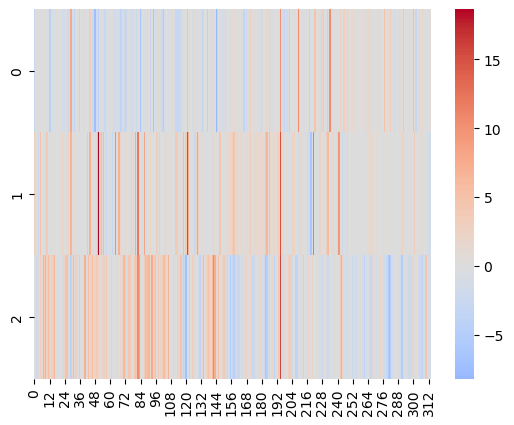

In [91]:
seaborn.heatmap(delta_t_post,cmap='coolwarm',center=0.)

<Axes: >

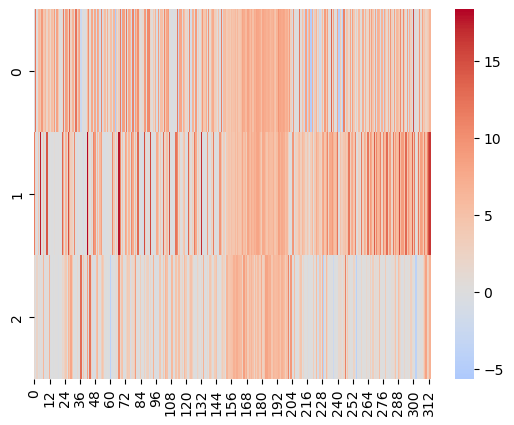

In [92]:
seaborn.heatmap(delta_h_post,cmap='coolwarm',center=0.)

In [93]:
# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn
# import scanpy as sc

# xmax = com_df['mu'].max()*1.2

# all_dfs = []
# for i, sp in enumerate(species):
#     tau_min = 0#t.min().item() * a_post[i] + b_post[i]
#     tau_max = xmax#t.max().item() * a_post[i] + b_post[i]
#     taus = np.linspace(tau_min, tau_max, 200)

#     # compute logits & softmax
#     logits = []
#     for s in range(mu_post.shape[0]):
#         mu_s = mu_post[s] + delta_t_post[i, s]
#         sig_r = sigma_rise_post[s]
#         sig_f = sigma_fall_post[s]
#         σs = np.where(taus < mu_s, sig_r, sig_f)
#         logits.append(A_post[s] - ((taus - mu_s) ** 2) / (2 * σs**2))
#     logits = np.array(logits) + delta_h_post[i, s]
#     ex = np.exp(logits - logits.max(axis=0))
#     props = ex / ex.sum(axis=0)

#     df_list = []
#     for s, st in enumerate(states):
#         df_list.append(pd.DataFrame({
#             "tau": taus,
#             "proportion": props[s] / props[s].max(),
#             "state": st
#         }))
#     df = pd.concat(df_list, ignore_index=True)
#     df["region"]   = df["state"].str.split("__", expand=True)[1]
#     df["Initial_Class"] = df["state"].str.split("_[0-9]+__", regex=True, expand=True)[0]
#     df["species"]  = sp
#     all_dfs.append(df)

# df_all = pd.concat(all_dfs, ignore_index=True)

# df_all['region'] = df_all['region'].astype('category')
# df_all['region'] = df_all['region'].cat.reorder_categories(['HB','MB','DE','FB','Ctx'])
# Initial_Class_colors = adata.uns['Initial_Class_colors_dict']
# Initial_Class_colors = {k:v for k,v in Initial_Class_colors.items() if k in df_all['Initial_Class'].unique()}

# # build the grid, sharing both axes via facet_kws
# g = seaborn.relplot(
#     data=df_all,
#     x="tau", y="proportion",
#     kind="line",
#     hue="Initial_Class",
#     row="species",
#     col="region",
#     height=3.5,
#     aspect=1.2,
#     facet_kws=dict(sharex=True, sharey=True),
#     linewidth=2.0,
#     palette=Initial_Class_colors,            # ← here
#     hue_order=list(Initial_Class_colors)
# )

# g.set(xlim=(0, xmax))
# g.set_axis_labels("Tau (warped developmental time)", "Fitted proportion")
# # g.add_legend(bbox_to_anchor=(1.10, 1), loc="upper left", ncol=2)
# # plt.tight_layout()
# plt.savefig(os.path.join(sc.settings.figdir, "state_progression_grid.svg"))
# plt.show()


# Timing related genes

In [94]:
from scipy.stats import spearmanr
def get_xa_scores(time_array,var_array,species='species',var='var',obs='cluster_region'):
    com_scores = []
    obs_shared = list(set(time_array.coords[obs].data) & set(var_array.coords[obs].data))

    for s in var_array.coords[species]:
        inner = []
        for v in tqdm.tqdm(var_array.coords[var]):
            x = var_array.sel({'var':v,'species':s,obs:obs_shared}).values.flatten()
            y = time_array.sel({species:s,obs:obs_shared}).values 
            x = x + np.random.rand(*x.shape)*1e-10
            y = y + np.random.rand(*x.shape)*1e-10
            inner.append(spearmanr(x,y).statistic)
        com_scores.append(inner)
    return np.nan_to_num(np.nanmean(com_scores,0),nan=0.)

def get_flat_scores(gene_means,com_array,species='species',var='var',obs='cluster_region'):
    obs_combined = list(set(gene_means.coords[obs].data) & set(com_array.coords[obs].data))
    out = []
    for v in tqdm.tqdm(gene_means.coords[var]):
        x = gene_means.sel({var:v,obs:obs_combined}).values.flatten()
        y = com_array.sel({obs:obs_combined}).values.flatten()
        x = x + np.random.rand(*x.shape)*1e-10
        y = y + np.random.rand(*x.shape)*1e-10
        out.append(spearmanr(x,y).statistic)
    return np.nan_to_num(np.array(out))


In [95]:
xs_scores = get_flat_scores(gene_means,observed_array)
com_scores = get_xa_scores(observed_array,gene_means)
# dt_scores = get_xa_scores(dt_array,gene_means)
# dt_latent_scores = get_xa_scores(dt_array,latent_means)

100%|██████████| 16738/16738 [00:50<00:00, 333.14it/s]


In [96]:
fit_xs_scores = get_flat_scores(gene_means,fit_realized_com_array)#fit_realized_com_array
fit_com_scores = get_xa_scores(fit_com_array,gene_means) #This is com_grid, which is the corrected version
fit_mu_scores = get_xa_scores(fit_mu_array,gene_means)
fit_auc_scores = get_xa_scores(fit_auc_array,gene_means) #unstable
fit_dt_scores = get_xa_scores(fit_dt_array,gene_means)
fit_dh_scores = get_xa_scores(fit_dh_array,gene_means)

100%|██████████| 16738/16738 [00:47<00:00, 349.57it/s]


In [97]:
npc_coords = np.array(pd.Series(gene_means.coords['cluster_region']).str.contains('NPC_[0-9]+',regex=True))
fit_com_npc_scores = get_xa_scores(fit_com_array[:,npc_coords],gene_means.sel(cluster_region=npc_coords))
fit_dt_npc_scores = get_xa_scores(fit_dt_array[:,npc_coords],gene_means.sel(cluster_region=npc_coords))

100%|██████████| 16738/16738 [00:40<00:00, 415.68it/s]


In [98]:
xs_latent_scores = get_flat_scores(latent_means,observed_array)
fit_com_latent_scores = get_xa_scores(fit_com_array,latent_means)
fit_mu_latent_scores = get_xa_scores(fit_mu_array,latent_means)
fit_dt_latent_scores = get_xa_scores(fit_dt_array,latent_means)

100%|██████████| 200/200 [00:00<00:00, 376.25it/s]


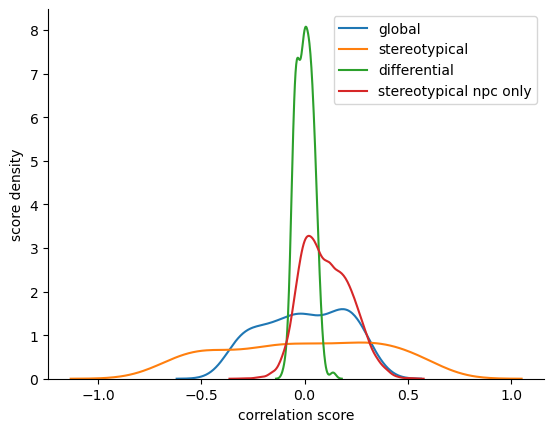

In [99]:
seaborn.kdeplot(xs_latent_scores,label='global',)
seaborn.kdeplot(fit_com_latent_scores,label='stereotypical')
seaborn.kdeplot(fit_dt_latent_scores,label='differential')
seaborn.kdeplot(fit_com_npc_scores,label='stereotypical npc only')
plt.xlabel('correlation score')
plt.ylabel('score density')
plt.legend()
# seaborn.histplot(fit_com_npc_scores,bins=20,stat='cortical_')
plt.savefig(os.path.join(sc.settings.figdir, 'scores_hist.svg'), format='svg')


<Axes: ylabel='Probability'>

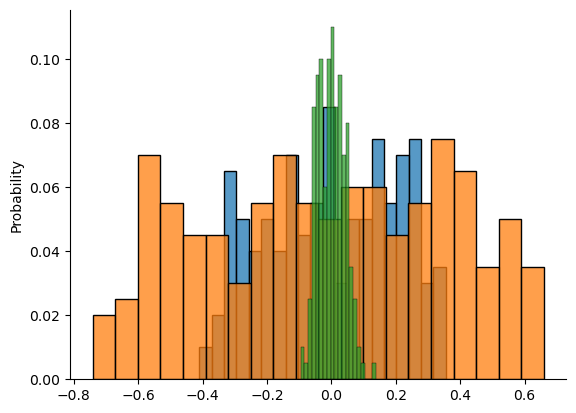

In [100]:
seaborn.histplot(xs_latent_scores,bins=20,stat='probability',label='global')
seaborn.histplot(fit_com_latent_scores,bins=20,stat='probability',label='stereotypical')
seaborn.histplot(fit_dt_latent_scores,bins=20,stat='probability',label='differential')
# seaborn.histplot(fit_com_npc_scores,bins=20,stat='cortical_')

In [101]:
scores_dict = {
                'xs_scores':xs_scores,
                'com_scores':com_scores,
                # 'dt_scores':dt_scores,
                # 'dt_latent_scores':dt_latent_scores,
                'fit_xs_scores':fit_xs_scores,
                'fit_com_npc_scores':fit_com_npc_scores,
                'fit_com_scores':fit_com_scores,
                'fit_mu_scores':fit_mu_scores,
                'fit_auc_scores':fit_auc_scores,
                'fit_dt_npc_scores':fit_dt_npc_scores,
                'fit_dt_scores':fit_dt_scores,
                'fit_dh_scores':fit_dh_scores,
              }
for k in scores_dict.keys():
    scores_dict[k] = pd.Series(scores_dict[k],index=gene_means.coords['var'].values)
scores_dict['ctx_scores'] = ctx_scores

In [102]:
print(scores_dict['fit_com_npc_scores'].sort_values()[:30])
print(scores_dict['fit_com_npc_scores'].sort_values()[-30:])

CRABP2    -0.312575
HMGA1     -0.305341
PKM       -0.302183
KRT8      -0.292892
LIN28A    -0.279527
SALL4     -0.276204
TRIM71    -0.274210
KRT18     -0.273849
ISYNA1    -0.254118
IGF2BP1   -0.241253
MATN3     -0.239075
NDUFB8    -0.239054
NR6A1     -0.238812
ENO1      -0.237879
COL4A2    -0.235482
CCNE1     -0.228956
CRABP1    -0.226835
CRYBG2    -0.226693
MDK       -0.222764
LDHA      -0.222714
RPL7      -0.221822
TMEM37    -0.221141
CKS1B     -0.215925
MCM3      -0.215725
SLC2A1    -0.214274
DUT       -0.213962
CCN2      -0.212604
SNRPA1    -0.209513
NCL       -0.209041
WFIKKN1   -0.207274
dtype: float64
KLF13        0.444491
ATP1A2       0.444737
VMA21        0.444876
NCOR2        0.452342
NCAM2        0.452421
PPP1R14B     0.452866
MAML2        0.454456
OLIG1        0.455169
OLIG2        0.456492
SRPK2        0.456573
BCAN         0.459638
NFIC         0.460342
MIR100HG     0.460547
ATP1B2       0.464691
LINC00461    0.464852
C11orf96     0.473094
NNAT         0.474757
HES5       

In [103]:
print(scores_dict['fit_com_scores'].sort_values()[:30])
print(scores_dict['fit_com_scores'].sort_values()[-30:])

IGF2BP1     -0.551162
CRABP2      -0.524178
HMGA1       -0.520443
LIN28B      -0.512626
HMGA2       -0.508319
MACROH2A2   -0.493437
NPM1        -0.488019
HNRNPM      -0.468855
PTMA        -0.460457
ISYNA1      -0.458034
HMGB3       -0.453754
NONO        -0.450750
SALL4       -0.446323
TUBB        -0.443562
SINHCAF     -0.438921
IGF2BP2     -0.436738
CCT8        -0.436504
RANBP1      -0.432228
SNRPA1      -0.428783
PKM         -0.428458
MAGOH       -0.427714
SNRPE       -0.426244
NASP        -0.423286
CMTM7       -0.421119
SRSF3       -0.421102
CBX1        -0.420226
LIMD2       -0.418496
UBE2I       -0.414706
SNRPG       -0.414281
SNRPF       -0.412690
dtype: float64
TRIM9      0.641578
GPM6B      0.643578
UBL3       0.645361
AGPAT3     0.645484
PTPRZ1     0.646501
PRNP       0.648879
KCNJ10     0.651310
HEPACAM    0.651745
SCRG1      0.652478
TNC        0.653951
NCAN       0.654096
ARL8A      0.654938
ARAP2      0.658775
CCSER2     0.660857
S100A16    0.661846
NFIX       0.669690
RAB31

In [104]:
sc.tl.score_genes(adata,scores_dict['fit_com_scores'].sort_values()[-50:].index,score_name='late_genes')
sc.tl.score_genes(adata,scores_dict['fit_com_scores'].sort_values()[:50].index,score_name='early_genes')

In [105]:
adata.obs['lateness_score'] = adata.obs['late_genes'] - adata.obs['early_genes']

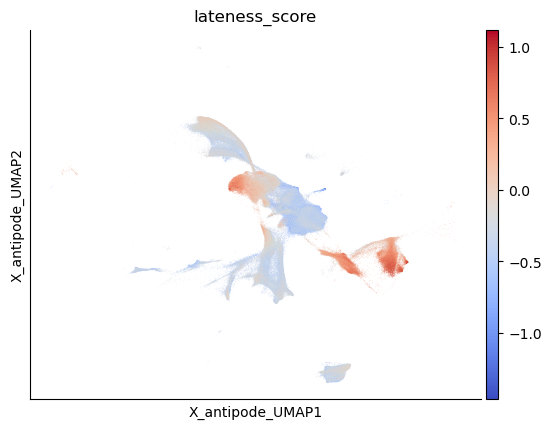

In [106]:
sc.pl.embedding(adata,basis='X_antipode_UMAP',color='lateness_score',cmap='coolwarm')

In [107]:
adata.obs.groupby('cluster_region')['late_genes'].median().sort_values()

/scratch/fast/3608344/ipykernel_2533973/3525362738.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby('cluster_region')['late_genes'].median().sort_values()


cluster_region
NPC_223__Ctx               -0.141987
NPC_368__HB                -0.111405
NPC_475__MB                -0.111185
NPC_271__FB                -0.109475
NPC_330__FB                -0.108811
                              ...   
Progen_Astro-OPC_592__FB    0.605601
Progen_Astro-OPC_39__DE     0.627391
Progen_Astro-OPC_39__FB     0.650357
Progen_Astro-OPC_39__HB     0.655190
Progen_Astro-OPC_39__MB     0.662528
Name: late_genes, Length: 314, dtype: float64

In [108]:
def series_sparsematrix_corr(s, M) -> np.ndarray:
    """
    Pearson correlation between Series s (length n)
    and each of the m columns of sparse matrix M (n×m).
    """
    x = s.values
    n, m = M.shape
    if x.shape[0] != n:
        raise ValueError(f"Series length {x.shape[0]} != matrix rows {n}")

    # means & std of x
    x_mean = x.mean()
    x_var = ((x - x_mean) ** 2).mean()
    x_std = np.sqrt(x_var)

    # column sums -> means
    col_sum = np.asarray(M.sum(axis=0)).ravel()
    y_mean = col_sum / n

    # E[XY] = (1/n) * sum_i x_i * y_i
    # M.T.dot(x) gives vector of sum_i x_i * M[i,j]
    xy = M.T.dot(x)  
    cov = xy / n - x_mean * y_mean

    # column sum of squares -> E[Y^2]
    M2 = M.multiply(M)
    col_sumsq = np.asarray(M2.sum(axis=0)).ravel()
    y_var = col_sumsq / n - y_mean**2
    y_var[y_var < 0] = 0  # guard against tiny negs
    y_std = np.sqrt(y_var)

    # Pearson r = cov / (σ_x σ_y)
    with np.errstate(divide='ignore', invalid='ignore'):
        corr = cov / (x_std * y_std)
    corr[np.isnan(corr)] = 0
    return corr

corr_vs_lateness = series_sparsematrix_corr(adata.obs['lateness_score'],adata.X)

In [109]:
tfs = pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/gene_lists/TFs_lambert_pmid29425488_1.01.txt')['hgnc_symbol']

In [110]:
import importlib
antipode.plotting = importlib.reload(antipode.plotting)

In [111]:
adata.obs['Initial_Class_region'].cat.categories

Index(['NPC_HB', 'NPC_MB', 'NPC_dDMR_DE', 'NPC_FB', 'NPC_RE_Gly-GABA_HB',
       'NPC_DE', 'NPC_Ctx', 'NPC_RL-UBC_HB', 'NPC_RG-TEd_Ctx',
       'NPC_IPC-Ctx_Ctx', 'NPC_RL-Cb_HB', 'NPC_PEv_FB',
       'Progen_Astro-Ependy_HB', 'Progen_Astro-TE_Ctx', 'Progen_Astro-OPC_MB',
       'Progen_Astro-OPC_HB', 'Progen_Astro-Ependy_MB',
       'Progen_Astro-Ependy_DE', 'Progen_Astro-Ependy_Ctx',
       'Progen_Astro-OPC_DE', 'Progen_Astro-OPC_Ctx', 'Progen_Astro-Ependy_FB',
       'Progen_Astro-OPC_FB'],
      dtype='object')

In [112]:
log_real_means,real_mean_levels=antipode.model_functions.get_real_leaf_means(adata,discov_key,'Initial_Class_region',layer='spliced')
real_means=pd.DataFrame(log_real_means.mean(0),columns=adata.var.index,index=real_mean_levels['Initial_Class_region'])
real_means=real_means.loc[real_mean_levels['Initial_Class_region'],:]
aggr_zeros=antipode.model_functions.group_aggr_anndata(adata,[discov_key,'Initial_Class_region'],layer='spliced',agg_func=antipode.model_functions.prop_zeros,normalize=True)

100%|██████████| 69/69 [01:09<00:00,  1.00s/it]


In [113]:
coords = {'species':discov_labels,'Initial_Class':adata.obs['Initial_Class_region'].cat.categories,'var':var_labels}
lrm = xr.DataArray(log_real_means,coords=coords)
az = xr.DataArray(aggr_zeros[0],coords=coords)
ads = xr.Dataset({'scalars':lrm,'proportions':az})

In [114]:
cluster_means,cluster_means_levels=antipode.model_functions.get_real_leaf_means(adata,discov_key,'cluster_region',layer='spliced')
coords = {'species':discov_labels,'cluster_region':adata.obs['cluster_region'].cat.categories,'var':var_labels}
lfc = xr.DataArray(cluster_means-np.median(cluster_means,0),coords=coords)

100%|██████████| 942/942 [00:45<00:00, 20.63it/s] 


In [115]:
iccd = adata.uns['Initial_Class_colors_dict']

In [116]:
iccd = {x:iccd[re.sub('_[A-Za-z]+$','',x)] for x in adata.obs['Initial_Class_region'].cat.categories}

In [117]:
ic_cr = adata.obs.loc[:,['Initial_Class_region','cluster_region']].drop_duplicates()
ic_cr

,Initial_Class_region,cluster_region
AGATGAATCCCA_e14-WT8,Progen_Astro-TE_Ctx,Progen_Astro-TE_570__Ctx
TGTTGAACCCAG_e14-WT8,NPC_Ctx,NPC_538__Ctx
GGTCACCAGCCC_e14-WT8,NPC_RG-TEd_Ctx,NPC_RG-TEd_7__Ctx
GTTCATGGATTA_e14-WT8,NPC_Ctx,NPC_119__Ctx
TTTAAGACGAGG_e14-WT8,Progen_Astro-OPC_Ctx,Progen_Astro-OPC_505__Ctx
...,...,...
CACTGAATCCGGTAGC_E65-2019A_Midbrain,Progen_Astro-Ependy_MB,Progen_Astro-Ependy_470__MB
GACGCGTCAATTCCTT_PEC_Yale_SingleCellRNAseq_RMB691_CBC,NPC_HB,NPC_574__HB
AACTTTCTCACATACG_Mac2_motor,NPC_Ctx,NPC_502__Ctx
CGGTTAAGTAGAAGGA_Mac2_motor,NPC_Ctx,NPC_371__Ctx


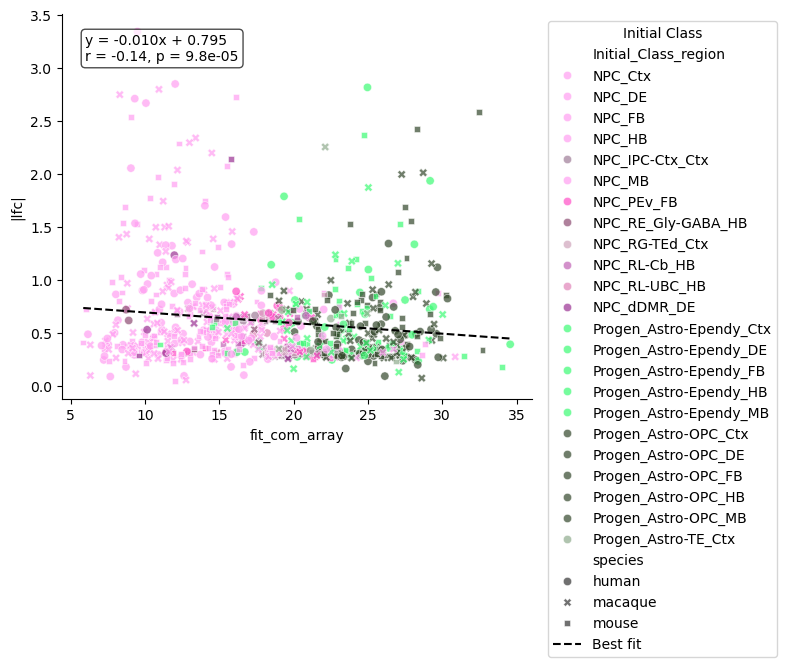

In [118]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import linregress

# 1) boolean mask for NPC regions
mask = fit_com_array.coords['cluster_region']#.str.contains('NPC')

# 2) slice out DataArrays
ds_x = fit_com_array.sel(cluster_region=mask)         
ds_y = np.abs(lfc.sel(cluster_region=mask)).mean('var')  

# 3) how many species per cluster?
var_len = ds_x.sizes['species']

# 4) cluster_region names
clusters = ds_x.coords['cluster_region'].values       

# 5) cluster_region → Initial_Class
cr_map = ic_cr.set_index('cluster_region')['Initial_Class_region']
initial_classes = [cr_map[c] for c in clusters]      

# 6) repeat labels per species
initials_rep = np.tile(initial_classes, var_len)    
species = np.tile(ds_x.coords['species'], len(initial_classes))    

# 7) flatten
x_flat = ds_x.values.flatten()
y_flat = ds_y.values.flatten()

# 8) assemble DataFrame
df = pd.DataFrame({
    'x': x_flat,
    'y': y_flat,
    'Initial_Class_region': initials_rep,
    'species':species
})
df['Initial_Class_region'] = df['Initial_Class_region'].astype('category')
df['Initial_Class_region'].cat.reorder_categories(adata.obs['Initial_Class_region'].cat.categories)

df = df.loc[~df['x'].isna() & ~df['y'].isna()]

# 9) compute linear regression
slope, intercept, r_value, p_value, std_err = linregress(df['x'], df['y'])

# 10) plot scatter
plt.figure(figsize=(8,6))
ax = sns.scatterplot(
    data=df,
    x='x', y='y',
    hue='Initial_Class_region',
    palette=iccd,
    style='species',
    alpha=0.7
)

# 11) plot fitted line manually
x_min, x_max = df['x'].min(), df['x'].max()
x_line = np.array([x_min, x_max])
y_line = slope * x_line + intercept
ax.plot(
    x_line, y_line,
    linestyle='--', linewidth=1.5, color='black',
    label='Best fit'
)

# 12) annotate equation & p-value
eqn = f'y = {slope:.3f}x + {intercept:.3f}\nr = {r_value:.2f}, p = {p_value:.2g}'
ax.text(
    0.05, 0.95, eqn,
    transform=ax.transAxes,
    ha='left', va='top',
    bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.7)
)

plt.xlabel('fit_com_array')
plt.ylabel('|lfc|')
plt.legend(bbox_to_anchor=(1.02,1), loc='upper left', title='Initial Class')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'com_vs_lfc_scatter.svg'), format='svg')
plt.show()


In [119]:
from scipy.stats import mannwhitneyu
from statannotations.Annotator import Annotator


/scratch/fast/3608344/ipykernel_2533973/1182770355.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  seaborn.heatmap(np.log10(adata.obs.groupby('species')['Initial_Class_region'].value_counts().unstack()))


<Axes: xlabel='Initial_Class_region', ylabel='species'>

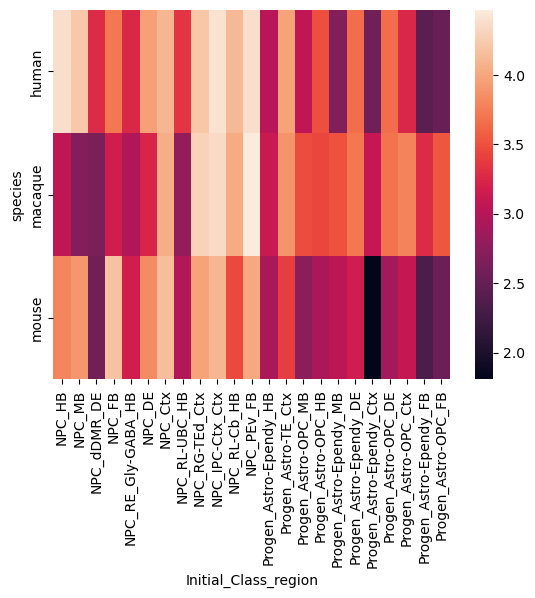

In [120]:
seaborn.heatmap(np.log10(adata.obs.groupby('species')['Initial_Class_region'].value_counts().unstack()))

/scratch/fast/3608344/ipykernel_2533973/1187153829.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(),rotation=90)


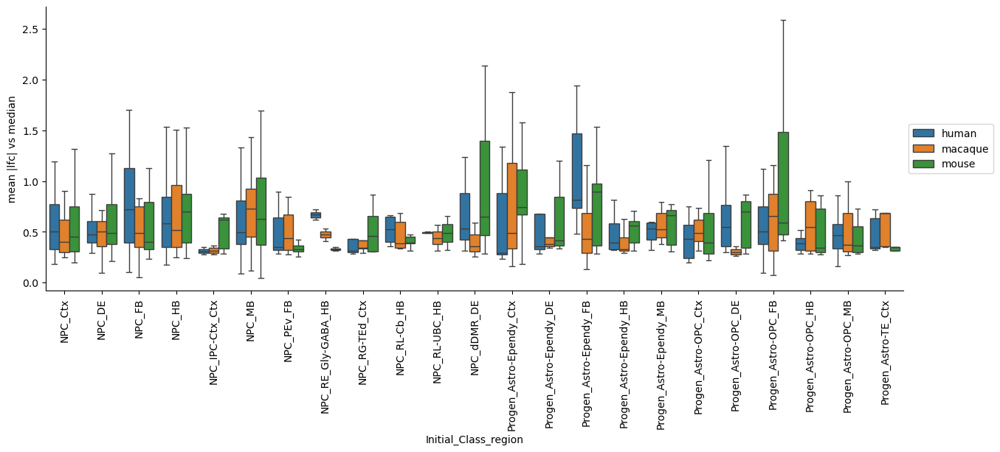

In [121]:
plt.figure(figsize=(15,5))
# ax=seaborn.stripplot(data=df,x='Initial_Class_region',y='y',hue='species',alpha=0.5,dodge=True)
ax=seaborn.boxplot(data=df,x='Initial_Class_region',y='y',hue='species',showfliers=False)
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
ax.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol=1)
plt.ylabel('mean |lfc| vs median')
plt.savefig(os.path.join(sc.settings.figdir, 'npc_mean_vs_median_boxplot.svg'), format='svg')


------- xs_scores -------


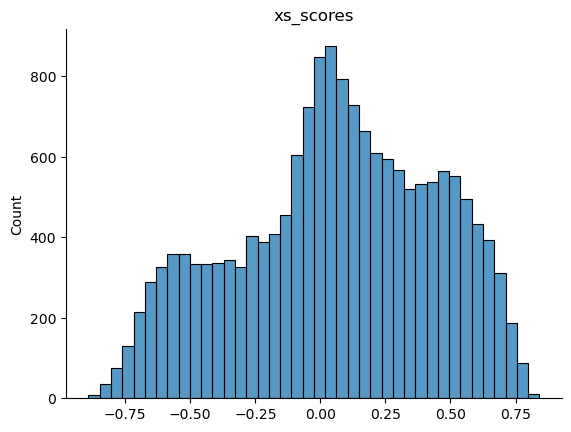

2025-09-26 23:07:27,891 [WARNING] Duplicated values found in preranked stats: 0.23% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


        Name                                               Term        ES  \
193  prerank  GO_Biological_Process_2025__mRNA Splice Site R...  0.444251   
191  prerank  GO_Biological_Process_2025__Nucleic Acid Catab...  0.432844   
189  prerank  GO_Biological_Process_2025__Regulation of DNA ...  0.294195   
186  prerank  GO_Biological_Process_2025__Nuclear Membrane O...  0.448133   
185  prerank  GO_Biological_Process_2025__tRNA Threonylcarba...  0.689773   
..       ...                                                ...       ...   
4    prerank  GO_Biological_Process_2025__Mitochondrial Gene...  0.518609   
3    prerank  GO_Biological_Process_2025__rRNA Processing (G...  0.517469   
2    prerank  GO_Biological_Process_2025__RNA Splicing (GO:0...  0.548121   
1    prerank  GO_Biological_Process_2025__Ribosome Biogenesi...  0.499055   
0    prerank  GO_Biological_Process_2025__RNA Processing (GO...   0.46126   

          NES NOM p-val FDR q-val FWER p-val    Tag %  Gene %  \
193  1.875

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


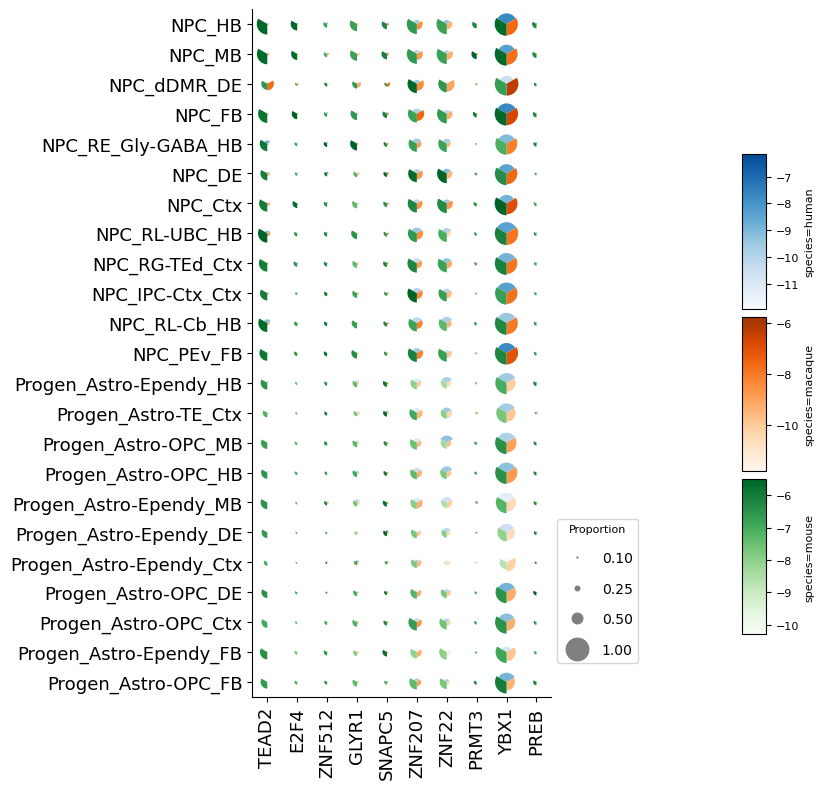

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


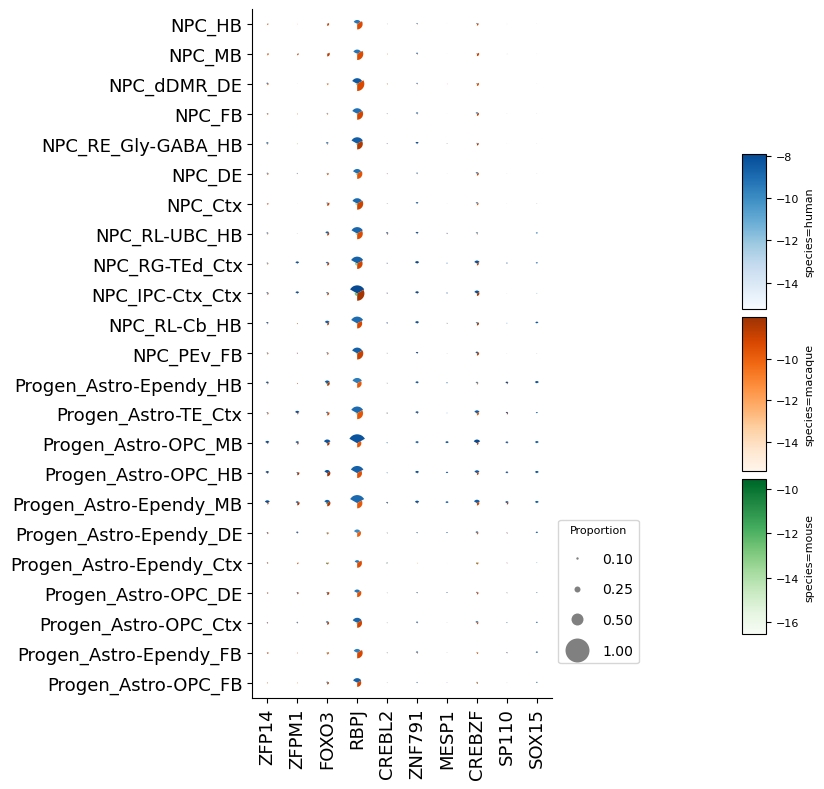

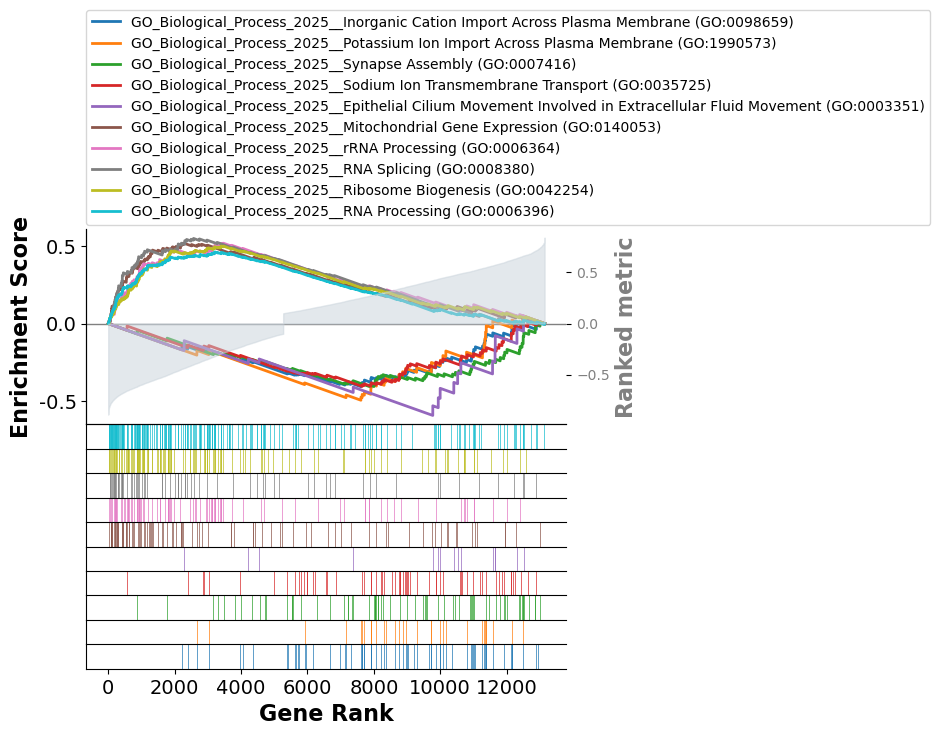

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families we

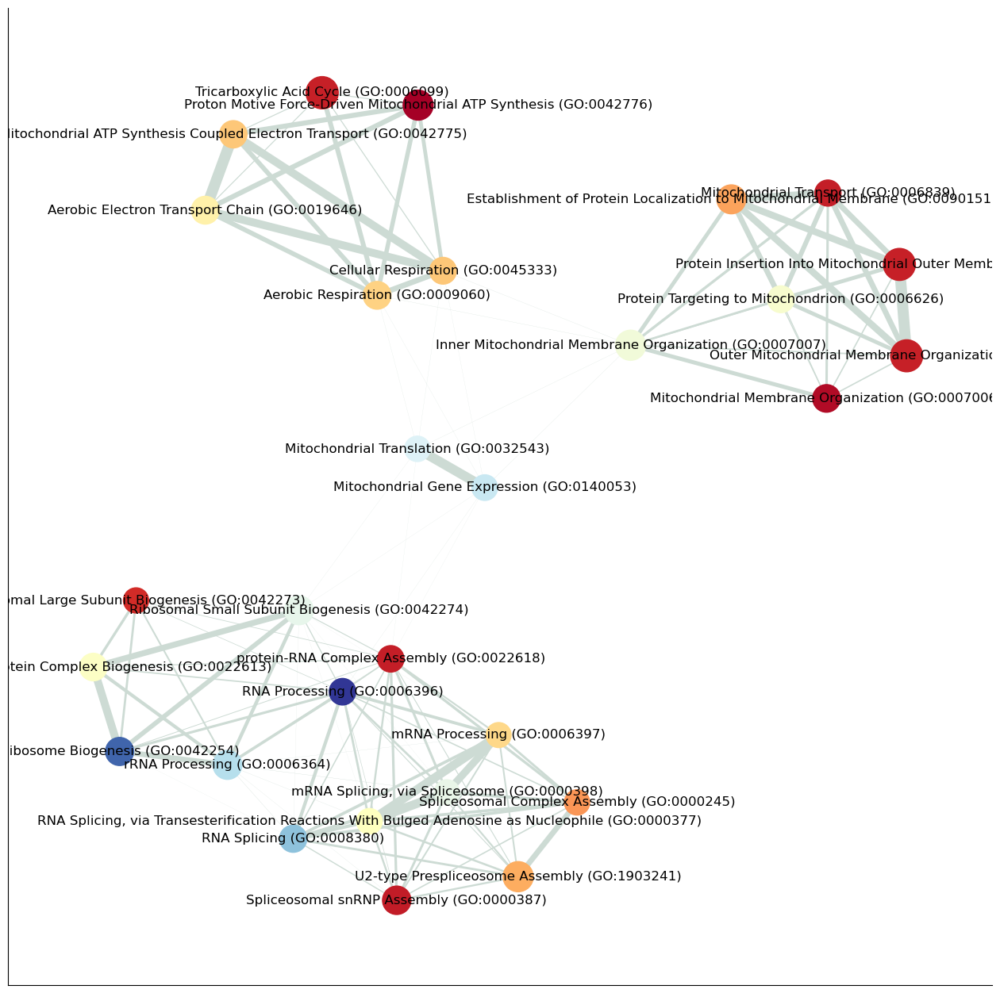

------- com_scores -------


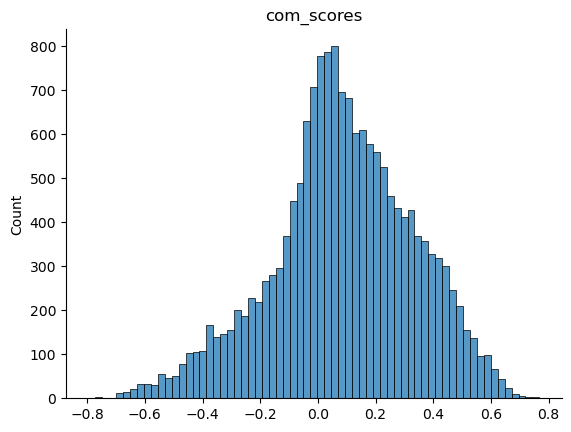

2025-09-26 23:10:39,140 [WARNING] Duplicated values found in preranked stats: 1.36% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


        Name                                               Term        ES  \
93   prerank  GO_Biological_Process_2025__Synapse Assembly (... -0.548486   
122  prerank  GO_Biological_Process_2025__Synapse Organizati... -0.461557   
127  prerank  GO_Biological_Process_2025__Neuron Projection ... -0.451572   
136  prerank  GO_Biological_Process_2025__Regulation of Axon... -0.611695   
137  prerank  GO_Biological_Process_2025__Regulation of Axon... -0.591628   
..       ...                                                ...       ...   
4    prerank  GO_Biological_Process_2025__rRNA Processing (G...  0.720001   
3    prerank  GO_Biological_Process_2025__Ribonucleoprotein ...  0.724745   
2    prerank  GO_Biological_Process_2025__Cytoplasmic Transl...  0.756424   
1    prerank  GO_Biological_Process_2025__Ribosome Biogenesi...  0.730331   
0    prerank  GO_Biological_Process_2025__Translation (GO:00...  0.704921   

          NES NOM p-val FDR q-val FWER p-val    Tag %  Gene %  \
93  -2.657

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


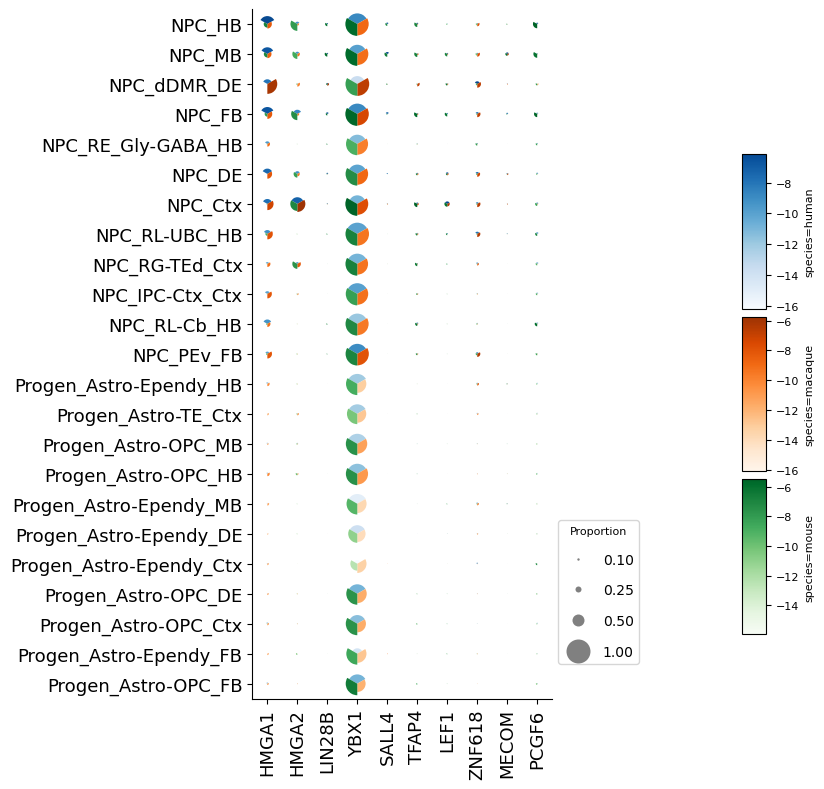

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


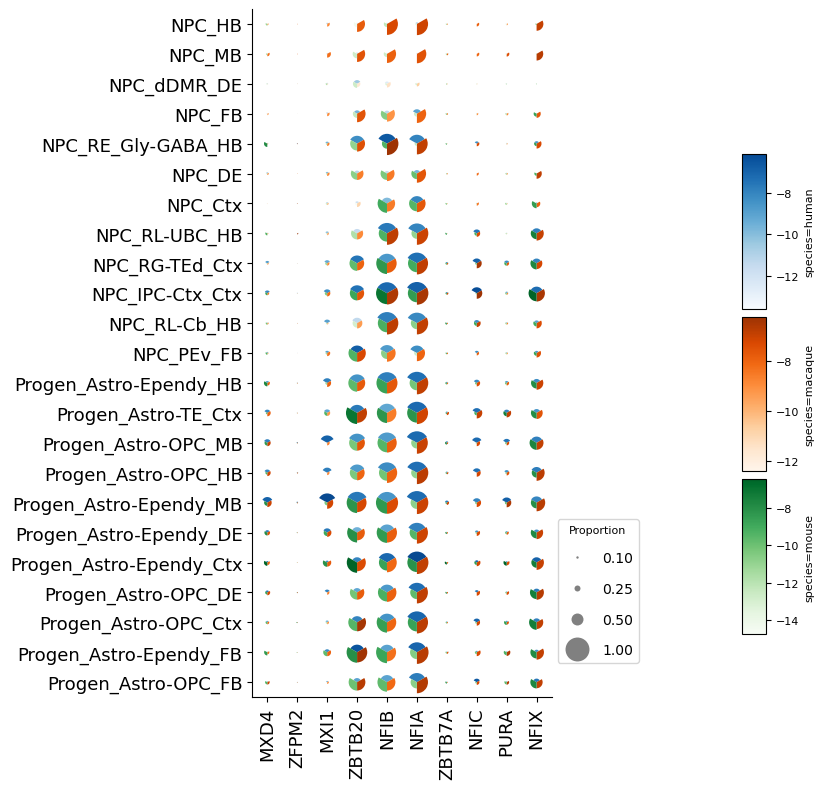

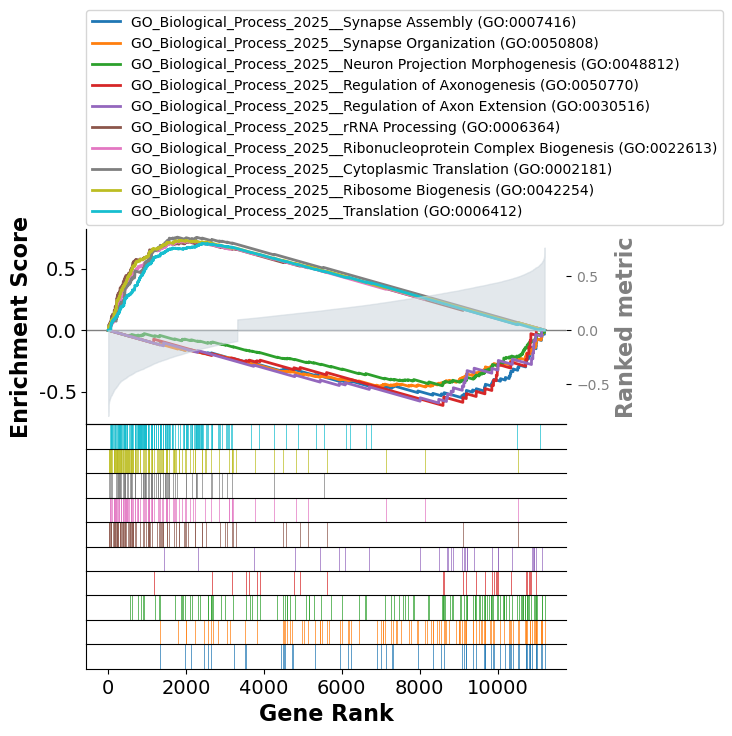

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families we

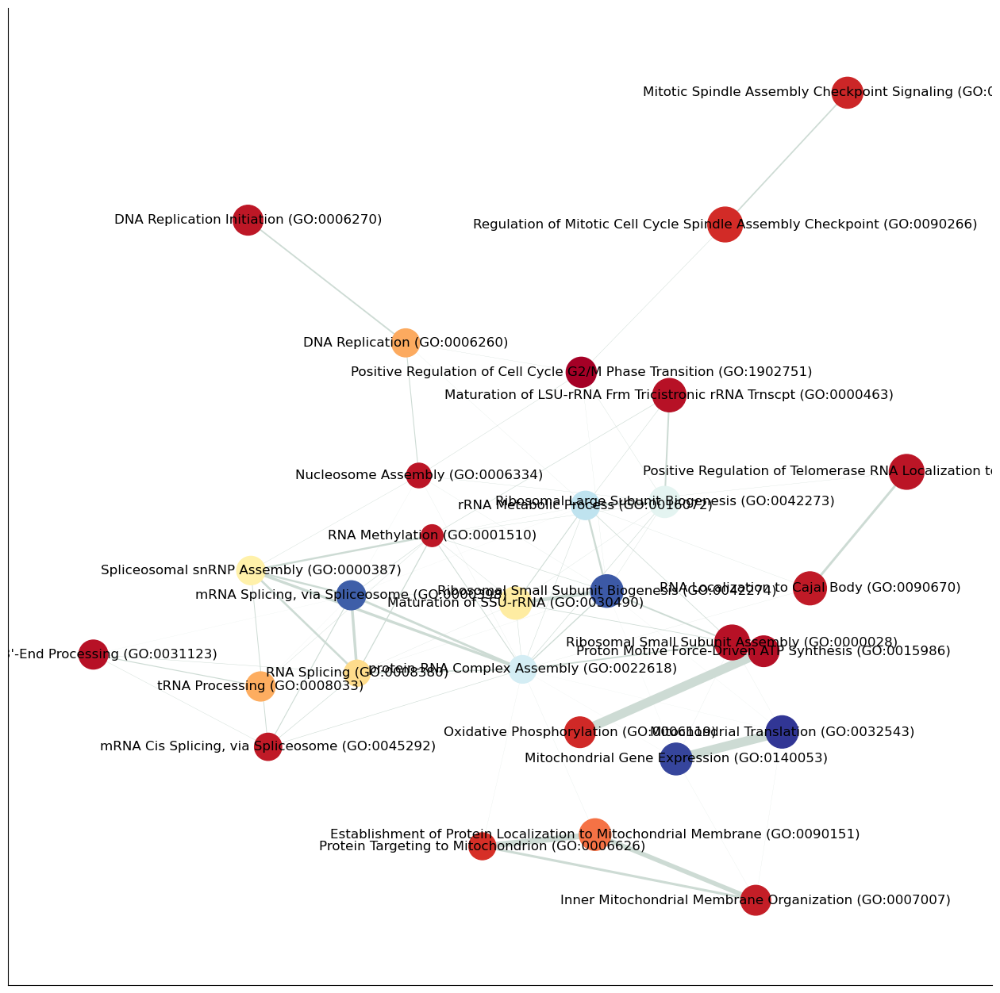

------- fit_xs_scores -------


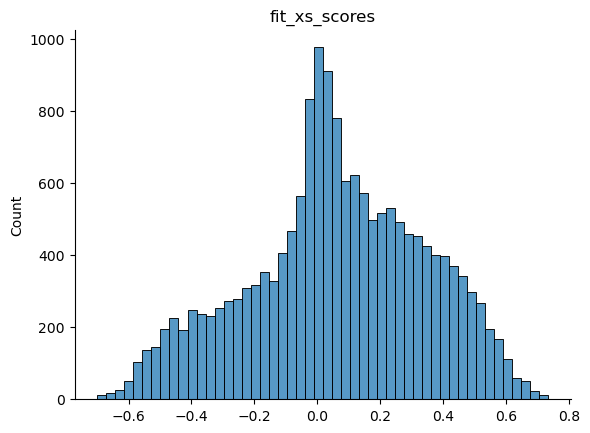

2025-09-26 23:13:14,465 [WARNING] Duplicated values found in preranked stats: 0.01% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


        Name                                               Term        ES  \
205  prerank  GO_Biological_Process_2025__Positive Regulatio...  0.626083   
204  prerank  GO_Biological_Process_2025__Regulation of DNA ...  0.492626   
203  prerank  GO_Biological_Process_2025__Cellular Response ...  0.660591   
202  prerank  GO_Biological_Process_2025__Positive Regulatio...  0.709708   
201  prerank  GO_Biological_Process_2025__Positive Regulatio...  0.364828   
..       ...                                                ...       ...   
4    prerank  GO_Biological_Process_2025__Ribosome Biogenesi...  0.444112   
3    prerank  GO_Biological_Process_2025__RNA Splicing, via ...  0.452126   
2    prerank  GO_Biological_Process_2025__mRNA Splicing, via...  0.429928   
1    prerank  GO_Biological_Process_2025__RNA Splicing (GO:0...  0.506061   
0    prerank  GO_Biological_Process_2025__RNA Processing (GO...  0.430353   

          NES NOM p-val FDR q-val FWER p-val    Tag %  Gene %  \
205  1.877

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


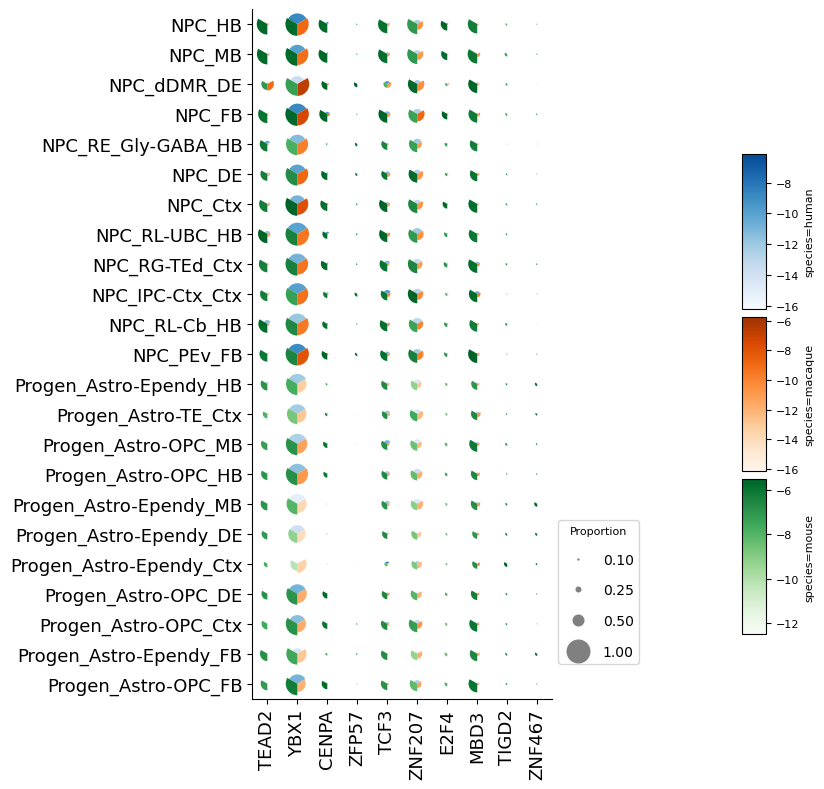

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


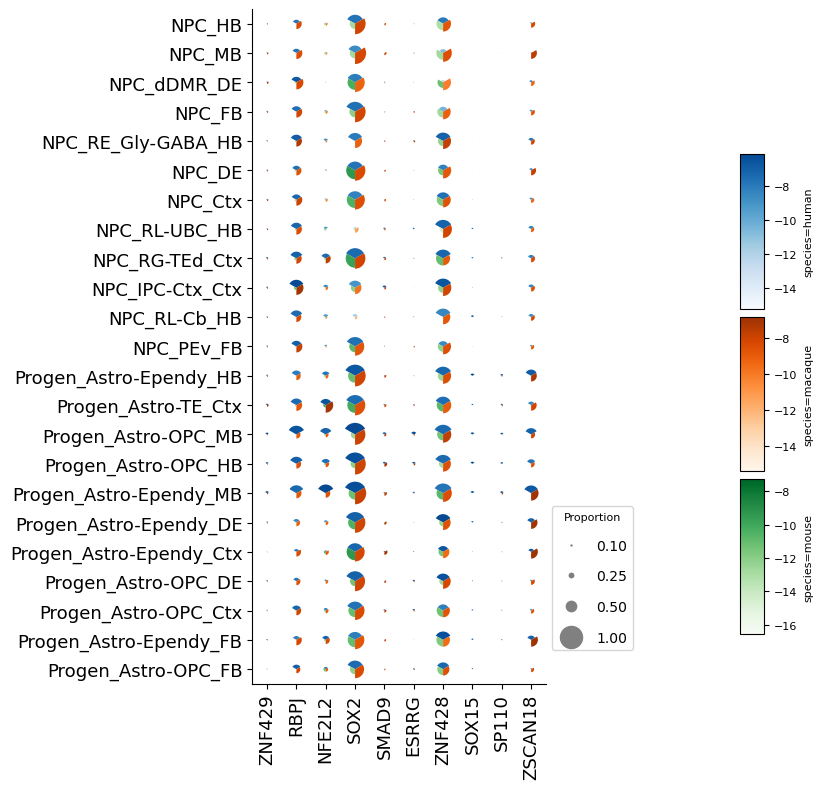

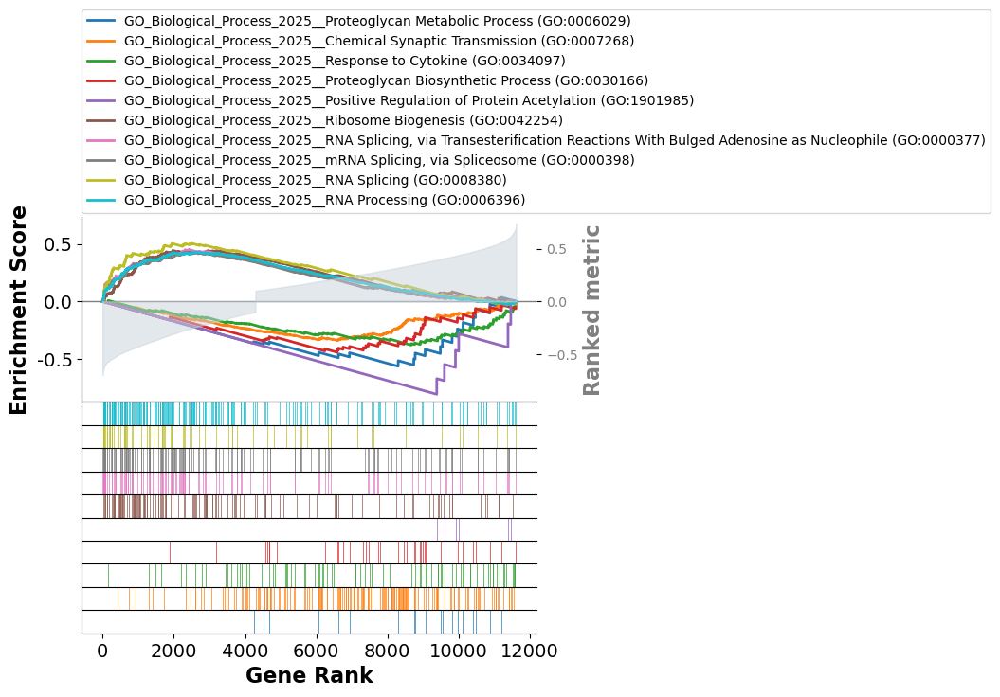

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families we

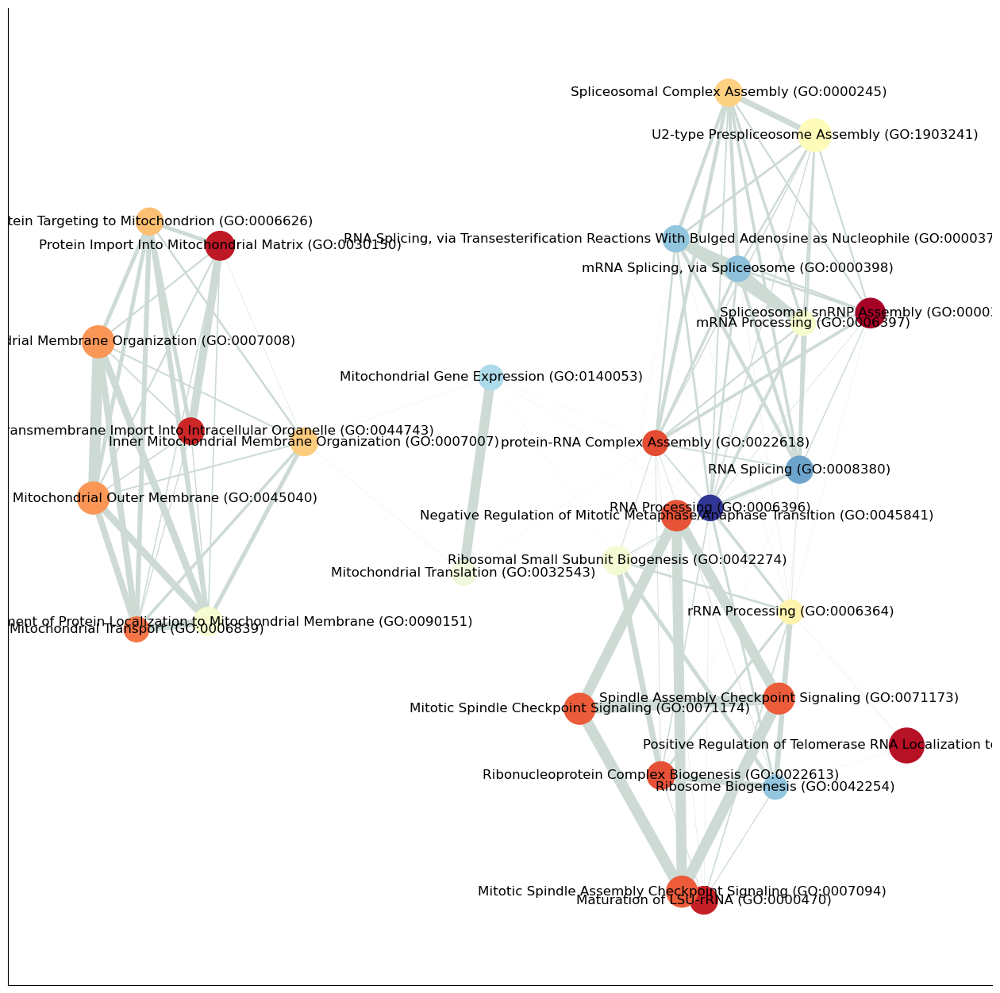

------- fit_com_npc_scores -------


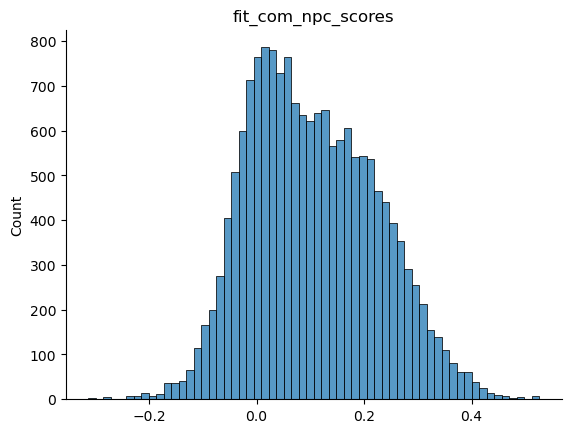

2025-09-26 23:15:50,576 [WARNING] Duplicated values found in preranked stats: 1.24% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


      Name                                               Term        ES  \
3  prerank  GO_Biological_Process_2025__Vasculature Develo...   -0.7486   
4  prerank  GO_Biological_Process_2025__Oligodendrocyte Di... -0.753215   
1  prerank  GO_Biological_Process_2025__Nucleobase-Contain...  0.713626   
0  prerank  GO_Biological_Process_2025__Detection of Chemi...  0.877855   

        NES NOM p-val FDR q-val FWER p-val Tag %  Gene %  \
3  -2.30796       0.0  0.037323      0.034  6/10   5.46%   
4 -2.246534       0.0  0.046163       0.08   5/9   2.05%   
1  2.655891       0.0  0.010582      0.019   9/9  28.71%   
0  2.876152       0.0  0.006684      0.006   7/7  12.29%   

                                          Lead_genes  
3                FBXW7;BMPR2;QKI;STK11;PDGFRB;PIK3CA  
4                         HES5;SOX9;SOX8;PTPRZ1;SOX6  
1  AK2;NUDT14;ENTPD7;GLRX;NME5;NUDT18;NUDT13;AK4;...  
0         PKD2L1;LPO;RTP4;TAS1R2;BPNT1;TAS1R3;TAS2R4  
CRABP2   -0.312575
HMGA1    -0.305341
PKM      -

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


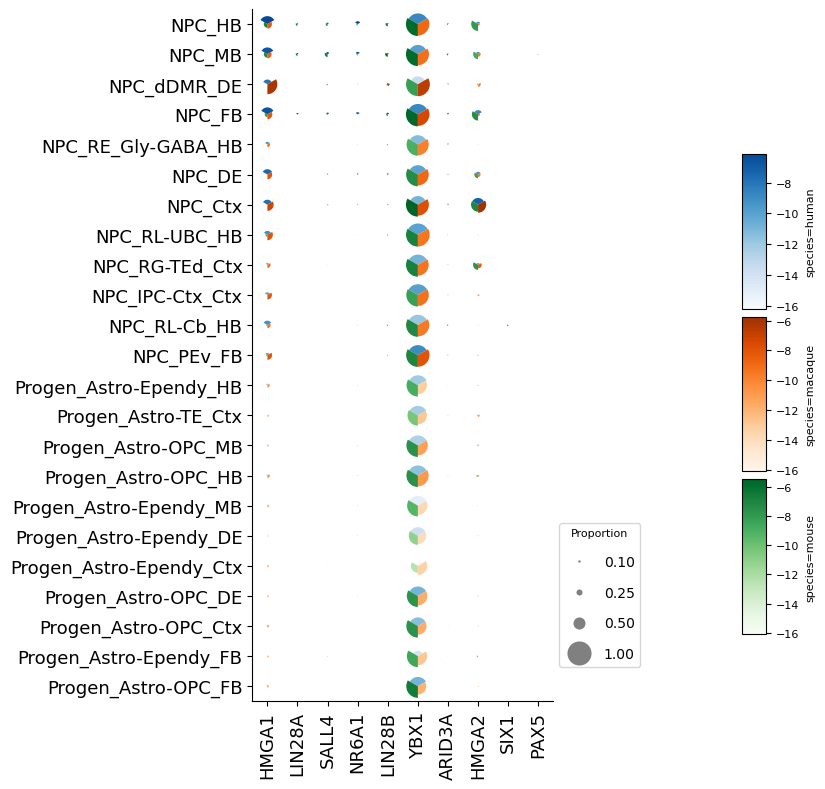

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


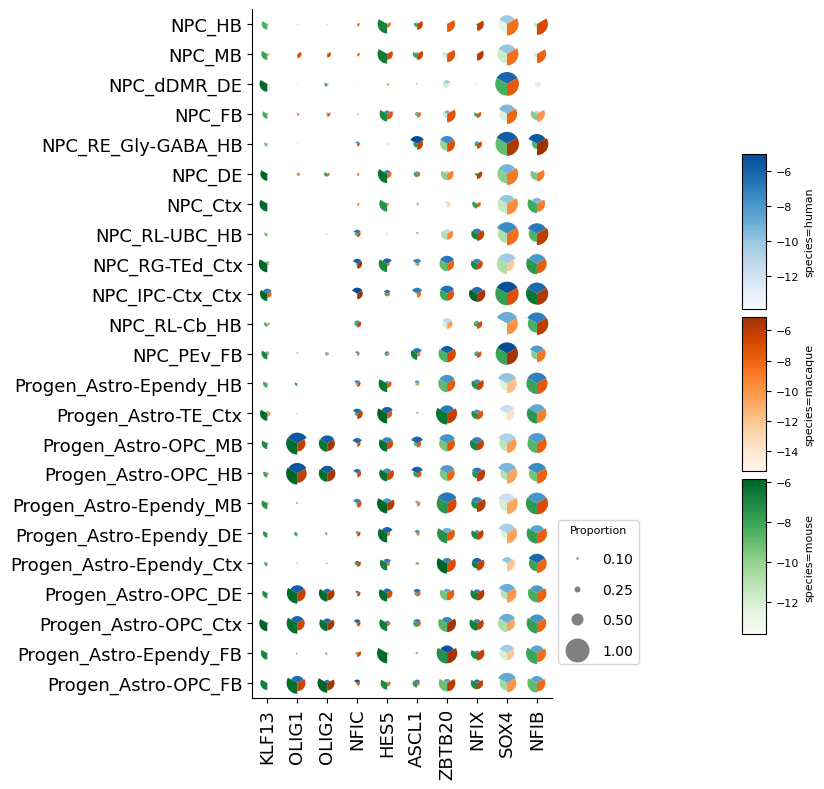

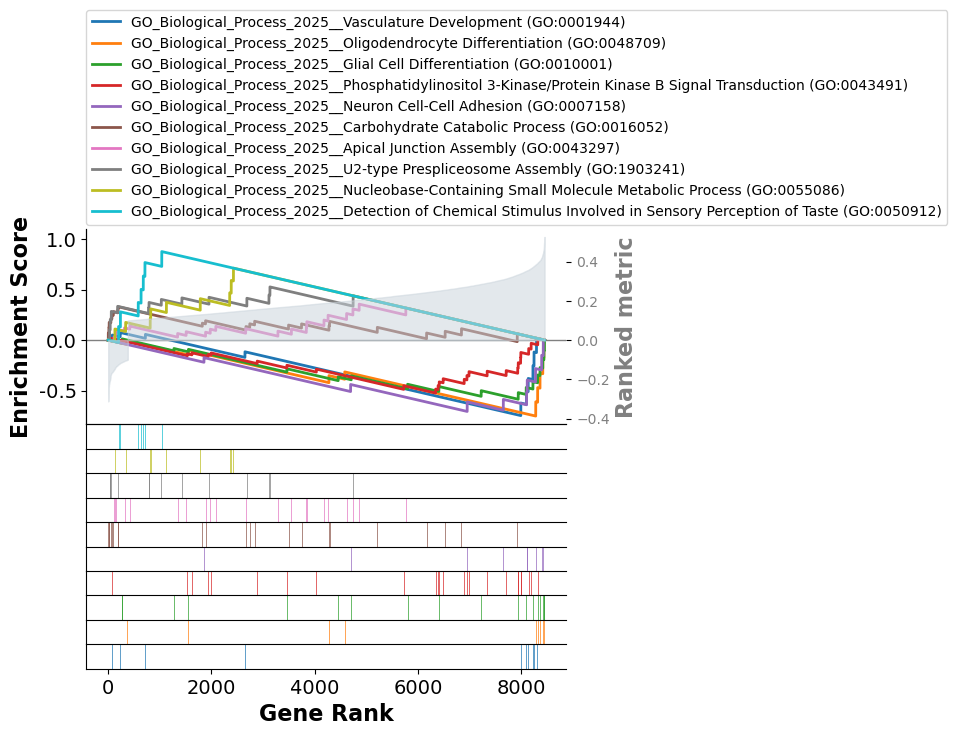

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()


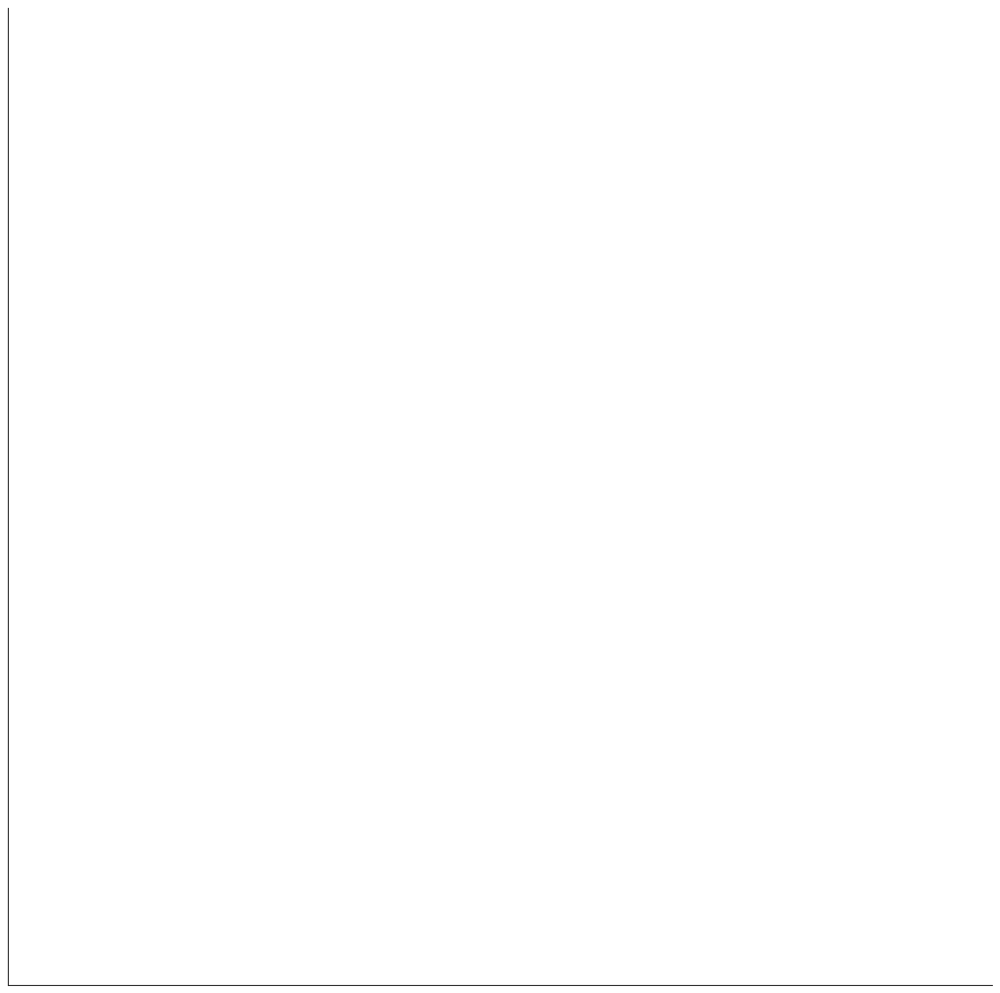

------- fit_com_scores -------


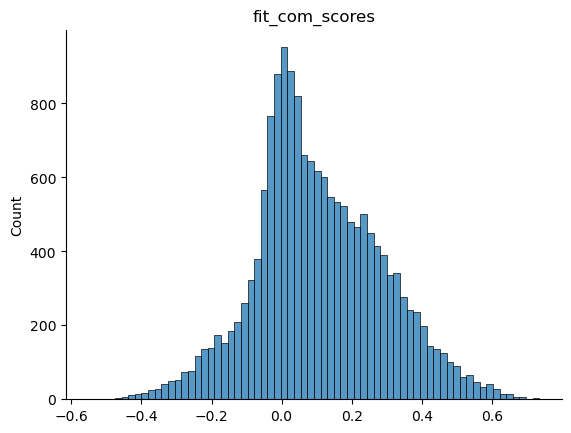

2025-09-26 23:17:25,553 [WARNING] Duplicated values found in preranked stats: 0.07% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


        Name                                               Term        ES  \
157  prerank  GO_Biological_Process_2025__Membrane Assembly ...  -0.59657   
160  prerank  GO_Biological_Process_2025__Negative Regulatio... -0.588502   
164  prerank  GO_Biological_Process_2025__Response to Steroi... -0.625117   
169  prerank  GO_Biological_Process_2025__Regulation of Filo... -0.586929   
177  prerank  GO_Biological_Process_2025__Intracellular pH R... -0.592133   
..       ...                                                ...       ...   
4    prerank  GO_Biological_Process_2025__rRNA Processing (G...  0.640381   
3    prerank  GO_Biological_Process_2025__mRNA Splicing, via...   0.56717   
2    prerank  GO_Biological_Process_2025__RNA Splicing, via ...  0.645135   
1    prerank  GO_Biological_Process_2025__mRNA Processing (G...  0.571044   
0    prerank  GO_Biological_Process_2025__Cytoplasmic Transl...  0.783947   

          NES NOM p-val FDR q-val FWER p-val   Tag %  Gene %  \
157 -2.2688

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


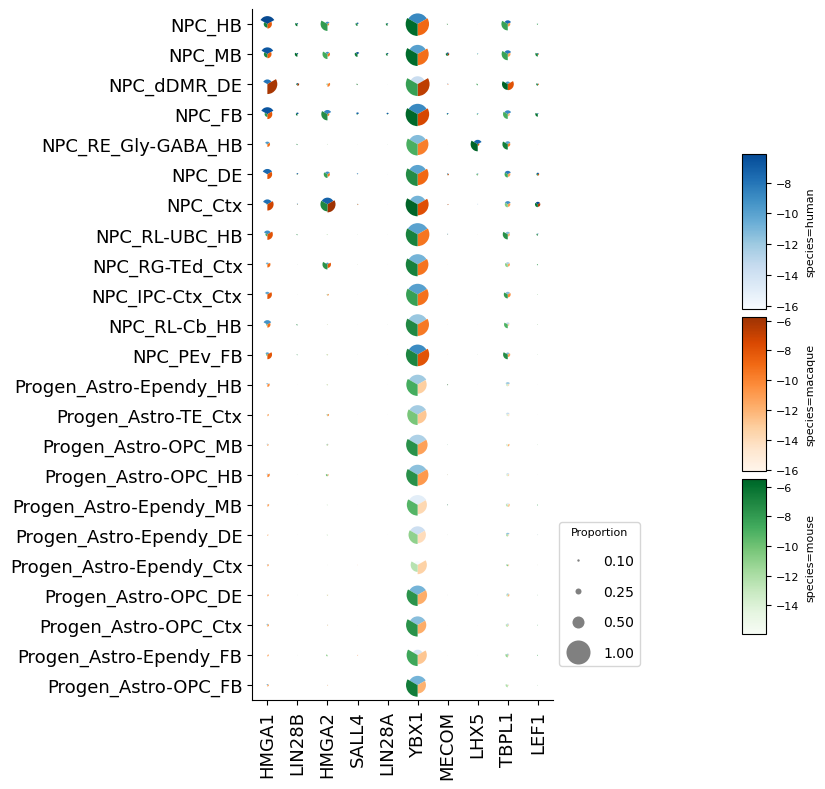

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


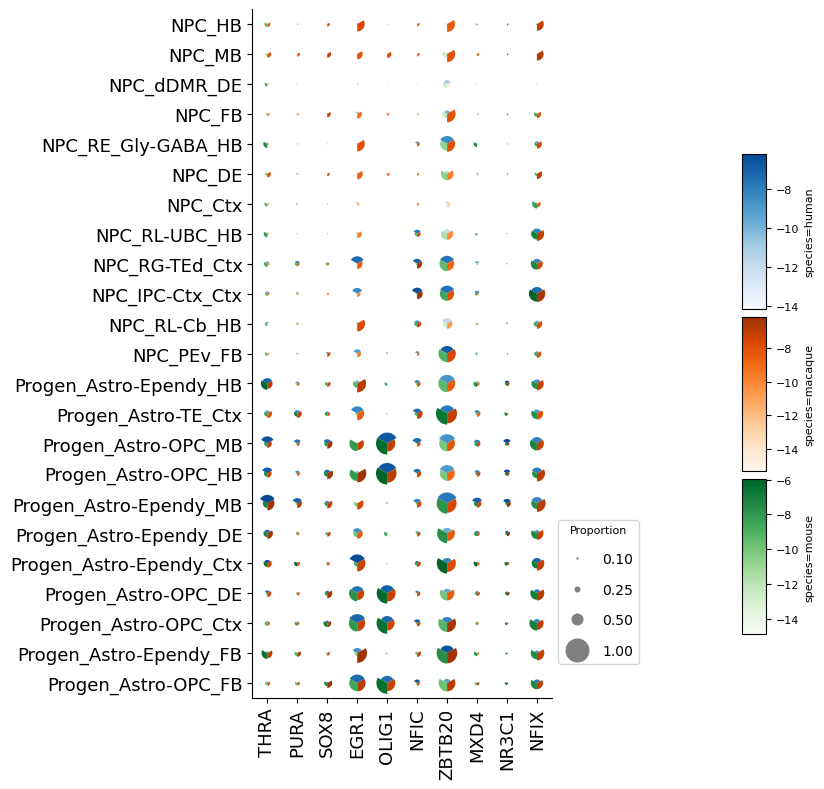

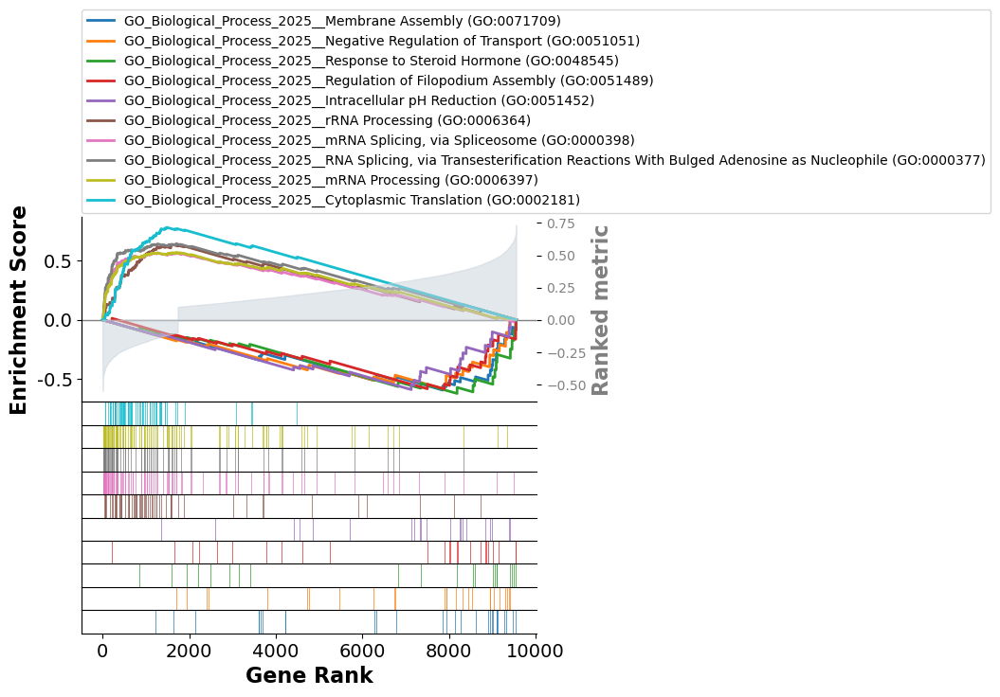

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families we

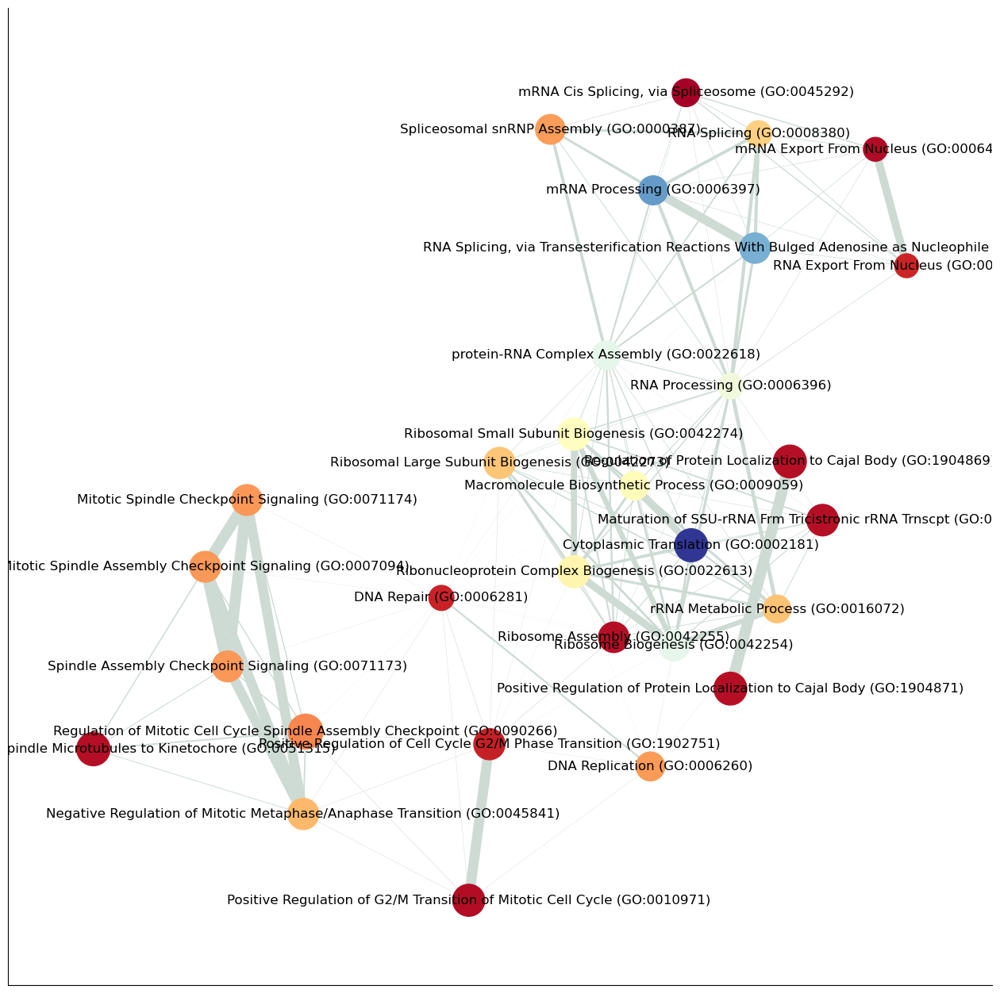

------- fit_mu_scores -------


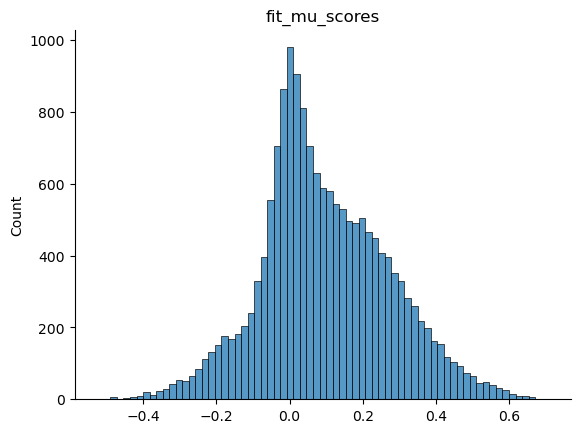

2025-09-26 23:19:24,350 [WARNING] Duplicated values found in preranked stats: 0.07% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


        Name                                               Term        ES  \
145  prerank  GO_Biological_Process_2025__Regulation of Filo... -0.634464   
152  prerank  GO_Biological_Process_2025__Membrane Assembly ... -0.592886   
158  prerank  GO_Biological_Process_2025__Response to Steroi... -0.646251   
164  prerank  GO_Biological_Process_2025__Positive Regulatio... -0.795138   
168  prerank  GO_Biological_Process_2025__Response to Ketone... -0.746555   
..       ...                                                ...       ...   
4    prerank  GO_Biological_Process_2025__Macromolecule Bios...   0.51367   
3    prerank  GO_Biological_Process_2025__RNA Splicing, via ...  0.657021   
2    prerank  GO_Biological_Process_2025__Translation (GO:00...  0.609415   
1    prerank  GO_Biological_Process_2025__mRNA Splicing, via...   0.57577   
0    prerank  GO_Biological_Process_2025__Cytoplasmic Transl...  0.784216   

          NES NOM p-val FDR q-val FWER p-val   Tag %  Gene %  \
145 -2.3888

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


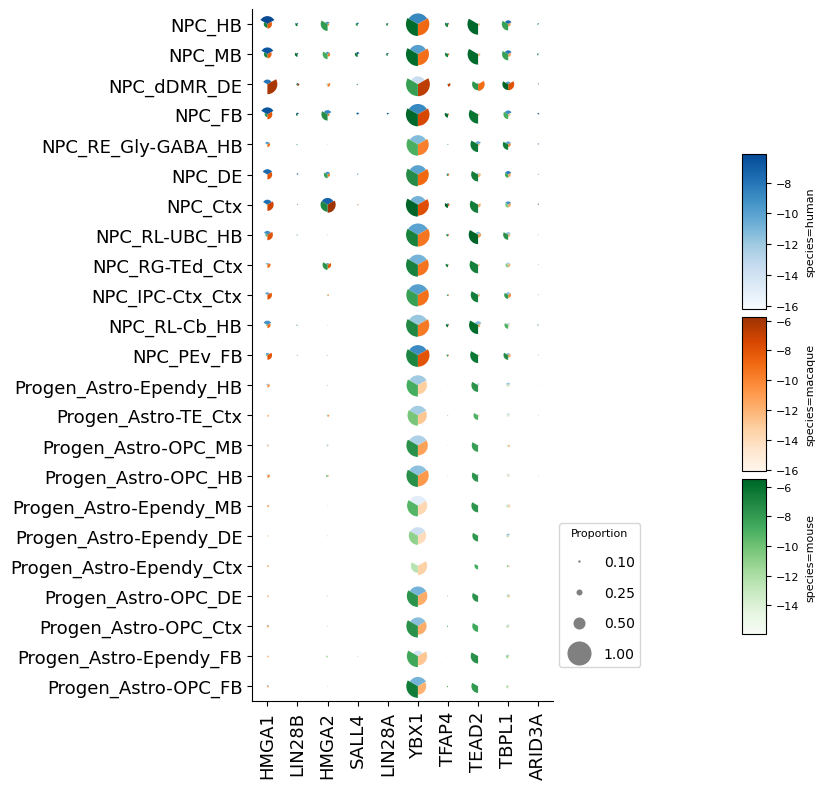

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


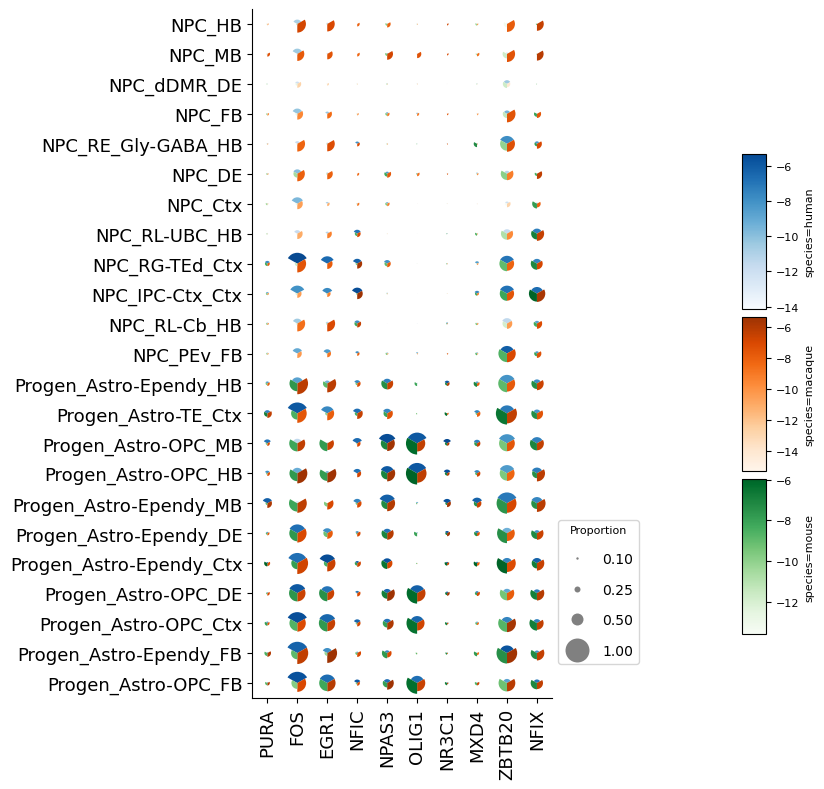

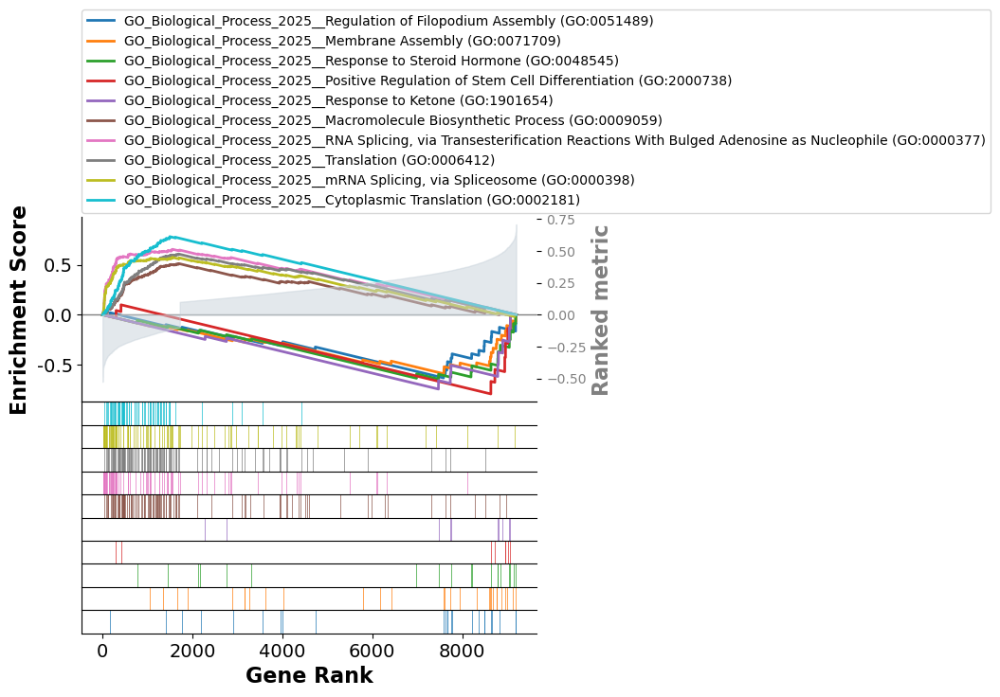

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families we

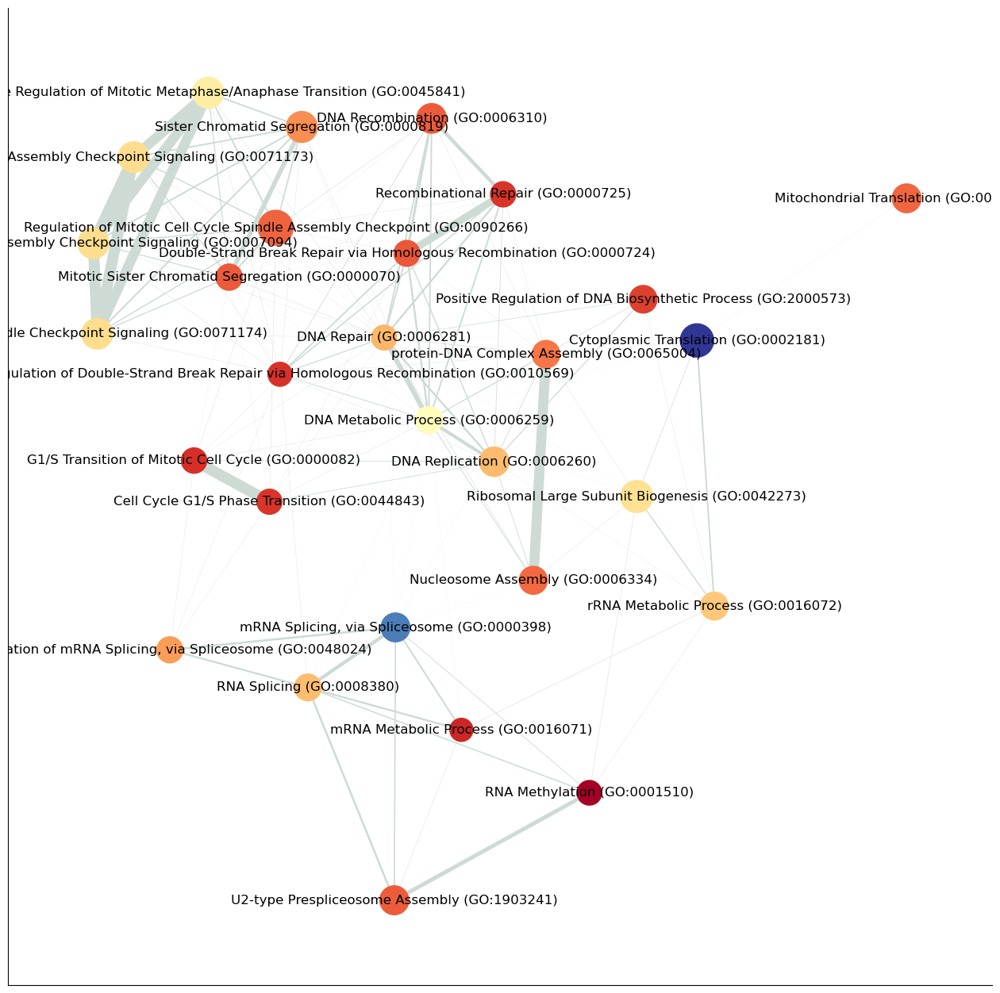

------- fit_auc_scores -------


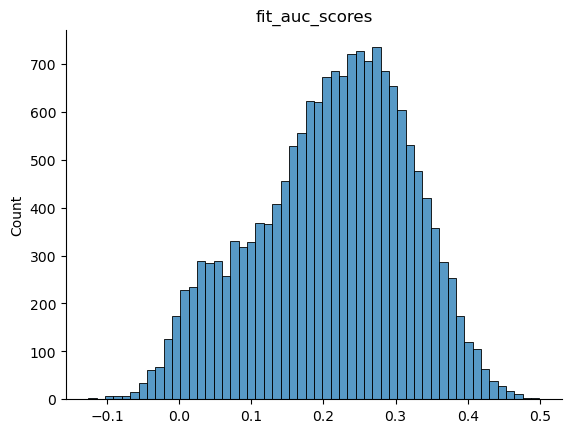

2025-09-26 23:21:18,550 [WARNING] Duplicated values found in preranked stats: 0.17% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


       Name                                               Term        ES  \
12  prerank  GO_Biological_Process_2025__Synaptic Vesicle E...  -0.48938   
13  prerank  GO_Biological_Process_2025__Interstrand Cross-... -0.492492   
14  prerank  GO_Biological_Process_2025__Neurotransmitter S... -0.494566   
15  prerank  GO_Biological_Process_2025__Regulation of Regu... -0.509349   
17  prerank  GO_Biological_Process_2025__Regulation of Rab ... -0.845287   
19  prerank  GO_Biological_Process_2025__DNA Integrity Chec... -0.454993   
20  prerank  GO_Biological_Process_2025__Central Nervous Sy... -0.461612   
22  prerank  GO_Biological_Process_2025__Modulation of Exci... -0.501416   
23  prerank  GO_Biological_Process_2025__Positive Regulatio... -0.481078   
28  prerank  GO_Biological_Process_2025__Signal Release Fro... -0.475073   
30  prerank  GO_Biological_Process_2025__Positive Regulatio... -0.438038   
11  prerank  GO_Biological_Process_2025__Cellular Respirati...  0.242928   
10  prerank 

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


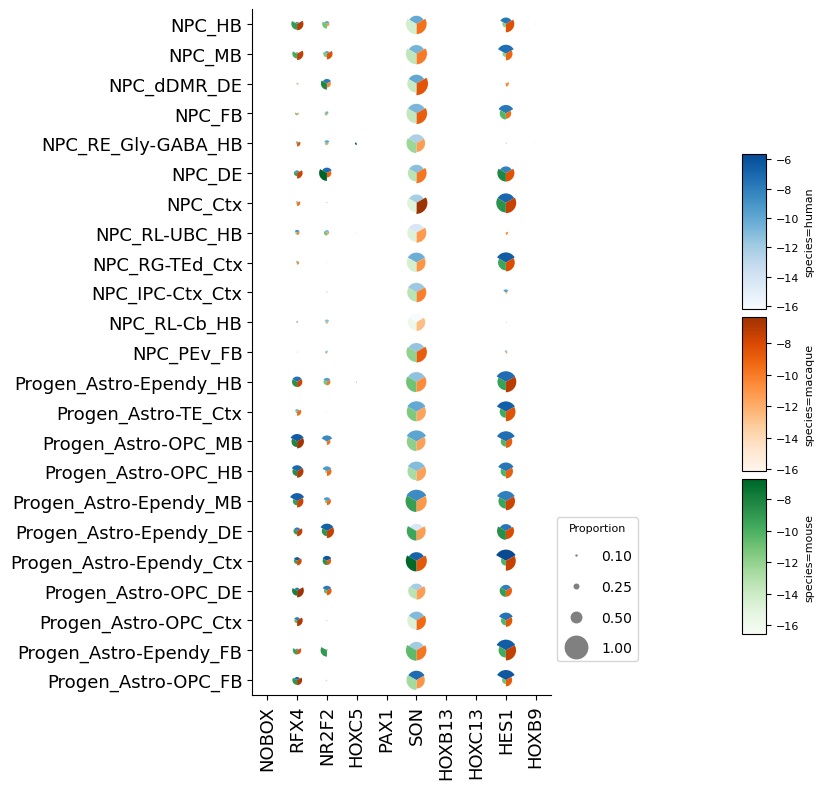

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


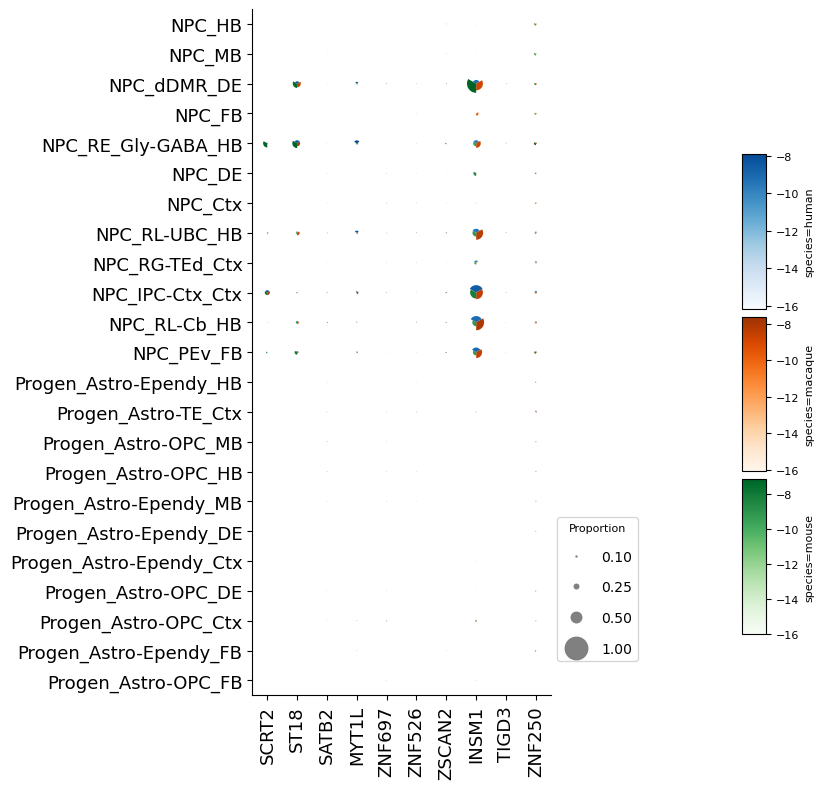

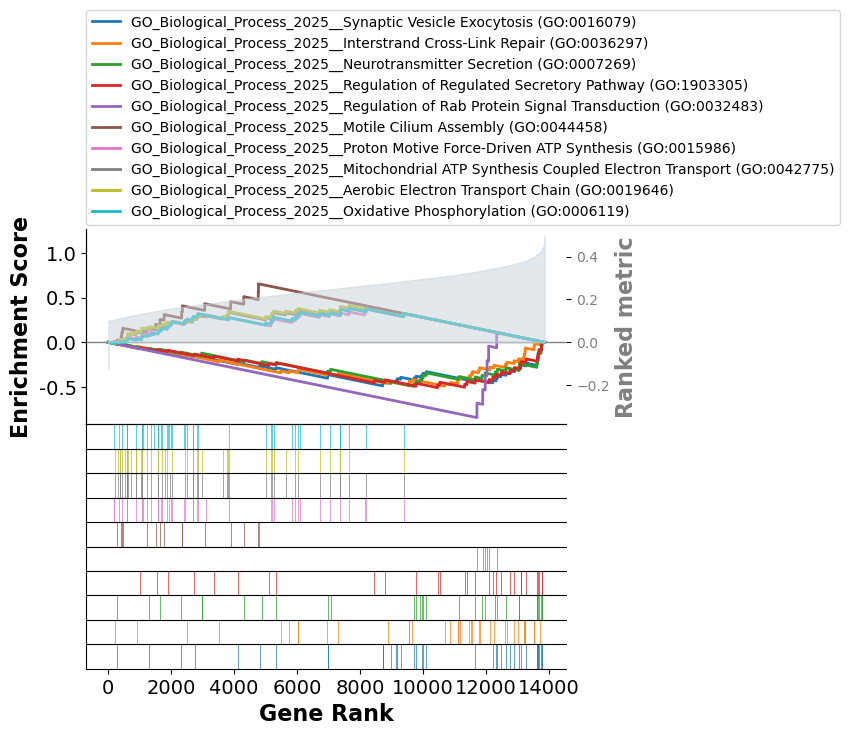

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families we

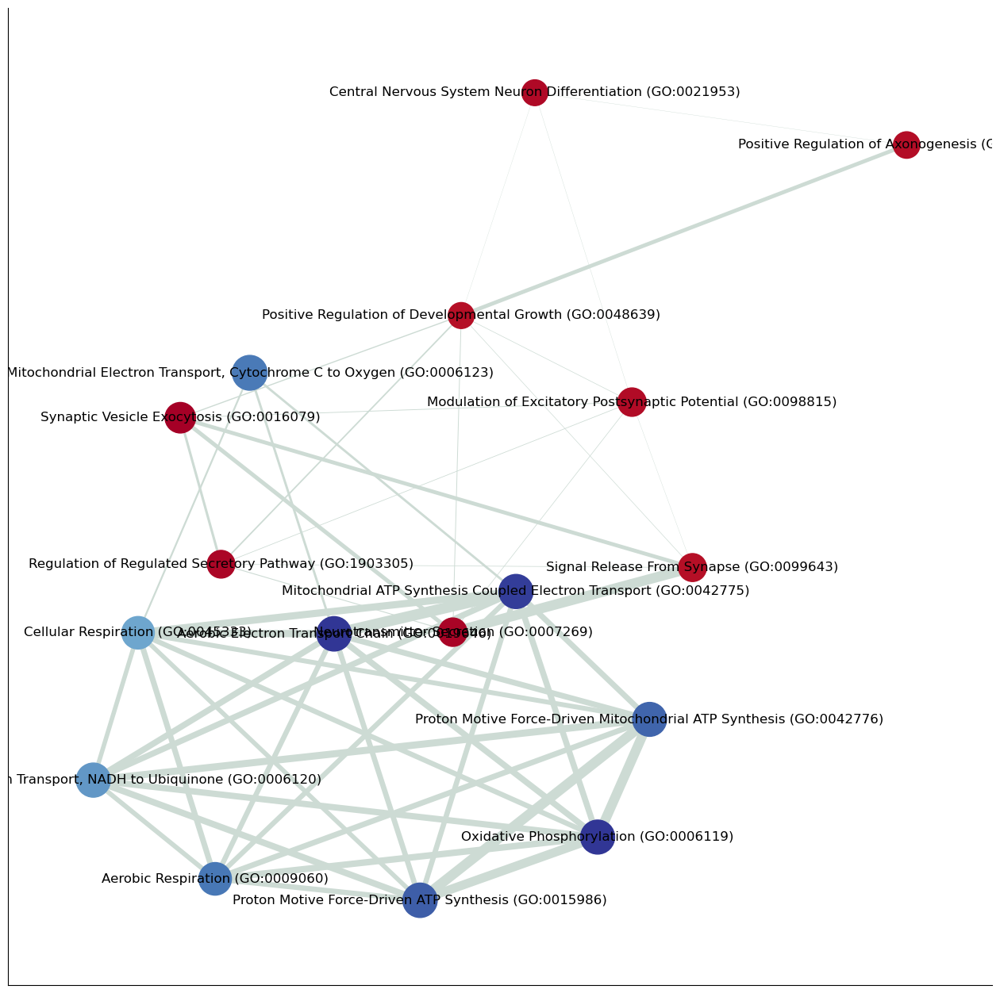

------- fit_dt_npc_scores -------


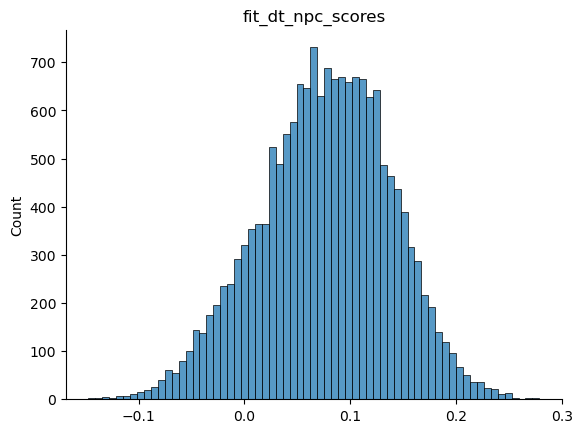

2025-09-26 23:24:37,648 [WARNING] Duplicated values found in preranked stats: 2.22% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


      Name                                               Term        ES  \
0  prerank  GO_Biological_Process_2025__Cytoplasmic Transl... -0.416352   
1  prerank  GO_Biological_Process_2025__Mitotic Nuclear Di... -0.462404   
2  prerank  GO_Biological_Process_2025__rRNA Processing (G... -0.355587   
3  prerank  GO_Biological_Process_2025__Translation (GO:00...  -0.29677   
4  prerank  GO_Biological_Process_2025__Regulation of mRNA... -0.482665   
5  prerank  GO_Biological_Process_2025__Sister Chromatid S...  -0.45518   

        NES NOM p-val FDR q-val FWER p-val   Tag %  Gene %  \
0 -2.792042       0.0       0.0        0.0   45/65  35.83%   
1 -2.455004       0.0  0.022516      0.039   27/31  44.72%   
2 -2.386218       0.0  0.034358       0.08   42/64  38.26%   
3 -2.357253       0.0  0.036026      0.112  78/136  37.53%   
4 -2.339176       0.0  0.038228      0.145   14/24  19.98%   
5 -2.305122       0.0  0.044866      0.199   19/28  29.04%   

                                       

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


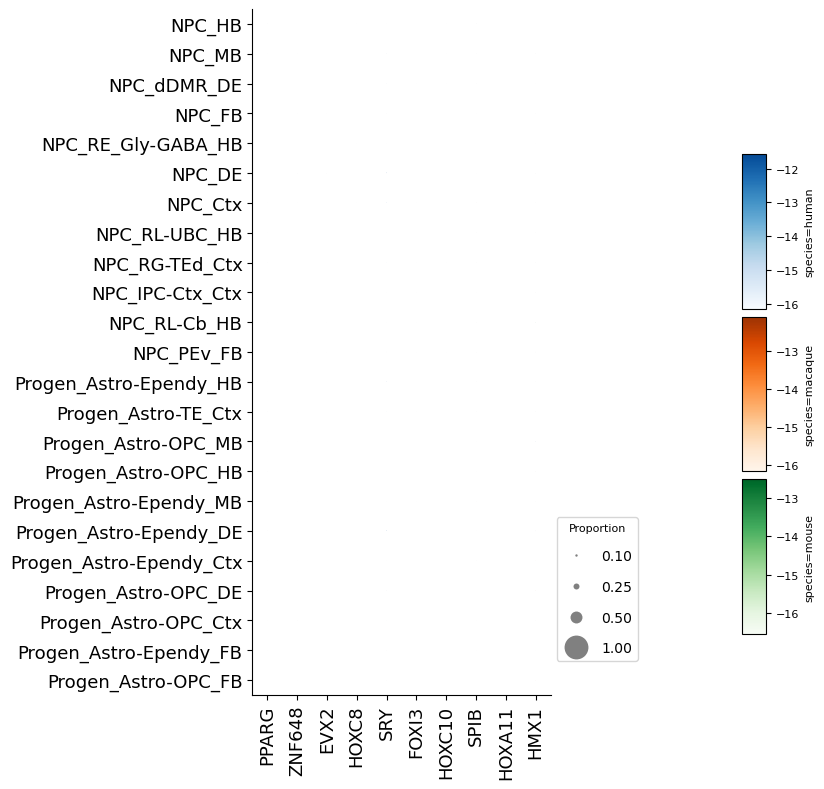

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


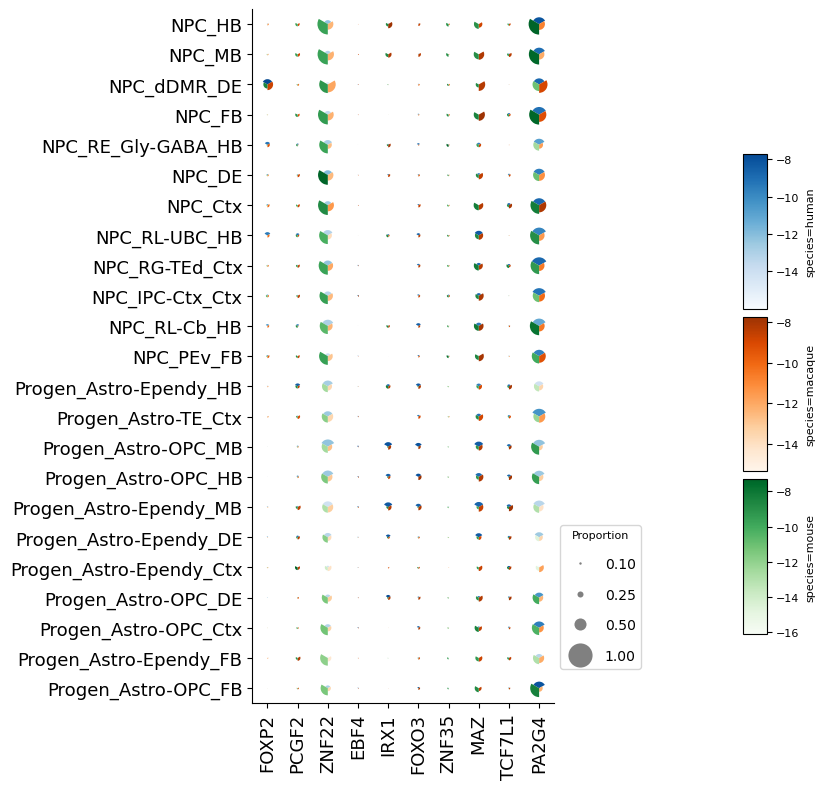

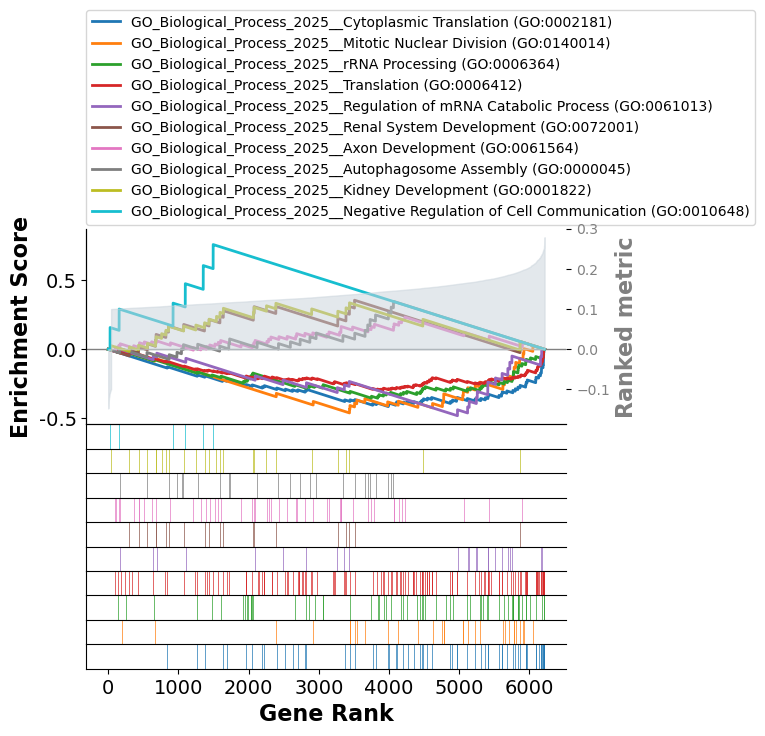

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families we

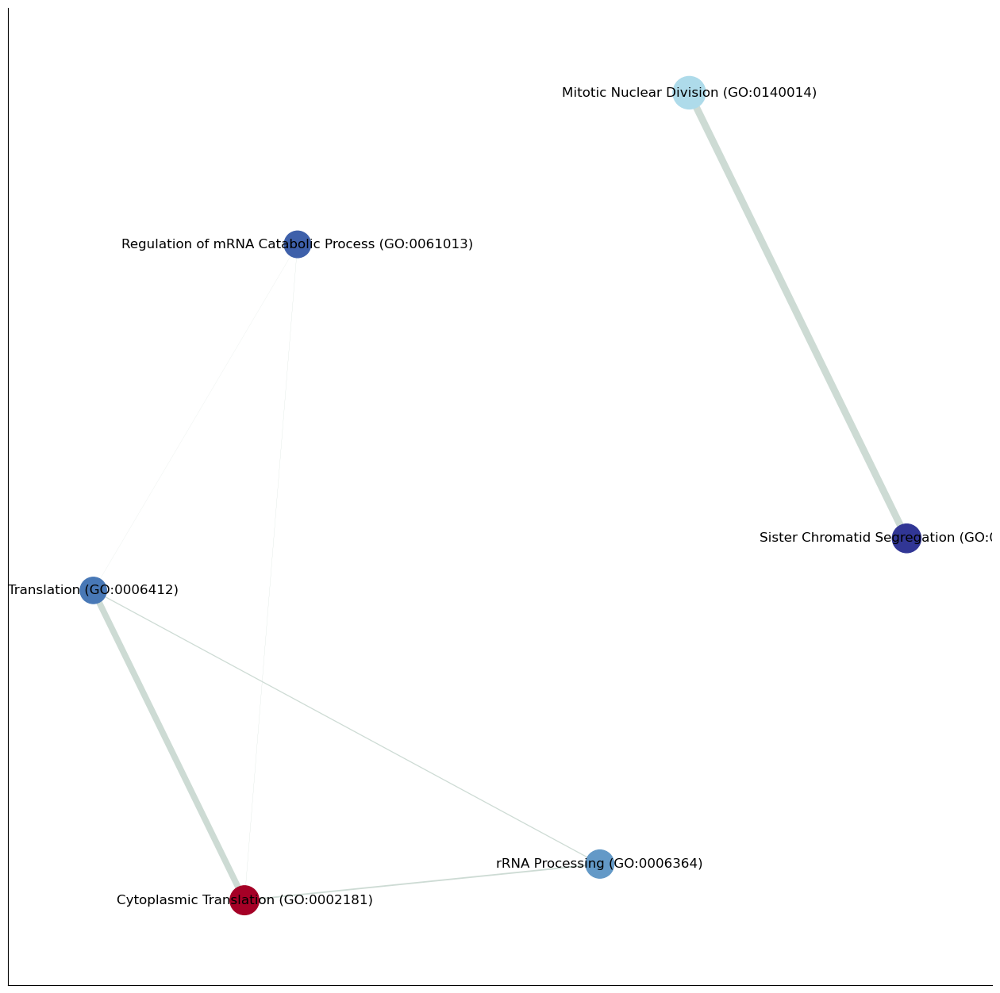

------- fit_dt_scores -------


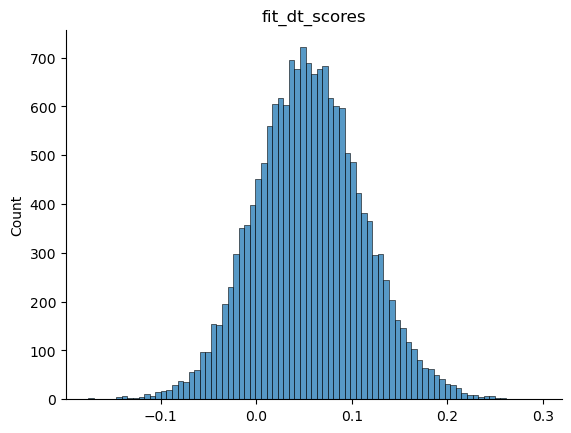

2025-09-26 23:25:38,683 [WARNING] Duplicated values found in preranked stats: 0.11% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


      Name                                               Term        ES  \
1  prerank  GO_Biological_Process_2025__Cytoplasmic Transl... -0.414881   
2  prerank  GO_Biological_Process_2025__Translation (GO:00... -0.330395   
3  prerank  GO_Biological_Process_2025__Macromolecule Bios... -0.357247   

        NES NOM p-val FDR q-val FWER p-val  Tag %  Gene %  \
1 -2.517382       0.0  0.015296      0.017  19/42  16.46%   
2 -2.399936       0.0  0.031042      0.064  30/80  16.46%   
3 -2.372674       0.0  0.031192      0.091  25/62  16.46%   

                                          Lead_genes  
1  RPL9;RWDD1;FAU;RPL28;RPLP0;RPL30;RPS16;RPL14;R...  
2  RPL9;RWDD1;EEF1A1;FAU;MRPS11;RPL28;RPLP0;EEF1G...  
3  RPL9;EEF1A1;FAU;MRPS11;RPL28;RPLP0;EEF1G;RPL30...  
SNAPC1    -0.175723
PEX19     -0.170878
ACTR10    -0.162651
PRKAR1A   -0.157317
ARF4      -0.150608
             ...   
WDR73      0.254218
CPNE5      0.256602
MESP1      0.258242
RWDD1      0.279420
RPL9       0.296317
Length: 16738,

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


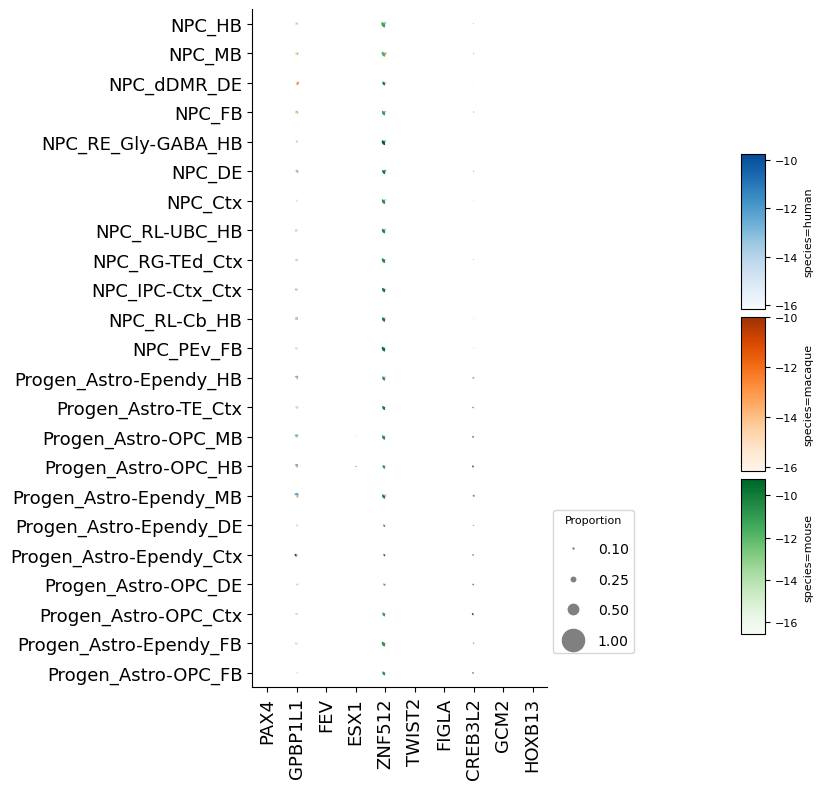

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


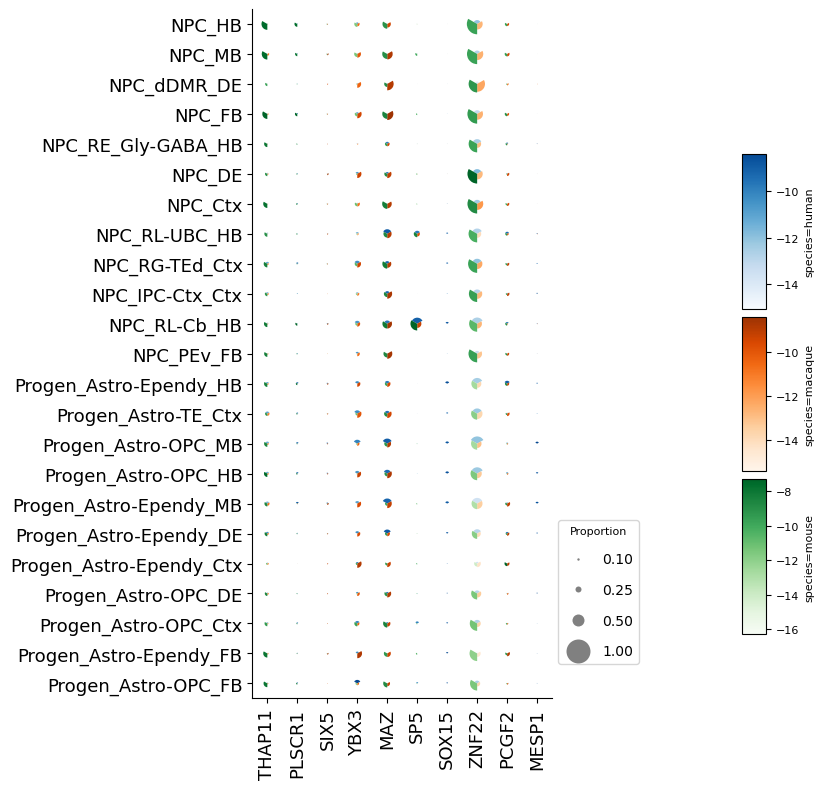

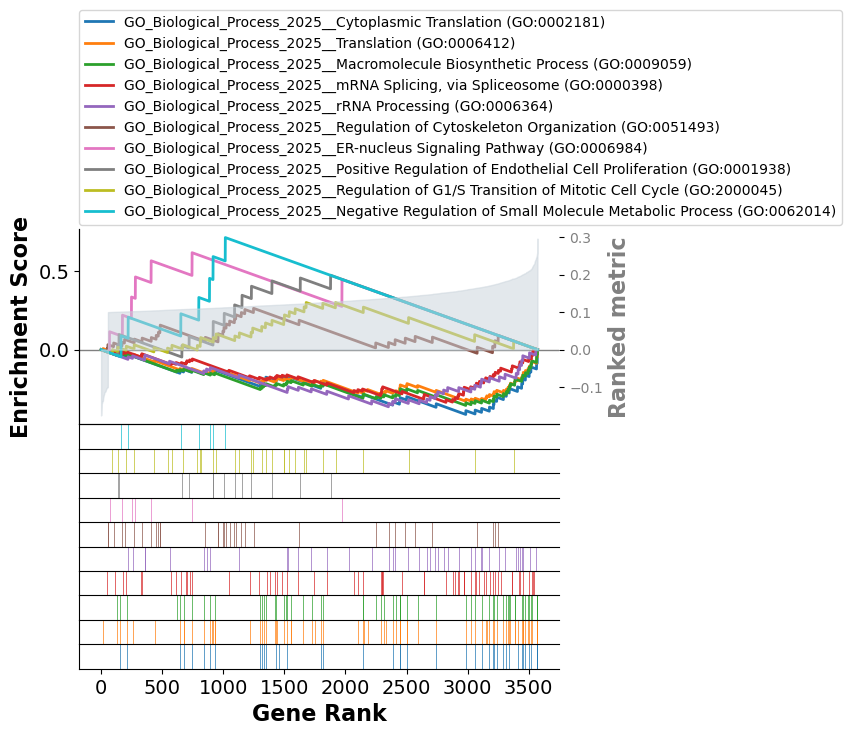

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: DejaVuSansMono
findfont: Generic family 'sans-serif' not found because none of the following families were found: De

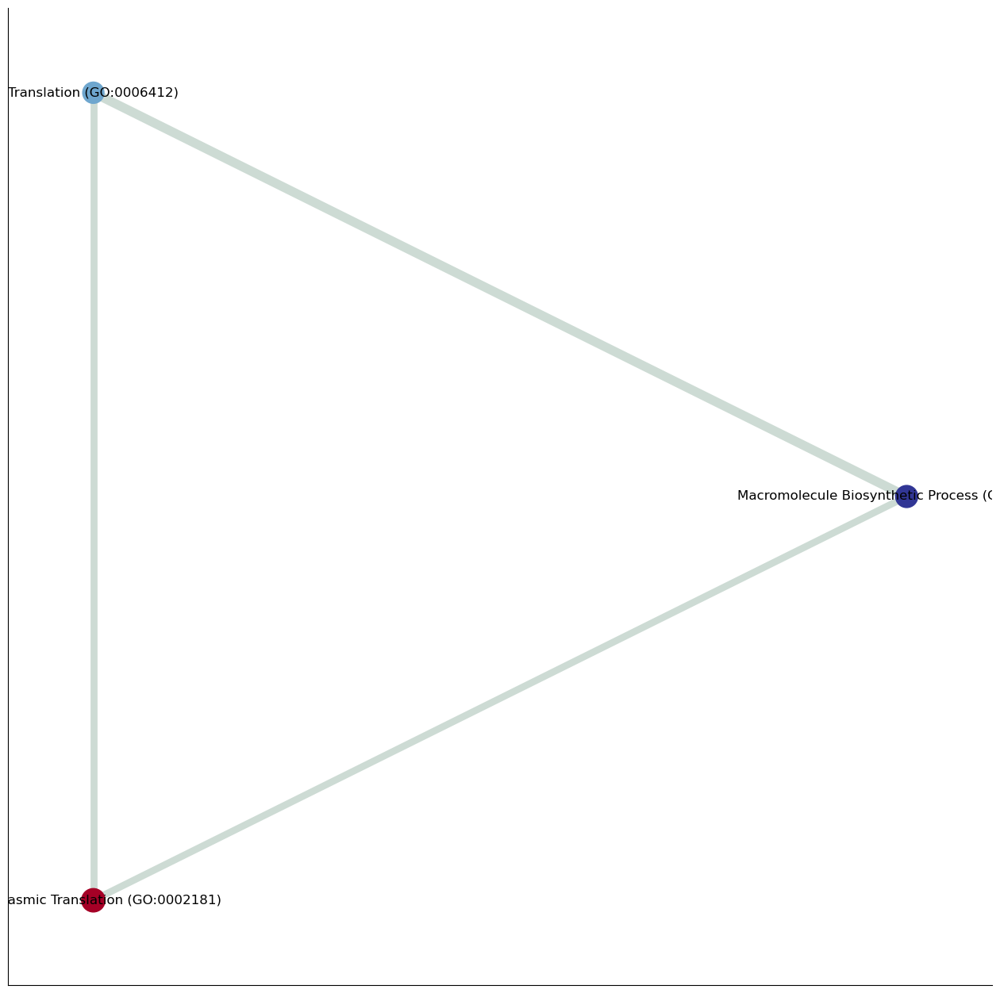

------- fit_dh_scores -------


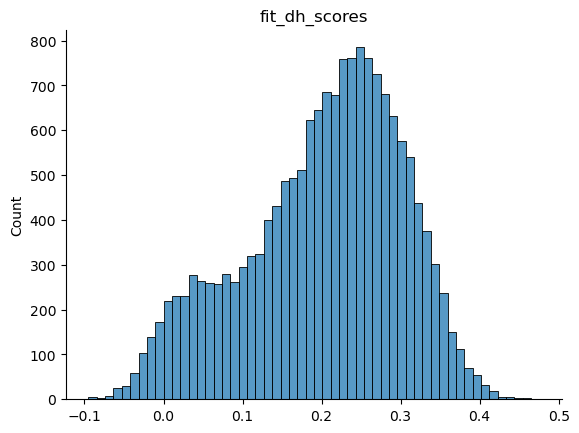

2025-09-26 23:26:04,843 [WARNING] Duplicated values found in preranked stats: 0.25% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


Empty DataFrame
Columns: [Name, Term, ES, NES, NOM p-val, FDR q-val, FWER p-val, Tag %, Gene %, Lead_genes]
Index: []
KTN1       -0.094981
KRT71      -0.093586
OR9G1      -0.089218
KRTAP4-3   -0.086932
OR5B2      -0.086213
              ...   
CNBD2       0.445758
ZSCAN2      0.446454
SYNGR3      0.454551
ACSL1       0.461184
RNF123      0.475513
Length: 16738, dtype: float64


/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


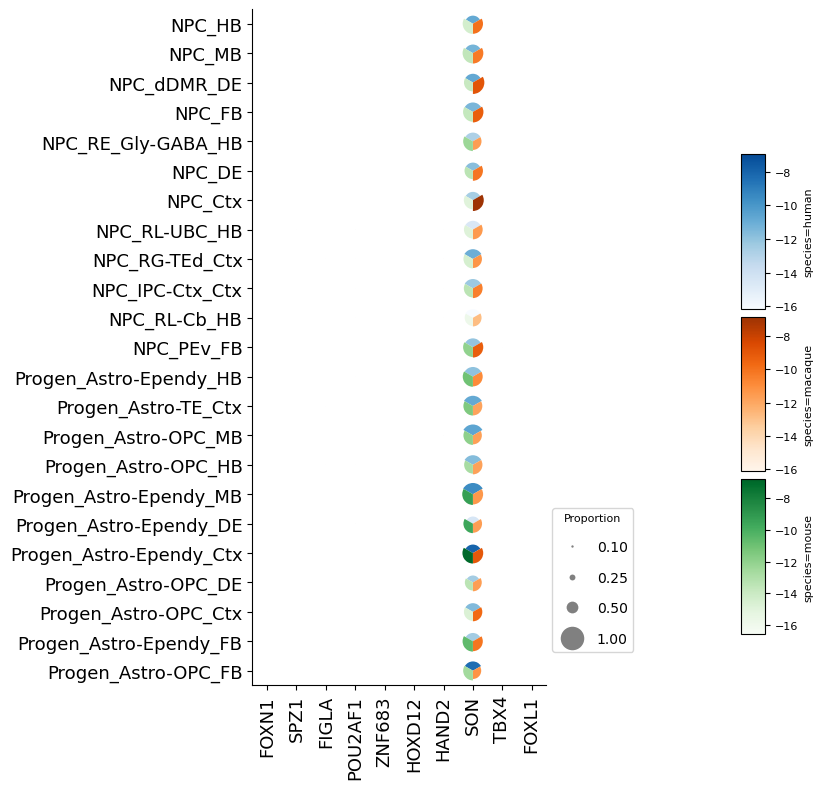

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:877: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.75, 1])


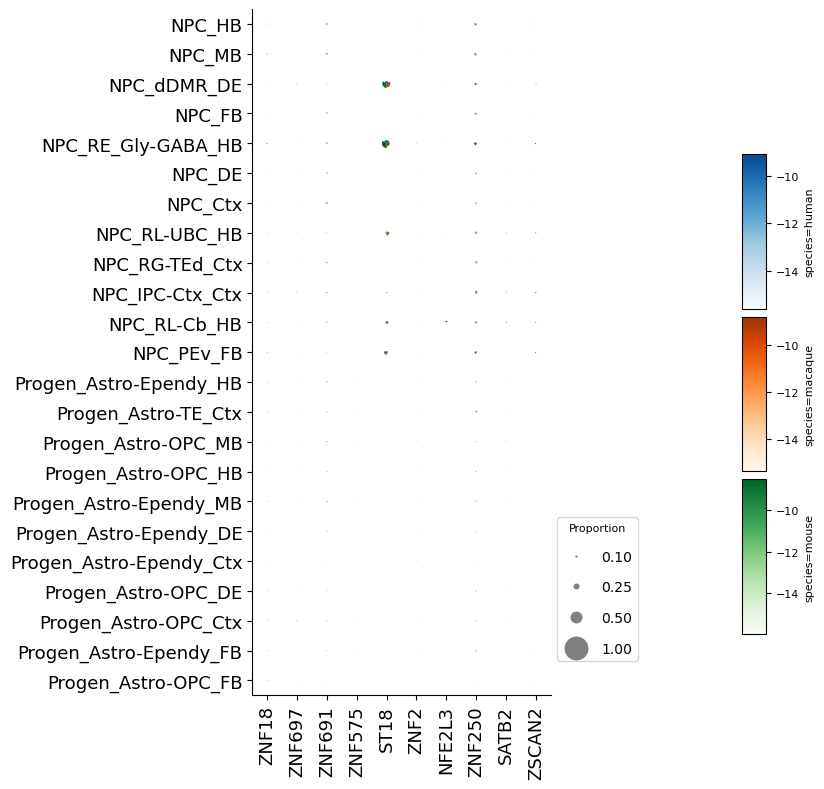

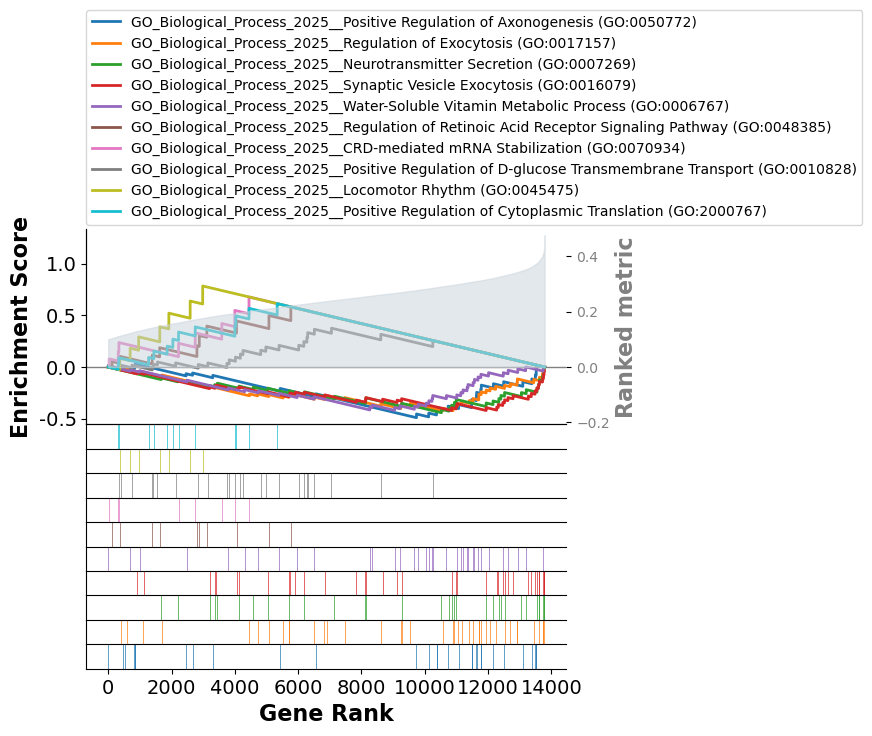

ValueError: Warning: No enrich terms when cutoff = 0.05

In [122]:
import gseapy
from gseapy import enrichment_map
import networkx as nx

for k in scores_dict.keys():
    # try:
    print('-------',k,'-------')
    if not hasattr(scores_dict[k],'index'):
        print('not series')
        com_series = pd.Series(np.nan_to_num(scores_dict[k]),index=adata.var.index)
    else:
        com_series = scores_dict[k].fillna(0)
    seaborn.histplot(com_series)
    plt.title(k)
    plt.savefig(os.path.join(sc.settings.figdir,k+'_scores_hist.svg'))
    plt.show()
    com_gsea = gseapy.prerank(com_series[np.abs(com_series)>.1],['GO_Biological_Process_2025'],min_size=6,max_size=500,permutation_num=1000,ascending=True)#,'GO_Molecular_Function_2025','WikiPathways_2024_Human'
    print(com_gsea.res2d.loc[com_gsea.res2d['FDR q-val']<0.05,:].sort_values('NES'))
    com_gsea.res2d.sort_values('NES').to_csv(os.path.join(sc.settings.figdir,k+'_gsea.tsv'),sep='\t')
    com_series = com_series.sort_values()
    com_series.to_csv(os.path.join(sc.settings.figdir,k+'_scores.tsv'),sep='\t')
    print(com_series)
    com_tfs = com_series[com_series.index.isin(tfs)]
    marker_gene_order = com_tfs.index[:10]
    antipode.plotting.pie_dotplot_xr(ads.sel(var=marker_gene_order),row_dim='Initial_Class',col_dim='var',slice_dim='species',
          scale_by='column', max_radius=0.4, figsize=(8, 8),fontsize_mul=1.3)
    plt.savefig(os.path.join(sc.settings.figdir, k+'_pie_dotplot_Initial_Class_top_10.svg'), format='svg')
    plt.show()    
    marker_gene_order = com_tfs.index[-10:]
    antipode.plotting.pie_dotplot_xr(ads.sel(var=marker_gene_order),row_dim='Initial_Class',col_dim='var',slice_dim='species',
          scale_by='column', max_radius=0.4, figsize=(8, 8),fontsize_mul=1.3)
    plt.savefig(os.path.join(sc.settings.figdir, k+'_pie_dotplot_Initial_Class_bottom_10.svg'), format='svg')
    plt.show()
    terms = com_gsea.res2d.sort_values('NES').Term
    axs = com_gsea.plot(terms=list(terms[:5]) + list(terms[-5:])) # v1.0.5
    plt.savefig(os.path.join(sc.settings.figdir, k+'_top_5_terms.png'), format='svg')
    plt.show()

    ### GSEA plots
    res = com_gsea.res2d.sort_values('NES')
    res['Term'] = res['Term'].str.split('__').str[1]
    # res['NES'] = -res['NES']
    # res['ES'] = -res['ES']
    # res.index = list(reversed(res.index))
    
    # return two dataframe
    nodes, edges = enrichment_map(res,top_term=30)
    
    # build graph
    G = nx.from_pandas_edgelist(edges,
                                source='src_idx',
                                target='targ_idx',
                                edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes'])
    fig, ax = plt.subplots(figsize=(16, 16))
    
    # init node cooridnates
    pos=nx.layout.kamada_kawai_layout(G)
    nodes = nodes.loc[list(pos.keys()),:]
    #node_size = nx.get_node_attributes()
    # draw node
    nx.draw_networkx_nodes(G,
                           pos=pos,
                           cmap=plt.cm.RdYlBu,
                           node_color=list(nodes.NES),
                           node_size=list(nodes.Hits_ratio *1000))
    # draw node label
    nx.draw_networkx_labels(G,
                            pos=pos,
                            labels=nodes.Term.to_dict())
    # draw edge
    edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
    nx.draw_networkx_edges(G,
                           pos=pos,
                           width=list(map(lambda x: x*10, edge_weight)),
                           edge_color='#CDDBD4')
    plt.savefig(os.path.join(sc.settings.figdir, k+'_term_graph.svg'), format='svg')
    plt.show()
    # except:
    #     pass


In [351]:
import numpy as np
import pandas as pd
from tqdm.auto import tqdm
from scipy import sparse
from itertools import combinations

def perm_enrich(
    gene_sets: dict,
    scores: pd.Series,
    n_perm: int = 5000,
    min_size: int = 6,
    max_size: int = 500,
    top_k_leading: int = 10,
    random_state: int | None = 0,
    batch_size: int = 500
) -> pd.DataFrame:
    scores = scores.dropna().astype(float)
    bg_genes = scores.index.to_numpy()
    N = bg_genes.size
    if N == 0:
        raise ValueError("No background genes in scores.")
    pos = {g: i for i, g in enumerate(bg_genes)}

    idx_lists = {}
    for term, genes in gene_sets.items():
        ix = [pos[g] for g in genes if g in pos]
        if min_size <= len(ix) <= max_size:
            idx_lists[term] = np.asarray(ix, dtype=np.int64)
    if not idx_lists:
        raise ValueError("No terms pass size filters after intersecting with background.")

    terms = list(idx_lists.keys())
    m = len(terms)

    data, rows, cols = [], [], []
    for r, term in enumerate(terms):
        ix = idx_lists[term]
        rows.append(np.full(ix.size, r, dtype=np.int64))
        cols.append(ix)
        data.append(np.ones(ix.size, dtype=np.float32))
    rows = np.concatenate(rows)
    cols = np.concatenate(cols)
    data = np.concatenate(data)
    M = sparse.csr_matrix((data, (rows, cols)), shape=(m, N), dtype=np.float32)

    sizes = np.array([len(idx_lists[t]) for t in terms], dtype=np.float32)
    inv_sizes = 1.0 / sizes
    x = scores.to_numpy()

    obs_sum = M @ x
    obs_stat = obs_sum * inv_sizes  # ES = mean score per term

    rng = np.random.default_rng(random_state)
    ge_counts = np.zeros(m, dtype=np.int64)
    abs_obs = np.abs(obs_stat)
    perm_sum = np.zeros(m, dtype=float)
    perm_sqsum = np.zeros(m, dtype=float)

    remaining = n_perm
    pbar = tqdm(total=n_perm, desc="Permuting", leave=True)
    while remaining > 0:
        b = min(batch_size, remaining)
        Xb = np.vstack([rng.permutation(x) for _ in range(b)])  # (b, N)
        permb_sums = M @ Xb.T                                    # (m, b)
        permb_means = permb_sums * inv_sizes[:, None]            # (m, b)
        perm_sum   += permb_means.sum(axis=1)
        perm_sqsum += (permb_means**2).sum(axis=1)
        ge_counts  += np.sum(np.abs(permb_means) >= abs_obs[:, None], axis=1)
        remaining  -= b
        pbar.update(b)
    pbar.close()

    pvals = (ge_counts + 1) / (n_perm + 1)

    order = np.argsort(pvals)
    p_sorted = pvals[order]
    q_sorted = p_sorted * m / (np.arange(1, m+1))
    q_sorted = np.minimum.accumulate(q_sorted[::-1])[::-1]
    p = pvals.astype(float)
    m = p.size
    order = np.argsort(p)
    p_ord = p[order]
    
    # raw BH factors
    q_ord = p_ord * m / (np.arange(1, m+1))
    
    # enforce monotonicity from the right and clamp to [0,1]
    q_ord = np.minimum.accumulate(q_ord[::-1])[::-1]
    q_ord = np.clip(q_ord, 0.0, 1.0)
    
    # map back to original order
    inv = np.empty_like(order)
    inv[order] = np.arange(m)
    fdr = q_ord[inv]
        
    mu  = perm_sum / n_perm
    var = perm_sqsum / n_perm - mu**2
    sd  = np.sqrt(np.maximum(var, 1e-12))
    NES = (obs_stat - mu) / sd

    sdict = scores.to_dict()
    def leading_edge_list(term):
        gs = [g for g in gene_sets[term] if g in sdict]
        if not gs:
            return []
        gs = sorted(gs, key=lambda g: -abs(sdict[g]))[:top_k_leading]
        return gs

    lead_lists = [leading_edge_list(t) for t in terms]
    hits = np.fromiter((len(L) for L in lead_lists), dtype=int)
    set_sizes = sizes.astype(int)

    df = pd.DataFrame({
        "Name":["perm_enrich" for x in terms],
        "Term": terms,
        "ES": obs_stat,
        "NES": NES,
        "NOM p-val": pvals,
        "FDR q-val": fdr,
        "Tag %": [f"{int(k)}/{int(K)}" for k, K in zip(hits, set_sizes)],
        "Lead_genes": [";".join(L) for L in lead_lists],
        "SetSize": set_sizes
    })

    # keep only what gseapy plotters expect by default (but retain SetSize for reference)
    cols = ["Term","ES", "NES", "NOM p-val", "FDR q-val", "Tag %", "Lead_genes", "SetSize"]
    df = df[cols].sort_values("NES", ascending=True).reset_index(drop=True)

    # enforce string types where gseapy uses .str
    df["Term"] = df["Term"].astype(str)
    df["Tag %"] = df["Tag %"].astype(str)
    df["Lead_genes"] = df["Lead_genes"].astype(str)

    return df


def enrichment_map_two_sided(df: pd.DataFrame, column: str = 'FDR q-val', top_term: int = 30, cutoff: float = 0.05):
    x = df.copy()

    # basic columns
    if 'Term' not in x.columns or 'ES' not in x.columns:
        raise KeyError("Input must contain at least 'Term' and 'ES'.")
    if column not in x.columns:
        raise KeyError(f"Column '{column}' not found for cutoff.")

    # parse gene lists (prefer 'Genes', else 'Lead_genes')
    def _parse_genes(val):
        if isinstance(val, str):
            return [t for t in re_split(val) if t]
        if isinstance(val, (list, tuple, np.ndarray, pd.Series)):
            return [str(t) for t in val]
        return []

    import re
    def re_split(s):
        return re.split(r"[,\s;/]+", s.strip())

    if 'Genes' in x.columns:
        x['_genes_list'] = x['Genes'].apply(_parse_genes)
    elif 'Lead_genes' in x.columns:
        x['_genes_list'] = x['Lead_genes'].apply(_parse_genes)
    else:
        x['_genes_list'] = [[] for _ in range(len(x))]

    # SetSize / Hits (k/K) and Hits_ratio
    if 'SetSize' in x.columns:
        K = x['SetSize'].astype(float).fillna(0.0).to_numpy()
    else:
        K = np.array([len(g) for g in x['_genes_list']], dtype=float)

    if 'Tag %' in x.columns:
        # "k/K" string
        def _k_from_tag(s):
            try:
                a, b = str(s).split('/')
                return float(a), float(b)
            except Exception:
                return np.nan, np.nan
        ks, Ks = zip(*[_k_from_tag(v) for v in x['Tag %']])
        k_arr = np.array([np.nan if k is None else k for k in ks], dtype=float)
        K_arr = np.array([np.nan if k is None else k for k in Ks], dtype=float)
        # prefer provided Tag %; otherwise fall back
        use_k = np.where(np.isfinite(k_arr), k_arr, [len(g) for g in x['_genes_list']])
        use_K = np.where(np.isfinite(K_arr), K_arr, K)
        k = np.asarray(use_k, dtype=float)
        K = np.asarray(use_K, dtype=float)
    else:
        k = np.array([len(g) for g in x['_genes_list']], dtype=float)

    hits_ratio = np.divide(k, np.where(K <= 0, np.nan, K))
    x['Hits_ratio'] = hits_ratio

    # clean text
    if 'TermText' in x.columns:
        term_text = x['TermText'].astype(str)
    else:
        term_text = x['Term'].astype(str).str.split('__').str[-1]
    x['TermText'] = term_text

    # absES, p_inv
    x['absES'] = np.abs(x['ES'].astype(float))
    pvals = pd.to_numeric(x[column], errors='coerce').fillna(1.0)
    x['p_inv'] = -np.log10(np.clip(pvals.to_numpy(), 1e-300, 1.0))

    # filter by cutoff
    good = x.loc[pvals <= cutoff].copy()
    if good.empty:
        return (x.iloc[[]].copy(), x.iloc[[]].copy())

    # balanced selection: half lowest ES (more negative), half highest ES (more positive)
    n_side = max(1, top_term // 2)
    neg = good.loc[good['ES'] < 0].sort_values('ES', ascending=True).head(n_side)
    pos = good.loc[good['ES'] > 0].sort_values('ES', ascending=False).head(n_side)
    # if one side has < n_side, just truncate that side; do not refill from the other
    sel = pd.concat([neg, pos], axis=0)
    # stable order: negatives (ascending ES), then positives (descending ES)
    sel = pd.concat([
        sel.loc[sel['ES'] < 0].sort_values('ES', ascending=True),
        sel.loc[sel['ES'] > 0].sort_values('ES', ascending=False)
    ], axis=0).reset_index(drop=True)

    # assign node indices
    sel = sel.reset_index(drop=True)
    sel.index.name = 'node_idx'

    # build nodes df with expected columns
    keep_cols = ['Term', 'ES', 'TermText', 'Hits_ratio', 'absES', 'p_inv']
    for c in ['NES', 'NOM p-val', 'FDR q-val', 'Tag %', 'Lead_genes', 'Genes', 'SetSize']:
        if c in sel.columns:
            keep_cols.append(c)
    nodes = sel[keep_cols].copy()

    # compute edges from gene-set overlaps
    # use parsed lists; if a list is empty, it contributes no edges
    genes_lists = sel['_genes_list'].tolist()
    term_names = sel['TermText'].tolist()

    rows = []
    for (i, j) in combinations(range(len(sel)), 2):
        Ai = set(genes_lists[i])
        Aj = set(genes_lists[j])
        if not Ai or not Aj:
            continue
        inter = Ai & Aj
        if not inter:
            continue
        union = Ai | Aj
        jc = len(inter) / len(union)
        oc = len(inter) / min(len(Ai), len(Aj))
        rows.append({
            'src_idx': i,
            'targ_idx': j,
            'src_name': term_names[i],
            'targ_name': term_names[j],
            'jaccard_coef': float(jc),
            'overlap_coef': float(oc),
            'overlap_genes': ",".join(sorted(inter))
        })
    edges = pd.DataFrame(rows, columns=['src_idx','targ_idx','src_name','targ_name',
                                        'jaccard_coef','overlap_coef','overlap_genes'])

    return nodes, edges


In [356]:
loop_keys

['com_scores',
 'ctx_scores',
 'dt_scores',
 'fit_auc_scores',
 'fit_com_npc_scores',
 'fit_com_scores',
 'fit_dh_scores',
 'fit_dt_npc_scores',
 'fit_dt_scores',
 'fit_mu_scores',
 'fit_xs_scores',
 'xs_scores']

------- fit_com_scores -------


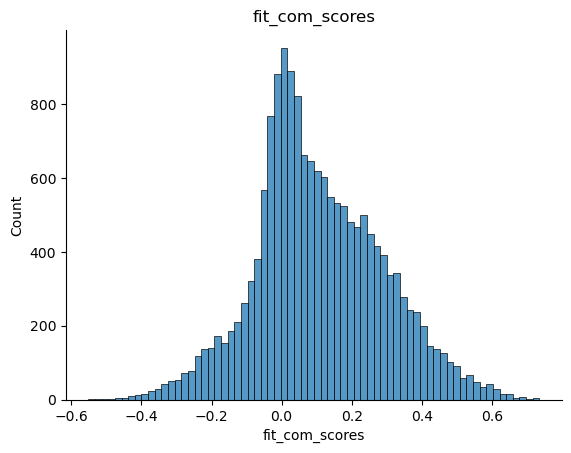

                                                   Term        ES        NES  \
78            Activation of the Pre-Replicative Complex -0.196425  -9.352046   
81                                DNA Strand Elongation -0.193188  -9.247597   
39                          Orc1 Removal From Chromatin -0.178706 -11.773812   
52      SARS-CoV-2 Modulates Host Translation Machinery -0.178298 -10.293784   
11                                     Synthesis of DNA -0.153665 -14.645255   
...                                                 ...       ...        ...   
1962                      Dermatan Sulfate Biosynthesis  0.359600   4.614220   
1951  Defective CHST14 Causes EDS, Musculocontractur...  0.392834   4.449900   
1918  Mitochondrial Fatty Acid Beta-Oxidation of Uns...  0.397476   3.914712   
1960                        Defective CHSY1 Causes TPBS  0.400131   4.566103   
1968                      Defective CHST3 Causes SEDCJD  0.415631   4.804989   

      NOM p-val  FDR q-val   Tag %  \
7

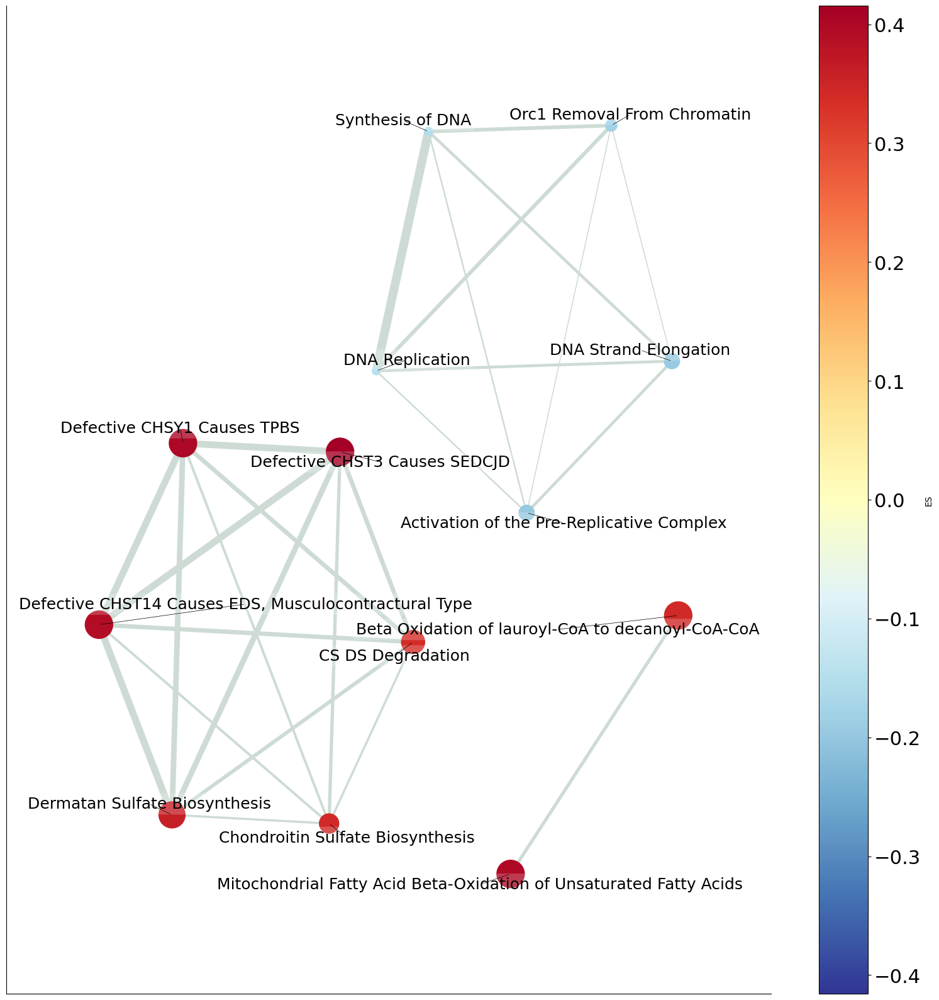

------- fit_xs_scores -------


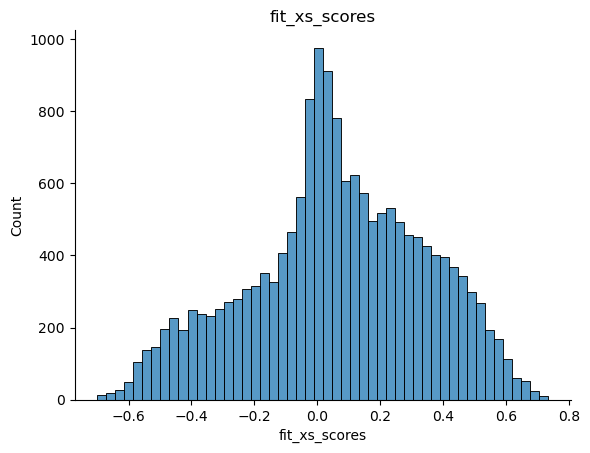

                                                   Term        ES        NES  \
10          Ubiquitin-dependent Degradation of Cyclin D -0.447558 -11.287610   
15    FBXL7 Down-Regulates AURKA During Mitotic Entr... -0.428810 -11.151690   
17           SCF-beta-TrCP Mediated Degradation of Emi1 -0.428609 -11.141909   
47    Cross-presentation of Soluble Exogenous Antige... -0.426067 -10.247872   
27                  p53-Independent DNA Damage Response -0.423771 -10.763127   
...                                                 ...       ...        ...   
1923       RHO GTPases Activate Rhotekin and Rhophilins  0.316464   2.569768   
1950  Regulation of CDH11 mRNA Translation by microRNAs  0.325468   2.823686   
1906       Post-transcriptional Silencing by Small RNAs  0.325801   2.492319   
1956               Regulation of NPAS4 mRNA Translation  0.334365   2.917811   
1972                                 Choline Catabolism  0.427148   3.187781   

         NOM p-val  FDR q-val  Tag %  \

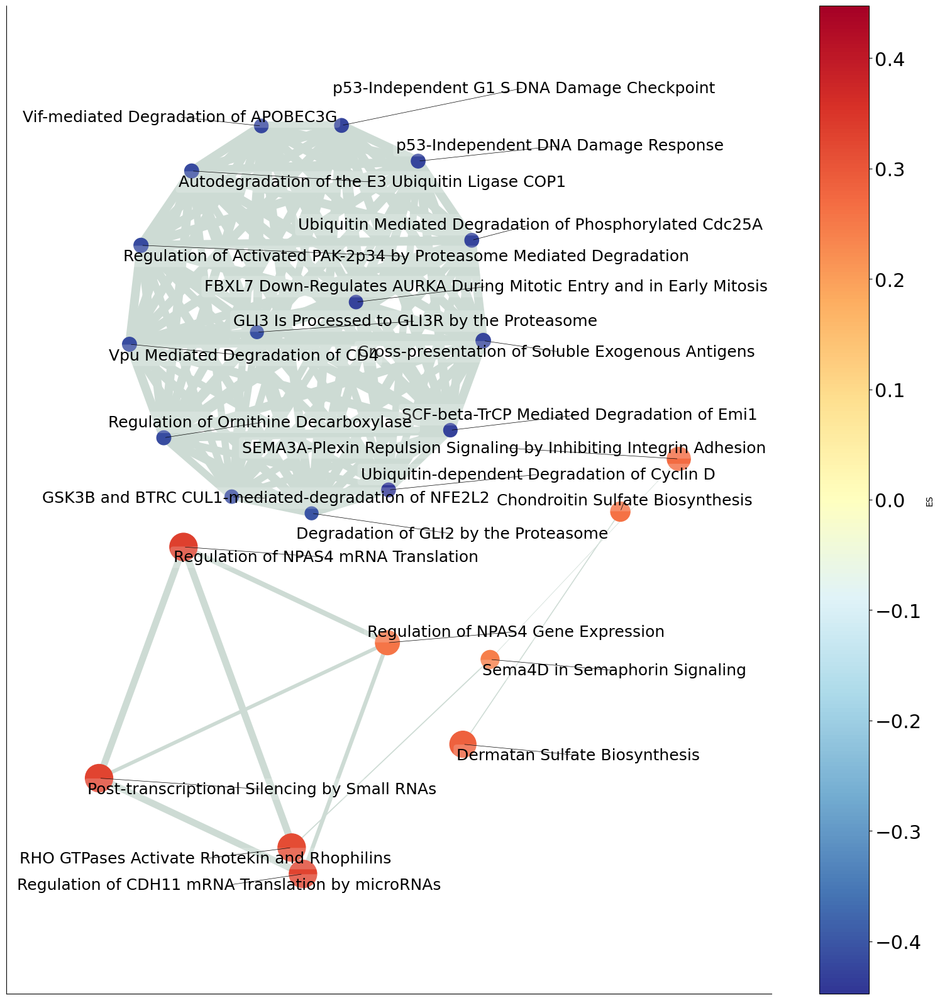

------- fit_com_npc_scores -------


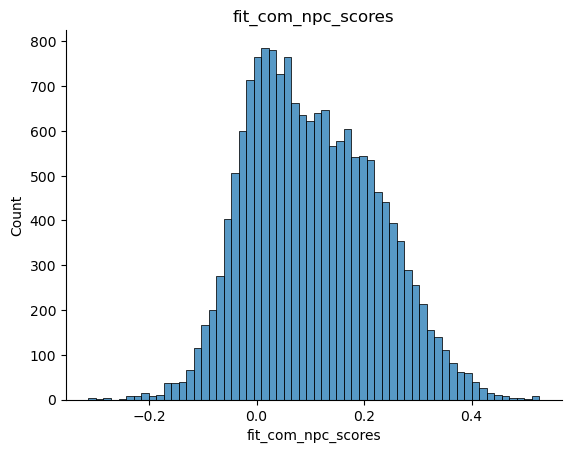

                                                   Term        ES       NES  \
1736                  Asparagine N-linked Glycosylation  0.122144  2.577828   
1813                       PIP3 Activates AKT Signaling  0.126640  3.039909   
1761                            Phospholipid Metabolism  0.126671  2.710617   
1901       Intracellular Signaling by Second Messengers  0.130349  3.790502   
1719  Factors Involved in Megakaryocyte Development ...  0.130385  2.511341   
...                                                 ...       ...       ...   
1887  Defective CHST14 Causes EDS, Musculocontractur...  0.258881  3.680404   
1924          AKT Phosphorylates Targets in the Nucleus  0.259511  4.134435   
1909                      Defective CHST3 Causes SEDCJD  0.268663  3.912965   
1889       Post-transcriptional Silencing by Small RNAs  0.270567  3.708138   
1855               Activated NTRK2 Signals Through PI3K  0.270804  3.433127   

      NOM p-val  FDR q-val   Tag %  \
1736   0.0052

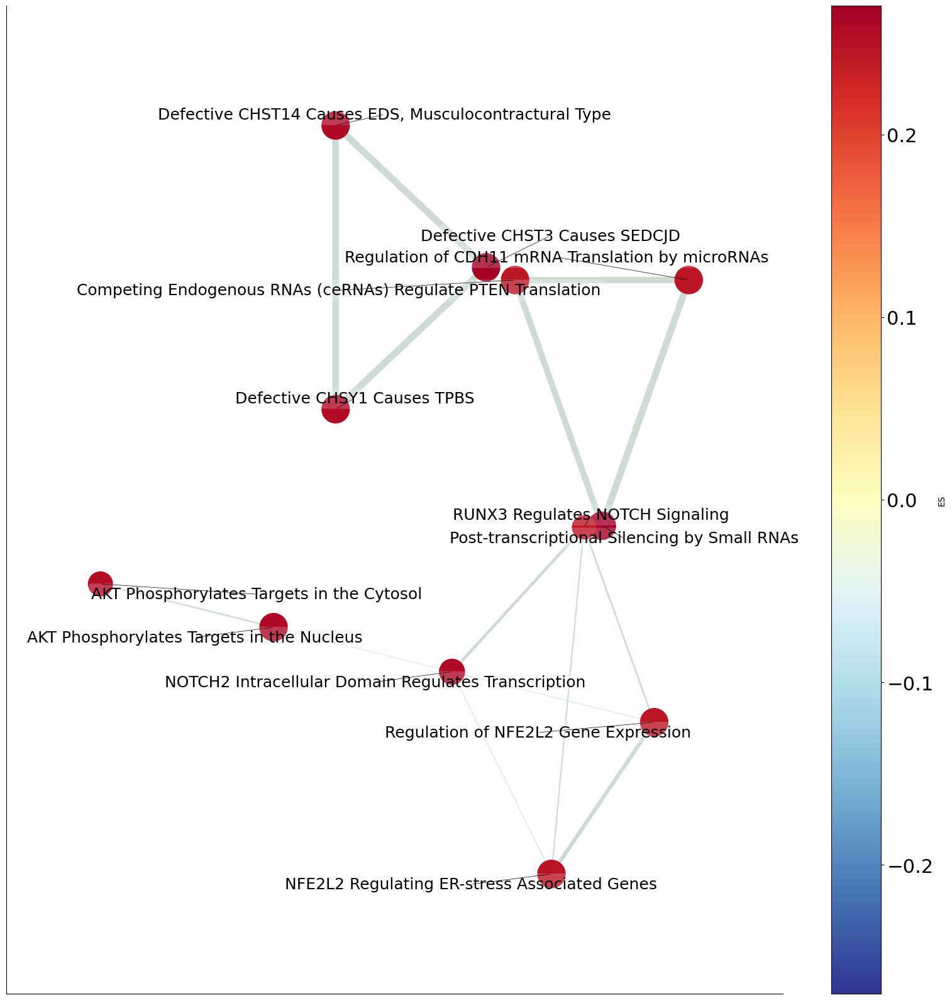

------- fit_dt_scores -------


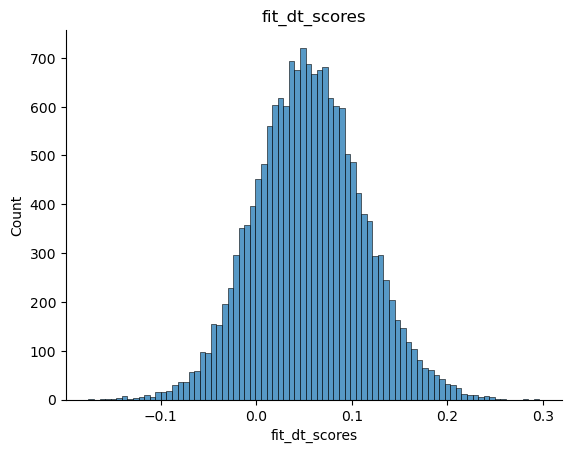

                                                   Term        ES       NES  \
1908                                Cell Cycle, Mitotic  0.063030  2.977921   
1940                                SARS-CoV Infections  0.065307  3.440419   
1934                 Transcriptional Regulation by TP53  0.065705  3.405536   
1918                                         DNA Repair  0.065943  3.163830   
1956                                   RHO GTPase Cycle  0.066045  3.990767   
...                                                 ...       ...       ...   
1975  Formation of the Ternary Complex, and Subseque...  0.107561  6.276743   
1936  Microtubule-dependent Trafficking of Connexons...  0.108757  3.414538   
1948      Transport of Connexons to the Plasma Membrane  0.110044  3.630078   
1972    SARS-CoV-1 Modulates Host Translation Machinery  0.114238  5.901874   
1904        Estrogen-stimulated Signaling Through PRKCZ  0.128607  2.897878   

         NOM p-val  FDR q-val   Tag %  \
1908  1.50

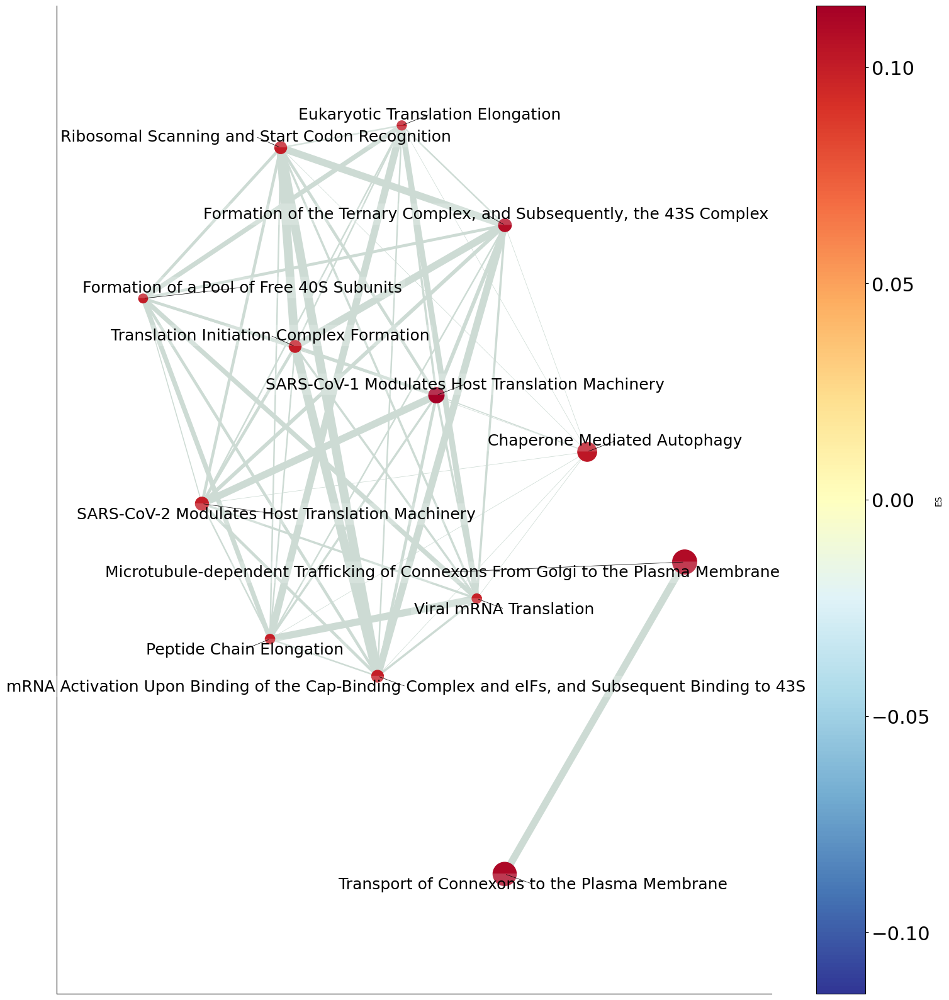

------- fit_com_scores -------


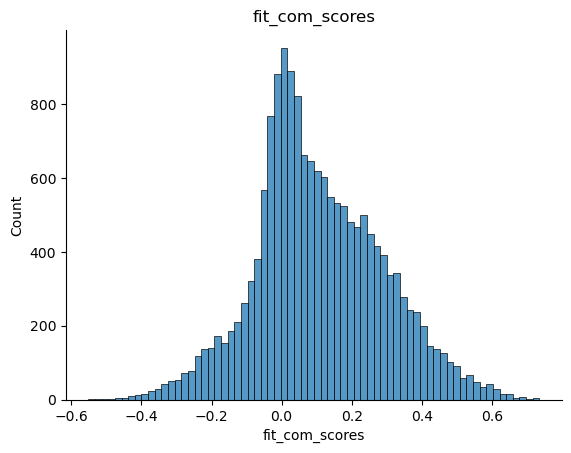

                                                   Term        ES       NES  \
48                             RNA Capping (GO:0036260) -0.391119 -6.075569   
47    7-Methylguanosine Cap Hypermethylation (GO:003... -0.391119 -6.075569   
33    Positive Regulation of Telomerase RNA Localiza... -0.332349 -6.779762   
44    Chaperone Mediated Protein Folding Independent... -0.321427 -6.181202   
4639  Positive Regulation of Macromolecule Biosynthe...  0.132090  2.712791   
...                                                 ...       ...       ...   
5020  Cerebellar Granule Cell Differentiation (GO:00...  0.439072  4.088371   
5113                  Postsynapse Assembly (GO:0099068)  0.457656  5.094974   
5117         Presynaptic Membrane Assembly (GO:0097105)  0.465341  5.213648   
5077  Postsynaptic Density Protein 95 Clustering (GO...  0.482966  4.615083   
5123        Postsynaptic Membrane Assembly (GO:0097104)  0.552768  5.466476   

         NOM p-val  FDR q-val   Tag %  \
48    3.53

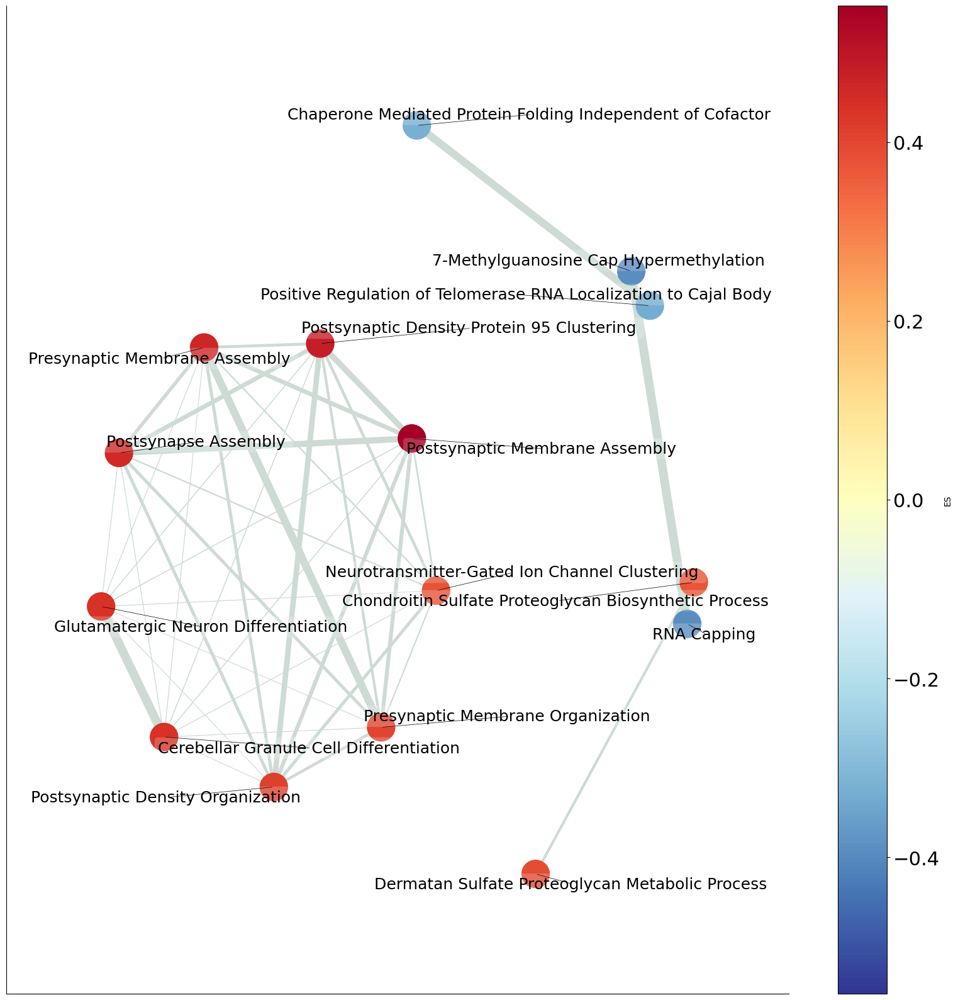

------- fit_xs_scores -------


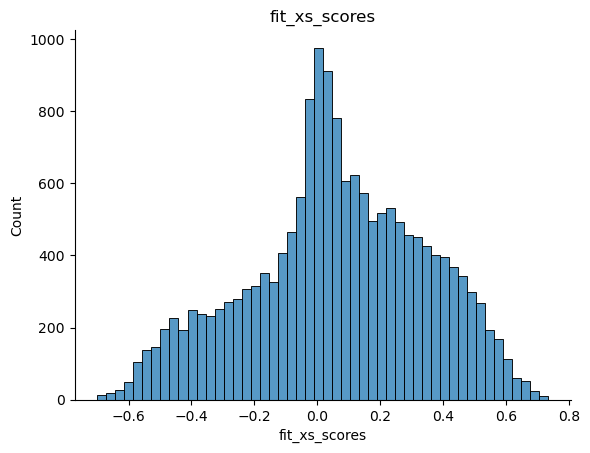

                                                   Term        ES       NES  \
34    Chaperone Mediated Protein Folding Independent... -0.526316 -5.522601   
29    Positive Regulation of Telomerase RNA Localiza... -0.513171 -5.774216   
89                             RNA Capping (GO:0036260) -0.450877 -4.065649   
88    7-Methylguanosine Cap Hypermethylation (GO:003... -0.450877 -4.065649   
90         Nucleobase Biosynthetic Process (GO:0046112) -0.449930 -4.063899   
...                                                 ...       ...       ...   
5072               Axo-Dendritic Transport (GO:0008088)  0.446094  3.061677   
5082  Cerebellar Granule Cell Differentiation (GO:00...  0.458951  3.161585   
5081  Glutamatergic Neuron Differentiation (GO:1905962)  0.458951  3.161585   
5100             Choline Metabolic Process (GO:0019695)  0.479527  3.326747   
5123  Positive Regulation of Microtubule Nucleation ...  0.489994  3.737758   

         NOM p-val  FDR q-val Tag %                

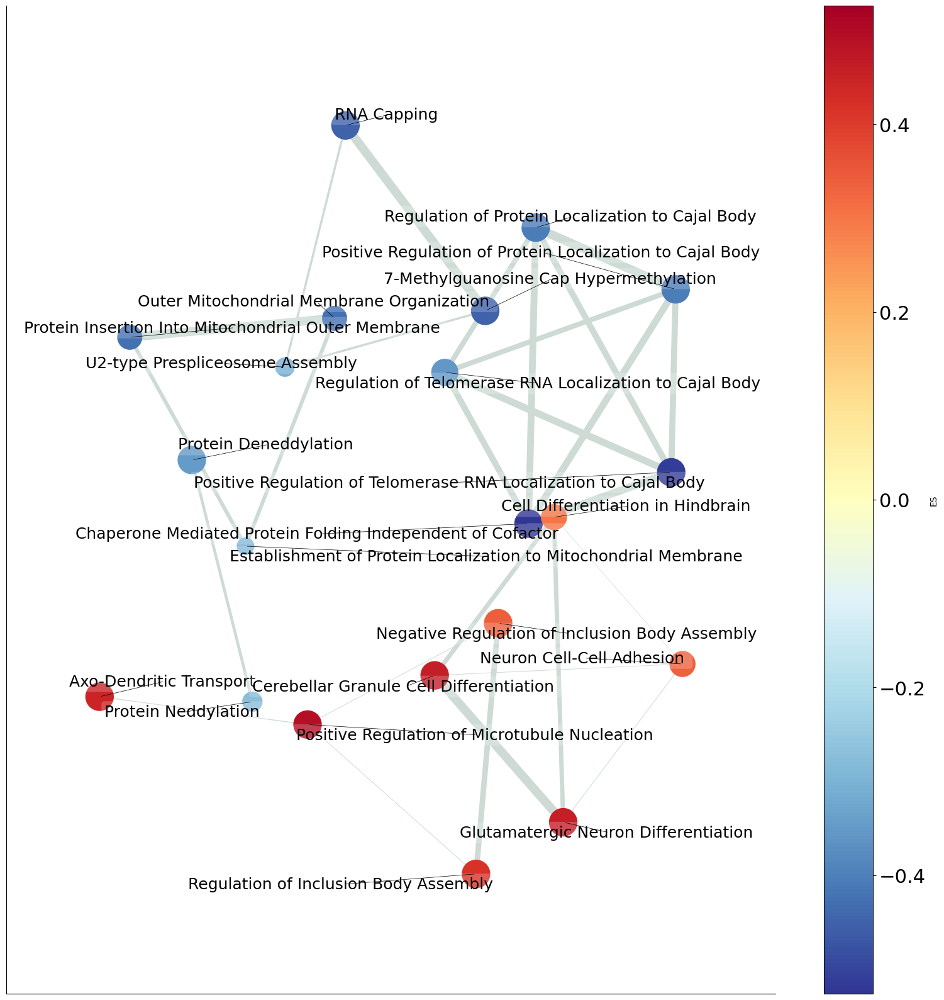

------- fit_com_npc_scores -------


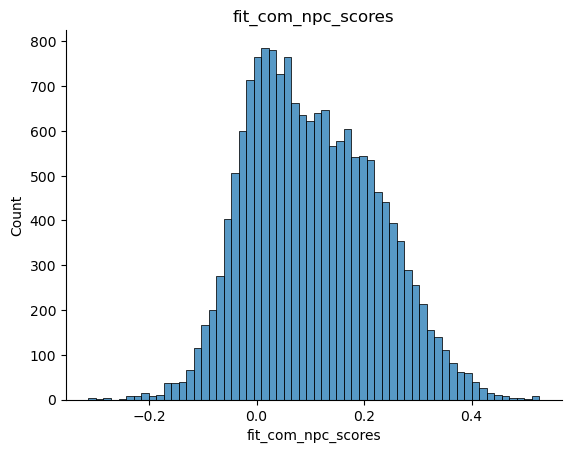

                                                   Term        ES       NES  \
4753  Negative Regulation of Cell Population Prolife...  0.121394  2.752128   
4912          Regulation of Cell Migration (GO:0030334)  0.122554  3.282870   
4754             Regulation of Cell Growth (GO:0001558)  0.127050  2.753472   
4938                Chromatin Organization (GO:0006325)  0.127533  3.398732   
4740  Positive Regulation of Protein Metabolic Proce...  0.127663  2.700261   
...                                                 ...       ...       ...   
5078         Presynaptic Membrane Assembly (GO:0097105)  0.313159  4.648541   
5048  Postsynaptic Density Protein 95 Clustering (GO...  0.328546  4.219584   
5049  Cerebellar Granule Cell Differentiation (GO:00...  0.329265  4.233162   
5050  Glutamatergic Neuron Differentiation (GO:1905962)  0.329265  4.233162   
5067        Postsynaptic Membrane Assembly (GO:0097104)  0.342816  4.485381   

      NOM p-val  FDR q-val   Tag %  \
4753   0.0031

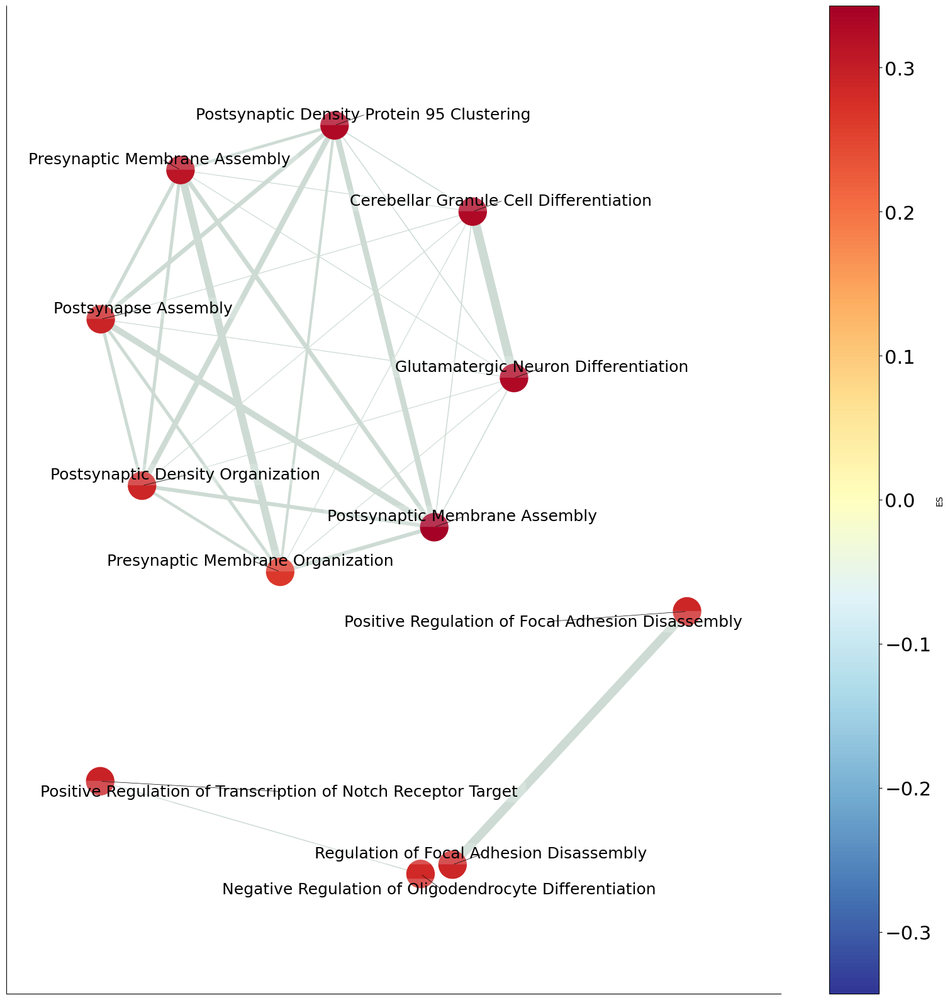

------- fit_dt_scores -------


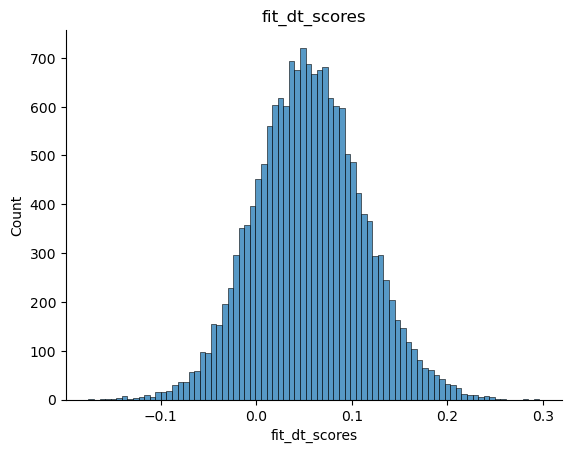

                                                   Term        ES       NES  \
5129  Negative Regulation of RNA Biosynthetic Proces...  0.066502  4.162801   
5127  Regulation of RNA Biosynthetic Process (GO:200...  0.066889  4.013400   
5132                       Gene Expression (GO:0010467)  0.068031  4.327221   
5136                   DNA Damage Response (GO:0006974)  0.069132  4.960954   
5131                            DNA Repair (GO:0006281)  0.069591  4.279900   
5124             Regulation of Translation (GO:0006417)  0.070824  3.845568   
5134                 DNA Metabolic Process (GO:0006259)  0.071237  4.826765   
5128                       mRNA Processing (GO:0006397)  0.071422  4.137274   
5119  RNA Splicing, via Transesterification Reaction...  0.071678  3.645844   
5112  Regulation of Macromolecule Biosynthetic Proce...  0.072101  3.463893   
5137                        RNA Processing (GO:0006396)  0.072591  5.157609   
5116              Regulation of DNA Repair (GO:00062

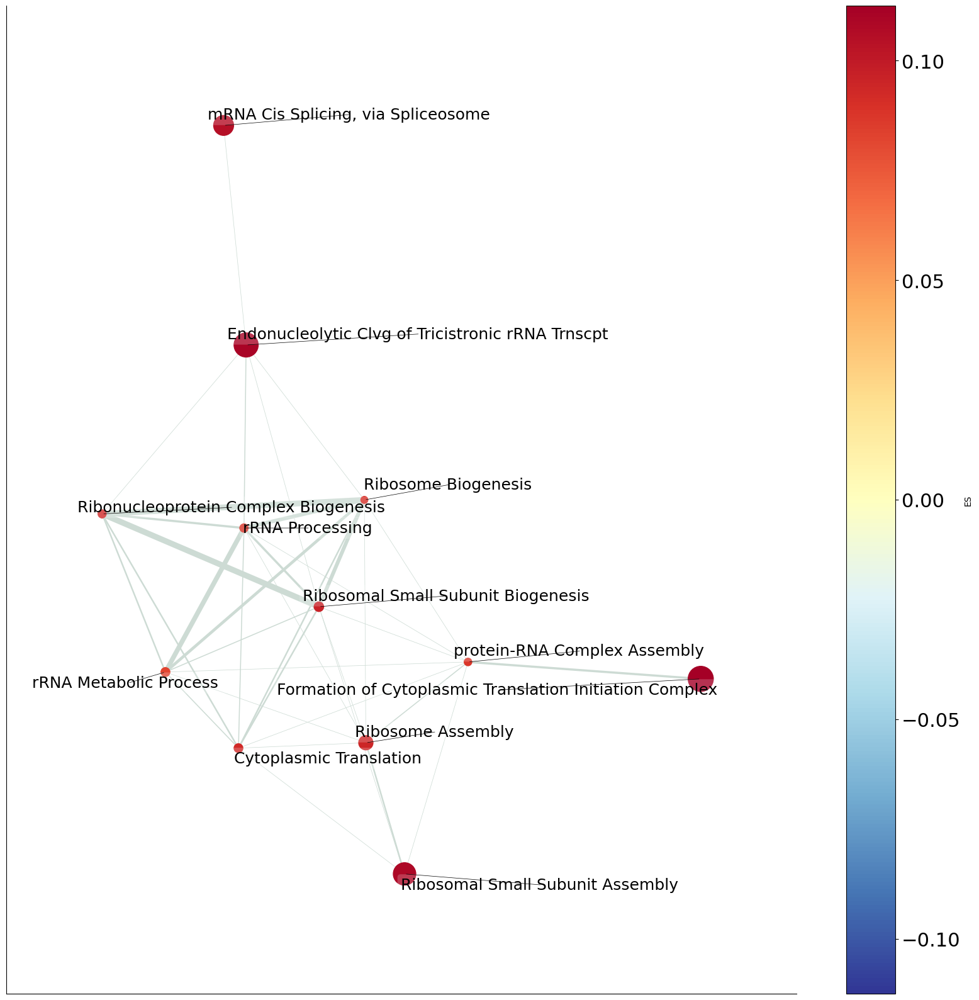

In [370]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as seaborn
import networkx as nx
from gseapy import enrichment_map
import matplotlib.colors as mcolors

figdir = sc.settings.figdir

score_files = {f.replace('_scores.tsv',''): os.path.join(figdir, f)
               for f in os.listdir(figdir) if f.endswith('_scores.tsv')}
gsea_files  = {f.replace('_gsea.tsv',''):  os.path.join(figdir, f)
               for f in os.listdir(figdir) if f.endswith('_gsea.tsv')}

# Only loop over keys that have a GSEA table (required for downstream plots)
loop_keys = sorted(set(gsea_files.keys()) & set(score_files.keys()))

for lib in ['Reactome_Pathways_2024','GO_Biological_Process_2025']:
    go = gseapy.get_library(lib)

    for k in ['fit_com_scores','fit_xs_scores','fit_com_npc_scores','fit_dt_scores']:
        print('-------', k, '-------')
    
        # scores (for hist and TF pie-dotplots)
        s = pd.read_csv(score_files[k], sep='\t', index_col=0, header=0).iloc[:,0]
        s.name = k
        com_series = s.fillna(0)
    
        seaborn.histplot(com_series)
        plt.title(k)
        plt.savefig(os.path.join(figdir, k+'_scores_hist.svg'))
        plt.show()
    
        # res = perm_enrich(
        #     go,
        #     com_series,
        #     n_perm=1e6,
        #     min_size=5,
        #     max_size=500,
        #     top_k_leading=10,
        #     random_state=0,
        #     batch_size=1000
        # )
        
        # res['absES'] = np.abs(res['ES'])
        # res['TermText'] = res['Term'].str.replace('\\(.+\\)$','',regex=True)
        # res.sort_values('ES').to_csv(os.path.join(sc.settings.figdir,k+f'_{lib}_directional-gsea.tsv'),sep='\t')
        res = pd.read_csv(os.path.join(sc.settings.figdir,k+f'_{lib}_directional-gsea.tsv'),sep='\t',index_col=0)
        print(res.loc[res['FDR q-val']<0.05].sort_values('ES'))
        
        nodes, edges = enrichment_map_two_sided(res.sort_values("absES"), column='FDR q-val', top_term=30, cutoff=.05)
        
        G = nx.from_pandas_edgelist(
            edges, source='src_idx', target='targ_idx',
            edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes']
        )
        fig, ax = plt.subplots(figsize=(16, 16))
        pos = nx.layout.kamada_kawai_layout(G)
        
        nodes = nodes.loc[list(pos.keys()), :]
        max_abs = max(np.abs(nodes.ES.min()), np.abs(nodes.ES.max()))
        norm = mcolors.TwoSlopeNorm(vmin=-max_abs, vcenter=0., vmax=max_abs)
        cmap = plt.cm.RdYlBu_r
        
        # edges under nodes/labels
        edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
        nx.draw_networkx_edges(G, pos=pos, width=[w*10 for w in edge_weight], edge_color='#CDDBD4', ax=ax)
        
        # nodes
        node_vals = list(nodes.ES)
        node_sizes = list(nodes.Hits_ratio * 1000)
        pc = nx.draw_networkx_nodes(G, pos=pos, node_color=node_vals, node_size=node_sizes, cmap=cmap, ax=ax)
        pc.set_norm(norm)
        
        # labels with collision avoidance
        labels = nodes.TermText.to_dict()
        
        from adjustText import adjust_text
        
        texts = []
        for n, (x, y) in pos.items():
            t = ax.text(
                x, y, labels[n],
                ha='center', va='center', fontsize=18,
                bbox=dict(boxstyle="round,pad=0.2", fc="white", ec="none", alpha=0.2)
            )
            texts.append(t)
        
        pts_x = np.array([pos[n][0] for n in G.nodes()])
        pts_y = np.array([pos[n][1] for n in G.nodes()])
        
        adjust_text(
            texts, x=pts_x, y=pts_y, ax=ax,
            only_move={'text': 'xy'},
            expand_points=(1.2, 1.3),
            expand_text=(1.1, 1.2),
            force_points=(0.2, 0.2),
            force_text=(0.5, 0.5),
            arrowprops=dict(arrowstyle='-', color='0.', lw=0.5)
        )
        
        
        # colorbar
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm); sm.set_array([])
        cb = plt.colorbar(sm, ax=ax, label='ES')
        cb.ax.tick_params(labelsize=22) 
        ax.margins(0.1)
        plt.tight_layout()
                    
        plt.savefig(os.path.join(figdir, k+'_term_graph.svg'), format='svg',bbox_inches='tight')
        plt.show()


In [371]:
res.sort_values('ES')

,Term,ES,NES,NOM p-val,FDR q-val,Tag %,Lead_genes,SetSize,absES,TermText
15,Regulation of Calcium Import Into the Mitochon...,-0.038432,-3.715353,0.748755,0.993832,5/5,UCP2;MCUB;PSEN2;VDAC1;SPG7,5,0.038432,Regulation of Calcium Import Into the Mitochon...
23,Attachment of GPI Anchor to Protein (GO:0016255),-0.028029,-3.300121,0.861587,1.000000,5/5,PIGT;PGAP1;PIGS;PIGK;PIGU,5,0.028029,Attachment of GPI Anchor to Protein
9,"Mitochondrial Electron Transport, Cytochrome C...",-0.012842,-4.182143,0.995604,1.000000,10/12,NDUFA4;COX7C;COX6B1;COX5B;COX6A2;COX8A;COX5A;C...,12,0.012842,"Mitochondrial Electron Transport, Cytochrome C..."
55,Negative Regulation of IRE1-mediated Unfolded ...,-0.012153,-2.670968,0.960778,1.000000,5/5,DNAJB9;UFL1;HSPA5;DDRGK1;TMBIM6,5,0.012153,Negative Regulation of IRE1-mediated Unfolded ...
68,Negative Regulation of Macrophage Migration (G...,-0.009134,-2.553905,0.972510,1.000000,5/5,CD200;EMILIN1;S100A9;STAP1;SLAMF8,5,0.009134,Negative Regulation of Macrophage Migration
...,...,...,...,...,...,...,...,...,...,...
5030,Regulation of Muscle Organ Development (GO:004...,0.122357,2.651591,0.004553,0.187511,5/5,TGFB1;MTPN;SFMBT1;NEUROG1;TIFAB,5,0.122357,Regulation of Muscle Organ Development
5041,Positive Regulation of Peroxisome Proliferator...,0.123766,2.710151,0.003860,0.177422,5/5,GPS2;BMP2;PTGIS;LMO3;CITED2,5,0.123766,Positive Regulation of Peroxisome Proliferator...
5042,"Regulation of Circadian Sleep/Wake Cycle, Slee...",0.123872,2.715044,0.003798,0.176330,5/5,FXR1;PER3;PARP1;CHRNB2;PTGDS,5,0.123872,"Regulation of Circadian Sleep/Wake Cycle, Sleep"
5109,Deadenylation-Dependent Decapping of Nuclear-T...,0.127906,3.398963,0.000432,0.055026,7/7,LSM1;DCP2;DCPS;PATL1;DCP1A;PATL2;DCP1B,7,0.127906,Deadenylation-Dependent Decapping of Nuclear-T...


In [361]:
com_series[com_series.index.str.contains('HMG')].sort_values()

HMGCR     -0.059999
HMGCS1    -0.043991
HMGN3     -0.021718
HMGB4      0.026616
HMGCL      0.031550
HMG20A     0.038138
HMGB3      0.042667
HMGA2      0.045280
HMGA1      0.046131
HMGN5      0.049353
HMGCS2     0.049784
HMGN2      0.052659
HMGB1      0.057901
HMGB2      0.071432
HMGXB3     0.107840
HMGCLL1    0.116821
HMGXB4     0.136819
HMG20B     0.137663
HMGN1      0.185757
Name: fit_dt_scores, dtype: float64

In [362]:
res.loc[res['FDR q-val']<0.1].sort_values('ES')

,Term,ES,NES,NOM p-val,FDR q-val,Tag %,Lead_genes,SetSize,absES,TermText
5083,Protein Phosphorylation (GO:0006468),0.064564,3.095357,0.001044,0.082290,10/351,PRKCZ;DAPK2;STK24;EIF2AK4;EIF2AK2;HIPK3;UHMK1;...,351,0.064564,Protein Phosphorylation
5129,Negative Regulation of RNA Biosynthetic Proces...,0.066502,4.162801,0.000016,0.004576,10/432,MESP1;PHB2;KAT5;ZNF568;MTA1;BASP1;IFI16;ASCL1;...,432,0.066502,Negative Regulation of RNA Biosynthetic Process
5071,Regulation of Autophagy (GO:0010506),0.066789,2.983585,0.001432,0.098292,10/214,EEF1A1;DAPK2;NUPR1;KAT5;HAX1;IFI16;ATM;BOK;SNX...,214,0.066789,Regulation of Autophagy
5127,Regulation of RNA Biosynthetic Process (GO:200...,0.066889,4.013400,0.000032,0.007845,10/377,PRMT5;ZNF22;SOX15;SAP30;TAF10;MLLT6;ZNF35;CARM...,377,0.066889,Regulation of RNA Biosynthetic Process
5132,Gene Expression (GO:0010467),0.068031,4.327221,0.000007,0.002252,10/363,RPL9;EEF1A1;FAU;DIS3;MRPS11;RPL28;RPLP0;RPL30;...,363,0.068031,Gene Expression
...,...,...,...,...,...,...,...,...,...,...
5113,Nucleotide Metabolic Process (GO:0009117),0.112220,3.487968,0.000238,0.037128,10/12,DCK;GUK1;REXO2;NMNAT3;PARK7;NUDT5;NMNAT1;PCDHB...,12,0.112220,Nucleotide Metabolic Process
5114,Formation of Cytoplasmic Translation Initiatio...,0.112510,3.505262,0.000285,0.040755,10/12,EIF3K;EIF3G;EIF3B;EIF3F;EIF3L;EIF3H;EIF3D;EIF3...,12,0.112510,Formation of Cytoplasmic Translation Initiatio...
5087,Synaptic Vesicle Docking (GO:0016081),0.114228,3.128973,0.001012,0.081403,9/9,SNAP25;UNC13C;RIMS1;RIMS3;STX1B;SNPH;UNC13A;RI...,9,0.114228,Synaptic Vesicle Docking
5093,Protein poly-ADP-ribosylation (GO:0070212),0.118517,3.165729,0.000936,0.081403,8/8,PARP14;PARP9;PARP2;ZC3HAV1;PARP3;TNKS2;PARP10;...,8,0.118517,Protein poly-ADP-ribosylation


<Axes: xlabel='NOM p-val', ylabel='FDR q-val'>

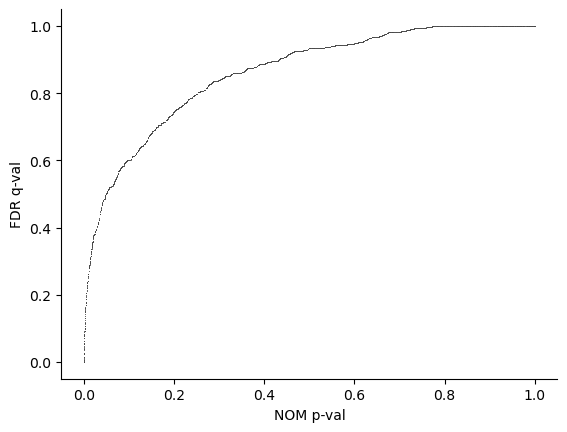

In [363]:
seaborn.scatterplot(data=res,x='NOM p-val',y='FDR q-val',c='black',s=0.5)

<Axes: xlabel='ES', ylabel='NES'>

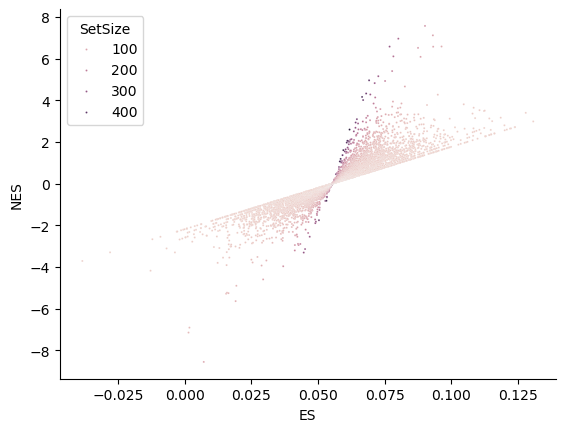

In [364]:
seaborn.scatterplot(data=res,x='ES',y='NES',hue='SetSize',s=2)

In [303]:
res.sort_values("ES")

,Term,ES,NES,NOM p-val,FDR q-val,Tag %,Lead_genes,SetSize,absES,TermText
33,Positive Regulation of Telomerase RNA Localiza...,-0.332349,-6.776330,0.00038,0.007295,8/8,CCT8;DKC1;CCT4;CCT6A;TCP1;CCT5;CCT7;CCT3,8,0.332349,Positive Regulation of Telomerase RNA Localiza...
44,Chaperone Mediated Protein Folding Independent...,-0.321427,-6.182348,0.00116,0.015534,7/7,CCT8;CCT4;CCT6A;TCP1;CCT5;CCT7;CCT3,7,0.321427,Chaperone Mediated Protein Folding Independent...
49,Regulation of Protein Localization to Cajal Bo...,-0.255723,-5.924815,0.00801,0.056310,9/9,CCT8;CCT4;CCT6A;LARP7;TCP1;CCT5;CCT7;MEPCE;CCT3,9,0.255723,Regulation of Protein Localization to Cajal Body
50,Positive Regulation of Protein Localization to...,-0.255723,-5.924815,0.00801,0.056310,9/9,CCT8;CCT4;CCT6A;LARP7;TCP1;CCT5;CCT7;MEPCE;CCT3,9,0.255723,Positive Regulation of Protein Localization to...
41,Regulation of Telomerase RNA Localization to C...,-0.242012,-6.312301,0.00782,0.055667,10/11,CCT8;DKC1;CCT4;CCT6A;TCP1;CCT5;CCT7;CCT3;PARN;...,11,0.242012,Regulation of Telomerase RNA Localization to C...
...,...,...,...,...,...,...,...,...,...,...
4474,Neurotransmitter-Gated Ion Channel Clustering ...,0.377602,3.948036,0.00016,0.003791,7/7,NRXN1;NLGN1;LHFPL3;GPHN;SHANK3;SHISA7;RELN,7,0.377602,Neurotransmitter-Gated Ion Channel Clustering
4548,Presynaptic Membrane Organization (GO:0097090),0.401828,4.597032,0.00001,0.000531,8/8,NRXN1;NLGN3;NLGN2;PTPRD;NLGN1;PTEN;IL1RAPL1;CORIN,8,0.401828,Presynaptic Membrane Organization
4564,Postsynaptic Density Organization (GO:0097106),0.414021,4.785990,0.00003,0.001165,8/8,NRXN1;NRXN2;NLGN2;NLGN1;PTEN;TMEM108;SHANK3;RELN,8,0.414021,Postsynaptic Density Organization
4586,Postsynapse Assembly (GO:0099068),0.457656,5.093042,0.00001,0.000531,7/7,NRXN1;NRXN2;NLGN3;NLGN2;NLGN1;WNT7A;WNT5A,7,0.457656,Postsynapse Assembly


In [ ]:
for i in ['GWAS_Catalog_2023','DisGeNET','MAGMA_Drugs_and_Diseases']:  
    dis_set = pd.Series(gseapy.get_library(i).keys())
    print(dis_set[dis_set.str.lower().str.contains('cephal|cephal|gyria')])

In [ ]:
dis_set = pd.Series(gseapy.get_library('DisGeNET').keys())
dgn = gseapy.get_library('DisGeNET')

In [ ]:
for d in dis_set[dis_set.str.lower().str.contains('cephaly|cephaly|gyria')]:
    genes = [g for g in dgn[d] if g in adata.var.index]
    # seaborn.histplot(scores_dict['fit_xs_scores'][genes])
    # seaborn.histplot(scores_dict['fit_com_npc_scores'][genes])
    # plt.show()
    # print(scores_dict['fit_xs_scores'][genes].mean())
    # print(scores_dict['fit_com_npc_scores'][genes].mean())


In [ ]:
cephaly_disorders = {k:dgn[k] for k in dis_set[dis_set.str.lower().str.contains('cephaly|cephaly|gyria')]}
print(cephaly_disorders.keys())

In [ ]:
lg = cephaly_disorders['Macroencephaly']
lg = [x for x in lg if x in scores_dict['fit_com_scores'].index]

In [ ]:
print(scores_dict['fit_com_scores'][lg].sort_values())
marker_gene_order = scores_dict['fit_com_scores'][lg].sort_values().index
antipode.plotting.pie_dotplot_xr(ads.sel(var=marker_gene_order),row_dim='Initial_Class',col_dim='var',slice_dim='species',
              scale_by='column', max_radius=0.5, figsize=(8,8),fontsize_mul=1.1)
plt.savefig(os.path.join(sc.settings.figdir, k+'_NPC_pie_dotplot_macroencephaly.svg'), format='svg')


In [ ]:
com_gsea = gseapy.prerank(scores_dict['fit_com_scores'],cephaly_disorders,min_size=5,max_size=500,permutation_num=5000,ascending=True)
print(com_gsea.res2d.loc[com_gsea.res2d['FDR q-val']<0.1,:].sort_values('NES'))
sig_terms = com_gsea.res2d.loc[com_gsea.res2d['FDR q-val']<0.1,'Term']
com_gsea.plot(sig_terms) # v1.0.5
plt.savefig(os.path.join(sc.settings.figdir, 'fit_com_scores__cephaly_conditions.svg'), format='svg')
plt.show()

com_gsea = gseapy.prerank(scores_dict['fit_xs_scores'],cephaly_disorders,min_size=5,max_size=500,permutation_num=5000,ascending=True)
print(com_gsea.res2d)
sig_terms = com_gsea.res2d.loc[com_gsea.res2d['FDR q-val']<0.1,'Term']
com_gsea.plot(sig_terms) # v1.0.5
plt.show()

com_gsea = gseapy.prerank(scores_dict['fit_dt_scores'],cephaly_disorders,min_size=5,max_size=500,permutation_num=5000,ascending=True)
print(com_gsea.res2d.loc[com_gsea.res2d['FDR q-val']<0.1,:].sort_values('NES'))
sig_terms = com_gsea.res2d.loc[com_gsea.res2d['FDR q-val']<0.1,'Term']
com_gsea.plot(sig_terms) # v1.0.5
plt.show()


In [ ]:
genes = [g for g in dgn['Macroencephaly'] if g in adata.var.index]
print(scores_dict['fit_xs_scores'][genes].mean())
print(scores_dict['fit_com_npc_scores'][genes].mean())
scores_dict['fit_com_scores'][genes]

In [ ]:
genes = [g for g in dgn['Lissencephaly'] if g in adata.var.index]
print(scores_dict['fit_xs_scores'][genes].mean())
print(scores_dict['fit_com_npc_scores'][genes].mean())
scores_dict['fit_com_npc_scores'][genes]

In [ ]:
#https://pmc.ncbi.nlm.nih.gov/articles/PMC9778424/
microcphaly_cnv_genes =['ADNP', 'CACNA1G', 'DONSON', 'GRIN2A', 'ITSN1', 'MCPH1', 'RPL11', 'TBCD','TRAPPC9']
macrocephaly_lof_genes = ['CHD8', 'GATAD2B', 'GPC3', 'KCTD13', 'KMT5B', 'KIF22', 'MAP2K2', 'MECP2', 'NF1', 'NFIA', 'NSD1','PUF60','TCF20']
print(scores_dict['fit_xs_scores'][microcphaly_cnv_genes])
print(scores_dict['fit_com_npc_scores'][microcphaly_cnv_genes])
print(scores_dict['fit_xs_scores'][macrocephaly_lof_genes])
print(scores_dict['fit_com_npc_scores'][macrocephaly_lof_genes])

In [ ]:
idx = scores_dict['ctx_scores'].index
rank_sum = pd.Series(np.array(([scores_dict[k][idx].rank() for k in ['fit_xs_scores', 'fit_com_scores', 'ctx_scores']])).mean(0),index=idx)
seaborn.scatterplot(x=scores_dict['fit_mu_scores'][idx],y=scores_dict['ctx_scores'][idx],s=1)

In [ ]:
rank_sum.sort_values()

In [ ]:
com_gsea = gseapy.prerank(rank_sum,cephaly_disorders,min_size=5,max_size=500,permutation_num=5000)
print(com_gsea.res2d.loc[com_gsea.res2d['FDR q-val']<0.1,:].sort_values('NES'))
sig_terms = com_gsea.res2d.loc[com_gsea.res2d['FDR q-val']<0.1,'Term']
com_gsea.plot(sig_terms) # v1.0.5
plt.show()

In [ ]:
scores_dict.keys()

In [ ]:
rank_sum = pd.Series(np.array(([scores_dict[k][idx].rank() for k in ['fit_xs_scores', 'fit_mu_scores', 'fit_dt_scores', 'ctx_scores']])).mean(0),index=idx)

In [ ]:
scores_dict[k]

In [ ]:
rank_sum.sort_values()

In [ ]:
com_gsea = gseapy.prerank(rank_sum,['GO_Biological_Process_2025'],min_size=6,max_size=500,permutation_num=100,ascending=True)#,'GO_Molecular_Function_2025','WikiPathways_2024_Human'
print(com_gsea.res2d.loc[com_gsea.res2d['FDR q-val']<0.05,:].sort_values('NES'))
# com_gsea.res2d.sort_values('NES').to_csv(os.path.join(sc.settings.figdir,k+'_gsea.tsv'),sep='\t')


In [ ]:
rank_sum_scores = (scores_dict['fit_mu_scores'][idx].rank()+scores_dict['ctx_scores'][idx].rank()).sort_values()
rank_sum_scores = scores_dict['ctx_scores'].sort_values()
# sc.pl.dotplot(ctxdata,groupby='cluster_region',var_names=rank_sum_scores.index[0:10])

In [ ]:
adata

In [ ]:
scores_dict['fit_com_scores']['PTEN']

In [ ]:
scores_dict['fit_com_scores'].sort_values()[:30]

In [ ]:
scores_dict['fit_com_scores'].sort_values()[-30:]

In [ ]:
sc.tl.score_genes(adata,scores_dict['fit_com_scores'].sort_values()[-50:].index,score_name='late_genes')
sc.tl.score_genes(adata,scores_dict['fit_com_scores'].sort_values()[:50].index,score_name='early_genes')

In [ ]:
adata.obs['lateness_score'] = adata.obs['late_genes'] - adata.obs['early_genes']

In [ ]:
sc.pl.embedding(adata,basis='X_antipode_UMAP',color='lateness_score',cmap='coolwarm',save='lateness_progenitors.png')

In [ ]:
adata.obs['cluster_region'].cat.categories

In [ ]:
npc_coords = adata.obs['cluster_region'].str.contains('NPC_[0-9]+',regex=True)
xdata = adata[npc_coords,:]

log_real_means,real_mean_levels=antipode.model_functions.get_real_leaf_means(xdata,discov_key,'cluster_region',layer='spliced')
real_means=pd.DataFrame(log_real_means.mean(0),columns=xdata.var.index,index=real_mean_levels['cluster_region'])
real_means=real_means.loc[real_mean_levels['cluster_region'],:]

aggr_zeros=antipode.model_functions.group_aggr_anndata(xdata,[discov_key,'cluster_region'],layer='spliced',agg_func=antipode.model_functions.prop_zeros,normalize=True)
keep_clusters = xdata.obs['cluster_region'].cat.categories.str.contains('NPC_[0-9]+',regex=True)

# xdata.obs['cluster_region'] = xdata.obs['cluster_region'].astype('category')
# xdata.obs['cluster_region'] = xdata.obs['cluster_region'].cat.reorder_categories(sorted(xdata.obs['cluster_region'].cat.categories))

coords = {'species':discov_labels,'Initial_Class':xdata.obs['cluster_region'].cat.categories,'var':var_labels}
lrm = xr.DataArray(log_real_means,coords=coords)
az = xr.DataArray(aggr_zeros[0],coords=coords)
xds = xr.Dataset({'scalars':lrm,'proportions':az})

In [ ]:
com_series = scores_dict['fit_com_npc_scores'].sort_values()
com_tfs = com_series[com_series.index.isin(tfs)]


marker_gene_order = com_tfs.index[:20]
antipode.plotting.pie_dotplot_xr(xds.sel(var=marker_gene_order),row_dim='Initial_Class',col_dim='var',slice_dim='species',
              scale_by='column', max_radius=0.5, figsize=(4,16),fontsize_mul=0.9)
plt.savefig(os.path.join(sc.settings.figdir, k+'_NPC_pie_dotplot_level_2_top_20.svg'), format='svg')
plt.show()  
marker_gene_order = com_tfs.index[-20:]
antipode.plotting.pie_dotplot_xr(xds.sel(var=marker_gene_order),row_dim='Initial_Class',col_dim='var',slice_dim='species',
              scale_by='column', max_radius=0.5, figsize=(4,16),fontsize_mul=0.9)
plt.savefig(os.path.join(sc.settings.figdir, k+'_NPC_pie_dotplot_level_2_bottom_20.svg'), format='svg')
plt.show()

In [ ]:
marker_gene_order = lg
antipode.plotting.pie_dotplot_xr(xds.sel(var=marker_gene_order),row_dim='Initial_Class',col_dim='var',slice_dim='species',
              scale_by='column', max_radius=0.5, figsize=(4,16),fontsize_mul=0.9)
# plt.savefig(os.path.join(sc.settings.figdir, k+'_NPC_pie_dotplot_level_2_top_20.svg'), format='svg')
plt.show()  
